In [1]:
import os
LOAD = False         # True = load previously saved model from disk?  False = (re)train the model
SAVE = "\_TFT_model_02.pth.tar"   # file name to save the model under

EPOCHS = 200
INLEN = 16          # input size
HIDDEN = 32         # hidden layers    
LSTMLAYERS = 2      # recurrent layers

ATTH = 2            # attention heads
BATCH = 64          # batch size
LEARN = 1e-3        # learning rate
DROPOUT = 0.1       # dropout rate
VALWAIT = 1         # epochs to wait before evaluating the loss on the test/validation set
N_FC = 2            # output size

RAND = 42           # random seed
N_SAMPLES = 100     # number of times a prediction is sampled from a probabilistic model
N_JOBS = -1          # parallel processors to use;  -1 = all processors

# default quantiles for QuantileRegression
QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

mpath = os.path.abspath(os.getcwd()) + SAVE     # path and file name to save the model

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno

import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, TFTModel
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [3]:
import pandas as pd
xls = pd.ExcelFile('../../data_complete.xlsx')
df_radon={}
for key in ['48','9']:
    df_radon[key] = pd.read_excel(xls, key)
    df_radon[key] = df_radon[key].loc[(df_radon[key]['SyncDate']>='2022-05-10')]

In [4]:
df_radon.keys()

dict_keys(['48', '9'])

In [5]:
#using 21 as the example since it has the most data
df = df_radon['48']

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6243 entries, 0 to 6242
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     6243 non-null   object        
 1   DeviceName   6243 non-null   object        
 2   SyncDate     6243 non-null   datetime64[ns]
 3   Radon        6243 non-null   float64       
 4   eC02         6243 non-null   int64         
 5   VOC          6243 non-null   int64         
 6   Temperature  6243 non-null   int64         
 7   AirPressure  6243 non-null   float64       
 8   Humidity     6243 non-null   int64         
 9   LogIndex     6243 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 536.5+ KB


In [7]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [8]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:05:58,49,61,30.02,28.90
1,2023-02-11 16:05:58,56,53,30.08,25.40
2,2023-02-11 15:05:58,58,51,30.08,25.30
3,2023-02-11 14:05:58,57,51,30.13,25.30
4,2023-02-11 12:05:58,61,49,30.15,28.40
...,...,...,...,...,...
6238,2022-05-10 04:21:23,57,76,30.18,4.20
6239,2022-05-10 03:21:23,58,75,30.18,4.00
6240,2022-05-10 02:21:23,59,74,30.18,4.00
6241,2022-05-10 01:21:23,59,74,30.19,3.90


In [9]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [10]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,77.50,55.08,30.21,6.90
2022-05-11,81.54,47.04,30.17,14.80
2022-05-12,82.92,45.33,30.09,17.04
2022-05-13,78.08,51.88,30.05,8.16
2022-05-14,81.52,51.70,30.01,10.77
...,...,...,...,...
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65
2023-02-09,63.95,59.23,30.13,0.78


In [11]:
df = df[df.index<= '2022-08-10']

In [12]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,77.50,55.08,30.21,6.90
2022-05-11,81.54,47.04,30.17,14.80
2022-05-12,82.92,45.33,30.09,17.04
2022-05-13,78.08,51.88,30.05,8.16
2022-05-14,81.52,51.70,30.01,10.77
...,...,...,...,...
2022-08-06,87.71,64.08,30.22,33.75
2022-08-07,87.29,64.95,30.22,45.77
2022-08-08,88.26,66.61,30.15,59.79


In [13]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [14]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [15]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [16]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [17]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [18]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,77.50,55.08,30.21,6.90,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,81.54,47.04,30.17,14.80,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,82.92,45.33,30.09,17.04,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,78.08,51.88,30.05,8.16,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,81.52,51.70,30.01,10.77,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,87.71,64.08,30.22,33.75,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,87.29,64.95,30.22,45.77,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,88.26,66.61,30.15,59.79,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [19]:
df.dropna(inplace=True)

In [20]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,77.50,55.08,30.21,6.90,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,81.54,47.04,30.17,14.80,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,82.92,45.33,30.09,17.04,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,78.08,51.88,30.05,8.16,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,81.52,51.70,30.01,10.77,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,87.71,64.08,30.22,33.75,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,87.29,64.95,30.22,45.77,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,88.26,66.61,30.15,59.79,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [21]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [22]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [23]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,87.63,55.64,30.06,56.56,76.83,0.18,0.75,4.30,293.74,0.01,0.15,0.05,0.37,2.15,28.44,29.00,77.70,29.00,301.24,0.10
std,4.96,8.03,0.09,70.53,4.29,0.11,0.40,1.50,10.43,0.02,0.35,0.15,0.68,2.21,4.48,0.09,8.79,0.09,9.53,0.09
min,75.78,37.91,29.88,6.90,65.19,0.02,0.17,2.04,231.74,0.00,0.00,0.00,0.00,0.00,22.72,28.81,50.50,28.81,231.71,0.00
25%,83.96,50.79,29.99,17.66,74.01,0.11,0.51,3.33,288.05,0.00,0.00,0.00,0.00,0.64,25.40,28.93,72.20,28.93,298.84,0.04
50%,88.04,56.37,30.06,30.37,77.24,0.15,0.62,4.07,295.40,0.00,0.00,0.00,0.02,0.76,26.05,29.00,77.62,29.00,302.76,0.08
75%,91.22,62.26,30.13,65.23,79.63,0.24,0.94,5.02,300.25,0.00,0.09,0.01,0.40,3.43,31.96,29.07,83.47,29.07,306.52,0.13
max,98.30,70.00,30.22,436.68,86.16,0.65,2.44,9.81,310.53,0.08,2.11,0.74,2.67,8.01,37.50,29.16,93.24,29.16,314.83,0.45


In [24]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [25]:
df.fillna(0, inplace=True)

In [26]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Yearly Rain (in),0.60
Monthly Rain (in)_lag_1,0.59
Monthly Rain (in)_lag_2,0.57
Event Rain (in)_lag_31,0.56
...,...
Wind Gust (mph),-0.29
Wind Speed (mph)_lag_1,-0.29
Avg Wind Speed (10 mins) (mph),-0.29
Avg Wind Speed (10 mins) (mph)_lag_1,-0.31


In [27]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Yearly Rain (in) 0.5958521631031254
Monthly Rain (in)_lag_1 0.5852295908364143
Monthly Rain (in)_lag_2 0.5742058005692159
Event Rain (in)_lag_31 0.5614112738061603
Monthly Rain (in)_lag_3 0.5372133303110966
Yearly Rain (in)_lag_1 0.5272734207643083
Monthly Rain (in)_lag_4 0.5126620740198563
Monthly Rain (in)_lag_5 0.5006599136771896
Outdoor h Temperature (°F)_lag_39 0.4992967990835334
Outdoor h Temperature (°F)_lag_38 0.49719668566459585
Temperature_lag_39 0.4932410404090132
Temperature_lag_38 0.49260077115876233
Yearly Rain (in)_lag_39 0.4924014525835459
Yearly Rain (in)_lag_38 0.4844387116683301
Outdoor h Temperature (°F)_lag_37 0.4830869351573969
Temperature_lag_37 0.48003653079958897
Monthly Rain (in)_lag_6 0.47606433985041074
Yearly Rain (in)_lag_37 0.4749373339064221
Monthly Rain (in)_lag_9 0.4712733872134148
Yearly Rain (in)_lag_2 0.4700911708133699
Monthly Rain (in) 0.4677393232478944
Yearly Rain (in)_lag_36 0.467047342057633
Temperature_lag_36 0.4642451579219288
Outd

In [28]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.59]
df_corrH

,Radon
Radon,1.00
Yearly Rain (in),0.60


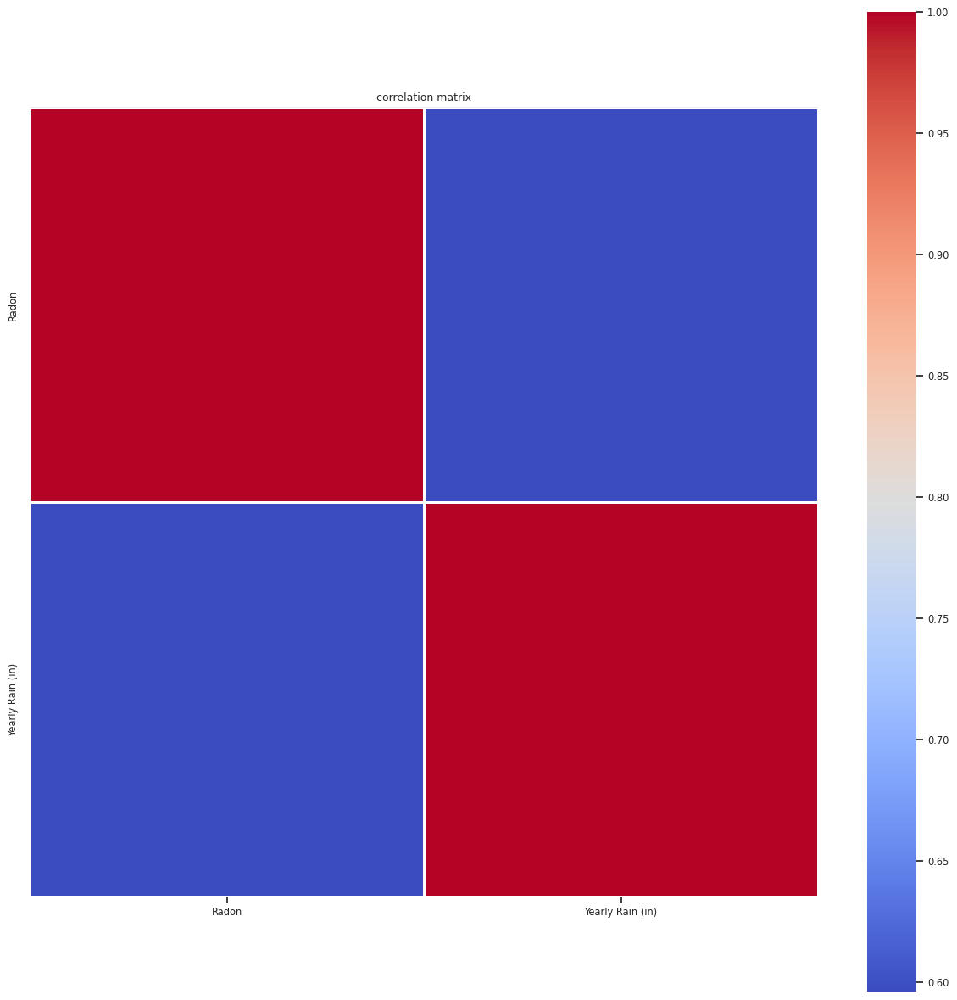

In [29]:
# correlation matrix, limited to highly correlated features
df3 = df[df_corrH.index]

idx = df3.corr().sort_values("Radon", ascending=False).index
df3_sorted = df3.loc[:, idx]  # sort dataframe columns by their correlation with Appliances

plt.figure(figsize = (15,15))
sns.set(font_scale=0.75)
ax = sns.heatmap(df3_sorted.corr().round(3), 
            annot=False, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
ax.xaxis.tick_bottom()
plt.title("correlation matrix")
plt.show()

In [30]:
df3 = df[df_corrH.index]
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-05-10 to 2022-08-10
Freq: D
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Radon             93 non-null     float32
 1   Yearly Rain (in)  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [31]:
df3.fillna(0, inplace=True)

In [32]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-05-10 to 2022-08-10
Freq: D
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Radon             93 non-null     float32
 1   Yearly Rain (in)  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [33]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df3["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [34]:
# create time series object for the feature columns
df_covF = df3.loc[:, df3.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['Yearly Rain (in)'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [35]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [36]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [37]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-10 00:00:00
training end: 2022-07-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-07-23 00:00:00
test end: 2022-08-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-10,0.00
2022-08-10,0.25


In [38]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,Yearly Rain (in)
SyncDate,
2022-05-10,0.00
2022-08-10,1.33


In [39]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-10,0.00
2022-07-22,0.83


In [40]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [41]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [42]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [43]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-22 23:11:44 (running for 00:00:00.22)
Memory usage on this node: 9.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+

(build_fit_tft_model pid=1031428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031428)   rank_zero_deprecation(
(build_fit_tft_model pid=1031428) Auto select gpus: [0]
(build_fit_tft_model pid=1031428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1031428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1031428) 
(build_fit_tft_model pid=1031428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1031428) ---------------

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_001f2544,2023-02-23_02-27-02,True,,0a0e2a82c9b1490b8e9d9000eab2ae77,ip-172-31-10-87,10,0.586516,172.31.10.87,1287103,1.08689,10.0021,0.224352,10.0021,1677119222,0,,10,001f2544,0.00825596
build_fit_tft_model_00269b1c,2023-02-23_00-00-17,True,,872a1494d623457a9a27cf411c111ebd,ip-172-31-10-87,46,0.67289,172.31.10.87,1095035,0.663316,14.649,0.157515,14.649,1677110417,0,,46,00269b1c,0.00727582
build_fit_tft_model_004b49ef,2023-02-23_00-08-11,True,,edcdcb1ec7e040a3933fb8d04c14cab2,ip-172-31-10-87,10,0.663326,172.31.10.87,1105481,1.14565,7.1433,0.213359,7.1433,1677110891,0,,10,004b49ef,0.0121489
build_fit_tft_model_00c51dbf,2023-02-23_00-57-18,True,,1534198d95f2454ca00c2d24294f19ef,ip-172-31-10-87,10,1.73651,172.31.10.87,1167891,1.08584,9.29859,0.478029,9.29859,1677113838,0,,10,00c51dbf,0.00709081
build_fit_tft_model_017ee445,2023-02-23_01-25-47,True,,8f41162a70c54741b4956be2d4301b06,ip-172-31-10-87,53,0.622235,172.31.10.87,1203942,0.897023,17.2305,0.182703,17.2305,1677115547,0,,53,017ee445,0.00658989
build_fit_tft_model_01902f1b,2023-02-23_02-08-32,True,,f9a233b8ee8a43eb9956ec420c41ee61,ip-172-31-10-87,10,0.671614,172.31.10.87,1261862,1.06713,8.63929,0.232486,8.63929,1677118112,0,,10,01902f1b,0.0105934
build_fit_tft_model_01abcefb,2023-02-22_23-19-53,True,,3e139c887a0047a68da8305bf26046c8,ip-172-31-10-87,40,0.638695,172.31.10.87,1041957,0.808518,14.1714,0.224951,14.1714,1677107993,0,,40,01abcefb,0.00991058
build_fit_tft_model_01c35264,2023-02-23_00-02-30,True,,b8f6e9e105b0471bbd7be3893f15e67c,ip-172-31-10-87,61,0.747282,172.31.10.87,1097900,0.755458,17.6159,0.220795,17.6159,1677110550,0,,61,01c35264,0.0101075
build_fit_tft_model_02793fc1,2023-02-23_01-04-09,True,,b266396615f94ddb9c103f3c39448645,ip-172-31-10-87,10,0.749324,172.31.10.87,1176862,1.20072,8.3733,0.360273,8.3733,1677114249,0,,10,02793fc1,0.00887799
build_fit_tft_model_028f970c,2023-02-23_00-04-26,True,,ef2db6c1819f4623aaed6bdb7e0b865d,ip-172-31-10-87,10,1.98466,172.31.10.87,1100726,1.53568,7.12346,0.191347,7.12346,1677110666,0,,10,028f970c,0.00789618


== Status ==
Current time: 2023-02-22 23:12:01 (running for 00:00:16.70)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f94f0de4 with sMAPE=1.6472439765930176 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.44560828665065466, 'lr': 0.001285384293655143, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---------+---------+----------------------+
| Trial name                   | status  

(build_fit_tft_model pid=1031904) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031904)   rank_zero_deprecation(
(build_fit_tft_model pid=1031904) Auto select gpus: [0]
(build_fit_tft_model pid=1031904) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031904) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031904) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031904) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1031904) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1031904) 
(build_fit_tft_model pid=1031904)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1031904) ---------------

== Status ==
Current time: 2023-02-22 23:12:24 (running for 00:00:39.95)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.73313307762146 | Iter 10.000: -1.289719820022583
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: f94f0de4 with sMAPE=1.1310440301895142 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.44560828665065466, 'lr': 0.001285384293655143, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---------+---------+----------------------

(build_fit_tft_model pid=1032860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1032860)   rank_zero_deprecation(
(build_fit_tft_model pid=1032860) Auto select gpus: [0]
(build_fit_tft_model pid=1032860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1032860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1032860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1032860) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1032860) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1032860) 
(build_fit_tft_model pid=1032860)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1032860) ---------------

== Status ==
Current time: 2023-02-22 23:12:46 (running for 00:01:01.54)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.7744862735271454 | Iter 10.000: -1.10527765750885
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---------+----------+--------------------

(build_fit_tft_model pid=1033371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033371)   rank_zero_deprecation(
(build_fit_tft_model pid=1033371) Auto select gpus: [0]
(build_fit_tft_model pid=1033371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033371) 
(build_fit_tft_model pid=1033371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033371) ---------------

== Status ==
Current time: 2023-02-22 23:13:07 (running for 00:01:22.70)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8158394694328308 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----------+----------+-----------------

(build_fit_tft_model pid=1033768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033768)   rank_zero_deprecation(
(build_fit_tft_model pid=1033768) Auto select gpus: [0]
(build_fit_tft_model pid=1033768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033768) 
(build_fit_tft_model pid=1033768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033768) ---------------

== Status ==
Current time: 2023-02-22 23:13:29 (running for 00:01:44.46)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8158394694328308 | Iter 10.000: -0.9871309995651245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1034203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034203)   rank_zero_deprecation(
(build_fit_tft_model pid=1034203) Auto select gpus: [0]
(build_fit_tft_model pid=1034203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034203) 
(build_fit_tft_model pid=1034203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034203) ---------------

== Status ==
Current time: 2023-02-22 23:13:50 (running for 00:02:05.40)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8660991191864014 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1034639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034639)   rank_zero_deprecation(
(build_fit_tft_model pid=1034639) Auto select gpus: [0]
(build_fit_tft_model pid=1034639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034639) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034639) 
(build_fit_tft_model pid=1034639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034639) ---------------

== Status ==
Current time: 2023-02-22 23:14:09 (running for 00:02:25.18)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8660991191864014 | Iter 10.000: -0.9871309995651245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1035013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035013)   rank_zero_deprecation(
(build_fit_tft_model pid=1035013) Auto select gpus: [0]
(build_fit_tft_model pid=1035013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035013) 
(build_fit_tft_model pid=1035013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035013) ---------------

== Status ==
Current time: 2023-02-22 23:14:29 (running for 00:02:44.89)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8660991191864014 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------------

(build_fit_tft_model pid=1035555) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035555)   rank_zero_deprecation(
(build_fit_tft_model pid=1035555) Auto select gpus: [0]
(build_fit_tft_model pid=1035555) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035555) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035555) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035555) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035555) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035555) 
(build_fit_tft_model pid=1035555)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035555) ---------------

== Status ==
Current time: 2023-02-22 23:14:53 (running for 00:03:08.49)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8226136565208435 | Iter 10.000: -0.9871309995651245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---------------

(build_fit_tft_model pid=1036057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1036057)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1036057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036057)   rank_zero_deprecation(
(build_fit_tft_model pid=1036057) Auto select gpus: [0]
(build_fit_tft_model pid=1036057) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036057) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036057) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036057) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:15:14 (running for 00:03:29.38)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8226136565208435 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---------------

(build_fit_tft_model pid=1036057) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036057) 
(build_fit_tft_model pid=1036057)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036057) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1036057) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1036057) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1036057) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1036057) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1036057) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1036057) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:15:23 (running for 00:03:38.90)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8226136565208435 | Iter 10.000: -1.0459082126617432
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--------------

(build_fit_tft_model pid=1036566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036566)   rank_zero_deprecation(
(build_fit_tft_model pid=1036566) Auto select gpus: [0]
(build_fit_tft_model pid=1036566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036566) 
(build_fit_tft_model pid=1036566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036566) ---------------

== Status ==
Current time: 2023-02-22 23:15:34 (running for 00:03:50.12)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8226136565208435 | Iter 10.000: -1.0459082126617432
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--------------

== Status ==
Current time: 2023-02-22 23:15:45 (running for 00:04:00.95)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8694862127304077 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--------------

(build_fit_tft_model pid=1037095) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037095)   rank_zero_deprecation(
(build_fit_tft_model pid=1037095) Auto select gpus: [0]
(build_fit_tft_model pid=1037095) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037095) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037095) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037095) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037095) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037095) 
(build_fit_tft_model pid=1037095)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037095) ---------------

== Status ==
Current time: 2023-02-22 23:15:56 (running for 00:04:11.52)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8694862127304077 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--------------

(build_fit_tft_model pid=1037495) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037495)   rank_zero_deprecation(
(build_fit_tft_model pid=1037495) Auto select gpus: [0]
(build_fit_tft_model pid=1037495) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037495) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037495) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037495) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037495) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037495) 
(build_fit_tft_model pid=1037495)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037495) ---------------

== Status ==
Current time: 2023-02-22 23:16:14 (running for 00:04:30.14)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8694862127304077 | Iter 10.000: -1.0459082126617432
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 403697fe with sMAPE=0.8158394694328308 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 9, 'dropout': 0.15006197408864194, 'lr': 0.0016794598041720596, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-------------

== Status ==
Current time: 2023-02-22 23:16:28 (running for 00:04:43.95)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8226136565208435 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1038083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038083)   rank_zero_deprecation(
(build_fit_tft_model pid=1038083) Auto select gpus: [0]
(build_fit_tft_model pid=1038083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038083) 
(build_fit_tft_model pid=1038083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038083) ---------------

== Status ==
Current time: 2023-02-22 23:16:39 (running for 00:04:55.08)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8226136565208435 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1038517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038517)   rank_zero_deprecation(
(build_fit_tft_model pid=1038517) Auto select gpus: [0]
(build_fit_tft_model pid=1038517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038517) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038517) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038517) 
(build_fit_tft_model pid=1038517)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038517) ---------------

== Status ==
Current time: 2023-02-22 23:17:00 (running for 00:05:15.84)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.841985672712326 | Iter 10.000: -0.9871309995651245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-------------

(build_fit_tft_model pid=1038958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038958)   rank_zero_deprecation(
(build_fit_tft_model pid=1038958) Auto select gpus: [0]
(build_fit_tft_model pid=1038958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038958) 
(build_fit_tft_model pid=1038958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038958) ---------------

== Status ==
Current time: 2023-02-22 23:17:18 (running for 00:05:33.42)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.841985672712326 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-------------

(build_fit_tft_model pid=1039348) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039348)   rank_zero_deprecation(
(build_fit_tft_model pid=1039348) Auto select gpus: [0]
(build_fit_tft_model pid=1039348) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039348) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039348) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039348) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039348) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039348) 
(build_fit_tft_model pid=1039348)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039348) ---------------

== Status ==
Current time: 2023-02-22 23:17:39 (running for 00:05:54.32)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8613576889038086 | Iter 10.000: -0.9871309995651245
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1039681) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039681)   rank_zero_deprecation(
(build_fit_tft_model pid=1039681) Auto select gpus: [0]
(build_fit_tft_model pid=1039681) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039681) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039681) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039681) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039681) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039681) 
(build_fit_tft_model pid=1039681)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039681) ---------------

== Status ==
Current time: 2023-02-22 23:17:57 (running for 00:06:12.89)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8613576889038086 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1040109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1040109)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1040109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040109)   rank_zero_deprecation(
(build_fit_tft_model pid=1040109) Auto select gpus: [0]
(build_fit_tft_model pid=1040109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040109) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:18:17 (running for 00:06:32.58)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.0459082126617432
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1040585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040585)   rank_zero_deprecation(
(build_fit_tft_model pid=1040585) Auto select gpus: [0]
(build_fit_tft_model pid=1040585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040585) 
(build_fit_tft_model pid=1040585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040585) ---------------

== Status ==
Current time: 2023-02-22 23:18:36 (running for 00:06:52.06)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.1033482551574707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1040918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040918)   rank_zero_deprecation(
(build_fit_tft_model pid=1040918) Auto select gpus: [0]
(build_fit_tft_model pid=1040918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040918) 
(build_fit_tft_model pid=1040918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040918) ---------------

== Status ==
Current time: 2023-02-22 23:18:55 (running for 00:07:10.85)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.122456431388855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-------------

== Status ==
Current time: 2023-02-22 23:19:05 (running for 00:07:20.92)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.841985672712326 | Iter 10.000: -1.112524151802063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------

(build_fit_tft_model pid=1041457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041457)   rank_zero_deprecation(
(build_fit_tft_model pid=1041457) Auto select gpus: [0]
(build_fit_tft_model pid=1041457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041457) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041457) 
(build_fit_tft_model pid=1041457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041457) ---------------

== Status ==
Current time: 2023-02-22 23:19:23 (running for 00:07:38.46)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.841985672712326 | Iter 10.000: -1.112524151802063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1041957) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041957)   rank_zero_deprecation(
(build_fit_tft_model pid=1041957) Auto select gpus: [0]
(build_fit_tft_model pid=1041957) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041957) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041957) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041957) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041957) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041957) 
(build_fit_tft_model pid=1041957)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041957) ---------------

== Status ==
Current time: 2023-02-22 23:19:44 (running for 00:07:59.39)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.1079362034797668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:19:54 (running for 00:08:09.93)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.841985672712326 | Iter 10.000: -1.1033482551574707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---------

(build_fit_tft_model pid=1042553) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042553)   rank_zero_deprecation(
(build_fit_tft_model pid=1042553) Auto select gpus: [0]
(build_fit_tft_model pid=1042553) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042553) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042553) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042553) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042553) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042553) 
(build_fit_tft_model pid=1042553)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042553) ---------------

== Status ==
Current time: 2023-02-22 23:20:12 (running for 00:08:28.14)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.841985672712326 | Iter 10.000: -1.1033482551574707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1042986) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042986)   rank_zero_deprecation(
(build_fit_tft_model pid=1042986) Auto select gpus: [0]
(build_fit_tft_model pid=1042986) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042986) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042986) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042986) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042986) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042986) 
(build_fit_tft_model pid=1042986)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042986) ---------------

== Status ==
Current time: 2023-02-22 23:20:33 (running for 00:08:49.10)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.0607771277427673
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1043419) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043419)   rank_zero_deprecation(
(build_fit_tft_model pid=1043419) Auto select gpus: [0]
(build_fit_tft_model pid=1043419) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043419) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043419) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043419) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043419) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043419) 
(build_fit_tft_model pid=1043419)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043419) ---------------

== Status ==
Current time: 2023-02-22 23:20:54 (running for 00:09:09.69)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8761716783046722 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1043823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1043823)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1043823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043823)   rank_zero_deprecation(
(build_fit_tft_model pid=1043823) Auto select gpus: [0]
(build_fit_tft_model pid=1043823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043823) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:21:13 (running for 00:09:28.67)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8761716783046722 | Iter 10.000: -1.0607771277427673
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1044231) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1044231)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1044231) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044231)   rank_zero_deprecation(
(build_fit_tft_model pid=1044231) Auto select gpus: [0]
(build_fit_tft_model pid=1044231) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044231) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044231) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044231) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:21:33 (running for 00:09:48.35)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8761716783046722 | Iter 10.000: -1.1033482551574707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:21:45 (running for 00:10:01.03)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0749215483665466
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1044767) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044767)   rank_zero_deprecation(
(build_fit_tft_model pid=1044767) Auto select gpus: [0]
(build_fit_tft_model pid=1044767) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044767) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044767) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044767) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044767) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044767) 
(build_fit_tft_model pid=1044767)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044767) ---------------

== Status ==
Current time: 2023-02-22 23:21:56 (running for 00:10:11.61)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0749215483665466
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1045147) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045147)   rank_zero_deprecation(
(build_fit_tft_model pid=1045147) Auto select gpus: [0]
(build_fit_tft_model pid=1045147) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045147) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045147) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045147) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045147) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045147) 
(build_fit_tft_model pid=1045147)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045147) ---------------

== Status ==
Current time: 2023-02-22 23:22:15 (running for 00:10:30.34)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.1033482551574707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5269040a with sMAPE=0.7559359669685364 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.10292780102141391, 'lr': 0.000465737338442042, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:22:25 (running for 00:10:40.74)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8761716783046722 | Iter 10.000: -1.0749215483665466
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 40921121 with sMAPE=0.6745248436927795 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.13491422408120357, 'lr': 0.008367311717650558, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1045771) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045771)   rank_zero_deprecation(
(build_fit_tft_model pid=1045771) Auto select gpus: [0]
(build_fit_tft_model pid=1045771) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045771) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045771) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045771) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045771) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045771) 
(build_fit_tft_model pid=1045771)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045771) ---------------

== Status ==
Current time: 2023-02-22 23:22:41 (running for 00:10:56.44)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8761716783046722 | Iter 10.000: -1.0749215483665466
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 40921121 with sMAPE=0.6745248436927795 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.13491422408120357, 'lr': 0.008367311717650558, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-22 23:22:56 (running for 00:11:12.02)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.0464948415756226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 40921121 with sMAPE=0.6745248436927795 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.13491422408120357, 'lr': 0.008367311717650558, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1046307) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046307)   rank_zero_deprecation(
(build_fit_tft_model pid=1046307) Auto select gpus: [0]
(build_fit_tft_model pid=1046307) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046307) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046307) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046307) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046307) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046307) 
(build_fit_tft_model pid=1046307)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046307) ---------------

== Status ==
Current time: 2023-02-22 23:23:07 (running for 00:11:22.93)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.0464948415756226
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 40921121 with sMAPE=0.6745248436927795 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.13491422408120357, 'lr': 0.008367311717650558, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1046780) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046780)   rank_zero_deprecation(
(build_fit_tft_model pid=1046780) Auto select gpus: [0]
(build_fit_tft_model pid=1046780) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046780) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046780) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046780) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046780) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046780) 
(build_fit_tft_model pid=1046780)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046780) ---------------

== Status ==
Current time: 2023-02-22 23:23:27 (running for 00:11:43.01)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7828578948974609 | Iter 20.000: -0.8718130886554718 | Iter 10.000: -1.0323504209518433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 40921121 with sMAPE=0.6745248436927795 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.13491422408120357, 'lr': 0.008367311717650558, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-22 23:23:37 (running for 00:11:53.11)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 40921121 with sMAPE=0.6745248436927795 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.13491422408120357, 'lr': 0.008367311717650558, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-22 23:23:49 (running for 00:12:05.07)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1047410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047410)   rank_zero_deprecation(
(build_fit_tft_model pid=1047410) Auto select gpus: [0]
(build_fit_tft_model pid=1047410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047410) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:24:00 (running for 00:12:15.65)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1047410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047410) 
(build_fit_tft_model pid=1047410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047410) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1047410) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1047410) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1047410) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1047410) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1047410) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1047410) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:24:08 (running for 00:12:24.06)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.0323504209518433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1047804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047804)   rank_zero_deprecation(
(build_fit_tft_model pid=1047804) Auto select gpus: [0]
(build_fit_tft_model pid=1047804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047804) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1047804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1047804) 
(build_fit_tft_model pid=1047804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1047804) ---------------

== Status ==
Current time: 2023-02-22 23:24:19 (running for 00:12:35.03)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8613576889038086 | Iter 10.000: -1.0323504209518433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:24:30 (running for 00:12:46.09)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8718130886554718 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1048273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048273)   rank_zero_deprecation(
(build_fit_tft_model pid=1048273) Auto select gpus: [0]
(build_fit_tft_model pid=1048273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048273) 
(build_fit_tft_model pid=1048273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048273) ---------------

== Status ==
Current time: 2023-02-22 23:24:41 (running for 00:12:57.18)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8718130886554718 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1048680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048680)   rank_zero_deprecation(
(build_fit_tft_model pid=1048680) Auto select gpus: [0]
(build_fit_tft_model pid=1048680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048680) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1048680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1048680) 
(build_fit_tft_model pid=1048680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1048680) ---------------

== Status ==
Current time: 2023-02-22 23:25:01 (running for 00:13:17.07)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8718130886554718 | Iter 10.000: -1.0323504209518433
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1049192) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049192)   rank_zero_deprecation(
(build_fit_tft_model pid=1049192) Auto select gpus: [0]
(build_fit_tft_model pid=1049192) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049192) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049192) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049192) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049192) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049192) 
(build_fit_tft_model pid=1049192)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049192) ---------------

== Status ==
Current time: 2023-02-22 23:25:23 (running for 00:13:39.24)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.882268488407135 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-22 23:25:34 (running for 00:13:50.03)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8866270780563354 | Iter 10.000: -1.0033370852470398
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---------

(build_fit_tft_model pid=1049800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049800)   rank_zero_deprecation(
(build_fit_tft_model pid=1049800) Auto select gpus: [0]
(build_fit_tft_model pid=1049800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049800) 
(build_fit_tft_model pid=1049800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049800) ---------------

== Status ==
Current time: 2023-02-22 23:25:50 (running for 00:14:05.76)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8866270780563354 | Iter 10.000: -1.0033370852470398
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:26:04 (running for 00:14:20.10)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1050221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050221)   rank_zero_deprecation(
(build_fit_tft_model pid=1050221) Auto select gpus: [0]
(build_fit_tft_model pid=1050221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050221) 
(build_fit_tft_model pid=1050221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050221) ---------------

== Status ==
Current time: 2023-02-22 23:26:15 (running for 00:14:30.89)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1050630) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050630)   rank_zero_deprecation(
(build_fit_tft_model pid=1050630) Auto select gpus: [0]
(build_fit_tft_model pid=1050630) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050630) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050630) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050630) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050630) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050630) 
(build_fit_tft_model pid=1050630)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050630) ---------------

== Status ==
Current time: 2023-02-22 23:26:35 (running for 00:14:50.39)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0033370852470398
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1051056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051056)   rank_zero_deprecation(
(build_fit_tft_model pid=1051056) Auto select gpus: [0]
(build_fit_tft_model pid=1051056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051056) 
(build_fit_tft_model pid=1051056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051056) ---------------

== Status ==
Current time: 2023-02-22 23:26:55 (running for 00:15:11.06)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1051487) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051487)   rank_zero_deprecation(
(build_fit_tft_model pid=1051487) Auto select gpus: [0]
(build_fit_tft_model pid=1051487) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051487) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051487) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051487) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051487) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051487) 
(build_fit_tft_model pid=1051487)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051487) ---------------

== Status ==
Current time: 2023-02-22 23:27:15 (running for 00:15:30.30)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1051980) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051980)   rank_zero_deprecation(
(build_fit_tft_model pid=1051980) Auto select gpus: [0]
(build_fit_tft_model pid=1051980) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051980) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051980) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051980) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051980) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051980) 
(build_fit_tft_model pid=1051980)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051980) ---------------

== Status ==
Current time: 2023-02-22 23:27:35 (running for 00:15:50.37)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1052454) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052454)   rank_zero_deprecation(
(build_fit_tft_model pid=1052454) Auto select gpus: [0]
(build_fit_tft_model pid=1052454) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052454) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052454) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052454) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:27:53 (running for 00:16:09.04)
Memory usage on this node: 9.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0010984539985657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1052454) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052454) 
(build_fit_tft_model pid=1052454)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052454) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1052454) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1052454) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1052454) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1052454) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1052454) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1052454) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:28:02 (running for 00:16:18.11)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1052939) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052939)   rank_zero_deprecation(
(build_fit_tft_model pid=1052939) Auto select gpus: [0]
(build_fit_tft_model pid=1052939) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052939) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052939) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052939) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052939) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052939) 
(build_fit_tft_model pid=1052939)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052939) ---------------

== Status ==
Current time: 2023-02-22 23:28:13 (running for 00:16:28.55)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-22 23:28:23 (running for 00:16:39.06)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0010984539985657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---------

(build_fit_tft_model pid=1053546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053546)   rank_zero_deprecation(
(build_fit_tft_model pid=1053546) Auto select gpus: [0]
(build_fit_tft_model pid=1053546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053546) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053546) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053546) 
(build_fit_tft_model pid=1053546)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053546) ---------------

== Status ==
Current time: 2023-02-22 23:28:39 (running for 00:16:54.97)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0010984539985657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:28:50 (running for 00:17:06.12)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1054002) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054002)   rank_zero_deprecation(
(build_fit_tft_model pid=1054002) Auto select gpus: [0]
(build_fit_tft_model pid=1054002) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054002) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054002) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054002) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054002) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054002) 
(build_fit_tft_model pid=1054002)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054002) ---------------

== Status ==
Current time: 2023-02-22 23:29:01 (running for 00:17:16.30)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:29:11 (running for 00:17:26.57)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 0f423bac with sMAPE=0.5876745581626892 and parameters={'in_len': 64, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.1831000580009779, 'lr': 0.0029389696738465615, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1054568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1054568)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1054568) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054568)   rank_zero_deprecation(
(build_fit_tft_model pid=1054568) Auto select gpus: [0]
(build_fit_tft_model pid=1054568) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054568) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054568) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054568) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:29:29 (running for 00:17:44.77)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1055104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1055104)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1055104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055104)   rank_zero_deprecation(
(build_fit_tft_model pid=1055104) Auto select gpus: [0]
(build_fit_tft_model pid=1055104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055104) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:29:49 (running for 00:18:05.21)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1055104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055104) 
(build_fit_tft_model pid=1055104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055104) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1055104) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1055104) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1055104) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1055104) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1055104) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1055104) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:29:55 (running for 00:18:10.56)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1055566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055566)   rank_zero_deprecation(
(build_fit_tft_model pid=1055566) Auto select gpus: [0]
(build_fit_tft_model pid=1055566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055566) 
(build_fit_tft_model pid=1055566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055566) ---------------

== Status ==
Current time: 2023-02-22 23:30:11 (running for 00:18:27.00)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0010984539985657
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1056030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056030)   rank_zero_deprecation(
(build_fit_tft_model pid=1056030) Auto select gpus: [0]
(build_fit_tft_model pid=1056030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056030) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056030) 
(build_fit_tft_model pid=1056030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056030) ---------------

== Status ==
Current time: 2023-02-22 23:30:32 (running for 00:18:47.50)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1056496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056496)   rank_zero_deprecation(
(build_fit_tft_model pid=1056496) Auto select gpus: [0]
(build_fit_tft_model pid=1056496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056496) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056496) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056496) 
(build_fit_tft_model pid=1056496)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056496) ---------------

== Status ==
Current time: 2023-02-22 23:30:51 (running for 00:19:06.51)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0145351886749268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1056943) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056943)   rank_zero_deprecation(
(build_fit_tft_model pid=1056943) Auto select gpus: [0]
(build_fit_tft_model pid=1056943) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056943) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056943) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056943) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056943) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056943) 
(build_fit_tft_model pid=1056943)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056943) ---------------

== Status ==
Current time: 2023-02-22 23:31:08 (running for 00:19:24.22)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1057389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057389)   rank_zero_deprecation(
(build_fit_tft_model pid=1057389) Auto select gpus: [0]
(build_fit_tft_model pid=1057389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057389) 
(build_fit_tft_model pid=1057389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057389) ---------------

== Status ==
Current time: 2023-02-22 23:31:27 (running for 00:19:42.83)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0206570029258728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1057846) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057846)   rank_zero_deprecation(
(build_fit_tft_model pid=1057846) Auto select gpus: [0]
(build_fit_tft_model pid=1057846) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057846) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057846) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057846) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057846) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057846) 
(build_fit_tft_model pid=1057846)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057846) ---------------

== Status ==
Current time: 2023-02-22 23:31:49 (running for 00:20:04.66)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1058249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058249)   rank_zero_deprecation(
(build_fit_tft_model pid=1058249) Auto select gpus: [0]
(build_fit_tft_model pid=1058249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058249) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058249) 
(build_fit_tft_model pid=1058249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058249) ---------------

== Status ==
Current time: 2023-02-22 23:32:07 (running for 00:20:22.53)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0206570029258728
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:32:17 (running for 00:20:33.21)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1058759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058759)   rank_zero_deprecation(
(build_fit_tft_model pid=1058759) Auto select gpus: [0]
(build_fit_tft_model pid=1058759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058759) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058759) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058759) 
(build_fit_tft_model pid=1058759)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058759) ---------------

== Status ==
Current time: 2023-02-22 23:32:29 (running for 00:20:44.54)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7336113750934601 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.018206000328064
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-22 23:32:43 (running for 00:20:59.19)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0145351886749268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1059432) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059432)   rank_zero_deprecation(
(build_fit_tft_model pid=1059432) Auto select gpus: [0]
(build_fit_tft_model pid=1059432) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059432) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059432) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059432) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059432) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059432) 
(build_fit_tft_model pid=1059432)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059432) ---------------

== Status ==
Current time: 2023-02-22 23:32:54 (running for 00:21:09.64)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0145351886749268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1059810) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059810)   rank_zero_deprecation(
(build_fit_tft_model pid=1059810) Auto select gpus: [0]
(build_fit_tft_model pid=1059810) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059810) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059810) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059810) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059810) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059810) 
(build_fit_tft_model pid=1059810)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059810) ---------------

== Status ==
Current time: 2023-02-22 23:33:14 (running for 00:21:29.50)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:33:24 (running for 00:21:40.23)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1060278) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060278)   rank_zero_deprecation(
(build_fit_tft_model pid=1060278) Auto select gpus: [0]
(build_fit_tft_model pid=1060278) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060278) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060278) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060278) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060278) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060278) 
(build_fit_tft_model pid=1060278)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060278) ---------------

== Status ==
Current time: 2023-02-22 23:33:36 (running for 00:21:51.82)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1060736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060736)   rank_zero_deprecation(
(build_fit_tft_model pid=1060736) Auto select gpus: [0]
(build_fit_tft_model pid=1060736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060736) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060736) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060736) 
(build_fit_tft_model pid=1060736)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060736) ---------------

== Status ==
Current time: 2023-02-22 23:33:55 (running for 00:22:10.58)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:34:05 (running for 00:22:21.24)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1061207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061207)   rank_zero_deprecation(
(build_fit_tft_model pid=1061207) Auto select gpus: [0]
(build_fit_tft_model pid=1061207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061207) 
(build_fit_tft_model pid=1061207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061207) ---------------

== Status ==
Current time: 2023-02-22 23:34:16 (running for 00:22:31.68)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7571973204612732 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:34:30 (running for 00:22:46.24)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.764773815870285 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1061770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061770)   rank_zero_deprecation(
(build_fit_tft_model pid=1061770) Auto select gpus: [0]
(build_fit_tft_model pid=1061770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061770) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:34:41 (running for 00:22:56.88)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.764773815870285 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1061770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061770) 
(build_fit_tft_model pid=1061770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061770) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1061770) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1061770) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1061770) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1061770) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1061770) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1061770) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:34:50 (running for 00:23:05.27)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.764773815870285 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1062254) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062254)   rank_zero_deprecation(
(build_fit_tft_model pid=1062254) Auto select gpus: [0]
(build_fit_tft_model pid=1062254) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062254) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062254) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062254) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062254) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062254) 
(build_fit_tft_model pid=1062254)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062254) ---------------

== Status ==
Current time: 2023-02-22 23:35:00 (running for 00:23:16.09)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.764773815870285 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1062611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062611)   rank_zero_deprecation(
(build_fit_tft_model pid=1062611) Auto select gpus: [0]
(build_fit_tft_model pid=1062611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062611) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062611) 
(build_fit_tft_model pid=1062611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062611) ---------------

== Status ==
Current time: 2023-02-22 23:35:22 (running for 00:23:37.41)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.764773815870285 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1063073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063073)   rank_zero_deprecation(
(build_fit_tft_model pid=1063073) Auto select gpus: [0]
(build_fit_tft_model pid=1063073) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063073) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063073) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063073) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063073) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063073) 
(build_fit_tft_model pid=1063073)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063073) ---------------

== Status ==
Current time: 2023-02-22 23:35:40 (running for 00:23:56.15)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.764773815870285 | Iter 20.000: -0.8935892581939697 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-22 23:35:55 (running for 00:24:10.28)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1063696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1063696)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1063696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063696)   rank_zero_deprecation(
(build_fit_tft_model pid=1063696) Auto select gpus: [0]
(build_fit_tft_model pid=1063696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063696) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:36:05 (running for 00:24:21.11)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1064079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064079)   rank_zero_deprecation(
(build_fit_tft_model pid=1064079) Auto select gpus: [0]
(build_fit_tft_model pid=1064079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064079) 
(build_fit_tft_model pid=1064079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064079) ---------------

== Status ==
Current time: 2023-02-22 23:36:25 (running for 00:24:40.70)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1064469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064469)   rank_zero_deprecation(
(build_fit_tft_model pid=1064469) Auto select gpus: [0]
(build_fit_tft_model pid=1064469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064469) 
(build_fit_tft_model pid=1064469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064469) ---------------

== Status ==
Current time: 2023-02-22 23:36:45 (running for 00:25:00.75)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8922874629497528 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:36:58 (running for 00:25:13.32)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1064993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064993)   rank_zero_deprecation(
(build_fit_tft_model pid=1064993) Auto select gpus: [0]
(build_fit_tft_model pid=1064993) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064993) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064993) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064993) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064993) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064993) 
(build_fit_tft_model pid=1064993)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064993) ---------------

== Status ==
Current time: 2023-02-22 23:37:08 (running for 00:25:23.82)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1065412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065412)   rank_zero_deprecation(
(build_fit_tft_model pid=1065412) Auto select gpus: [0]
(build_fit_tft_model pid=1065412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065412) 
(build_fit_tft_model pid=1065412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065412) ---------------

== Status ==
Current time: 2023-02-22 23:37:28 (running for 00:25:43.92)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8915677070617676 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:37:40 (running for 00:25:55.30)
Memory usage on this node: 9.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8921497464179993 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1065944) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065944)   rank_zero_deprecation(
(build_fit_tft_model pid=1065944) Auto select gpus: [0]
(build_fit_tft_model pid=1065944) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065944) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065944) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065944) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065944) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065944) 
(build_fit_tft_model pid=1065944)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065944) ---------------

== Status ==
Current time: 2023-02-22 23:37:50 (running for 00:26:05.73)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8921497464179993 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1066248) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066248)   rank_zero_deprecation(
(build_fit_tft_model pid=1066248) Auto select gpus: [0]
(build_fit_tft_model pid=1066248) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066248) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066248) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066248) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066248) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066248) 
(build_fit_tft_model pid=1066248)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066248) ---------------

== Status ==
Current time: 2023-02-22 23:38:10 (running for 00:26:25.48)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7723503112792969 | Iter 20.000: -0.8921497464179993 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:38:25 (running for 00:26:40.31)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8915677070617676 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1066879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066879)   rank_zero_deprecation(
(build_fit_tft_model pid=1066879) Auto select gpus: [0]
(build_fit_tft_model pid=1066879) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066879) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066879) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066879) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066879) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066879) 
(build_fit_tft_model pid=1066879)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066879) ---------------

== Status ==
Current time: 2023-02-22 23:38:35 (running for 00:26:50.99)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8915677070617676 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:38:49 (running for 00:27:04.35)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9950113892555237
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1067437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067437)   rank_zero_deprecation(
(build_fit_tft_model pid=1067437) Auto select gpus: [0]
(build_fit_tft_model pid=1067437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067437) 
(build_fit_tft_model pid=1067437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067437) ---------------

== Status ==
Current time: 2023-02-22 23:39:00 (running for 00:27:15.73)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9950113892555237
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1067809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067809)   rank_zero_deprecation(
(build_fit_tft_model pid=1067809) Auto select gpus: [0]
(build_fit_tft_model pid=1067809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067809) 
(build_fit_tft_model pid=1067809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067809) ---------------

== Status ==
Current time: 2023-02-22 23:39:19 (running for 00:27:34.59)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1068314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068314)   rank_zero_deprecation(
(build_fit_tft_model pid=1068314) Auto select gpus: [0]
(build_fit_tft_model pid=1068314) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068314) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068314) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068314) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068314) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068314) 
(build_fit_tft_model pid=1068314)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068314) ---------------

== Status ==
Current time: 2023-02-22 23:39:38 (running for 00:27:53.40)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:39:49 (running for 00:28:04.38)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1068769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068769)   rank_zero_deprecation(
(build_fit_tft_model pid=1068769) Auto select gpus: [0]
(build_fit_tft_model pid=1068769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068769) 
(build_fit_tft_model pid=1068769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068769) ---------------

== Status ==
Current time: 2023-02-22 23:39:59 (running for 00:28:15.11)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1069209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1069209)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1069209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069209)   rank_zero_deprecation(
(build_fit_tft_model pid=1069209) Auto select gpus: [0]
(build_fit_tft_model pid=1069209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069209) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:40:19 (running for 00:28:34.36)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1069719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1069719)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1069719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069719)   rank_zero_deprecation(
(build_fit_tft_model pid=1069719) Auto select gpus: [0]
(build_fit_tft_model pid=1069719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069719) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:40:40 (running for 00:28:55.53)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1070204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1070204)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1070204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070204)   rank_zero_deprecation(
(build_fit_tft_model pid=1070204) Auto select gpus: [0]
(build_fit_tft_model pid=1070204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070204) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:41:02 (running for 00:29:17.57)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1070653) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070653)   rank_zero_deprecation(
(build_fit_tft_model pid=1070653) Auto select gpus: [0]
(build_fit_tft_model pid=1070653) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070653) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070653) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070653) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070653) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070653) 
(build_fit_tft_model pid=1070653)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070653) ---------------

== Status ==
Current time: 2023-02-22 23:41:21 (running for 00:29:37.13)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0145351886749268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:41:32 (running for 00:29:47.52)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8305723965167999 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0108643770217896
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-------------

(build_fit_tft_model pid=1071249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071249)   rank_zero_deprecation(
(build_fit_tft_model pid=1071249) Auto select gpus: [0]
(build_fit_tft_model pid=1071249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071249) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071249) 
(build_fit_tft_model pid=1071249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071249) ---------------

== Status ==
Current time: 2023-02-22 23:41:49 (running for 00:30:05.12)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8305723965167999 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:42:00 (running for 00:30:15.99)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8863572776317596 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1071867) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071867)   rank_zero_deprecation(
(build_fit_tft_model pid=1071867) Auto select gpus: [0]
(build_fit_tft_model pid=1071867) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071867) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071867) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071867) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:42:17 (running for 00:30:32.96)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8863572776317596 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1071867) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071867) 
(build_fit_tft_model pid=1071867)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071867) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1071867) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1071867) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1071867) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1071867) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1071867) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1071867) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:42:22 (running for 00:30:38.08)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8863572776317596 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1072316) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072316)   rank_zero_deprecation(
(build_fit_tft_model pid=1072316) Auto select gpus: [0]
(build_fit_tft_model pid=1072316) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072316) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072316) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072316) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072316) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072316) 
(build_fit_tft_model pid=1072316)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072316) ---------------

== Status ==
Current time: 2023-02-22 23:42:40 (running for 00:30:56.04)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1072787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072787)   rank_zero_deprecation(
(build_fit_tft_model pid=1072787) Auto select gpus: [0]
(build_fit_tft_model pid=1072787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072787) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072787) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072787) 
(build_fit_tft_model pid=1072787)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072787) ---------------

== Status ==
Current time: 2023-02-22 23:42:59 (running for 00:31:14.96)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:43:13 (running for 00:31:28.41)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1073259) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073259)   rank_zero_deprecation(
(build_fit_tft_model pid=1073259) Auto select gpus: [0]
(build_fit_tft_model pid=1073259) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073259) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073259) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073259) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073259) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073259) 
(build_fit_tft_model pid=1073259)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073259) ---------------

== Status ==
Current time: 2023-02-22 23:43:23 (running for 00:31:39.07)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1073702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073702)   rank_zero_deprecation(
(build_fit_tft_model pid=1073702) Auto select gpus: [0]
(build_fit_tft_model pid=1073702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073702) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1073702) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1073702) 
(build_fit_tft_model pid=1073702)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1073702) ---------------

== Status ==
Current time: 2023-02-22 23:43:42 (running for 00:31:57.64)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:43:53 (running for 00:32:08.45)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1074225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074225)   rank_zero_deprecation(
(build_fit_tft_model pid=1074225) Auto select gpus: [0]
(build_fit_tft_model pid=1074225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074225) 
(build_fit_tft_model pid=1074225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074225) ---------------

== Status ==
Current time: 2023-02-22 23:44:04 (running for 00:32:19.60)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1074620) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074620)   rank_zero_deprecation(
(build_fit_tft_model pid=1074620) Auto select gpus: [0]
(build_fit_tft_model pid=1074620) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074620) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074620) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074620) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074620) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074620) 
(build_fit_tft_model pid=1074620)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074620) ---------------

== Status ==
Current time: 2023-02-22 23:44:24 (running for 00:32:39.31)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1074958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074958)   rank_zero_deprecation(
(build_fit_tft_model pid=1074958) Auto select gpus: [0]
(build_fit_tft_model pid=1074958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074958) 
(build_fit_tft_model pid=1074958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074958) ---------------

== Status ==
Current time: 2023-02-22 23:44:42 (running for 00:32:57.58)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -1.0108643770217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:44:57 (running for 00:33:12.45)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1075532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075532)   rank_zero_deprecation(
(build_fit_tft_model pid=1075532) Auto select gpus: [0]
(build_fit_tft_model pid=1075532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075532) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075532) 
(build_fit_tft_model pid=1075532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075532) ---------------

== Status ==
Current time: 2023-02-22 23:45:08 (running for 00:33:24.04)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -1.0084785223007202
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:45:22 (running for 00:33:37.44)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1076071) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076071)   rank_zero_deprecation(
(build_fit_tft_model pid=1076071) Auto select gpus: [0]
(build_fit_tft_model pid=1076071) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076071) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076071) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076071) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076071) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076071) 
(build_fit_tft_model pid=1076071)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076071) ---------------

== Status ==
Current time: 2023-02-22 23:45:33 (running for 00:33:48.57)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:45:45 (running for 00:34:00.46)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1076469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076469)   rank_zero_deprecation(
(build_fit_tft_model pid=1076469) Auto select gpus: [0]
(build_fit_tft_model pid=1076469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076469) 
(build_fit_tft_model pid=1076469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076469) ---------------

== Status ==
Current time: 2023-02-22 23:45:56 (running for 00:34:11.54)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1076947) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076947)   rank_zero_deprecation(
(build_fit_tft_model pid=1076947) Auto select gpus: [0]
(build_fit_tft_model pid=1076947) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076947) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076947) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076947) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076947) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076947) 
(build_fit_tft_model pid=1076947)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076947) ---------------

== Status ==
Current time: 2023-02-22 23:46:15 (running for 00:34:30.55)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -1.0060926675796509
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1077426) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077426)   rank_zero_deprecation(
(build_fit_tft_model pid=1077426) Auto select gpus: [0]
(build_fit_tft_model pid=1077426) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077426) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077426) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077426) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077426) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077426) 
(build_fit_tft_model pid=1077426)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077426) ---------------

== Status ==
Current time: 2023-02-22 23:46:36 (running for 00:34:51.25)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7904343903064728 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -1.0005520284175873
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:46:50 (running for 00:35:05.47)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9950113892555237
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1077875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077875)   rank_zero_deprecation(
(build_fit_tft_model pid=1077875) Auto select gpus: [0]
(build_fit_tft_model pid=1077875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077875) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077875) 
(build_fit_tft_model pid=1077875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077875) ---------------

== Status ==
Current time: 2023-02-22 23:47:01 (running for 00:35:16.69)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9950113892555237
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:47:15 (running for 00:35:30.48)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.813403457403183 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9931719601154327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1078410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078410)   rank_zero_deprecation(
(build_fit_tft_model pid=1078410) Auto select gpus: [0]
(build_fit_tft_model pid=1078410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078410) 
(build_fit_tft_model pid=1078410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078410) ---------------

== Status ==
Current time: 2023-02-22 23:47:25 (running for 00:35:40.82)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.813403457403183 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9931719601154327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-22 23:47:40 (running for 00:35:55.48)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1078895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078895)   rank_zero_deprecation(
(build_fit_tft_model pid=1078895) Auto select gpus: [0]
(build_fit_tft_model pid=1078895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078895) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078895) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078895) 
(build_fit_tft_model pid=1078895)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078895) ---------------

== Status ==
Current time: 2023-02-22 23:47:50 (running for 00:36:05.77)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1079430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079430)   rank_zero_deprecation(
(build_fit_tft_model pid=1079430) Auto select gpus: [0]
(build_fit_tft_model pid=1079430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079430) 
(build_fit_tft_model pid=1079430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079430) ---------------

== Status ==
Current time: 2023-02-22 23:48:12 (running for 00:36:27.56)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:48:26 (running for 00:36:41.51)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1079904) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1079904)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1079904) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079904)   rank_zero_deprecation(
(build_fit_tft_model pid=1079904) Auto select gpus: [0]
(build_fit_tft_model pid=1079904) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079904) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079904) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079904) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:48:37 (running for 00:36:52.83)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1080261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080261)   rank_zero_deprecation(
(build_fit_tft_model pid=1080261) Auto select gpus: [0]
(build_fit_tft_model pid=1080261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080261) 
(build_fit_tft_model pid=1080261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080261) ---------------

== Status ==
Current time: 2023-02-22 23:48:58 (running for 00:37:13.83)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1080662) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080662)   rank_zero_deprecation(
(build_fit_tft_model pid=1080662) Auto select gpus: [0]
(build_fit_tft_model pid=1080662) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080662) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080662) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080662) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1080662) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080662) 
(build_fit_tft_model pid=1080662)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080662) ---------------

== Status ==
Current time: 2023-02-22 23:49:17 (running for 00:37:32.81)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1081164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081164)   rank_zero_deprecation(
(build_fit_tft_model pid=1081164) Auto select gpus: [0]
(build_fit_tft_model pid=1081164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081164) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081164) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081164) 
(build_fit_tft_model pid=1081164)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081164) ---------------

== Status ==
Current time: 2023-02-22 23:49:36 (running for 00:37:51.73)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9931719601154327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:49:50 (running for 00:38:05.48)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.813403457403183 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1081720) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081720)   rank_zero_deprecation(
(build_fit_tft_model pid=1081720) Auto select gpus: [0]
(build_fit_tft_model pid=1081720) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081720) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081720) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081720) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081720) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081720) 
(build_fit_tft_model pid=1081720)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081720) ---------------

== Status ==
Current time: 2023-02-22 23:50:01 (running for 00:38:16.31)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.813403457403183 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1082039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082039)   rank_zero_deprecation(
(build_fit_tft_model pid=1082039) Auto select gpus: [0]
(build_fit_tft_model pid=1082039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082039) 
(build_fit_tft_model pid=1082039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082039) ---------------

== Status ==
Current time: 2023-02-22 23:50:21 (running for 00:38:36.83)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.813403457403183 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1082527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082527)   rank_zero_deprecation(
(build_fit_tft_model pid=1082527) Auto select gpus: [0]
(build_fit_tft_model pid=1082527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082527) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082527) 
(build_fit_tft_model pid=1082527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082527) ---------------

== Status ==
Current time: 2023-02-22 23:50:43 (running for 00:38:58.54)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.813403457403183 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-22 23:50:56 (running for 00:39:11.53)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1083066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083066)   rank_zero_deprecation(
(build_fit_tft_model pid=1083066) Auto select gpus: [0]
(build_fit_tft_model pid=1083066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083066) 
(build_fit_tft_model pid=1083066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083066) ---------------

== Status ==
Current time: 2023-02-22 23:51:06 (running for 00:39:22.11)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1083499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083499)   rank_zero_deprecation(
(build_fit_tft_model pid=1083499) Auto select gpus: [0]
(build_fit_tft_model pid=1083499) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083499) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083499) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083499) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:51:25 (running for 00:39:40.39)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1083499) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083499) 
(build_fit_tft_model pid=1083499)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083499) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1083499) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1083499) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1083499) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1083499) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1083499) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1083499) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:51:33 (running for 00:39:48.52)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1083977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083977)   rank_zero_deprecation(
(build_fit_tft_model pid=1083977) Auto select gpus: [0]
(build_fit_tft_model pid=1083977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083977) 
(build_fit_tft_model pid=1083977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083977) ---------------

== Status ==
Current time: 2023-02-22 23:51:43 (running for 00:39:58.91)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1084346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084346)   rank_zero_deprecation(
(build_fit_tft_model pid=1084346) Auto select gpus: [0]
(build_fit_tft_model pid=1084346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084346) 
(build_fit_tft_model pid=1084346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084346) ---------------

== Status ==
Current time: 2023-02-22 23:52:02 (running for 00:40:18.03)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1084703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084703)   rank_zero_deprecation(
(build_fit_tft_model pid=1084703) Auto select gpus: [0]
(build_fit_tft_model pid=1084703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084703) 
(build_fit_tft_model pid=1084703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084703) ---------------

== Status ==
Current time: 2023-02-22 23:52:24 (running for 00:40:39.38)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1085130) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085130)   rank_zero_deprecation(
(build_fit_tft_model pid=1085130) Auto select gpus: [0]
(build_fit_tft_model pid=1085130) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085130) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085130) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085130) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:52:43 (running for 00:40:58.50)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1085130) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085130) 
(build_fit_tft_model pid=1085130)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085130) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1085130) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1085130) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1085130) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1085130) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1085130) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1085130) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:52:48 (running for 00:41:03.53)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1085775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085775)   rank_zero_deprecation(
(build_fit_tft_model pid=1085775) Auto select gpus: [0]
(build_fit_tft_model pid=1085775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085775) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:53:08 (running for 00:41:23.68)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1085775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085775) 
(build_fit_tft_model pid=1085775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085775) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1085775) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1085775) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1085775) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1085775) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1085775) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1085775) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:53:17 (running for 00:41:32.52)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1086153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086153)   rank_zero_deprecation(
(build_fit_tft_model pid=1086153) Auto select gpus: [0]
(build_fit_tft_model pid=1086153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086153) 
(build_fit_tft_model pid=1086153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086153) ---------------

== Status ==
Current time: 2023-02-22 23:53:28 (running for 00:41:43.58)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1086561) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086561)   rank_zero_deprecation(
(build_fit_tft_model pid=1086561) Auto select gpus: [0]
(build_fit_tft_model pid=1086561) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086561) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086561) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086561) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086561) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086561) 
(build_fit_tft_model pid=1086561)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086561) ---------------

== Status ==
Current time: 2023-02-22 23:53:48 (running for 00:42:04.05)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1087046) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087046)   rank_zero_deprecation(
(build_fit_tft_model pid=1087046) Auto select gpus: [0]
(build_fit_tft_model pid=1087046) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087046) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087046) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087046) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087046) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087046) 
(build_fit_tft_model pid=1087046)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087046) ---------------

== Status ==
Current time: 2023-02-22 23:54:08 (running for 00:42:24.00)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1087472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087472)   rank_zero_deprecation(
(build_fit_tft_model pid=1087472) Auto select gpus: [0]
(build_fit_tft_model pid=1087472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087472) 
(build_fit_tft_model pid=1087472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087472) ---------------

== Status ==
Current time: 2023-02-22 23:54:29 (running for 00:42:45.08)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

== Status ==
Current time: 2023-02-22 23:54:40 (running for 00:42:55.51)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9879652857780457
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1088154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088154)   rank_zero_deprecation(
(build_fit_tft_model pid=1088154) Auto select gpus: [0]
(build_fit_tft_model pid=1088154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088154) 
(build_fit_tft_model pid=1088154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088154) ---------------

== Status ==
Current time: 2023-02-22 23:55:01 (running for 00:43:16.58)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9879652857780457
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1088656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1088656)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1088656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088656)   rank_zero_deprecation(
(build_fit_tft_model pid=1088656) Auto select gpus: [0]
(build_fit_tft_model pid=1088656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088656) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:55:19 (running for 00:43:35.04)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1089065) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1089065)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1089065) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089065)   rank_zero_deprecation(
(build_fit_tft_model pid=1089065) Auto select gpus: [0]
(build_fit_tft_model pid=1089065) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089065) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089065) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089065) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:55:40 (running for 00:43:55.66)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:55:52 (running for 00:44:07.62)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1089455) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089455)   rank_zero_deprecation(
(build_fit_tft_model pid=1089455) Auto select gpus: [0]
(build_fit_tft_model pid=1089455) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089455) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089455) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089455) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089455) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089455) 
(build_fit_tft_model pid=1089455)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089455) ---------------

== Status ==
Current time: 2023-02-22 23:56:01 (running for 00:44:16.90)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1089848) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089848)   rank_zero_deprecation(
(build_fit_tft_model pid=1089848) Auto select gpus: [0]
(build_fit_tft_model pid=1089848) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089848) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089848) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089848) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1089848) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089848) 
(build_fit_tft_model pid=1089848)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089848) ---------------

== Status ==
Current time: 2023-02-22 23:56:20 (running for 00:44:35.84)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:56:34 (running for 00:44:49.63)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1090409) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090409)   rank_zero_deprecation(
(build_fit_tft_model pid=1090409) Auto select gpus: [0]
(build_fit_tft_model pid=1090409) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090409) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090409) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090409) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090409) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090409) 
(build_fit_tft_model pid=1090409)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090409) ---------------

== Status ==
Current time: 2023-02-22 23:56:44 (running for 00:44:59.93)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1090871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090871)   rank_zero_deprecation(
(build_fit_tft_model pid=1090871) Auto select gpus: [0]
(build_fit_tft_model pid=1090871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090871) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090871) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090871) 
(build_fit_tft_model pid=1090871)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090871) ---------------

== Status ==
Current time: 2023-02-22 23:57:04 (running for 00:45:20.08)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1091294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091294)   rank_zero_deprecation(
(build_fit_tft_model pid=1091294) Auto select gpus: [0]
(build_fit_tft_model pid=1091294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091294) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091294) 
(build_fit_tft_model pid=1091294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091294) ---------------

== Status ==
Current time: 2023-02-22 23:57:24 (running for 00:45:39.30)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1091766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091766)   rank_zero_deprecation(
(build_fit_tft_model pid=1091766) Auto select gpus: [0]
(build_fit_tft_model pid=1091766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091766) 
(build_fit_tft_model pid=1091766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091766) ---------------

== Status ==
Current time: 2023-02-22 23:57:45 (running for 00:46:00.49)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1092238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092238)   rank_zero_deprecation(
(build_fit_tft_model pid=1092238) Auto select gpus: [0]
(build_fit_tft_model pid=1092238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092238) 
(build_fit_tft_model pid=1092238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092238) ---------------

== Status ==
Current time: 2023-02-22 23:58:03 (running for 00:46:18.44)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-22 23:58:17 (running for 00:46:32.66)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1092683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092683)   rank_zero_deprecation(
(build_fit_tft_model pid=1092683) Auto select gpus: [0]
(build_fit_tft_model pid=1092683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092683) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:58:28 (running for 00:46:43.38)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1092683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092683) 
(build_fit_tft_model pid=1092683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092683) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1092683) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1092683) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1092683) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1092683) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1092683) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1092683) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:58:36 (running for 00:46:51.65)
Memory usage on this node: 9.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1093111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1093111)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1093111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093111)   rank_zero_deprecation(
(build_fit_tft_model pid=1093111) Auto select gpus: [0]
(build_fit_tft_model pid=1093111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093111) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:58:46 (running for 00:47:01.54)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1093612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1093612)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1093612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093612)   rank_zero_deprecation(
(build_fit_tft_model pid=1093612) Auto select gpus: [0]
(build_fit_tft_model pid=1093612) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093612) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093612) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093612) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:59:05 (running for 00:47:20.75)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1093975) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093975)   rank_zero_deprecation(
(build_fit_tft_model pid=1093975) Auto select gpus: [0]
(build_fit_tft_model pid=1093975) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093975) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093975) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093975) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093975) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093975) 
(build_fit_tft_model pid=1093975)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093975) ---------------

== Status ==
Current time: 2023-02-22 23:59:26 (running for 00:47:41.34)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9931719601154327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1094538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094538)   rank_zero_deprecation(
(build_fit_tft_model pid=1094538) Auto select gpus: [0]
(build_fit_tft_model pid=1094538) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094538) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094538) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094538) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094538) 
(build_fit_tft_model pid=1094538)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094538) ---------------

== Status ==
Current time: 2023-02-22 23:59:47 (running for 00:48:02.64)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1095035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095035)   rank_zero_deprecation(
(build_fit_tft_model pid=1095035) Auto select gpus: [0]
(build_fit_tft_model pid=1095035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095035) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095035) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095035) 
(build_fit_tft_model pid=1095035)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095035) ---------------

== Status ==
Current time: 2023-02-23 00:00:08 (running for 00:48:23.56)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a831cff3 with sMAPE=0.6701827645301819 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.14382339512442635, 'lr': 0.0076232489532912515, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

== Status ==
Current time: 2023-02-23 00:00:23 (running for 00:48:38.70)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1095639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095639)   rank_zero_deprecation(
(build_fit_tft_model pid=1095639) Auto select gpus: [0]
(build_fit_tft_model pid=1095639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095639) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095639) 
(build_fit_tft_model pid=1095639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095639) ---------------

== Status ==
Current time: 2023-02-23 00:00:34 (running for 00:48:49.81)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1096033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096033)   rank_zero_deprecation(
(build_fit_tft_model pid=1096033) Auto select gpus: [0]
(build_fit_tft_model pid=1096033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096033) 
(build_fit_tft_model pid=1096033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096033) ---------------

== Status ==
Current time: 2023-02-23 00:00:52 (running for 00:49:08.16)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1096549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096549)   rank_zero_deprecation(
(build_fit_tft_model pid=1096549) Auto select gpus: [0]
(build_fit_tft_model pid=1096549) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096549) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096549) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096549) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096549) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096549) 
(build_fit_tft_model pid=1096549)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096549) ---------------

== Status ==
Current time: 2023-02-23 00:01:12 (running for 00:49:27.73)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1097029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097029)   rank_zero_deprecation(
(build_fit_tft_model pid=1097029) Auto select gpus: [0]
(build_fit_tft_model pid=1097029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097029) 
(build_fit_tft_model pid=1097029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097029) ---------------

== Status ==
Current time: 2023-02-23 00:01:33 (running for 00:49:48.98)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:01:46 (running for 00:50:02.04)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1097525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097525)   rank_zero_deprecation(
(build_fit_tft_model pid=1097525) Auto select gpus: [0]
(build_fit_tft_model pid=1097525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097525) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:01:57 (running for 00:50:13.03)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1097525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097525) 
(build_fit_tft_model pid=1097525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097525) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1097525) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1097525) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1097525) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1097525) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1097525) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1097525) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:02:06 (running for 00:50:21.71)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1097900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097900)   rank_zero_deprecation(
(build_fit_tft_model pid=1097900) Auto select gpus: [0]
(build_fit_tft_model pid=1097900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097900) 
(build_fit_tft_model pid=1097900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097900) ---------------

== Status ==
Current time: 2023-02-23 00:02:17 (running for 00:50:33.02)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:02:27 (running for 00:50:43.07)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1098557) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098557)   rank_zero_deprecation(
(build_fit_tft_model pid=1098557) Auto select gpus: [0]
(build_fit_tft_model pid=1098557) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098557) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098557) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098557) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098557) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098557) 
(build_fit_tft_model pid=1098557)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098557) ---------------

== Status ==
Current time: 2023-02-23 00:02:47 (running for 00:51:02.57)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1099056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099056)   rank_zero_deprecation(
(build_fit_tft_model pid=1099056) Auto select gpus: [0]
(build_fit_tft_model pid=1099056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099056) 
(build_fit_tft_model pid=1099056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099056) ---------------

== Status ==
Current time: 2023-02-23 00:03:07 (running for 00:51:22.37)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1099388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099388)   rank_zero_deprecation(
(build_fit_tft_model pid=1099388) Auto select gpus: [0]
(build_fit_tft_model pid=1099388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099388) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099388) 
(build_fit_tft_model pid=1099388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099388) ---------------

== Status ==
Current time: 2023-02-23 00:03:25 (running for 00:51:40.74)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1099875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099875)   rank_zero_deprecation(
(build_fit_tft_model pid=1099875) Auto select gpus: [0]
(build_fit_tft_model pid=1099875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099875) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099875) 
(build_fit_tft_model pid=1099875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099875) ---------------

== Status ==
Current time: 2023-02-23 00:03:43 (running for 00:51:58.32)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1100217) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100217)   rank_zero_deprecation(
(build_fit_tft_model pid=1100217) Auto select gpus: [0]
(build_fit_tft_model pid=1100217) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100217) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100217) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100217) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100217) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100217) 
(build_fit_tft_model pid=1100217)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100217) ---------------

== Status ==
Current time: 2023-02-23 00:04:02 (running for 00:52:17.77)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1100726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100726)   rank_zero_deprecation(
(build_fit_tft_model pid=1100726) Auto select gpus: [0]
(build_fit_tft_model pid=1100726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100726) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100726) 
(build_fit_tft_model pid=1100726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100726) ---------------

== Status ==
Current time: 2023-02-23 00:04:24 (running for 00:52:39.95)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1101079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101079)   rank_zero_deprecation(
(build_fit_tft_model pid=1101079) Auto select gpus: [0]
(build_fit_tft_model pid=1101079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101079) 
(build_fit_tft_model pid=1101079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101079) ---------------

== Status ==
Current time: 2023-02-23 00:04:42 (running for 00:52:58.01)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1101540) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101540)   rank_zero_deprecation(
(build_fit_tft_model pid=1101540) Auto select gpus: [0]
(build_fit_tft_model pid=1101540) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101540) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101540) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101540) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101540) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101540) 
(build_fit_tft_model pid=1101540)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101540) ---------------

== Status ==
Current time: 2023-02-23 00:05:03 (running for 00:53:18.76)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8909856677055359 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:05:13 (running for 00:53:28.99)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

== Status ==
Current time: 2023-02-23 00:05:23 (running for 00:53:39.19)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1102311) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102311)   rank_zero_deprecation(
(build_fit_tft_model pid=1102311) Auto select gpus: [0]
(build_fit_tft_model pid=1102311) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102311) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102311) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102311) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102311) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102311) 
(build_fit_tft_model pid=1102311)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102311) ---------------

== Status ==
Current time: 2023-02-23 00:05:41 (running for 00:53:56.26)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8907158672809601 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:05:51 (running for 00:54:06.58)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1102916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102916)   rank_zero_deprecation(
(build_fit_tft_model pid=1102916) Auto select gpus: [0]
(build_fit_tft_model pid=1102916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102916) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102916) 
(build_fit_tft_model pid=1102916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102916) ---------------

== Status ==
Current time: 2023-02-23 00:06:08 (running for 00:54:23.69)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1103303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103303)   rank_zero_deprecation(
(build_fit_tft_model pid=1103303) Auto select gpus: [0]
(build_fit_tft_model pid=1103303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103303) 
(build_fit_tft_model pid=1103303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103303) ---------------

== Status ==
Current time: 2023-02-23 00:06:27 (running for 00:54:42.78)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1103679) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103679)   rank_zero_deprecation(
(build_fit_tft_model pid=1103679) Auto select gpus: [0]
(build_fit_tft_model pid=1103679) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103679) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103679) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103679) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103679) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103679) 
(build_fit_tft_model pid=1103679)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103679) ---------------

== Status ==
Current time: 2023-02-23 00:06:46 (running for 00:55:01.35)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1104104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104104)   rank_zero_deprecation(
(build_fit_tft_model pid=1104104) Auto select gpus: [0]
(build_fit_tft_model pid=1104104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104104) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104104) 
(build_fit_tft_model pid=1104104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104104) ---------------

== Status ==
Current time: 2023-02-23 00:07:05 (running for 00:55:20.39)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:07:15 (running for 00:55:30.59)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9899003505706787
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1104719) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104719)   rank_zero_deprecation(
(build_fit_tft_model pid=1104719) Auto select gpus: [0]
(build_fit_tft_model pid=1104719) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104719) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104719) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104719) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104719) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104719) 
(build_fit_tft_model pid=1104719)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104719) ---------------

== Status ==
Current time: 2023-02-23 00:07:30 (running for 00:55:46.05)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1105052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105052)   rank_zero_deprecation(
(build_fit_tft_model pid=1105052) Auto select gpus: [0]
(build_fit_tft_model pid=1105052) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105052) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105052) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105052) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105052) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105052) 
(build_fit_tft_model pid=1105052)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105052) ---------------

== Status ==
Current time: 2023-02-23 00:07:50 (running for 00:56:05.44)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1105481) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105481)   rank_zero_deprecation(
(build_fit_tft_model pid=1105481) Auto select gpus: [0]
(build_fit_tft_model pid=1105481) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105481) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105481) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105481) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105481) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105481) 
(build_fit_tft_model pid=1105481)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105481) ---------------

== Status ==
Current time: 2023-02-23 00:08:08 (running for 00:56:24.21)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.991683840751648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1105906) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105906)   rank_zero_deprecation(
(build_fit_tft_model pid=1105906) Auto select gpus: [0]
(build_fit_tft_model pid=1105906) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105906) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105906) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105906) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105906) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105906) 
(build_fit_tft_model pid=1105906)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105906) ---------------

== Status ==
Current time: 2023-02-23 00:08:27 (running for 00:56:43.16)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9920351505279541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1106407) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106407)   rank_zero_deprecation(
(build_fit_tft_model pid=1106407) Auto select gpus: [0]
(build_fit_tft_model pid=1106407) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106407) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106407) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106407) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106407) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106407) 
(build_fit_tft_model pid=1106407)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106407) ---------------

== Status ==
Current time: 2023-02-23 00:08:49 (running for 00:57:04.38)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.991683840751648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1106787) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106787)   rank_zero_deprecation(
(build_fit_tft_model pid=1106787) Auto select gpus: [0]
(build_fit_tft_model pid=1106787) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106787) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106787) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106787) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106787) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106787) 
(build_fit_tft_model pid=1106787)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106787) ---------------

== Status ==
Current time: 2023-02-23 00:09:07 (running for 00:57:23.19)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9920351505279541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1107240) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107240)   rank_zero_deprecation(
(build_fit_tft_model pid=1107240) Auto select gpus: [0]
(build_fit_tft_model pid=1107240) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107240) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107240) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107240) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107240) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107240) 
(build_fit_tft_model pid=1107240)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107240) ---------------

== Status ==
Current time: 2023-02-23 00:09:26 (running for 00:57:42.08)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9935232698917389
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1107641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107641)   rank_zero_deprecation(
(build_fit_tft_model pid=1107641) Auto select gpus: [0]
(build_fit_tft_model pid=1107641) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107641) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107641) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107641) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107641) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107641) 
(build_fit_tft_model pid=1107641)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107641) ---------------

== Status ==
Current time: 2023-02-23 00:09:46 (running for 00:58:01.47)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9950113892555237
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:10:01 (running for 00:58:16.85)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9935232698917389
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1108116) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108116)   rank_zero_deprecation(
(build_fit_tft_model pid=1108116) Auto select gpus: [0]
(build_fit_tft_model pid=1108116) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108116) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108116) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108116) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108116) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108116) 
(build_fit_tft_model pid=1108116)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108116) ---------------

== Status ==
Current time: 2023-02-23 00:10:12 (running for 00:58:27.38)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9935232698917389
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1108575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108575)   rank_zero_deprecation(
(build_fit_tft_model pid=1108575) Auto select gpus: [0]
(build_fit_tft_model pid=1108575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108575) 
(build_fit_tft_model pid=1108575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108575) ---------------

== Status ==
Current time: 2023-02-23 00:10:31 (running for 00:58:46.92)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9950113892555237
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1109004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109004)   rank_zero_deprecation(
(build_fit_tft_model pid=1109004) Auto select gpus: [0]
(build_fit_tft_model pid=1109004) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109004) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109004) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109004) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109004) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109004) 
(build_fit_tft_model pid=1109004)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109004) ---------------

== Status ==
Current time: 2023-02-23 00:10:52 (running for 00:59:07.99)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9935232698917389
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1109509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109509)   rank_zero_deprecation(
(build_fit_tft_model pid=1109509) Auto select gpus: [0]
(build_fit_tft_model pid=1109509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109509) 
(build_fit_tft_model pid=1109509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109509) ---------------

== Status ==
Current time: 2023-02-23 00:11:13 (running for 00:59:28.53)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9920351505279541
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1109932) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109932)   rank_zero_deprecation(
(build_fit_tft_model pid=1109932) Auto select gpus: [0]
(build_fit_tft_model pid=1109932) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109932) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109932) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109932) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109932) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109932) 
(build_fit_tft_model pid=1109932)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109932) ---------------

== Status ==
Current time: 2023-02-23 00:11:33 (running for 00:59:48.99)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.991683840751648
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:11:43 (running for 00:59:59.16)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 5987f703 with sMAPE=0.6256189942359924 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.1099770434056401, 'lr': 0.0035630356695345866, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1110488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110488)   rank_zero_deprecation(
(build_fit_tft_model pid=1110488) Auto select gpus: [0]
(build_fit_tft_model pid=1110488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110488) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:12:02 (running for 01:00:18.08)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9913325309753418
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1110488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110488) 
(build_fit_tft_model pid=1110488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110488) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1110488) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1110488) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1110488) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1110488) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1110488) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1110488) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:12:08 (running for 01:00:23.29)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 748c3556 with sMAPE=0.6229667663574219 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 11, 'dropout': 0.11999775602553091, 'lr': 0.0033837448468288355, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:12:18 (running for 01:00:33.60)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1111101) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111101)   rank_zero_deprecation(
(build_fit_tft_model pid=1111101) Auto select gpus: [0]
(build_fit_tft_model pid=1111101) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111101) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111101) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111101) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111101) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111101) 
(build_fit_tft_model pid=1111101)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111101) ---------------

== Status ==
Current time: 2023-02-23 00:12:36 (running for 01:00:51.37)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:12:47 (running for 01:01:02.90)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1111588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111588)   rank_zero_deprecation(
(build_fit_tft_model pid=1111588) Auto select gpus: [0]
(build_fit_tft_model pid=1111588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111588) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111588) 
(build_fit_tft_model pid=1111588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111588) ---------------

== Status ==
Current time: 2023-02-23 00:12:59 (running for 01:01:14.84)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:13:10 (running for 01:01:25.90)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1112079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112079)   rank_zero_deprecation(
(build_fit_tft_model pid=1112079) Auto select gpus: [0]
(build_fit_tft_model pid=1112079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112079) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112079) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112079) 
(build_fit_tft_model pid=1112079)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112079) ---------------

== Status ==
Current time: 2023-02-23 00:13:21 (running for 01:01:36.93)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1112506) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112506)   rank_zero_deprecation(
(build_fit_tft_model pid=1112506) Auto select gpus: [0]
(build_fit_tft_model pid=1112506) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112506) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112506) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112506) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:13:41 (running for 01:01:56.70)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1112506) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112506) 
(build_fit_tft_model pid=1112506)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112506) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1112506) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1112506) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1112506) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1112506) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1112506) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1112506) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:13:50 (running for 01:02:05.86)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1112998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112998)   rank_zero_deprecation(
(build_fit_tft_model pid=1112998) Auto select gpus: [0]
(build_fit_tft_model pid=1112998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112998) 
(build_fit_tft_model pid=1112998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112998) ---------------

== Status ==
Current time: 2023-02-23 00:14:00 (running for 01:02:15.85)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8904460668563843 | Iter 10.000: -0.9899003505706787
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:14:14 (running for 01:02:29.90)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1113515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113515)   rank_zero_deprecation(
(build_fit_tft_model pid=1113515) Auto select gpus: [0]
(build_fit_tft_model pid=1113515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113515) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113515) 
(build_fit_tft_model pid=1113515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113515) ---------------

== Status ==
Current time: 2023-02-23 00:14:25 (running for 01:02:41.09)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9884681701660156
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:14:36 (running for 01:02:51.36)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1114136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114136)   rank_zero_deprecation(
(build_fit_tft_model pid=1114136) Auto select gpus: [0]
(build_fit_tft_model pid=1114136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114136) 
(build_fit_tft_model pid=1114136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114136) ---------------

== Status ==
Current time: 2023-02-23 00:14:55 (running for 01:03:10.29)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:15:05 (running for 01:03:20.97)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9879652857780457
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1114674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114674)   rank_zero_deprecation(
(build_fit_tft_model pid=1114674) Auto select gpus: [0]
(build_fit_tft_model pid=1114674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114674) 
(build_fit_tft_model pid=1114674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114674) ---------------

== Status ==
Current time: 2023-02-23 00:15:16 (running for 01:03:31.27)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9879652857780457
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1114938) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114938)   rank_zero_deprecation(
(build_fit_tft_model pid=1114938) Auto select gpus: [0]
(build_fit_tft_model pid=1114938) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114938) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114938) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114938) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114938) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114938) 
(build_fit_tft_model pid=1114938)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114938) ---------------

== Status ==
Current time: 2023-02-23 00:15:34 (running for 01:03:49.73)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8888400495052338 | Iter 10.000: -0.9882167279720306
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:15:44 (running for 01:03:59.95)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9879652857780457
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1115565) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115565)   rank_zero_deprecation(
(build_fit_tft_model pid=1115565) Auto select gpus: [0]
(build_fit_tft_model pid=1115565) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115565) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115565) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115565) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115565) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115565) 
(build_fit_tft_model pid=1115565)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115565) ---------------

== Status ==
Current time: 2023-02-23 00:16:03 (running for 01:04:18.41)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9879652857780457
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:16:16 (running for 01:04:31.98)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9868795573711395
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1116109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116109)   rank_zero_deprecation(
(build_fit_tft_model pid=1116109) Auto select gpus: [0]
(build_fit_tft_model pid=1116109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116109) 
(build_fit_tft_model pid=1116109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116109) ---------------

== Status ==
Current time: 2023-02-23 00:16:27 (running for 01:04:43.17)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9868795573711395
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:16:42 (running for 01:04:57.98)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1116629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1116629)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1116629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116629)   rank_zero_deprecation(
(build_fit_tft_model pid=1116629) Auto select gpus: [0]
(build_fit_tft_model pid=1116629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116629) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:16:53 (running for 01:05:08.71)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1117077) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117077)   rank_zero_deprecation(
(build_fit_tft_model pid=1117077) Auto select gpus: [0]
(build_fit_tft_model pid=1117077) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117077) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117077) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117077) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117077) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117077) 
(build_fit_tft_model pid=1117077)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117077) ---------------

== Status ==
Current time: 2023-02-23 00:17:13 (running for 01:05:28.43)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9868795573711395
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1117545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117545)   rank_zero_deprecation(
(build_fit_tft_model pid=1117545) Auto select gpus: [0]
(build_fit_tft_model pid=1117545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117545) 
(build_fit_tft_model pid=1117545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117545) ---------------

== Status ==
Current time: 2023-02-23 00:17:34 (running for 01:05:50.21)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1117976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117976)   rank_zero_deprecation(
(build_fit_tft_model pid=1117976) Auto select gpus: [0]
(build_fit_tft_model pid=1117976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117976) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117976) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117976) 
(build_fit_tft_model pid=1117976)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117976) ---------------

== Status ==
Current time: 2023-02-23 00:17:55 (running for 01:06:10.52)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8872340321540833 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:18:07 (running for 01:06:23.00)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1118443) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118443)   rank_zero_deprecation(
(build_fit_tft_model pid=1118443) Auto select gpus: [0]
(build_fit_tft_model pid=1118443) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118443) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118443) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118443) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118443) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118443) 
(build_fit_tft_model pid=1118443)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118443) ---------------

== Status ==
Current time: 2023-02-23 00:18:18 (running for 01:06:33.77)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8865836560726166 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:18:33 (running for 01:06:49.00)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1118994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118994)   rank_zero_deprecation(
(build_fit_tft_model pid=1118994) Auto select gpus: [0]
(build_fit_tft_model pid=1118994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118994) 
(build_fit_tft_model pid=1118994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118994) ---------------

== Status ==
Current time: 2023-02-23 00:18:44 (running for 01:06:59.97)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1119448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119448)   rank_zero_deprecation(
(build_fit_tft_model pid=1119448) Auto select gpus: [0]
(build_fit_tft_model pid=1119448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119448) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119448) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119448) 
(build_fit_tft_model pid=1119448)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119448) ---------------

== Status ==
Current time: 2023-02-23 00:19:03 (running for 01:07:18.99)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8859332799911499 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:19:14 (running for 01:07:29.88)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

(build_fit_tft_model pid=1120054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120054)   rank_zero_deprecation(
(build_fit_tft_model pid=1120054) Auto select gpus: [0]
(build_fit_tft_model pid=1120054) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120054) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120054) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120054) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120054) 
(build_fit_tft_model pid=1120054)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120054) ---------------

== Status ==
Current time: 2023-02-23 00:19:30 (running for 01:07:46.17)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1120354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120354)   rank_zero_deprecation(
(build_fit_tft_model pid=1120354) Auto select gpus: [0]
(build_fit_tft_model pid=1120354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120354) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:19:49 (running for 01:08:05.08)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1120354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120354) 
(build_fit_tft_model pid=1120354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120354) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1120354) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1120354) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1120354) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1120354) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1120354) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1120354) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:19:54 (running for 01:08:10.24)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1120874) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120874)   rank_zero_deprecation(
(build_fit_tft_model pid=1120874) Auto select gpus: [0]
(build_fit_tft_model pid=1120874) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120874) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120874) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120874) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120874) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120874) 
(build_fit_tft_model pid=1120874)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120874) ---------------

== Status ==
Current time: 2023-02-23 00:20:14 (running for 01:08:29.49)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1121307) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121307)   rank_zero_deprecation(
(build_fit_tft_model pid=1121307) Auto select gpus: [0]
(build_fit_tft_model pid=1121307) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121307) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121307) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121307) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121307) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121307) 
(build_fit_tft_model pid=1121307)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121307) ---------------

== Status ==
Current time: 2023-02-23 00:20:33 (running for 01:08:48.94)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1121777) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121777)   rank_zero_deprecation(
(build_fit_tft_model pid=1121777) Auto select gpus: [0]
(build_fit_tft_model pid=1121777) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121777) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121777) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121777) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121777) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121777) 
(build_fit_tft_model pid=1121777)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121777) ---------------

== Status ==
Current time: 2023-02-23 00:20:53 (running for 01:09:08.37)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1122301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122301)   rank_zero_deprecation(
(build_fit_tft_model pid=1122301) Auto select gpus: [0]
(build_fit_tft_model pid=1122301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122301) 
(build_fit_tft_model pid=1122301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122301) ---------------

== Status ==
Current time: 2023-02-23 00:21:14 (running for 01:09:29.35)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1122742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122742)   rank_zero_deprecation(
(build_fit_tft_model pid=1122742) Auto select gpus: [0]
(build_fit_tft_model pid=1122742) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122742) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122742) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122742) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122742) 
(build_fit_tft_model pid=1122742)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122742) ---------------

== Status ==
Current time: 2023-02-23 00:21:33 (running for 01:09:48.53)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9868795573711395
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:21:44 (running for 01:09:59.44)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9857938289642334
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+------

(build_fit_tft_model pid=1123359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123359)   rank_zero_deprecation(
(build_fit_tft_model pid=1123359) Auto select gpus: [0]
(build_fit_tft_model pid=1123359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123359) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123359) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123359) 
(build_fit_tft_model pid=1123359)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123359) ---------------

== Status ==
Current time: 2023-02-23 00:22:00 (running for 01:10:15.87)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1123806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123806)   rank_zero_deprecation(
(build_fit_tft_model pid=1123806) Auto select gpus: [0]
(build_fit_tft_model pid=1123806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123806) 
(build_fit_tft_model pid=1123806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123806) ---------------

== Status ==
Current time: 2023-02-23 00:22:21 (running for 01:10:36.53)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:22:32 (running for 01:10:48.07)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1124142) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124142)   rank_zero_deprecation(
(build_fit_tft_model pid=1124142) Auto select gpus: [0]
(build_fit_tft_model pid=1124142) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124142) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124142) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124142) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124142) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124142) 
(build_fit_tft_model pid=1124142)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124142) ---------------

== Status ==
Current time: 2023-02-23 00:22:43 (running for 01:10:59.23)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1124643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124643)   rank_zero_deprecation(
(build_fit_tft_model pid=1124643) Auto select gpus: [0]
(build_fit_tft_model pid=1124643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124643) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124643) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124643) 
(build_fit_tft_model pid=1124643)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124643) ---------------

== Status ==
Current time: 2023-02-23 00:23:03 (running for 01:11:19.10)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8841008841991425 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:23:14 (running for 01:11:29.48)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1125292) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125292)   rank_zero_deprecation(
(build_fit_tft_model pid=1125292) Auto select gpus: [0]
(build_fit_tft_model pid=1125292) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125292) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125292) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125292) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125292) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125292) 
(build_fit_tft_model pid=1125292)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125292) ---------------

== Status ==
Current time: 2023-02-23 00:23:31 (running for 01:11:47.09)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.821364551782608 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:23:41 (running for 01:11:57.22)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.821364551782608 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1125934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125934)   rank_zero_deprecation(
(build_fit_tft_model pid=1125934) Auto select gpus: [0]
(build_fit_tft_model pid=1125934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125934) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125934) 
(build_fit_tft_model pid=1125934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125934) ---------------

== Status ==
Current time: 2023-02-23 00:24:01 (running for 01:12:16.39)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:24:11 (running for 01:12:26.61)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8182884454727173 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1126457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126457)   rank_zero_deprecation(
(build_fit_tft_model pid=1126457) Auto select gpus: [0]
(build_fit_tft_model pid=1126457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126457) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126457) 
(build_fit_tft_model pid=1126457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126457) ---------------

== Status ==
Current time: 2023-02-23 00:24:31 (running for 01:12:46.28)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8164381384849548 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:24:41 (running for 01:12:56.89)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1127078) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127078)   rank_zero_deprecation(
(build_fit_tft_model pid=1127078) Auto select gpus: [0]
(build_fit_tft_model pid=1127078) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127078) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127078) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127078) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127078) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127078) 
(build_fit_tft_model pid=1127078)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127078) ---------------

== Status ==
Current time: 2023-02-23 00:25:01 (running for 01:13:17.19)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1127542) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127542)   rank_zero_deprecation(
(build_fit_tft_model pid=1127542) Auto select gpus: [0]
(build_fit_tft_model pid=1127542) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127542) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127542) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127542) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127542) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127542) 
(build_fit_tft_model pid=1127542)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127542) ---------------

== Status ==
Current time: 2023-02-23 00:25:21 (running for 01:13:36.99)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1127974) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127974)   rank_zero_deprecation(
(build_fit_tft_model pid=1127974) Auto select gpus: [0]
(build_fit_tft_model pid=1127974) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127974) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127974) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127974) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127974) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127974) 
(build_fit_tft_model pid=1127974)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127974) ---------------

== Status ==
Current time: 2023-02-23 00:25:41 (running for 01:13:57.01)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1128408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128408)   rank_zero_deprecation(
(build_fit_tft_model pid=1128408) Auto select gpus: [0]
(build_fit_tft_model pid=1128408) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128408) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128408) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128408) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:26:02 (running for 01:14:17.56)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1128408) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128408) 
(build_fit_tft_model pid=1128408)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128408) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1128408) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1128408) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1128408) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1128408) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1128408) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1128408) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:26:10 (running for 01:14:26.10)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1128917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128917)   rank_zero_deprecation(
(build_fit_tft_model pid=1128917) Auto select gpus: [0]
(build_fit_tft_model pid=1128917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128917) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128917) 
(build_fit_tft_model pid=1128917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128917) ---------------

== Status ==
Current time: 2023-02-23 00:26:21 (running for 01:14:36.81)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1129407) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129407)   rank_zero_deprecation(
(build_fit_tft_model pid=1129407) Auto select gpus: [0]
(build_fit_tft_model pid=1129407) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129407) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129407) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129407) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129407) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129407) 
(build_fit_tft_model pid=1129407)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129407) ---------------

== Status ==
Current time: 2023-02-23 00:26:41 (running for 01:14:57.07)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9857938289642334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:26:52 (running for 01:15:08.11)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1129875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129875)   rank_zero_deprecation(
(build_fit_tft_model pid=1129875) Auto select gpus: [0]
(build_fit_tft_model pid=1129875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129875) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129875) 
(build_fit_tft_model pid=1129875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129875) ---------------

== Status ==
Current time: 2023-02-23 00:27:04 (running for 01:15:19.29)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:27:16 (running for 01:15:32.19)
Memory usage on this node: 9.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1130370) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130370)   rank_zero_deprecation(
(build_fit_tft_model pid=1130370) Auto select gpus: [0]
(build_fit_tft_model pid=1130370) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130370) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130370) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130370) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130370) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130370) 
(build_fit_tft_model pid=1130370)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130370) ---------------

== Status ==
Current time: 2023-02-23 00:27:26 (running for 01:15:42.10)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1130712) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130712)   rank_zero_deprecation(
(build_fit_tft_model pid=1130712) Auto select gpus: [0]
(build_fit_tft_model pid=1130712) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130712) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130712) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130712) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130712) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130712) 
(build_fit_tft_model pid=1130712)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130712) ---------------

== Status ==
Current time: 2023-02-23 00:27:46 (running for 01:16:01.46)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9852981865406036
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:27:56 (running for 01:16:11.76)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eba441ec with sMAPE=0.6618694067001343 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.1280145448193419, 'lr': 0.004793092468250618, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1131288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131288)   rank_zero_deprecation(
(build_fit_tft_model pid=1131288) Auto select gpus: [0]
(build_fit_tft_model pid=1131288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131288) 
(build_fit_tft_model pid=1131288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131288) ---------------

== Status ==
Current time: 2023-02-23 00:28:14 (running for 01:16:29.52)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1131708) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131708)   rank_zero_deprecation(
(build_fit_tft_model pid=1131708) Auto select gpus: [0]
(build_fit_tft_model pid=1131708) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131708) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131708) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131708) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131708) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131708) 
(build_fit_tft_model pid=1131708)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131708) ---------------

== Status ==
Current time: 2023-02-23 00:28:34 (running for 01:16:50.08)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1132214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132214)   rank_zero_deprecation(
(build_fit_tft_model pid=1132214) Auto select gpus: [0]
(build_fit_tft_model pid=1132214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132214) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132214) 
(build_fit_tft_model pid=1132214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132214) ---------------

== Status ==
Current time: 2023-02-23 00:28:54 (running for 01:17:09.86)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9848025441169739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:29:04 (running for 01:17:20.19)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1132841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132841)   rank_zero_deprecation(
(build_fit_tft_model pid=1132841) Auto select gpus: [0]
(build_fit_tft_model pid=1132841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132841) 
(build_fit_tft_model pid=1132841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132841) ---------------

== Status ==
Current time: 2023-02-23 00:29:22 (running for 01:17:37.52)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1133316) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133316)   rank_zero_deprecation(
(build_fit_tft_model pid=1133316) Auto select gpus: [0]
(build_fit_tft_model pid=1133316) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133316) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133316) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133316) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133316) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133316) 
(build_fit_tft_model pid=1133316)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133316) ---------------

== Status ==
Current time: 2023-02-23 00:29:44 (running for 01:17:59.57)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8145878314971924 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:29:55 (running for 01:18:10.42)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.790925145149231 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:30:09 (running for 01:18:25.20)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1134103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134103)   rank_zero_deprecation(
(build_fit_tft_model pid=1134103) Auto select gpus: [0]
(build_fit_tft_model pid=1134103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134103) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:30:21 (running for 01:18:36.36)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1134103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134103) 
(build_fit_tft_model pid=1134103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134103) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1134103) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1134103) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1134103) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1134103) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1134103) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1134103) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:30:30 (running for 01:18:46.15)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1134474) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134474)   rank_zero_deprecation(
(build_fit_tft_model pid=1134474) Auto select gpus: [0]
(build_fit_tft_model pid=1134474) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134474) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134474) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134474) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:30:41 (running for 01:18:57.11)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1134474) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134474) 
(build_fit_tft_model pid=1134474)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134474) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1134474) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1134474) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1134474) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1134474) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1134474) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1134474) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:30:46 (running for 01:19:02.19)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1134995) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134995)   rank_zero_deprecation(
(build_fit_tft_model pid=1134995) Auto select gpus: [0]
(build_fit_tft_model pid=1134995) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134995) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134995) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134995) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134995) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134995) 
(build_fit_tft_model pid=1134995)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134995) ---------------

== Status ==
Current time: 2023-02-23 00:31:03 (running for 01:19:18.92)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1135472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135472)   rank_zero_deprecation(
(build_fit_tft_model pid=1135472) Auto select gpus: [0]
(build_fit_tft_model pid=1135472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135472) 
(build_fit_tft_model pid=1135472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135472) ---------------

== Status ==
Current time: 2023-02-23 00:31:25 (running for 01:19:40.48)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9813113212585449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1135941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1135941)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1135941) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135941)   rank_zero_deprecation(
(build_fit_tft_model pid=1135941) Auto select gpus: [0]
(build_fit_tft_model pid=1135941) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135941) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135941) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135941) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:31:44 (running for 01:19:59.70)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1136296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1136296)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1136296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136296)   rank_zero_deprecation(
(build_fit_tft_model pid=1136296) Auto select gpus: [0]
(build_fit_tft_model pid=1136296) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136296) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136296) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136296) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:32:03 (running for 01:20:18.96)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1136709) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136709)   rank_zero_deprecation(
(build_fit_tft_model pid=1136709) Auto select gpus: [0]
(build_fit_tft_model pid=1136709) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136709) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136709) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136709) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136709) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136709) 
(build_fit_tft_model pid=1136709)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136709) ---------------

== Status ==
Current time: 2023-02-23 00:32:24 (running for 01:20:39.74)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9835907816886902
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:32:34 (running for 01:20:50.01)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1137378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137378)   rank_zero_deprecation(
(build_fit_tft_model pid=1137378) Auto select gpus: [0]
(build_fit_tft_model pid=1137378) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137378) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137378) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137378) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137378) 
(build_fit_tft_model pid=1137378)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137378) ---------------

== Status ==
Current time: 2023-02-23 00:32:54 (running for 01:21:09.25)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9823790192604065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1137888) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137888)   rank_zero_deprecation(
(build_fit_tft_model pid=1137888) Auto select gpus: [0]
(build_fit_tft_model pid=1137888) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137888) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137888) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137888) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137888) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137888) 
(build_fit_tft_model pid=1137888)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137888) ---------------

== Status ==
Current time: 2023-02-23 00:33:16 (running for 01:21:31.93)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.882268488407135 | Iter 10.000: -0.9818451702594757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 00:33:26 (running for 01:21:42.17)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9813113212585449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1138465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138465)   rank_zero_deprecation(
(build_fit_tft_model pid=1138465) Auto select gpus: [0]
(build_fit_tft_model pid=1138465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138465) 
(build_fit_tft_model pid=1138465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138465) ---------------

== Status ==
Current time: 2023-02-23 00:33:42 (running for 01:21:58.19)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8133768737316132 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9813113212585449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 00269b1c with sMAPE=0.6633164286613464 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 10, 'dropout': 0.2893645195534263, 'lr': 0.0029385551314887273, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:33:53 (running for 01:22:08.41)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.5773503184318542 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1139093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139093)   rank_zero_deprecation(
(build_fit_tft_model pid=1139093) Auto select gpus: [0]
(build_fit_tft_model pid=1139093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139093) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139093) 
(build_fit_tft_model pid=1139093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139093) ---------------

== Status ==
Current time: 2023-02-23 00:34:14 (running for 01:22:30.06)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:34:25 (running for 01:22:40.38)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7828575968742371 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:34:35 (running for 01:22:50.66)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1139912) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139912)   rank_zero_deprecation(
(build_fit_tft_model pid=1139912) Auto select gpus: [0]
(build_fit_tft_model pid=1139912) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139912) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139912) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139912) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139912) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139912) 
(build_fit_tft_model pid=1139912)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139912) ---------------

== Status ==
Current time: 2023-02-23 00:34:55 (running for 01:23:11.15)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1140345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140345)   rank_zero_deprecation(
(build_fit_tft_model pid=1140345) Auto select gpus: [0]
(build_fit_tft_model pid=1140345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140345) 
(build_fit_tft_model pid=1140345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140345) ---------------

== Status ==
Current time: 2023-02-23 00:35:17 (running for 01:23:32.27)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9744919836521149
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:35:27 (running for 01:23:43.21)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1140869) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140869)   rank_zero_deprecation(
(build_fit_tft_model pid=1140869) Auto select gpus: [0]
(build_fit_tft_model pid=1140869) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140869) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140869) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140869) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140869) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140869) 
(build_fit_tft_model pid=1140869)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140869) ---------------

== Status ==
Current time: 2023-02-23 00:35:43 (running for 01:23:58.95)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:35:55 (running for 01:24:10.30)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1141300) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141300)   rank_zero_deprecation(
(build_fit_tft_model pid=1141300) Auto select gpus: [0]
(build_fit_tft_model pid=1141300) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141300) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141300) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141300) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141300) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141300) 
(build_fit_tft_model pid=1141300)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141300) ---------------

== Status ==
Current time: 2023-02-23 00:36:05 (running for 01:24:21.21)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:36:17 (running for 01:24:32.29)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1141828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141828)   rank_zero_deprecation(
(build_fit_tft_model pid=1141828) Auto select gpus: [0]
(build_fit_tft_model pid=1141828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141828) 
(build_fit_tft_model pid=1141828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141828) ---------------

== Status ==
Current time: 2023-02-23 00:36:28 (running for 01:24:43.47)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1142252) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142252)   rank_zero_deprecation(
(build_fit_tft_model pid=1142252) Auto select gpus: [0]
(build_fit_tft_model pid=1142252) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142252) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142252) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142252) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142252) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142252) 
(build_fit_tft_model pid=1142252)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142252) ---------------

== Status ==
Current time: 2023-02-23 00:36:48 (running for 01:25:03.80)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8817104399204254 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:37:01 (running for 01:25:16.31)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1142835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142835)   rank_zero_deprecation(
(build_fit_tft_model pid=1142835) Auto select gpus: [0]
(build_fit_tft_model pid=1142835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142835) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1142835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142835) 
(build_fit_tft_model pid=1142835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142835) ---------------

== Status ==
Current time: 2023-02-23 00:37:11 (running for 01:25:27.01)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:37:21 (running for 01:25:37.23)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8121659159660339 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1143368) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143368)   rank_zero_deprecation(
(build_fit_tft_model pid=1143368) Auto select gpus: [0]
(build_fit_tft_model pid=1143368) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143368) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143368) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143368) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143368) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143368) 
(build_fit_tft_model pid=1143368)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143368) ---------------

== Status ==
Current time: 2023-02-23 00:37:42 (running for 01:25:57.39)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1143795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143795)   rank_zero_deprecation(
(build_fit_tft_model pid=1143795) Auto select gpus: [0]
(build_fit_tft_model pid=1143795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143795) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143795) 
(build_fit_tft_model pid=1143795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143795) ---------------

== Status ==
Current time: 2023-02-23 00:38:01 (running for 01:26:16.25)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:38:12 (running for 01:26:27.35)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1144317) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144317)   rank_zero_deprecation(
(build_fit_tft_model pid=1144317) Auto select gpus: [0]
(build_fit_tft_model pid=1144317) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144317) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144317) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144317) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144317) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144317) 
(build_fit_tft_model pid=1144317)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144317) ---------------

== Status ==
Current time: 2023-02-23 00:38:22 (running for 01:26:37.91)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8103421926498413 | Iter 20.000: -0.8811523914337158 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:38:32 (running for 01:26:48.19)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1144840) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144840)   rank_zero_deprecation(
(build_fit_tft_model pid=1144840) Auto select gpus: [0]
(build_fit_tft_model pid=1144840) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144840) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144840) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144840) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:38:51 (running for 01:27:06.94)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8771511316299438 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1144840) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144840) 
(build_fit_tft_model pid=1144840)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144840) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1144840) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1144840) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1144840) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1144840) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1144840) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1144840) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:38:56 (running for 01:27:12.11)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8731498718261719 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1145412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145412)   rank_zero_deprecation(
(build_fit_tft_model pid=1145412) Auto select gpus: [0]
(build_fit_tft_model pid=1145412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145412) 
(build_fit_tft_model pid=1145412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145412) ---------------

== Status ==
Current time: 2023-02-23 00:39:18 (running for 01:27:33.75)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.8731498718261719 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1145898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145898)   rank_zero_deprecation(
(build_fit_tft_model pid=1145898) Auto select gpus: [0]
(build_fit_tft_model pid=1145898) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145898) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145898) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145898) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145898) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145898) 
(build_fit_tft_model pid=1145898)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145898) ---------------

== Status ==
Current time: 2023-02-23 00:39:37 (running for 01:27:52.47)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.8731498718261719 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:39:51 (running for 01:28:06.38)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8727392852306366 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1146360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146360)   rank_zero_deprecation(
(build_fit_tft_model pid=1146360) Auto select gpus: [0]
(build_fit_tft_model pid=1146360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146360) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146360) 
(build_fit_tft_model pid=1146360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146360) ---------------

== Status ==
Current time: 2023-02-23 00:40:01 (running for 01:28:16.92)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8727392852306366 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1146764) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146764)   rank_zero_deprecation(
(build_fit_tft_model pid=1146764) Auto select gpus: [0]
(build_fit_tft_model pid=1146764) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146764) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146764) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146764) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146764) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146764) 
(build_fit_tft_model pid=1146764)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146764) ---------------

== Status ==
Current time: 2023-02-23 00:40:21 (running for 01:28:36.50)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8727392852306366 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:40:34 (running for 01:28:49.42)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8723286986351013 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1147197) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147197)   rank_zero_deprecation(
(build_fit_tft_model pid=1147197) Auto select gpus: [0]
(build_fit_tft_model pid=1147197) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147197) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147197) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147197) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147197) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147197) 
(build_fit_tft_model pid=1147197)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147197) ---------------

== Status ==
Current time: 2023-02-23 00:40:45 (running for 01:29:00.47)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8723286986351013 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1147692) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147692)   rank_zero_deprecation(
(build_fit_tft_model pid=1147692) Auto select gpus: [0]
(build_fit_tft_model pid=1147692) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147692) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147692) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147692) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147692) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147692) 
(build_fit_tft_model pid=1147692)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147692) ---------------

== Status ==
Current time: 2023-02-23 00:41:05 (running for 01:29:20.53)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8723286986351013 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1148090) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148090)   rank_zero_deprecation(
(build_fit_tft_model pid=1148090) Auto select gpus: [0]
(build_fit_tft_model pid=1148090) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148090) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148090) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148090) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148090) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148090) 
(build_fit_tft_model pid=1148090)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148090) ---------------

== Status ==
Current time: 2023-02-23 00:41:25 (running for 01:29:40.98)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8723286986351013 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1148493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148493)   rank_zero_deprecation(
(build_fit_tft_model pid=1148493) Auto select gpus: [0]
(build_fit_tft_model pid=1148493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148493) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148493) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148493) 
(build_fit_tft_model pid=1148493)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148493) ---------------

== Status ==
Current time: 2023-02-23 00:41:44 (running for 01:29:59.77)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8723286986351013 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:41:54 (running for 01:30:10.16)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.8707531690597534 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1149188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149188)   rank_zero_deprecation(
(build_fit_tft_model pid=1149188) Auto select gpus: [0]
(build_fit_tft_model pid=1149188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149188) 
(build_fit_tft_model pid=1149188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149188) ---------------

== Status ==
Current time: 2023-02-23 00:42:13 (running for 01:30:28.86)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.8707531690597534 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:42:23 (running for 01:30:39.09)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.8691776394844055 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1149806) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149806)   rank_zero_deprecation(
(build_fit_tft_model pid=1149806) Auto select gpus: [0]
(build_fit_tft_model pid=1149806) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149806) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149806) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149806) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1149806) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149806) 
(build_fit_tft_model pid=1149806)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149806) ---------------

== Status ==
Current time: 2023-02-23 00:42:41 (running for 01:30:57.23)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.8691776394844055 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1150241) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150241)   rank_zero_deprecation(
(build_fit_tft_model pid=1150241) Auto select gpus: [0]
(build_fit_tft_model pid=1150241) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150241) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150241) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150241) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150241) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150241) 
(build_fit_tft_model pid=1150241)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150241) ---------------

== Status ==
Current time: 2023-02-23 00:43:01 (running for 01:31:16.51)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.8691776394844055 | Iter 10.000: -0.9673343002796173
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:43:14 (running for 01:31:29.39)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.868852287530899 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1150754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150754)   rank_zero_deprecation(
(build_fit_tft_model pid=1150754) Auto select gpus: [0]
(build_fit_tft_model pid=1150754) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150754) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150754) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150754) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150754) 
(build_fit_tft_model pid=1150754)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150754) ---------------

== Status ==
Current time: 2023-02-23 00:43:24 (running for 01:31:39.80)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.868852287530899 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:43:38 (running for 01:31:53.43)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8685269355773926 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1151233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151233)   rank_zero_deprecation(
(build_fit_tft_model pid=1151233) Auto select gpus: [0]
(build_fit_tft_model pid=1151233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151233) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151233) 
(build_fit_tft_model pid=1151233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151233) ---------------

== Status ==
Current time: 2023-02-23 00:43:48 (running for 01:32:04.14)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8685269355773926 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:44:00 (running for 01:32:15.45)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8674609363079071 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1151661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151661)   rank_zero_deprecation(
(build_fit_tft_model pid=1151661) Auto select gpus: [0]
(build_fit_tft_model pid=1151661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151661) 
(build_fit_tft_model pid=1151661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151661) ---------------

== Status ==
Current time: 2023-02-23 00:44:11 (running for 01:32:26.66)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8674609363079071 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1152138) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152138)   rank_zero_deprecation(
(build_fit_tft_model pid=1152138) Auto select gpus: [0]
(build_fit_tft_model pid=1152138) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152138) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152138) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152138) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152138) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152138) 
(build_fit_tft_model pid=1152138)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152138) ---------------

== Status ==
Current time: 2023-02-23 00:44:31 (running for 01:32:46.37)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8674609363079071 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:44:43 (running for 01:32:58.46)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8685269355773926 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1152567) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152567)   rank_zero_deprecation(
(build_fit_tft_model pid=1152567) Auto select gpus: [0]
(build_fit_tft_model pid=1152567) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152567) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152567) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152567) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152567) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152567) 
(build_fit_tft_model pid=1152567)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152567) ---------------

== Status ==
Current time: 2023-02-23 00:44:54 (running for 01:33:09.45)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8085184693336487 | Iter 20.000: -0.8685269355773926 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:45:04 (running for 01:33:19.70)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.8674609363079071 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1153014) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153014)   rank_zero_deprecation(
(build_fit_tft_model pid=1153014) Auto select gpus: [0]
(build_fit_tft_model pid=1153014) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153014) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153014) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153014) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153014) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153014) 
(build_fit_tft_model pid=1153014)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153014) ---------------

== Status ==
Current time: 2023-02-23 00:45:22 (running for 01:33:37.59)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8078074157238007 | Iter 20.000: -0.8674609363079071 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:45:32 (running for 01:33:47.73)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1153587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153587)   rank_zero_deprecation(
(build_fit_tft_model pid=1153587) Auto select gpus: [0]
(build_fit_tft_model pid=1153587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153587) 
(build_fit_tft_model pid=1153587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153587) ---------------

== Status ==
Current time: 2023-02-23 00:45:49 (running for 01:34:05.09)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1153973) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153973)   rank_zero_deprecation(
(build_fit_tft_model pid=1153973) Auto select gpus: [0]
(build_fit_tft_model pid=1153973) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153973) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153973) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153973) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153973) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153973) 
(build_fit_tft_model pid=1153973)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153973) ---------------

== Status ==
Current time: 2023-02-23 00:46:08 (running for 01:34:24.08)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:46:22 (running for 01:34:37.47)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1154474) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154474)   rank_zero_deprecation(
(build_fit_tft_model pid=1154474) Auto select gpus: [0]
(build_fit_tft_model pid=1154474) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154474) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154474) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154474) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154474) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154474) 
(build_fit_tft_model pid=1154474)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154474) ---------------

== Status ==
Current time: 2023-02-23 00:46:33 (running for 01:34:49.06)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8070963621139526 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:46:44 (running for 01:34:59.49)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7747900485992432 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1155111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155111)   rank_zero_deprecation(
(build_fit_tft_model pid=1155111) Auto select gpus: [0]
(build_fit_tft_model pid=1155111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155111) 
(build_fit_tft_model pid=1155111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155111) ---------------

== Status ==
Current time: 2023-02-23 00:47:06 (running for 01:35:22.00)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1155512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155512)   rank_zero_deprecation(
(build_fit_tft_model pid=1155512) Auto select gpus: [0]
(build_fit_tft_model pid=1155512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155512) 
(build_fit_tft_model pid=1155512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155512) ---------------

== Status ==
Current time: 2023-02-23 00:47:25 (running for 01:35:41.16)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:47:36 (running for 01:35:51.51)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1155964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155964)   rank_zero_deprecation(
(build_fit_tft_model pid=1155964) Auto select gpus: [0]
(build_fit_tft_model pid=1155964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155964) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155964) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155964) 
(build_fit_tft_model pid=1155964)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155964) ---------------

== Status ==
Current time: 2023-02-23 00:47:47 (running for 01:36:02.54)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:47:57 (running for 01:36:12.73)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1156536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156536)   rank_zero_deprecation(
(build_fit_tft_model pid=1156536) Auto select gpus: [0]
(build_fit_tft_model pid=1156536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156536) 
(build_fit_tft_model pid=1156536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156536) ---------------

== Status ==
Current time: 2023-02-23 00:48:15 (running for 01:36:31.12)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1156921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156921)   rank_zero_deprecation(
(build_fit_tft_model pid=1156921) Auto select gpus: [0]
(build_fit_tft_model pid=1156921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156921) 
(build_fit_tft_model pid=1156921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156921) ---------------

== Status ==
Current time: 2023-02-23 00:48:36 (running for 01:36:52.24)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9636101424694061
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:48:48 (running for 01:37:03.41)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1157500) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157500)   rank_zero_deprecation(
(build_fit_tft_model pid=1157500) Auto select gpus: [0]
(build_fit_tft_model pid=1157500) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157500) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157500) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157500) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157500) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157500) 
(build_fit_tft_model pid=1157500)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157500) ---------------

== Status ==
Current time: 2023-02-23 00:49:04 (running for 01:37:20.06)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1157994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157994)   rank_zero_deprecation(
(build_fit_tft_model pid=1157994) Auto select gpus: [0]
(build_fit_tft_model pid=1157994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157994) 
(build_fit_tft_model pid=1157994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157994) ---------------

== Status ==
Current time: 2023-02-23 00:49:25 (running for 01:37:40.66)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1158405) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158405)   rank_zero_deprecation(
(build_fit_tft_model pid=1158405) Auto select gpus: [0]
(build_fit_tft_model pid=1158405) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158405) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158405) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158405) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:49:45 (running for 01:38:01.12)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1158405) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158405) 
(build_fit_tft_model pid=1158405)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158405) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1158405) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1158405) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1158405) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1158405) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1158405) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1158405) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:49:55 (running for 01:38:10.48)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1158826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158826)   rank_zero_deprecation(
(build_fit_tft_model pid=1158826) Auto select gpus: [0]
(build_fit_tft_model pid=1158826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158826) 
(build_fit_tft_model pid=1158826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158826) ---------------

== Status ==
Current time: 2023-02-23 00:50:05 (running for 01:38:21.02)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1159249) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159249)   rank_zero_deprecation(
(build_fit_tft_model pid=1159249) Auto select gpus: [0]
(build_fit_tft_model pid=1159249) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159249) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159249) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159249) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:50:24 (running for 01:38:40.22)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1159249) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159249) 
(build_fit_tft_model pid=1159249)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159249) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1159249) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1159249) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1159249) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1159249) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1159249) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1159249) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:50:33 (running for 01:38:48.48)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9636101424694061
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1159659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159659)   rank_zero_deprecation(
(build_fit_tft_model pid=1159659) Auto select gpus: [0]
(build_fit_tft_model pid=1159659) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159659) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159659) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159659) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159659) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159659) 
(build_fit_tft_model pid=1159659)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159659) ---------------

== Status ==
Current time: 2023-02-23 00:50:45 (running for 01:39:00.41)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9636101424694061
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1160060) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160060)   rank_zero_deprecation(
(build_fit_tft_model pid=1160060) Auto select gpus: [0]
(build_fit_tft_model pid=1160060) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160060) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160060) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160060) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:51:03 (running for 01:39:19.22)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1160060) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160060) 
(build_fit_tft_model pid=1160060)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160060) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1160060) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1160060) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1160060) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1160060) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1160060) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1160060) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:51:13 (running for 01:39:28.52)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1160553) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160553)   rank_zero_deprecation(
(build_fit_tft_model pid=1160553) Auto select gpus: [0]
(build_fit_tft_model pid=1160553) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160553) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160553) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160553) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160553) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160553) 
(build_fit_tft_model pid=1160553)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160553) ---------------

== Status ==
Current time: 2023-02-23 00:51:23 (running for 01:39:38.66)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:51:38 (running for 01:39:53.58)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1161003) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161003)   rank_zero_deprecation(
(build_fit_tft_model pid=1161003) Auto select gpus: [0]
(build_fit_tft_model pid=1161003) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161003) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161003) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161003) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161003) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161003) 
(build_fit_tft_model pid=1161003)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161003) ---------------

== Status ==
Current time: 2023-02-23 00:51:49 (running for 01:40:05.13)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1161415) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1161415)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1161415) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161415)   rank_zero_deprecation(
(build_fit_tft_model pid=1161415) Auto select gpus: [0]
(build_fit_tft_model pid=1161415) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161415) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161415) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161415) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:52:08 (running for 01:40:24.15)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1161773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1161773)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1161773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161773)   rank_zero_deprecation(
(build_fit_tft_model pid=1161773) Auto select gpus: [0]
(build_fit_tft_model pid=1161773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161773) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:52:29 (running for 01:40:44.81)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1161773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161773) 
(build_fit_tft_model pid=1161773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161773) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1161773) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1161773) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1161773) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1161773) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1161773) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1161773) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:52:34 (running for 01:40:50.19)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9644366800785065
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1162285) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162285)   rank_zero_deprecation(
(build_fit_tft_model pid=1162285) Auto select gpus: [0]
(build_fit_tft_model pid=1162285) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162285) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162285) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162285) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162285) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162285) 
(build_fit_tft_model pid=1162285)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162285) ---------------

== Status ==
Current time: 2023-02-23 00:52:51 (running for 01:41:07.12)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:53:02 (running for 01:41:17.45)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1162863) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162863)   rank_zero_deprecation(
(build_fit_tft_model pid=1162863) Auto select gpus: [0]
(build_fit_tft_model pid=1162863) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162863) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162863) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162863) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:53:20 (running for 01:41:35.30)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1162863) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162863) 
(build_fit_tft_model pid=1162863)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162863) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1162863) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1162863) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1162863) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1162863) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1162863) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1162863) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:53:28 (running for 01:41:43.54)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1163282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163282)   rank_zero_deprecation(
(build_fit_tft_model pid=1163282) Auto select gpus: [0]
(build_fit_tft_model pid=1163282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163282) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163282) 
(build_fit_tft_model pid=1163282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163282) ---------------

== Status ==
Current time: 2023-02-23 00:53:39 (running for 01:41:54.47)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1163675) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163675)   rank_zero_deprecation(
(build_fit_tft_model pid=1163675) Auto select gpus: [0]
(build_fit_tft_model pid=1163675) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163675) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163675) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163675) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163675) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163675) 
(build_fit_tft_model pid=1163675)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163675) ---------------

== Status ==
Current time: 2023-02-23 00:53:59 (running for 01:42:14.99)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1164165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164165)   rank_zero_deprecation(
(build_fit_tft_model pid=1164165) Auto select gpus: [0]
(build_fit_tft_model pid=1164165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164165) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164165) 
(build_fit_tft_model pid=1164165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164165) ---------------

== Status ==
Current time: 2023-02-23 00:54:19 (running for 01:42:34.48)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1164526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164526)   rank_zero_deprecation(
(build_fit_tft_model pid=1164526) Auto select gpus: [0]
(build_fit_tft_model pid=1164526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164526) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164526) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164526) 
(build_fit_tft_model pid=1164526)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164526) ---------------

== Status ==
Current time: 2023-02-23 00:54:39 (running for 01:42:54.99)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1164935) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164935)   rank_zero_deprecation(
(build_fit_tft_model pid=1164935) Auto select gpus: [0]
(build_fit_tft_model pid=1164935) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164935) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164935) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164935) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164935) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164935) 
(build_fit_tft_model pid=1164935)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164935) ---------------

== Status ==
Current time: 2023-02-23 00:55:01 (running for 01:43:16.94)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:55:11 (running for 01:43:27.19)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.8002573847770691 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1165550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165550)   rank_zero_deprecation(
(build_fit_tft_model pid=1165550) Auto select gpus: [0]
(build_fit_tft_model pid=1165550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165550) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165550) 
(build_fit_tft_model pid=1165550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165550) ---------------

== Status ==
Current time: 2023-02-23 00:55:33 (running for 01:43:49.08)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1166035) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166035)   rank_zero_deprecation(
(build_fit_tft_model pid=1166035) Auto select gpus: [0]
(build_fit_tft_model pid=1166035) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166035) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166035) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166035) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:55:53 (running for 01:44:08.38)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1166035) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166035) 
(build_fit_tft_model pid=1166035)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166035) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1166035) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1166035) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1166035) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1166035) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1166035) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1166035) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:56:02 (running for 01:44:17.58)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1166499) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166499)   rank_zero_deprecation(
(build_fit_tft_model pid=1166499) Auto select gpus: [0]
(build_fit_tft_model pid=1166499) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166499) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166499) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166499) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166499) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166499) 
(build_fit_tft_model pid=1166499)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166499) ---------------

== Status ==
Current time: 2023-02-23 00:56:12 (running for 01:44:28.15)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1166987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166987)   rank_zero_deprecation(
(build_fit_tft_model pid=1166987) Auto select gpus: [0]
(build_fit_tft_model pid=1166987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166987) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166987) 
(build_fit_tft_model pid=1166987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166987) ---------------

== Status ==
Current time: 2023-02-23 00:56:33 (running for 01:44:48.59)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9667878448963165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1167446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1167446)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1167446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167446)   rank_zero_deprecation(
(build_fit_tft_model pid=1167446) Auto select gpus: [0]
(build_fit_tft_model pid=1167446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167446) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:56:53 (running for 01:45:08.33)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:57:04 (running for 01:45:19.69)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1167891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1167891)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1167891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167891)   rank_zero_deprecation(
(build_fit_tft_model pid=1167891) Auto select gpus: [0]
(build_fit_tft_model pid=1167891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167891) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 00:57:14 (running for 01:45:29.82)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1168350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168350)   rank_zero_deprecation(
(build_fit_tft_model pid=1168350) Auto select gpus: [0]
(build_fit_tft_model pid=1168350) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168350) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168350) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168350) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168350) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168350) 
(build_fit_tft_model pid=1168350)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168350) ---------------

== Status ==
Current time: 2023-02-23 00:57:35 (running for 01:45:50.86)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1168747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168747)   rank_zero_deprecation(
(build_fit_tft_model pid=1168747) Auto select gpus: [0]
(build_fit_tft_model pid=1168747) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168747) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168747) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168747) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168747) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168747) 
(build_fit_tft_model pid=1168747)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168747) ---------------

== Status ==
Current time: 2023-02-23 00:57:56 (running for 01:46:11.62)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:58:06 (running for 01:46:21.83)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1169390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169390)   rank_zero_deprecation(
(build_fit_tft_model pid=1169390) Auto select gpus: [0]
(build_fit_tft_model pid=1169390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169390) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:58:26 (running for 01:46:41.58)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1169390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169390) 
(build_fit_tft_model pid=1169390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169390) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1169390) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1169390) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1169390) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1169390) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1169390) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1169390) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:58:35 (running for 01:46:50.61)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1169892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169892)   rank_zero_deprecation(
(build_fit_tft_model pid=1169892) Auto select gpus: [0]
(build_fit_tft_model pid=1169892) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169892) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169892) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169892) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169892) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169892) 
(build_fit_tft_model pid=1169892)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169892) ---------------

== Status ==
Current time: 2023-02-23 00:58:46 (running for 01:47:01.65)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 00:58:56 (running for 01:47:11.91)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 00:59:07 (running for 01:47:22.70)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1170573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170573)   rank_zero_deprecation(
(build_fit_tft_model pid=1170573) Auto select gpus: [0]
(build_fit_tft_model pid=1170573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170573) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170573) 
(build_fit_tft_model pid=1170573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170573) ---------------

== Status ==
Current time: 2023-02-23 00:59:17 (running for 01:47:33.24)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1170986) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170986)   rank_zero_deprecation(
(build_fit_tft_model pid=1170986) Auto select gpus: [0]
(build_fit_tft_model pid=1170986) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170986) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170986) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170986) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170986) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170986) 
(build_fit_tft_model pid=1170986)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170986) ---------------

== Status ==
Current time: 2023-02-23 00:59:38 (running for 01:47:53.98)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1171466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171466)   rank_zero_deprecation(
(build_fit_tft_model pid=1171466) Auto select gpus: [0]
(build_fit_tft_model pid=1171466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171466) 
(build_fit_tft_model pid=1171466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171466) ---------------

== Status ==
Current time: 2023-02-23 00:59:59 (running for 01:48:14.96)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1171897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171897)   rank_zero_deprecation(
(build_fit_tft_model pid=1171897) Auto select gpus: [0]
(build_fit_tft_model pid=1171897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171897) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171897) 
(build_fit_tft_model pid=1171897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171897) ---------------

== Status ==
Current time: 2023-02-23 01:00:20 (running for 01:48:35.35)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9744919836521149
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:00:30 (running for 01:48:45.66)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9721749424934387
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1172444) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172444)   rank_zero_deprecation(
(build_fit_tft_model pid=1172444) Auto select gpus: [0]
(build_fit_tft_model pid=1172444) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172444) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172444) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172444) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172444) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172444) 
(build_fit_tft_model pid=1172444)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172444) ---------------

== Status ==
Current time: 2023-02-23 01:00:47 (running for 01:49:02.79)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:00:57 (running for 01:49:13.04)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1173128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173128)   rank_zero_deprecation(
(build_fit_tft_model pid=1173128) Auto select gpus: [0]
(build_fit_tft_model pid=1173128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173128) 
(build_fit_tft_model pid=1173128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173128) ---------------

== Status ==
Current time: 2023-02-23 01:01:15 (running for 01:49:30.60)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1173550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173550)   rank_zero_deprecation(
(build_fit_tft_model pid=1173550) Auto select gpus: [0]
(build_fit_tft_model pid=1173550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173550) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173550) 
(build_fit_tft_model pid=1173550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173550) ---------------

== Status ==
Current time: 2023-02-23 01:01:35 (running for 01:49:50.90)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:01:45 (running for 01:50:01.03)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1174141) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174141)   rank_zero_deprecation(
(build_fit_tft_model pid=1174141) Auto select gpus: [0]
(build_fit_tft_model pid=1174141) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174141) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174141) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174141) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174141) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174141) 
(build_fit_tft_model pid=1174141)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174141) ---------------

== Status ==
Current time: 2023-02-23 01:02:03 (running for 01:50:18.96)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1174591) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174591)   rank_zero_deprecation(
(build_fit_tft_model pid=1174591) Auto select gpus: [0]
(build_fit_tft_model pid=1174591) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174591) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174591) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174591) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174591) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174591) 
(build_fit_tft_model pid=1174591)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174591) ---------------

== Status ==
Current time: 2023-02-23 01:02:23 (running for 01:50:38.36)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:02:34 (running for 01:50:49.77)
Memory usage on this node: 8.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1175019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175019)   rank_zero_deprecation(
(build_fit_tft_model pid=1175019) Auto select gpus: [0]
(build_fit_tft_model pid=1175019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175019) 
(build_fit_tft_model pid=1175019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175019) ---------------

== Status ==
Current time: 2023-02-23 01:02:45 (running for 01:51:00.76)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1175475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175475)   rank_zero_deprecation(
(build_fit_tft_model pid=1175475) Auto select gpus: [0]
(build_fit_tft_model pid=1175475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175475) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175475) 
(build_fit_tft_model pid=1175475)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175475) ---------------

== Status ==
Current time: 2023-02-23 01:03:05 (running for 01:51:20.60)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1175946) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175946)   rank_zero_deprecation(
(build_fit_tft_model pid=1175946) Auto select gpus: [0]
(build_fit_tft_model pid=1175946) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175946) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175946) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175946) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175946) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175946) 
(build_fit_tft_model pid=1175946)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175946) ---------------

== Status ==
Current time: 2023-02-23 01:03:25 (running for 01:51:40.84)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9744919836521149
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:03:36 (running for 01:51:51.77)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1176431) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176431)   rank_zero_deprecation(
(build_fit_tft_model pid=1176431) Auto select gpus: [0]
(build_fit_tft_model pid=1176431) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176431) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176431) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176431) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176431) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176431) 
(build_fit_tft_model pid=1176431)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176431) ---------------

== Status ==
Current time: 2023-02-23 01:03:46 (running for 01:52:02.01)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1176862) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176862)   rank_zero_deprecation(
(build_fit_tft_model pid=1176862) Auto select gpus: [0]
(build_fit_tft_model pid=1176862) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176862) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176862) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176862) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176862) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176862) 
(build_fit_tft_model pid=1176862)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176862) ---------------

== Status ==
Current time: 2023-02-23 01:04:05 (running for 01:52:21.23)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9744919836521149
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1177405) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177405)   rank_zero_deprecation(
(build_fit_tft_model pid=1177405) Auto select gpus: [0]
(build_fit_tft_model pid=1177405) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177405) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177405) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177405) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177405) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177405) 
(build_fit_tft_model pid=1177405)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177405) ---------------

== Status ==
Current time: 2023-02-23 01:04:28 (running for 01:52:44.23)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1177774) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177774)   rank_zero_deprecation(
(build_fit_tft_model pid=1177774) Auto select gpus: [0]
(build_fit_tft_model pid=1177774) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177774) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177774) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177774) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177774) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177774) 
(build_fit_tft_model pid=1177774)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177774) ---------------

== Status ==
Current time: 2023-02-23 01:04:48 (running for 01:53:04.08)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1178140) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178140)   rank_zero_deprecation(
(build_fit_tft_model pid=1178140) Auto select gpus: [0]
(build_fit_tft_model pid=1178140) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178140) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178140) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178140) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178140) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178140) 
(build_fit_tft_model pid=1178140)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178140) ---------------

== Status ==
Current time: 2023-02-23 01:05:08 (running for 01:53:23.97)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9813113212585449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:05:22 (running for 01:53:37.79)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1178692) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178692)   rank_zero_deprecation(
(build_fit_tft_model pid=1178692) Auto select gpus: [0]
(build_fit_tft_model pid=1178692) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178692) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178692) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178692) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:05:33 (running for 01:53:48.48)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1178692) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178692) 
(build_fit_tft_model pid=1178692)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178692) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1178692) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1178692) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1178692) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1178692) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1178692) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1178692) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:05:38 (running for 01:53:53.59)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1179326) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179326)   rank_zero_deprecation(
(build_fit_tft_model pid=1179326) Auto select gpus: [0]
(build_fit_tft_model pid=1179326) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179326) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179326) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179326) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179326) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179326) 
(build_fit_tft_model pid=1179326)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179326) ---------------

== Status ==
Current time: 2023-02-23 01:05:58 (running for 01:54:14.01)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1179758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179758)   rank_zero_deprecation(
(build_fit_tft_model pid=1179758) Auto select gpus: [0]
(build_fit_tft_model pid=1179758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179758) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179758) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179758) 
(build_fit_tft_model pid=1179758)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179758) ---------------

== Status ==
Current time: 2023-02-23 01:06:19 (running for 01:54:35.00)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:06:30 (running for 01:54:45.85)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1180271) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180271)   rank_zero_deprecation(
(build_fit_tft_model pid=1180271) Auto select gpus: [0]
(build_fit_tft_model pid=1180271) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180271) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180271) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180271) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180271) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180271) 
(build_fit_tft_model pid=1180271)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180271) ---------------

== Status ==
Current time: 2023-02-23 01:06:41 (running for 01:54:56.93)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1180710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180710)   rank_zero_deprecation(
(build_fit_tft_model pid=1180710) Auto select gpus: [0]
(build_fit_tft_model pid=1180710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180710) 
(build_fit_tft_model pid=1180710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180710) ---------------

== Status ==
Current time: 2023-02-23 01:07:01 (running for 01:55:16.38)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:07:12 (running for 01:55:27.84)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9813113212585449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1181163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181163)   rank_zero_deprecation(
(build_fit_tft_model pid=1181163) Auto select gpus: [0]
(build_fit_tft_model pid=1181163) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181163) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181163) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181163) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181163) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181163) 
(build_fit_tft_model pid=1181163)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181163) ---------------

== Status ==
Current time: 2023-02-23 01:07:22 (running for 01:55:38.06)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9813113212585449
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1181642) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181642)   rank_zero_deprecation(
(build_fit_tft_model pid=1181642) Auto select gpus: [0]
(build_fit_tft_model pid=1181642) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181642) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181642) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181642) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181642) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181642) 
(build_fit_tft_model pid=1181642)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181642) ---------------

== Status ==
Current time: 2023-02-23 01:07:44 (running for 01:56:00.10)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:07:55 (running for 01:56:10.86)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1182185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182185)   rank_zero_deprecation(
(build_fit_tft_model pid=1182185) Auto select gpus: [0]
(build_fit_tft_model pid=1182185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182185) 
(build_fit_tft_model pid=1182185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182185) ---------------

== Status ==
Current time: 2023-02-23 01:08:07 (running for 01:56:23.20)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1182601) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182601)   rank_zero_deprecation(
(build_fit_tft_model pid=1182601) Auto select gpus: [0]
(build_fit_tft_model pid=1182601) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182601) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182601) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182601) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182601) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182601) 
(build_fit_tft_model pid=1182601)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182601) ---------------

== Status ==
Current time: 2023-02-23 01:08:28 (running for 01:56:43.50)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.979060173034668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:08:38 (running for 01:56:53.96)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:08:51 (running for 01:57:06.84)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1183261) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183261)   rank_zero_deprecation(
(build_fit_tft_model pid=1183261) Auto select gpus: [0]
(build_fit_tft_model pid=1183261) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183261) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183261) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183261) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183261) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183261) 
(build_fit_tft_model pid=1183261)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183261) ---------------

== Status ==
Current time: 2023-02-23 01:09:01 (running for 01:57:16.77)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.976809024810791
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:09:16 (running for 01:57:31.88)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9744919836521149
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1183773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183773)   rank_zero_deprecation(
(build_fit_tft_model pid=1183773) Auto select gpus: [0]
(build_fit_tft_model pid=1183773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183773) 
(build_fit_tft_model pid=1183773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183773) ---------------

== Status ==
Current time: 2023-02-23 01:09:28 (running for 01:57:43.27)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9744919836521149
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:09:38 (running for 01:57:53.80)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1184253) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184253)   rank_zero_deprecation(
(build_fit_tft_model pid=1184253) Auto select gpus: [0]
(build_fit_tft_model pid=1184253) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184253) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184253) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184253) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184253) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184253) 
(build_fit_tft_model pid=1184253)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184253) ---------------

== Status ==
Current time: 2023-02-23 01:09:54 (running for 01:58:10.09)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1184585) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184585)   rank_zero_deprecation(
(build_fit_tft_model pid=1184585) Auto select gpus: [0]
(build_fit_tft_model pid=1184585) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184585) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184585) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184585) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184585) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184585) 
(build_fit_tft_model pid=1184585)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184585) ---------------

== Status ==
Current time: 2023-02-23 01:10:15 (running for 01:58:30.57)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1185029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185029)   rank_zero_deprecation(
(build_fit_tft_model pid=1185029) Auto select gpus: [0]
(build_fit_tft_model pid=1185029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185029) 
(build_fit_tft_model pid=1185029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185029) ---------------

== Status ==
Current time: 2023-02-23 01:10:35 (running for 01:58:50.83)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9721749424934387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1185523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185523)   rank_zero_deprecation(
(build_fit_tft_model pid=1185523) Auto select gpus: [0]
(build_fit_tft_model pid=1185523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185523) 
(build_fit_tft_model pid=1185523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185523) ---------------

== Status ==
Current time: 2023-02-23 01:10:56 (running for 01:59:11.81)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:11:06 (running for 01:59:21.97)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1186093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186093)   rank_zero_deprecation(
(build_fit_tft_model pid=1186093) Auto select gpus: [0]
(build_fit_tft_model pid=1186093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186093) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:11:28 (running for 01:59:43.33)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1186093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186093) 
(build_fit_tft_model pid=1186093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186093) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1186093) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1186093) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1186093) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1186093) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1186093) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1186093) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:11:33 (running for 01:59:48.41)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1186572) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1186572)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1186572) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186572)   rank_zero_deprecation(
(build_fit_tft_model pid=1186572) Auto select gpus: [0]
(build_fit_tft_model pid=1186572) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186572) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186572) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186572) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:11:50 (running for 02:00:05.68)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:12:01 (running for 02:00:16.96)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1187093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1187093)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1187093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187093)   rank_zero_deprecation(
(build_fit_tft_model pid=1187093) Auto select gpus: [0]
(build_fit_tft_model pid=1187093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187093) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:12:12 (running for 02:00:27.69)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1187504) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187504)   rank_zero_deprecation(
(build_fit_tft_model pid=1187504) Auto select gpus: [0]
(build_fit_tft_model pid=1187504) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187504) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187504) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187504) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187504) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187504) 
(build_fit_tft_model pid=1187504)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187504) ---------------

== Status ==
Current time: 2023-02-23 01:12:32 (running for 02:00:48.17)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:12:45 (running for 02:01:00.97)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1188046) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188046)   rank_zero_deprecation(
(build_fit_tft_model pid=1188046) Auto select gpus: [0]
(build_fit_tft_model pid=1188046) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188046) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188046) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188046) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188046) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188046) 
(build_fit_tft_model pid=1188046)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188046) ---------------

== Status ==
Current time: 2023-02-23 01:12:56 (running for 02:01:11.47)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:13:07 (running for 02:01:22.99)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1188461) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188461)   rank_zero_deprecation(
(build_fit_tft_model pid=1188461) Auto select gpus: [0]
(build_fit_tft_model pid=1188461) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188461) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188461) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188461) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1188461) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188461) 
(build_fit_tft_model pid=1188461)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188461) ---------------

== Status ==
Current time: 2023-02-23 01:13:18 (running for 02:01:33.80)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:13:28 (running for 02:01:44.07)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1189033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189033)   rank_zero_deprecation(
(build_fit_tft_model pid=1189033) Auto select gpus: [0]
(build_fit_tft_model pid=1189033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189033) 
(build_fit_tft_model pid=1189033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189033) ---------------

== Status ==
Current time: 2023-02-23 01:13:46 (running for 02:02:01.51)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1189371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189371)   rank_zero_deprecation(
(build_fit_tft_model pid=1189371) Auto select gpus: [0]
(build_fit_tft_model pid=1189371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189371) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189371) 
(build_fit_tft_model pid=1189371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189371) ---------------

== Status ==
Current time: 2023-02-23 01:14:06 (running for 02:02:21.61)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1189739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189739)   rank_zero_deprecation(
(build_fit_tft_model pid=1189739) Auto select gpus: [0]
(build_fit_tft_model pid=1189739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189739) 
(build_fit_tft_model pid=1189739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189739) ---------------

== Status ==
Current time: 2023-02-23 01:14:26 (running for 02:02:41.57)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1190095) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190095)   rank_zero_deprecation(
(build_fit_tft_model pid=1190095) Auto select gpus: [0]
(build_fit_tft_model pid=1190095) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190095) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190095) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190095) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190095) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190095) 
(build_fit_tft_model pid=1190095)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190095) ---------------

== Status ==
Current time: 2023-02-23 01:14:45 (running for 02:03:01.17)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:14:57 (running for 02:03:13.06)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1190621) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190621)   rank_zero_deprecation(
(build_fit_tft_model pid=1190621) Auto select gpus: [0]
(build_fit_tft_model pid=1190621) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190621) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190621) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190621) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1190621) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190621) 
(build_fit_tft_model pid=1190621)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190621) ---------------

== Status ==
Current time: 2023-02-23 01:15:08 (running for 02:03:24.19)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1191092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191092)   rank_zero_deprecation(
(build_fit_tft_model pid=1191092) Auto select gpus: [0]
(build_fit_tft_model pid=1191092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191092) 
(build_fit_tft_model pid=1191092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191092) ---------------

== Status ==
Current time: 2023-02-23 01:15:30 (running for 02:03:45.28)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:15:40 (running for 02:03:55.56)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1191727) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191727)   rank_zero_deprecation(
(build_fit_tft_model pid=1191727) Auto select gpus: [0]
(build_fit_tft_model pid=1191727) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191727) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191727) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191727) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191727) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191727) 
(build_fit_tft_model pid=1191727)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191727) ---------------

== Status ==
Current time: 2023-02-23 01:15:57 (running for 02:04:12.93)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:16:12 (running for 02:04:28.01)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1192292) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192292)   rank_zero_deprecation(
(build_fit_tft_model pid=1192292) Auto select gpus: [0]
(build_fit_tft_model pid=1192292) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192292) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192292) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192292) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192292) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192292) 
(build_fit_tft_model pid=1192292)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192292) ---------------

== Status ==
Current time: 2023-02-23 01:16:24 (running for 02:04:39.48)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:16:35 (running for 02:04:51.02)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1192773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192773)   rank_zero_deprecation(
(build_fit_tft_model pid=1192773) Auto select gpus: [0]
(build_fit_tft_model pid=1192773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192773) 
(build_fit_tft_model pid=1192773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192773) ---------------

== Status ==
Current time: 2023-02-23 01:16:46 (running for 02:05:02.12)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1193168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193168)   rank_zero_deprecation(
(build_fit_tft_model pid=1193168) Auto select gpus: [0]
(build_fit_tft_model pid=1193168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193168) 
(build_fit_tft_model pid=1193168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193168) ---------------

== Status ==
Current time: 2023-02-23 01:17:07 (running for 02:05:22.48)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1193639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1193639)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1193639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193639)   rank_zero_deprecation(
(build_fit_tft_model pid=1193639) Auto select gpus: [0]
(build_fit_tft_model pid=1193639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193639) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:17:27 (running for 02:05:42.26)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1194154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194154)   rank_zero_deprecation(
(build_fit_tft_model pid=1194154) Auto select gpus: [0]
(build_fit_tft_model pid=1194154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194154) 
(build_fit_tft_model pid=1194154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194154) ---------------

== Status ==
Current time: 2023-02-23 01:17:46 (running for 02:06:02.15)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7954046726226807 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:17:57 (running for 02:06:13.01)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1194733) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194733)   rank_zero_deprecation(
(build_fit_tft_model pid=1194733) Auto select gpus: [0]
(build_fit_tft_model pid=1194733) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194733) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194733) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194733) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194733) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194733) 
(build_fit_tft_model pid=1194733)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194733) ---------------

== Status ==
Current time: 2023-02-23 01:18:13 (running for 02:06:28.95)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1195162) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195162)   rank_zero_deprecation(
(build_fit_tft_model pid=1195162) Auto select gpus: [0]
(build_fit_tft_model pid=1195162) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195162) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195162) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195162) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195162) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195162) 
(build_fit_tft_model pid=1195162)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195162) ---------------

== Status ==
Current time: 2023-02-23 01:18:35 (running for 02:06:51.12)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:18:46 (running for 02:07:02.03)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1195612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195612)   rank_zero_deprecation(
(build_fit_tft_model pid=1195612) Auto select gpus: [0]
(build_fit_tft_model pid=1195612) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195612) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195612) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195612) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195612) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195612) 
(build_fit_tft_model pid=1195612)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195612) ---------------

== Status ==
Current time: 2023-02-23 01:18:58 (running for 02:07:13.36)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1196115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196115)   rank_zero_deprecation(
(build_fit_tft_model pid=1196115) Auto select gpus: [0]
(build_fit_tft_model pid=1196115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196115) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196115) 
(build_fit_tft_model pid=1196115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196115) ---------------

== Status ==
Current time: 2023-02-23 01:19:17 (running for 02:07:32.77)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1196547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196547)   rank_zero_deprecation(
(build_fit_tft_model pid=1196547) Auto select gpus: [0]
(build_fit_tft_model pid=1196547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196547) 
(build_fit_tft_model pid=1196547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196547) ---------------

== Status ==
Current time: 2023-02-23 01:19:36 (running for 02:07:51.28)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1197036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197036)   rank_zero_deprecation(
(build_fit_tft_model pid=1197036) Auto select gpus: [0]
(build_fit_tft_model pid=1197036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197036) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197036) 
(build_fit_tft_model pid=1197036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197036) ---------------

== Status ==
Current time: 2023-02-23 01:19:55 (running for 02:08:11.08)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1197427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197427)   rank_zero_deprecation(
(build_fit_tft_model pid=1197427) Auto select gpus: [0]
(build_fit_tft_model pid=1197427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197427) 
(build_fit_tft_model pid=1197427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197427) ---------------

== Status ==
Current time: 2023-02-23 01:20:14 (running for 02:08:29.37)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:20:24 (running for 02:08:40.06)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1197841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197841)   rank_zero_deprecation(
(build_fit_tft_model pid=1197841) Auto select gpus: [0]
(build_fit_tft_model pid=1197841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197841) 
(build_fit_tft_model pid=1197841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197841) ---------------

== Status ==
Current time: 2023-02-23 01:20:35 (running for 02:08:51.07)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1198358) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198358)   rank_zero_deprecation(
(build_fit_tft_model pid=1198358) Auto select gpus: [0]
(build_fit_tft_model pid=1198358) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198358) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198358) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198358) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198358) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198358) 
(build_fit_tft_model pid=1198358)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198358) ---------------

== Status ==
Current time: 2023-02-23 01:20:57 (running for 02:09:12.48)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1198772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198772)   rank_zero_deprecation(
(build_fit_tft_model pid=1198772) Auto select gpus: [0]
(build_fit_tft_model pid=1198772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198772) 
(build_fit_tft_model pid=1198772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198772) ---------------

== Status ==
Current time: 2023-02-23 01:21:16 (running for 02:09:31.67)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:21:30 (running for 02:09:46.11)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1199362) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199362)   rank_zero_deprecation(
(build_fit_tft_model pid=1199362) Auto select gpus: [0]
(build_fit_tft_model pid=1199362) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199362) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199362) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199362) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199362) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199362) 
(build_fit_tft_model pid=1199362)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199362) ---------------

== Status ==
Current time: 2023-02-23 01:21:45 (running for 02:10:00.56)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1199886) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199886)   rank_zero_deprecation(
(build_fit_tft_model pid=1199886) Auto select gpus: [0]
(build_fit_tft_model pid=1199886) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199886) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199886) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199886) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199886) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199886) 
(build_fit_tft_model pid=1199886)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199886) ---------------

== Status ==
Current time: 2023-02-23 01:22:04 (running for 02:10:20.04)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1200268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200268)   rank_zero_deprecation(
(build_fit_tft_model pid=1200268) Auto select gpus: [0]
(build_fit_tft_model pid=1200268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200268) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200268) 
(build_fit_tft_model pid=1200268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200268) ---------------

== Status ==
Current time: 2023-02-23 01:22:24 (running for 02:10:39.38)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:22:35 (running for 02:10:51.13)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1200721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200721)   rank_zero_deprecation(
(build_fit_tft_model pid=1200721) Auto select gpus: [0]
(build_fit_tft_model pid=1200721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200721) 
(build_fit_tft_model pid=1200721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200721) ---------------

== Status ==
Current time: 2023-02-23 01:22:45 (running for 02:11:01.22)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:22:56 (running for 02:11:11.36)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:23:06 (running for 02:11:22.02)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1201386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201386)   rank_zero_deprecation(
(build_fit_tft_model pid=1201386) Auto select gpus: [0]
(build_fit_tft_model pid=1201386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201386) 
(build_fit_tft_model pid=1201386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201386) ---------------

== Status ==
Current time: 2023-02-23 01:23:21 (running for 02:11:36.66)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1201814) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201814)   rank_zero_deprecation(
(build_fit_tft_model pid=1201814) Auto select gpus: [0]
(build_fit_tft_model pid=1201814) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201814) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201814) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201814) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201814) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201814) 
(build_fit_tft_model pid=1201814)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201814) ---------------

== Status ==
Current time: 2023-02-23 01:23:38 (running for 02:11:53.54)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1202107) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202107)   rank_zero_deprecation(
(build_fit_tft_model pid=1202107) Auto select gpus: [0]
(build_fit_tft_model pid=1202107) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202107) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202107) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202107) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202107) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202107) 
(build_fit_tft_model pid=1202107)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202107) ---------------

== Status ==
Current time: 2023-02-23 01:23:56 (running for 02:12:11.35)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1202492) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202492)   rank_zero_deprecation(
(build_fit_tft_model pid=1202492) Auto select gpus: [0]
(build_fit_tft_model pid=1202492) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202492) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202492) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202492) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202492) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202492) 
(build_fit_tft_model pid=1202492)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202492) ---------------

== Status ==
Current time: 2023-02-23 01:24:12 (running for 02:12:28.22)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1202853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202853)   rank_zero_deprecation(
(build_fit_tft_model pid=1202853) Auto select gpus: [0]
(build_fit_tft_model pid=1202853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202853) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202853) 
(build_fit_tft_model pid=1202853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202853) ---------------

== Status ==
Current time: 2023-02-23 01:24:30 (running for 02:12:45.82)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1203086) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203086)   rank_zero_deprecation(
(build_fit_tft_model pid=1203086) Auto select gpus: [0]
(build_fit_tft_model pid=1203086) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203086) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203086) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203086) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203086) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203086) 
(build_fit_tft_model pid=1203086)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203086) ---------------

== Status ==
Current time: 2023-02-23 01:24:47 (running for 02:13:03.21)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9701735079288483
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:25:01 (running for 02:13:17.14)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1203512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203512)   rank_zero_deprecation(
(build_fit_tft_model pid=1203512) Auto select gpus: [0]
(build_fit_tft_model pid=1203512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203512) 
(build_fit_tft_model pid=1203512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203512) ---------------

== Status ==
Current time: 2023-02-23 01:25:11 (running for 02:13:26.51)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9681720733642578
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:25:25 (running for 02:13:41.14)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1203942) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203942)   rank_zero_deprecation(
(build_fit_tft_model pid=1203942) Auto select gpus: [0]
(build_fit_tft_model pid=1203942) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203942) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203942) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203942) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203942) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203942) 
(build_fit_tft_model pid=1203942)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203942) ---------------

== Status ==
Current time: 2023-02-23 01:25:35 (running for 02:13:50.55)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.967625617980957
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 01:25:46 (running for 02:14:01.42)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1204538) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204538)   rank_zero_deprecation(
(build_fit_tft_model pid=1204538) Auto select gpus: [0]
(build_fit_tft_model pid=1204538) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204538) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204538) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204538) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204538) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204538) 
(build_fit_tft_model pid=1204538)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204538) ---------------

== Status ==
Current time: 2023-02-23 01:26:03 (running for 02:14:18.78)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9670791625976562
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1204882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204882)   rank_zero_deprecation(
(build_fit_tft_model pid=1204882) Auto select gpus: [0]
(build_fit_tft_model pid=1204882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204882) 
(build_fit_tft_model pid=1204882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204882) ---------------

== Status ==
Current time: 2023-02-23 01:26:23 (running for 02:14:38.94)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:26:38 (running for 02:14:54.17)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1205333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1205333)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1205333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205333)   rank_zero_deprecation(
(build_fit_tft_model pid=1205333) Auto select gpus: [0]
(build_fit_tft_model pid=1205333) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205333) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205333) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205333) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:26:48 (running for 02:15:03.52)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1205723) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1205723)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1205723) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205723)   rank_zero_deprecation(
(build_fit_tft_model pid=1205723) Auto select gpus: [0]
(build_fit_tft_model pid=1205723) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205723) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205723) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205723) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:27:07 (running for 02:15:22.80)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:27:20 (running for 02:15:36.18)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1206227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206227)   rank_zero_deprecation(
(build_fit_tft_model pid=1206227) Auto select gpus: [0]
(build_fit_tft_model pid=1206227) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206227) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206227) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206227) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206227) 
(build_fit_tft_model pid=1206227)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206227) ---------------

== Status ==
Current time: 2023-02-23 01:27:30 (running for 02:15:46.16)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1206565) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206565)   rank_zero_deprecation(
(build_fit_tft_model pid=1206565) Auto select gpus: [0]
(build_fit_tft_model pid=1206565) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206565) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206565) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206565) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206565) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206565) 
(build_fit_tft_model pid=1206565)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206565) ---------------

== Status ==
Current time: 2023-02-23 01:27:48 (running for 02:16:03.94)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9669294953346252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:28:02 (running for 02:16:18.20)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1207058) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207058)   rank_zero_deprecation(
(build_fit_tft_model pid=1207058) Auto select gpus: [0]
(build_fit_tft_model pid=1207058) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207058) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207058) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207058) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207058) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207058) 
(build_fit_tft_model pid=1207058)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207058) ---------------

== Status ==
Current time: 2023-02-23 01:28:13 (running for 02:16:28.38)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9667798280715942
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1207519) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207519)   rank_zero_deprecation(
(build_fit_tft_model pid=1207519) Auto select gpus: [0]
(build_fit_tft_model pid=1207519) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207519) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207519) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207519) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207519) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207519) 
(build_fit_tft_model pid=1207519)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207519) ---------------

== Status ==
Current time: 2023-02-23 01:28:35 (running for 02:16:50.68)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7944115400314331 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9666381776332855
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:28:45 (running for 02:17:01.12)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1208046) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208046)   rank_zero_deprecation(
(build_fit_tft_model pid=1208046) Auto select gpus: [0]
(build_fit_tft_model pid=1208046) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208046) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208046) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208046) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208046) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208046) 
(build_fit_tft_model pid=1208046)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208046) ---------------

== Status ==
Current time: 2023-02-23 01:29:04 (running for 02:17:19.54)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:29:14 (running for 02:17:30.05)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1208535) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208535)   rank_zero_deprecation(
(build_fit_tft_model pid=1208535) Auto select gpus: [0]
(build_fit_tft_model pid=1208535) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208535) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208535) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208535) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208535) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208535) 
(build_fit_tft_model pid=1208535)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208535) ---------------

== Status ==
Current time: 2023-02-23 01:29:31 (running for 02:17:46.78)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1208899) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208899)   rank_zero_deprecation(
(build_fit_tft_model pid=1208899) Auto select gpus: [0]
(build_fit_tft_model pid=1208899) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208899) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208899) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208899) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208899) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208899) 
(build_fit_tft_model pid=1208899)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208899) ---------------

== Status ==
Current time: 2023-02-23 01:29:51 (running for 02:18:06.63)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1209329) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209329)   rank_zero_deprecation(
(build_fit_tft_model pid=1209329) Auto select gpus: [0]
(build_fit_tft_model pid=1209329) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209329) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209329) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209329) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209329) 
(build_fit_tft_model pid=1209329)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209329) ---------------

== Status ==
Current time: 2023-02-23 01:30:12 (running for 02:18:27.27)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1209723) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209723)   rank_zero_deprecation(
(build_fit_tft_model pid=1209723) Auto select gpus: [0]
(build_fit_tft_model pid=1209723) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209723) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209723) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209723) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209723) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209723) 
(build_fit_tft_model pid=1209723)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209723) ---------------

== Status ==
Current time: 2023-02-23 01:30:30 (running for 02:18:46.05)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1210056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210056)   rank_zero_deprecation(
(build_fit_tft_model pid=1210056) Auto select gpus: [0]
(build_fit_tft_model pid=1210056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210056) 
(build_fit_tft_model pid=1210056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210056) ---------------

== Status ==
Current time: 2023-02-23 01:30:46 (running for 02:19:02.00)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1210339) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210339)   rank_zero_deprecation(
(build_fit_tft_model pid=1210339) Auto select gpus: [0]
(build_fit_tft_model pid=1210339) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210339) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210339) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210339) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210339) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210339) 
(build_fit_tft_model pid=1210339)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210339) ---------------

== Status ==
Current time: 2023-02-23 01:31:05 (running for 02:19:20.61)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:31:17 (running for 02:19:33.24)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1210845) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210845)   rank_zero_deprecation(
(build_fit_tft_model pid=1210845) Auto select gpus: [0]
(build_fit_tft_model pid=1210845) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210845) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210845) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210845) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210845) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210845) 
(build_fit_tft_model pid=1210845)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210845) ---------------

== Status ==
Current time: 2023-02-23 01:31:29 (running for 02:19:45.08)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1211931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1211931)   rank_zero_deprecation(
(build_fit_tft_model pid=1211931) Auto select gpus: [0]
(build_fit_tft_model pid=1211931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1211931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1211931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1211931) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:31:51 (running for 02:20:06.53)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1211931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1211931) 
(build_fit_tft_model pid=1211931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1211931) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1211931) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1211931) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1211931) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1211931) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1211931) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1211931) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:32:00 (running for 02:20:16.17)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1212334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212334)   rank_zero_deprecation(
(build_fit_tft_model pid=1212334) Auto select gpus: [0]
(build_fit_tft_model pid=1212334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212334) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1212334) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212334) 
(build_fit_tft_model pid=1212334)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212334) ---------------

== Status ==
Current time: 2023-02-23 01:32:13 (running for 02:20:28.42)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1212754) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212754)   rank_zero_deprecation(
(build_fit_tft_model pid=1212754) Auto select gpus: [0]
(build_fit_tft_model pid=1212754) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212754) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212754) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212754) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1212754) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212754) 
(build_fit_tft_model pid=1212754)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212754) ---------------

== Status ==
Current time: 2023-02-23 01:32:31 (running for 02:20:46.33)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1213143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213143)   rank_zero_deprecation(
(build_fit_tft_model pid=1213143) Auto select gpus: [0]
(build_fit_tft_model pid=1213143) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213143) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213143) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213143) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213143) 
(build_fit_tft_model pid=1213143)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213143) ---------------

== Status ==
Current time: 2023-02-23 01:32:49 (running for 02:21:04.73)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1213578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213578)   rank_zero_deprecation(
(build_fit_tft_model pid=1213578) Auto select gpus: [0]
(build_fit_tft_model pid=1213578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213578) 
(build_fit_tft_model pid=1213578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213578) ---------------

== Status ==
Current time: 2023-02-23 01:33:08 (running for 02:21:24.08)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9664965271949768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:33:23 (running for 02:21:38.29)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1214141) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214141)   rank_zero_deprecation(
(build_fit_tft_model pid=1214141) Auto select gpus: [0]
(build_fit_tft_model pid=1214141) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214141) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214141) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214141) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214141) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214141) 
(build_fit_tft_model pid=1214141)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214141) ---------------

== Status ==
Current time: 2023-02-23 01:33:34 (running for 02:21:50.24)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:33:50 (running for 02:22:05.30)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1214633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214633)   rank_zero_deprecation(
(build_fit_tft_model pid=1214633) Auto select gpus: [0]
(build_fit_tft_model pid=1214633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214633) 
(build_fit_tft_model pid=1214633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214633) ---------------

== Status ==
Current time: 2023-02-23 01:34:01 (running for 02:22:16.49)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1215027) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215027)   rank_zero_deprecation(
(build_fit_tft_model pid=1215027) Auto select gpus: [0]
(build_fit_tft_model pid=1215027) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215027) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215027) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215027) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215027) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215027) 
(build_fit_tft_model pid=1215027)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215027) ---------------

== Status ==
Current time: 2023-02-23 01:34:21 (running for 02:22:36.78)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9655704200267792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:34:32 (running for 02:22:47.31)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1215480) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215480)   rank_zero_deprecation(
(build_fit_tft_model pid=1215480) Auto select gpus: [0]
(build_fit_tft_model pid=1215480) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215480) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215480) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215480) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:34:43 (running for 02:22:58.62)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1215480) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215480) 
(build_fit_tft_model pid=1215480)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215480) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1215480) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1215480) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1215480) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1215480) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1215480) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1215480) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:34:48 (running for 02:23:03.90)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9644366800785065
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1216025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216025)   rank_zero_deprecation(
(build_fit_tft_model pid=1216025) Auto select gpus: [0]
(build_fit_tft_model pid=1216025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216025) 
(build_fit_tft_model pid=1216025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216025) ---------------

== Status ==
Current time: 2023-02-23 01:35:04 (running for 02:23:20.15)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1216497) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216497)   rank_zero_deprecation(
(build_fit_tft_model pid=1216497) Auto select gpus: [0]
(build_fit_tft_model pid=1216497) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216497) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216497) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216497) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216497) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216497) 
(build_fit_tft_model pid=1216497)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216497) ---------------

== Status ==
Current time: 2023-02-23 01:35:24 (running for 02:23:40.18)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9646443128585815
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:35:35 (running for 02:23:50.37)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1217036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217036)   rank_zero_deprecation(
(build_fit_tft_model pid=1217036) Auto select gpus: [0]
(build_fit_tft_model pid=1217036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217036) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217036) 
(build_fit_tft_model pid=1217036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217036) ---------------

== Status ==
Current time: 2023-02-23 01:35:55 (running for 02:24:10.89)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9644366800785065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1217547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217547)   rank_zero_deprecation(
(build_fit_tft_model pid=1217547) Auto select gpus: [0]
(build_fit_tft_model pid=1217547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217547) 
(build_fit_tft_model pid=1217547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217547) ---------------

== Status ==
Current time: 2023-02-23 01:36:17 (running for 02:24:32.42)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:36:28 (running for 02:24:43.37)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1217935) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217935)   rank_zero_deprecation(
(build_fit_tft_model pid=1217935) Auto select gpus: [0]
(build_fit_tft_model pid=1217935) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217935) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217935) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217935) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:36:40 (running for 02:24:55.41)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1217935) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217935) 
(build_fit_tft_model pid=1217935)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217935) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1217935) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1217935) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1217935) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1217935) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1217935) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1217935) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:36:49 (running for 02:25:04.30)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1218387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218387)   rank_zero_deprecation(
(build_fit_tft_model pid=1218387) Auto select gpus: [0]
(build_fit_tft_model pid=1218387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218387) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:36:59 (running for 02:25:15.02)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9642290472984314
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1218387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218387) 
(build_fit_tft_model pid=1218387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218387) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1218387) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1218387) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1218387) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1218387) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1218387) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1218387) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:37:04 (running for 02:25:20.19)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1218800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218800)   rank_zero_deprecation(
(build_fit_tft_model pid=1218800) Auto select gpus: [0]
(build_fit_tft_model pid=1218800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218800) 
(build_fit_tft_model pid=1218800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218800) ---------------

== Status ==
Current time: 2023-02-23 01:37:21 (running for 02:25:36.65)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9639942348003387
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:37:35 (running for 02:25:50.39)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1219413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219413)   rank_zero_deprecation(
(build_fit_tft_model pid=1219413) Auto select gpus: [0]
(build_fit_tft_model pid=1219413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219413) 
(build_fit_tft_model pid=1219413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219413) ---------------

== Status ==
Current time: 2023-02-23 01:37:46 (running for 02:26:01.28)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9637594223022461
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:37:59 (running for 02:26:14.38)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9636101424694061
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1219876) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219876)   rank_zero_deprecation(
(build_fit_tft_model pid=1219876) Auto select gpus: [0]
(build_fit_tft_model pid=1219876) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219876) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219876) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219876) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219876) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219876) 
(build_fit_tft_model pid=1219876)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219876) ---------------

== Status ==
Current time: 2023-02-23 01:38:09 (running for 02:26:24.99)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9636101424694061
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:38:23 (running for 02:26:38.39)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1220399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220399)   rank_zero_deprecation(
(build_fit_tft_model pid=1220399) Auto select gpus: [0]
(build_fit_tft_model pid=1220399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220399) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220399) 
(build_fit_tft_model pid=1220399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220399) ---------------

== Status ==
Current time: 2023-02-23 01:38:34 (running for 02:26:49.49)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:38:45 (running for 02:27:00.38)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1220928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220928)   rank_zero_deprecation(
(build_fit_tft_model pid=1220928) Auto select gpus: [0]
(build_fit_tft_model pid=1220928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220928) 
(build_fit_tft_model pid=1220928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220928) ---------------

== Status ==
Current time: 2023-02-23 01:38:56 (running for 02:27:11.29)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1221304) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221304)   rank_zero_deprecation(
(build_fit_tft_model pid=1221304) Auto select gpus: [0]
(build_fit_tft_model pid=1221304) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221304) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221304) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221304) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221304) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221304) 
(build_fit_tft_model pid=1221304)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221304) ---------------

== Status ==
Current time: 2023-02-23 01:39:14 (running for 02:27:30.18)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:39:26 (running for 02:27:41.39)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1221789) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221789)   rank_zero_deprecation(
(build_fit_tft_model pid=1221789) Auto select gpus: [0]
(build_fit_tft_model pid=1221789) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221789) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221789) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221789) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221789) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221789) 
(build_fit_tft_model pid=1221789)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221789) ---------------

== Status ==
Current time: 2023-02-23 01:39:36 (running for 02:27:51.92)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1222173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222173)   rank_zero_deprecation(
(build_fit_tft_model pid=1222173) Auto select gpus: [0]
(build_fit_tft_model pid=1222173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222173) 
(build_fit_tft_model pid=1222173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222173) ---------------

== Status ==
Current time: 2023-02-23 01:39:58 (running for 02:28:13.59)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:40:12 (running for 02:28:27.44)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9599498212337494
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1222766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222766)   rank_zero_deprecation(
(build_fit_tft_model pid=1222766) Auto select gpus: [0]
(build_fit_tft_model pid=1222766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222766) 
(build_fit_tft_model pid=1222766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222766) ---------------

== Status ==
Current time: 2023-02-23 01:40:23 (running for 02:28:38.52)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9599498212337494
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:40:33 (running for 02:28:48.72)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9594143033027649
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1223364) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223364)   rank_zero_deprecation(
(build_fit_tft_model pid=1223364) Auto select gpus: [0]
(build_fit_tft_model pid=1223364) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223364) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223364) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223364) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223364) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223364) 
(build_fit_tft_model pid=1223364)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223364) ---------------

== Status ==
Current time: 2023-02-23 01:40:52 (running for 02:29:08.19)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9594143033027649
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1223901) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223901)   rank_zero_deprecation(
(build_fit_tft_model pid=1223901) Auto select gpus: [0]
(build_fit_tft_model pid=1223901) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223901) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223901) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223901) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223901) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223901) 
(build_fit_tft_model pid=1223901)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223901) ---------------

== Status ==
Current time: 2023-02-23 01:41:12 (running for 02:29:27.85)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9599498212337494
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1224268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224268)   rank_zero_deprecation(
(build_fit_tft_model pid=1224268) Auto select gpus: [0]
(build_fit_tft_model pid=1224268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224268) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224268) 
(build_fit_tft_model pid=1224268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224268) ---------------

== Status ==
Current time: 2023-02-23 01:41:31 (running for 02:29:46.42)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1224742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224742)   rank_zero_deprecation(
(build_fit_tft_model pid=1224742) Auto select gpus: [0]
(build_fit_tft_model pid=1224742) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224742) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224742) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224742) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224742) 
(build_fit_tft_model pid=1224742)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224742) ---------------

== Status ==
Current time: 2023-02-23 01:41:50 (running for 02:30:05.41)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1225033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225033)   rank_zero_deprecation(
(build_fit_tft_model pid=1225033) Auto select gpus: [0]
(build_fit_tft_model pid=1225033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225033) 
(build_fit_tft_model pid=1225033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225033) ---------------

== Status ==
Current time: 2023-02-23 01:42:08 (running for 02:30:24.23)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9634608626365662
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:42:19 (running for 02:30:34.35)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1225705) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225705)   rank_zero_deprecation(
(build_fit_tft_model pid=1225705) Auto select gpus: [0]
(build_fit_tft_model pid=1225705) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225705) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225705) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225705) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225705) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225705) 
(build_fit_tft_model pid=1225705)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225705) ---------------

== Status ==
Current time: 2023-02-23 01:42:34 (running for 02:30:50.20)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1226224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226224)   rank_zero_deprecation(
(build_fit_tft_model pid=1226224) Auto select gpus: [0]
(build_fit_tft_model pid=1226224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226224) 
(build_fit_tft_model pid=1226224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226224) ---------------

== Status ==
Current time: 2023-02-23 01:42:56 (running for 02:31:11.37)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1226655) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226655)   rank_zero_deprecation(
(build_fit_tft_model pid=1226655) Auto select gpus: [0]
(build_fit_tft_model pid=1226655) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226655) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226655) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226655) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226655) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226655) 
(build_fit_tft_model pid=1226655)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226655) ---------------

== Status ==
Current time: 2023-02-23 01:43:14 (running for 02:31:29.92)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 01:43:29 (running for 02:31:44.49)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1227126) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227126)   rank_zero_deprecation(
(build_fit_tft_model pid=1227126) Auto select gpus: [0]
(build_fit_tft_model pid=1227126) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227126) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227126) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227126) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1227126) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227126) 
(build_fit_tft_model pid=1227126)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227126) ---------------

== Status ==
Current time: 2023-02-23 01:43:40 (running for 02:31:56.19)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1227680) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227680)   rank_zero_deprecation(
(build_fit_tft_model pid=1227680) Auto select gpus: [0]
(build_fit_tft_model pid=1227680) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227680) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227680) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227680) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:01 (running for 02:32:17.19)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.96197310090065
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1227680) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227680) 
(build_fit_tft_model pid=1227680)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227680) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1227680) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1227680) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1227680) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1227680) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1227680) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1227680) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:44:06 (running for 02:32:22.24)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1228068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228068)   rank_zero_deprecation(
(build_fit_tft_model pid=1228068) Auto select gpus: [0]
(build_fit_tft_model pid=1228068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1228068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228068) 
(build_fit_tft_model pid=1228068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228068) ---------------

== Status ==
Current time: 2023-02-23 01:44:25 (running for 02:32:40.53)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9604853391647339
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:44:35 (running for 02:32:50.74)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9599498212337494
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1228739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228739)   rank_zero_deprecation(
(build_fit_tft_model pid=1228739) Auto select gpus: [0]
(build_fit_tft_model pid=1228739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1228739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228739) 
(build_fit_tft_model pid=1228739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228739) ---------------

== Status ==
Current time: 2023-02-23 01:44:54 (running for 02:33:09.61)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9599498212337494
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:45:09 (running for 02:33:24.48)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9594143033027649
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1229386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229386)   rank_zero_deprecation(
(build_fit_tft_model pid=1229386) Auto select gpus: [0]
(build_fit_tft_model pid=1229386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1229386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229386) 
(build_fit_tft_model pid=1229386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229386) ---------------

== Status ==
Current time: 2023-02-23 01:45:21 (running for 02:33:36.38)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9594143033027649
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:45:35 (running for 02:33:50.54)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9591862261295319
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1229955) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229955)   rank_zero_deprecation(
(build_fit_tft_model pid=1229955) Auto select gpus: [0]
(build_fit_tft_model pid=1229955) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229955) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229955) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229955) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1229955) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229955) 
(build_fit_tft_model pid=1229955)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229955) ---------------

== Status ==
Current time: 2023-02-23 01:45:46 (running for 02:34:02.15)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9591862261295319
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:45:59 (running for 02:34:14.52)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1230470) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1230470)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1230470) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230470)   rank_zero_deprecation(
(build_fit_tft_model pid=1230470) Auto select gpus: [0]
(build_fit_tft_model pid=1230470) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230470) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230470) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230470) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:11 (running for 02:34:26.65)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1230470) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230470) 
(build_fit_tft_model pid=1230470)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230470) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1230470) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1230470) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1230470) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1230470) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1230470) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1230470) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:16 (running for 02:34:31.99)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:46:28 (running for 02:34:43.48)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9589571058750153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1231150) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1231150)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1231150) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231150)   rank_zero_deprecation(
(build_fit_tft_model pid=1231150) Auto select gpus: [0]
(build_fit_tft_model pid=1231150) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231150) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231150) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231150) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:46:40 (running for 02:34:56.07)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9589571058750153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:46:51 (running for 02:35:06.86)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9589560627937317
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1231748) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231748)   rank_zero_deprecation(
(build_fit_tft_model pid=1231748) Auto select gpus: [0]
(build_fit_tft_model pid=1231748) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231748) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231748) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231748) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1231748) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231748) 
(build_fit_tft_model pid=1231748)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231748) ---------------

== Status ==
Current time: 2023-02-23 01:47:09 (running for 02:35:24.49)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:47:19 (running for 02:35:34.75)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1232325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232325)   rank_zero_deprecation(
(build_fit_tft_model pid=1232325) Auto select gpus: [0]
(build_fit_tft_model pid=1232325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1232325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232325) 
(build_fit_tft_model pid=1232325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232325) ---------------

== Status ==
Current time: 2023-02-23 01:47:38 (running for 02:35:53.63)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:47:48 (running for 02:36:03.80)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589518308639526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1232983) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232983)   rank_zero_deprecation(
(build_fit_tft_model pid=1232983) Auto select gpus: [0]
(build_fit_tft_model pid=1232983) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232983) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232983) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232983) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:11 (running for 02:36:27.14)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589518308639526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1232983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232983) 
(build_fit_tft_model pid=1232983)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232983) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1232983) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1232983) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1232983) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1232983) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1232983) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1232983) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:21 (running for 02:36:36.47)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1233545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233545)   rank_zero_deprecation(
(build_fit_tft_model pid=1233545) Auto select gpus: [0]
(build_fit_tft_model pid=1233545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1233545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233545) 
(build_fit_tft_model pid=1233545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233545) ---------------

== Status ==
Current time: 2023-02-23 01:48:33 (running for 02:36:48.80)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1234027) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234027)   rank_zero_deprecation(
(build_fit_tft_model pid=1234027) Auto select gpus: [0]
(build_fit_tft_model pid=1234027) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234027) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234027) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234027) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234027) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234027) 
(build_fit_tft_model pid=1234027)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234027) ---------------

== Status ==
Current time: 2023-02-23 01:48:55 (running for 02:37:10.46)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1234559) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234559)   rank_zero_deprecation(
(build_fit_tft_model pid=1234559) Auto select gpus: [0]
(build_fit_tft_model pid=1234559) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234559) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234559) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234559) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234559) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234559) 
(build_fit_tft_model pid=1234559)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234559) ---------------

== Status ==
Current time: 2023-02-23 01:49:16 (running for 02:37:31.92)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589571058750153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1234953) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234953)   rank_zero_deprecation(
(build_fit_tft_model pid=1234953) Auto select gpus: [0]
(build_fit_tft_model pid=1234953) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234953) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234953) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234953) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234953) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234953) 
(build_fit_tft_model pid=1234953)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234953) ---------------

== Status ==
Current time: 2023-02-23 01:49:38 (running for 02:37:53.25)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1235504) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235504)   rank_zero_deprecation(
(build_fit_tft_model pid=1235504) Auto select gpus: [0]
(build_fit_tft_model pid=1235504) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235504) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235504) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235504) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:49:58 (running for 02:38:14.09)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9591862261295319
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1235504) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235504) 
(build_fit_tft_model pid=1235504)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235504) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235504) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235504) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235504) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235504) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235504) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235504) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:08 (running for 02:38:23.46)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9594143033027649
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1235962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235962)   rank_zero_deprecation(
(build_fit_tft_model pid=1235962) Auto select gpus: [0]
(build_fit_tft_model pid=1235962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235962) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:20 (running for 02:38:35.53)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9594143033027649
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1235962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235962) 
(build_fit_tft_model pid=1235962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235962) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235962) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235962) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235962) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235962) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235962) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235962) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:25 (running for 02:38:40.65)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9591862261295319
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:50:36 (running for 02:38:51.52)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9591862261295319
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1236690) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236690)   rank_zero_deprecation(
(build_fit_tft_model pid=1236690) Auto select gpus: [0]
(build_fit_tft_model pid=1236690) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236690) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236690) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236690) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:48 (running for 02:39:03.28)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9591862261295319
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1236690) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236690) 
(build_fit_tft_model pid=1236690)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236690) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1236690) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1236690) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1236690) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1236690) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1236690) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1236690) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:53 (running for 02:39:08.45)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:51:03 (running for 02:39:18.79)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7770615518093109 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:51:18 (running for 02:39:33.48)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1237479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1237479)   rank_zero_deprecation(
(build_fit_tft_model pid=1237479) Auto select gpus: [0]
(build_fit_tft_model pid=1237479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1237479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1237479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1237479) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:33 (running for 02:39:49.20)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589581489562988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1237479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1237479) 
(build_fit_tft_model pid=1237479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1237479) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1237479) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1237479) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1237479) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1237479) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1237479) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1237479) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:39 (running for 02:39:54.32)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589571058750153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:51:53 (running for 02:40:08.53)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589571058750153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1238826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238826)   rank_zero_deprecation(
(build_fit_tft_model pid=1238826) Auto select gpus: [0]
(build_fit_tft_model pid=1238826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238826) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:07 (running for 02:40:22.57)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589571058750153
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1238826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238826) 
(build_fit_tft_model pid=1238826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238826) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238826) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238826) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238826) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238826) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238826) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238826) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:12 (running for 02:40:27.84)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:52:22 (running for 02:40:37.94)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9589560627937317
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1239701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239701)   rank_zero_deprecation(
(build_fit_tft_model pid=1239701) Auto select gpus: [0]
(build_fit_tft_model pid=1239701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239701) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:42 (running for 02:40:57.73)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1239701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239701) 
(build_fit_tft_model pid=1239701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239701) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239701) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239701) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239701) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239701) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239701) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239701) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:47 (running for 02:41:02.89)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:52:59 (running for 02:41:14.55)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1240446) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240446)   rank_zero_deprecation(
(build_fit_tft_model pid=1240446) Auto select gpus: [0]
(build_fit_tft_model pid=1240446) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240446) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240446) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240446) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:12 (running for 02:41:27.72)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1240446) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240446) 
(build_fit_tft_model pid=1240446)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240446) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240446) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240446) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240446) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240446) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240446) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240446) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:17 (running for 02:41:33.13)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589560627937317
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1240943) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240943)   rank_zero_deprecation(
(build_fit_tft_model pid=1240943) Auto select gpus: [0]
(build_fit_tft_model pid=1240943) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240943) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240943) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240943) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:36 (running for 02:41:52.21)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1240943) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240943) 
(build_fit_tft_model pid=1240943)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240943) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240943) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240943) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240943) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240943) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240943) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240943) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:42 (running for 02:41:57.48)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1241579) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241579)   rank_zero_deprecation(
(build_fit_tft_model pid=1241579) Auto select gpus: [0]
(build_fit_tft_model pid=1241579) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241579) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241579) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241579) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:04 (running for 02:42:20.17)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1241579) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241579) 
(build_fit_tft_model pid=1241579)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241579) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241579) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241579) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241579) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241579) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241579) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241579) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:10 (running for 02:42:25.29)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1242256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242256)   rank_zero_deprecation(
(build_fit_tft_model pid=1242256) Auto select gpus: [0]
(build_fit_tft_model pid=1242256) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242256) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242256) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242256) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:31 (running for 02:42:46.91)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589560627937317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1242256) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242256) 
(build_fit_tft_model pid=1242256)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242256) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242256) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242256) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242256) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242256) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242256) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242256) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:36 (running for 02:42:51.98)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1242944) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1242944)   rank_zero_deprecation(
(build_fit_tft_model pid=1242944) Auto select gpus: [0]
(build_fit_tft_model pid=1242944) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1242944) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1242944) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1242944) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:00 (running for 02:43:16.14)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1242944) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1242944) 
(build_fit_tft_model pid=1242944)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1242944) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1242944) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1242944) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1242944) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1242944) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1242944) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1242944) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:05 (running for 02:43:21.23)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9589518308639526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1243526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243526)   rank_zero_deprecation(
(build_fit_tft_model pid=1243526) Auto select gpus: [0]
(build_fit_tft_model pid=1243526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243526) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:29 (running for 02:43:44.81)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589518308639526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1243526) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243526) 
(build_fit_tft_model pid=1243526)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243526) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243526) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243526) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243526) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243526) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243526) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243526) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:35 (running for 02:43:50.50)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589539468288422
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1244192) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244192)   rank_zero_deprecation(
(build_fit_tft_model pid=1244192) Auto select gpus: [0]
(build_fit_tft_model pid=1244192) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244192) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244192) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244192) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:55 (running for 02:44:10.99)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589539468288422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1244192) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244192) 
(build_fit_tft_model pid=1244192)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244192) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244192) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244192) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244192) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244192) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244192) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244192) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:00 (running for 02:44:16.07)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9589518308639526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1244899) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244899)   rank_zero_deprecation(
(build_fit_tft_model pid=1244899) Auto select gpus: [0]
(build_fit_tft_model pid=1244899) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244899) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244899) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244899) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:24 (running for 02:44:39.70)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9589518308639526
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1244899) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244899) 
(build_fit_tft_model pid=1244899)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244899) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244899) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244899) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244899) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244899) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244899) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244899) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:29 (running for 02:44:44.79)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9586540758609772
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:56:40 (running for 02:44:55.59)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9586540758609772
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1245825) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245825)   rank_zero_deprecation(
(build_fit_tft_model pid=1245825) Auto select gpus: [0]
(build_fit_tft_model pid=1245825) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245825) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245825) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245825) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:00 (running for 02:45:15.53)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9586540758609772
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1245825) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245825) 
(build_fit_tft_model pid=1245825)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245825) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245825) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245825) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245825) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245825) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245825) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245825) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:05 (running for 02:45:20.87)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:57:16 (running for 02:45:31.67)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9583563208580017
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1246722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246722)   rank_zero_deprecation(
(build_fit_tft_model pid=1246722) Auto select gpus: [0]
(build_fit_tft_model pid=1246722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246722) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:36 (running for 02:45:51.77)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1246722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246722) 
(build_fit_tft_model pid=1246722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246722) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246722) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246722) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246722) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246722) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246722) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246722) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:42 (running for 02:45:57.46)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9586540758609772
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1247330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247330)   rank_zero_deprecation(
(build_fit_tft_model pid=1247330) Auto select gpus: [0]
(build_fit_tft_model pid=1247330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247330) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:00 (running for 02:46:15.75)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9586540758609772
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1247330) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247330) 
(build_fit_tft_model pid=1247330)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247330) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247330) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247330) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247330) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247330) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247330) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247330) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:05 (running for 02:46:20.95)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 01:58:20 (running for 02:46:35.61)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1247960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247960)   rank_zero_deprecation(
(build_fit_tft_model pid=1247960) Auto select gpus: [0]
(build_fit_tft_model pid=1247960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247960) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:34 (running for 02:46:49.90)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1247960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247960) 
(build_fit_tft_model pid=1247960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247960) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247960) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247960) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247960) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247960) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247960) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247960) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:39 (running for 02:46:54.93)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9586540758609772
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1248422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248422)   rank_zero_deprecation(
(build_fit_tft_model pid=1248422) Auto select gpus: [0]
(build_fit_tft_model pid=1248422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248422) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:59 (running for 02:47:14.94)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9586540758609772
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1248422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248422) 
(build_fit_tft_model pid=1248422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248422) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248422) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248422) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248422) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248422) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248422) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248422) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:04 (running for 02:47:20.13)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1249029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249029)   rank_zero_deprecation(
(build_fit_tft_model pid=1249029) Auto select gpus: [0]
(build_fit_tft_model pid=1249029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249029) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:27 (running for 02:47:42.54)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1249029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249029) 
(build_fit_tft_model pid=1249029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249029) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249029) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249029) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249029) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249029) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249029) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249029) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:32 (running for 02:47:47.97)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9586540758609772
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1249661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249661)   rank_zero_deprecation(
(build_fit_tft_model pid=1249661) Auto select gpus: [0]
(build_fit_tft_model pid=1249661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249661) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:51 (running for 02:48:07.23)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9586540758609772
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1249661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249661) 
(build_fit_tft_model pid=1249661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249661) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249661) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249661) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249661) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249661) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249661) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249661) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:57 (running for 02:48:12.41)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1250353) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250353)   rank_zero_deprecation(
(build_fit_tft_model pid=1250353) Auto select gpus: [0]
(build_fit_tft_model pid=1250353) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250353) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250353) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250353) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:20 (running for 02:48:35.36)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1250353) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250353) 
(build_fit_tft_model pid=1250353)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250353) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250353) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250353) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250353) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250353) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250353) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250353) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:25 (running for 02:48:40.46)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9582533538341522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1251071) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251071)   rank_zero_deprecation(
(build_fit_tft_model pid=1251071) Auto select gpus: [0]
(build_fit_tft_model pid=1251071) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251071) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251071) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251071) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:48 (running for 02:49:03.85)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9582533538341522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1251071) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251071) 
(build_fit_tft_model pid=1251071)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251071) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251071) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251071) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251071) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251071) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251071) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251071) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:53 (running for 02:49:08.95)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1251687) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251687)   rank_zero_deprecation(
(build_fit_tft_model pid=1251687) Auto select gpus: [0]
(build_fit_tft_model pid=1251687) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251687) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251687) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251687) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:15 (running for 02:49:30.39)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1251687) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251687) 
(build_fit_tft_model pid=1251687)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251687) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251687) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251687) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251687) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251687) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251687) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251687) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:20 (running for 02:49:35.52)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1252328) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252328)   rank_zero_deprecation(
(build_fit_tft_model pid=1252328) Auto select gpus: [0]
(build_fit_tft_model pid=1252328) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252328) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252328) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252328) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:40 (running for 02:49:55.83)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9582533538341522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1252328) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252328) 
(build_fit_tft_model pid=1252328)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252328) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252328) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252328) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252328) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252328) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252328) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252328) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:45 (running for 02:50:01.00)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9582533538341522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1253028) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253028)   rank_zero_deprecation(
(build_fit_tft_model pid=1253028) Auto select gpus: [0]
(build_fit_tft_model pid=1253028) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253028) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253028) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253028) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:05 (running for 02:50:21.14)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9583563208580017
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1253028) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253028) 
(build_fit_tft_model pid=1253028)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253028) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253028) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253028) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253028) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253028) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253028) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253028) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:11 (running for 02:50:26.36)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9582533538341522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1253630) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253630)   rank_zero_deprecation(
(build_fit_tft_model pid=1253630) Auto select gpus: [0]
(build_fit_tft_model pid=1253630) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253630) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253630) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253630) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:33 (running for 02:50:48.98)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9582533538341522
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1253630) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253630) 
(build_fit_tft_model pid=1253630)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253630) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253630) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253630) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253630) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253630) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253630) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253630) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:38 (running for 02:50:54.20)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:02:51 (running for 02:51:06.71)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1254392) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254392)   rank_zero_deprecation(
(build_fit_tft_model pid=1254392) Auto select gpus: [0]
(build_fit_tft_model pid=1254392) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254392) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254392) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254392) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:05 (running for 02:51:20.69)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1254392) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254392) 
(build_fit_tft_model pid=1254392)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254392) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254392) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254392) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254392) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254392) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254392) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254392) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:10 (running for 02:51:25.85)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1255012) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255012)   rank_zero_deprecation(
(build_fit_tft_model pid=1255012) Auto select gpus: [0]
(build_fit_tft_model pid=1255012) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255012) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255012) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255012) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:34 (running for 02:51:49.80)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1255012) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255012) 
(build_fit_tft_model pid=1255012)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255012) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255012) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255012) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255012) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255012) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255012) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255012) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:39 (running for 02:51:54.92)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1255720) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255720)   rank_zero_deprecation(
(build_fit_tft_model pid=1255720) Auto select gpus: [0]
(build_fit_tft_model pid=1255720) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255720) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255720) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255720) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:00 (running for 02:52:15.49)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1255720) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255720) 
(build_fit_tft_model pid=1255720)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255720) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255720) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255720) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255720) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255720) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255720) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255720) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:05 (running for 02:52:20.58)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1256371) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256371)   rank_zero_deprecation(
(build_fit_tft_model pid=1256371) Auto select gpus: [0]
(build_fit_tft_model pid=1256371) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256371) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256371) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256371) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:28 (running for 02:52:43.63)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1256371) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256371) 
(build_fit_tft_model pid=1256371)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256371) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256371) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256371) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256371) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256371) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256371) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256371) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:33 (running for 02:52:48.75)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1256950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256950)   rank_zero_deprecation(
(build_fit_tft_model pid=1256950) Auto select gpus: [0]
(build_fit_tft_model pid=1256950) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256950) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256950) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256950) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:53 (running for 02:53:08.87)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1256950) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256950) 
(build_fit_tft_model pid=1256950)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256950) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256950) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256950) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256950) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256950) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256950) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256950) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:58 (running for 02:53:14.03)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1257580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257580)   rank_zero_deprecation(
(build_fit_tft_model pid=1257580) Auto select gpus: [0]
(build_fit_tft_model pid=1257580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257580) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:19 (running for 02:53:34.68)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1257580) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257580) 
(build_fit_tft_model pid=1257580)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257580) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257580) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257580) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257580) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257580) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257580) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257580) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:24 (running for 02:53:39.79)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1258170) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258170)   rank_zero_deprecation(
(build_fit_tft_model pid=1258170) Auto select gpus: [0]
(build_fit_tft_model pid=1258170) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258170) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258170) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258170) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:45 (running for 02:54:00.65)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1258170) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258170) 
(build_fit_tft_model pid=1258170)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258170) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258170) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258170) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258170) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258170) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258170) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258170) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:50 (running for 02:54:05.69)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:06:00 (running for 02:54:16.23)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9578867256641388
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1258900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258900)   rank_zero_deprecation(
(build_fit_tft_model pid=1258900) Auto select gpus: [0]
(build_fit_tft_model pid=1258900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258900) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:20 (running for 02:54:35.96)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1258900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258900) 
(build_fit_tft_model pid=1258900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258900) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258900) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258900) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258900) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258900) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258900) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258900) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:25 (running for 02:54:41.19)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:06:36 (running for 02:54:51.62)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:06:48 (running for 02:55:03.78)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1259885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259885)   rank_zero_deprecation(
(build_fit_tft_model pid=1259885) Auto select gpus: [0]
(build_fit_tft_model pid=1259885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259885) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:02 (running for 02:55:17.41)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1259885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259885) 
(build_fit_tft_model pid=1259885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259885) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259885) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259885) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259885) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259885) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259885) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259885) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:07 (running for 02:55:22.72)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1260530) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260530)   rank_zero_deprecation(
(build_fit_tft_model pid=1260530) Auto select gpus: [0]
(build_fit_tft_model pid=1260530) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260530) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260530) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260530) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:30 (running for 02:55:46.18)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1260530) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260530) 
(build_fit_tft_model pid=1260530)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260530) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260530) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260530) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260530) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260530) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260530) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260530) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:36 (running for 02:55:51.35)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:07:50 (running for 02:56:05.76)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1261337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261337)   rank_zero_deprecation(
(build_fit_tft_model pid=1261337) Auto select gpus: [0]
(build_fit_tft_model pid=1261337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261337) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:05 (running for 02:56:20.40)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1261337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261337) 
(build_fit_tft_model pid=1261337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261337) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261337) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261337) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261337) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261337) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261337) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261337) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:10 (running for 02:56:25.67)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1261862) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261862)   rank_zero_deprecation(
(build_fit_tft_model pid=1261862) Auto select gpus: [0]
(build_fit_tft_model pid=1261862) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261862) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261862) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261862) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:29 (running for 02:56:44.90)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1261862) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261862) 
(build_fit_tft_model pid=1261862)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261862) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261862) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261862) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261862) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261862) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261862) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261862) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:38 (running for 02:56:53.80)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1262432) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262432)   rank_zero_deprecation(
(build_fit_tft_model pid=1262432) Auto select gpus: [0]
(build_fit_tft_model pid=1262432) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262432) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262432) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262432) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:52 (running for 02:57:08.10)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1262432) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262432) 
(build_fit_tft_model pid=1262432)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262432) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262432) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262432) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262432) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262432) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262432) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262432) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:57 (running for 02:57:13.15)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9578867256641388
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1263093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263093)   rank_zero_deprecation(
(build_fit_tft_model pid=1263093) Auto select gpus: [0]
(build_fit_tft_model pid=1263093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263093) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:17 (running for 02:57:32.53)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1263093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263093) 
(build_fit_tft_model pid=1263093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263093) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263093) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263093) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263093) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263093) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263093) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263093) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:22 (running for 02:57:37.59)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1263596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1263596)   rank_zero_deprecation(
(build_fit_tft_model pid=1263596) Auto select gpus: [0]
(build_fit_tft_model pid=1263596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1263596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1263596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1263596) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:42 (running for 02:57:58.06)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1263596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1263596) 
(build_fit_tft_model pid=1263596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1263596) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1263596) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1263596) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1263596) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1263596) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1263596) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1263596) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:47 (running for 02:58:03.16)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9581503868103027
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1264263) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264263)   rank_zero_deprecation(
(build_fit_tft_model pid=1264263) Auto select gpus: [0]
(build_fit_tft_model pid=1264263) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264263) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264263) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264263) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:11 (running for 02:58:26.72)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1264263) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264263) 
(build_fit_tft_model pid=1264263)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264263) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264263) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264263) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264263) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264263) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264263) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264263) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:16 (running for 02:58:31.77)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1264822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1264822)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1264822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264822)   rank_zero_deprecation(
(build_fit_tft_model pid=1264822) Auto select gpus: [0]
(build_fit_tft_model pid=1264822) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264822) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264822) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264822) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:39 (running for 02:58:54.47)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1264822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264822) 
(build_fit_tft_model pid=1264822)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264822) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264822) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264822) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264822) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264822) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264822) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264822) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:44 (running for 02:58:59.80)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1265541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1265541)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1265541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265541)   rank_zero_deprecation(
(build_fit_tft_model pid=1265541) Auto select gpus: [0]
(build_fit_tft_model pid=1265541) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265541) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265541) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265541) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:06 (running for 02:59:21.99)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1265541) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265541) 
(build_fit_tft_model pid=1265541)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265541) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265541) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265541) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265541) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265541) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265541) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265541) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:12 (running for 02:59:27.28)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9578867256641388
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:11:22 (running for 02:59:38.10)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7848473787307739 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1266544) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266544)   rank_zero_deprecation(
(build_fit_tft_model pid=1266544) Auto select gpus: [0]
(build_fit_tft_model pid=1266544) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266544) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266544) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266544) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:47 (running for 03:00:02.98)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9576230645179749
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1266544) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266544) 
(build_fit_tft_model pid=1266544)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266544) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266544) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266544) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266544) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266544) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266544) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266544) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:52 (running for 03:00:08.13)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1267154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267154)   rank_zero_deprecation(
(build_fit_tft_model pid=1267154) Auto select gpus: [0]
(build_fit_tft_model pid=1267154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267154) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:16 (running for 03:00:31.81)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1267154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267154) 
(build_fit_tft_model pid=1267154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267154) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267154) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267154) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267154) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267154) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267154) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267154) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:21 (running for 03:00:36.90)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9572586715221405
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1267851) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267851)   rank_zero_deprecation(
(build_fit_tft_model pid=1267851) Auto select gpus: [0]
(build_fit_tft_model pid=1267851) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267851) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267851) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267851) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:46 (running for 03:01:01.33)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1267851) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267851) 
(build_fit_tft_model pid=1267851)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267851) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267851) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267851) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267851) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267851) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267851) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267851) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:51 (running for 03:01:06.51)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9562749862670898
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1268563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268563)   rank_zero_deprecation(
(build_fit_tft_model pid=1268563) Auto select gpus: [0]
(build_fit_tft_model pid=1268563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268563) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:14 (running for 03:01:30.05)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9562749862670898
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1268563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268563) 
(build_fit_tft_model pid=1268563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268563) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268563) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268563) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268563) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268563) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268563) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268563) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:20 (running for 03:01:35.35)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9556556940078735
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1269153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269153)   rank_zero_deprecation(
(build_fit_tft_model pid=1269153) Auto select gpus: [0]
(build_fit_tft_model pid=1269153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269153) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:43 (running for 03:01:58.57)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9556556940078735
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1269153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269153) 
(build_fit_tft_model pid=1269153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269153) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269153) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269153) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269153) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269153) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269153) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269153) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:48 (running for 03:02:03.76)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9562749862670898
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1269803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269803)   rank_zero_deprecation(
(build_fit_tft_model pid=1269803) Auto select gpus: [0]
(build_fit_tft_model pid=1269803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269803) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:07 (running for 03:02:23.05)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9562749862670898
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1269803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269803) 
(build_fit_tft_model pid=1269803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269803) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269803) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269803) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269803) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269803) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269803) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269803) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:17 (running for 03:02:32.88)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1270360) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270360)   rank_zero_deprecation(
(build_fit_tft_model pid=1270360) Auto select gpus: [0]
(build_fit_tft_model pid=1270360) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270360) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270360) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270360) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:33 (running for 03:02:48.60)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1270360) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270360) 
(build_fit_tft_model pid=1270360)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270360) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270360) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270360) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270360) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270360) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270360) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270360) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:38 (running for 03:02:53.72)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9568942785263062
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1271171) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271171)   rank_zero_deprecation(
(build_fit_tft_model pid=1271171) Auto select gpus: [0]
(build_fit_tft_model pid=1271171) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271171) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271171) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271171) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:03 (running for 03:03:18.36)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9562749862670898
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1271171) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271171) 
(build_fit_tft_model pid=1271171)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271171) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271171) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271171) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271171) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271171) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271171) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271171) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:08 (running for 03:03:23.55)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7859940230846405 | Iter 20.000: -0.8663949370384216 | Iter 10.000: -0.9556556940078735
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:15:18 (running for 03:03:33.79)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9556556940078735
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1271934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271934)   rank_zero_deprecation(
(build_fit_tft_model pid=1271934) Auto select gpus: [0]
(build_fit_tft_model pid=1271934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271934) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:38 (running for 03:03:54.17)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9556556940078735
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1271934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271934) 
(build_fit_tft_model pid=1271934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271934) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271934) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271934) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271934) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271934) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271934) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271934) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:44 (running for 03:03:59.42)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7871406674385071 | Iter 20.000: -0.866349846124649 | Iter 10.000: -0.9554074108600616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:15:54 (running for 03:04:09.64)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9554074108600616
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1272825) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272825)   rank_zero_deprecation(
(build_fit_tft_model pid=1272825) Auto select gpus: [0]
(build_fit_tft_model pid=1272825) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272825) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272825) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272825) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:13 (running for 03:04:28.83)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9554074108600616
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1272825) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272825) 
(build_fit_tft_model pid=1272825)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272825) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272825) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272825) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272825) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272825) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272825) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272825) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:18 (running for 03:04:33.86)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9551591277122498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:16:32 (running for 03:04:47.99)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9551591277122498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1273543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273543)   rank_zero_deprecation(
(build_fit_tft_model pid=1273543) Auto select gpus: [0]
(build_fit_tft_model pid=1273543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273543) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:46 (running for 03:05:02.06)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9551591277122498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1273543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273543) 
(build_fit_tft_model pid=1273543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273543) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273543) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273543) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273543) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273543) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273543) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273543) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:51 (running for 03:05:07.24)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9549809694290161
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1274131) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274131)   rank_zero_deprecation(
(build_fit_tft_model pid=1274131) Auto select gpus: [0]
(build_fit_tft_model pid=1274131) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274131) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274131) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274131) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:15 (running for 03:05:30.68)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9549809694290161
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1274131) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274131) 
(build_fit_tft_model pid=1274131)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274131) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274131) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274131) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274131) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274131) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274131) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274131) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:20 (running for 03:05:35.90)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8663047552108765 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:17:34 (running for 03:05:49.98)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1274852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274852)   rank_zero_deprecation(
(build_fit_tft_model pid=1274852) Auto select gpus: [0]
(build_fit_tft_model pid=1274852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274852) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:49 (running for 03:06:04.40)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1274852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274852) 
(build_fit_tft_model pid=1274852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274852) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274852) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274852) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274852) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274852) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274852) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274852) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:54 (running for 03:06:09.68)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8656530678272247 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:18:04 (running for 03:06:20.16)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1275722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275722)   rank_zero_deprecation(
(build_fit_tft_model pid=1275722) Auto select gpus: [0]
(build_fit_tft_model pid=1275722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275722) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:25 (running for 03:06:41.01)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1275722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275722) 
(build_fit_tft_model pid=1275722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275722) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275722) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275722) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275722) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275722) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275722) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275722) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:30 (running for 03:06:46.09)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.865001380443573 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 02:18:41 (running for 03:06:57.11)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7902795374393463 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:18:56 (running for 03:07:12.02)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1276559) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276559)   rank_zero_deprecation(
(build_fit_tft_model pid=1276559) Auto select gpus: [0]
(build_fit_tft_model pid=1276559) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276559) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276559) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276559) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:10 (running for 03:07:26.02)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1276559) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276559) 
(build_fit_tft_model pid=1276559)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276559) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276559) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276559) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276559) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276559) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276559) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276559) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:15 (running for 03:07:31.22)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9543091654777527
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1277222) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277222)   rank_zero_deprecation(
(build_fit_tft_model pid=1277222) Auto select gpus: [0]
(build_fit_tft_model pid=1277222) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277222) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277222) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277222) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:35 (running for 03:07:51.03)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1277222) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277222) 
(build_fit_tft_model pid=1277222)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277222) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277222) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277222) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277222) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277222) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277222) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277222) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:40 (running for 03:07:56.23)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8644054532051086 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:19:53 (running for 03:08:09.05)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1277916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277916)   rank_zero_deprecation(
(build_fit_tft_model pid=1277916) Auto select gpus: [0]
(build_fit_tft_model pid=1277916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277916) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:07 (running for 03:08:23.17)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1277916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277916) 
(build_fit_tft_model pid=1277916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277916) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277916) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277916) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277916) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277916) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277916) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277916) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:17 (running for 03:08:33.08)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1278521) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278521)   rank_zero_deprecation(
(build_fit_tft_model pid=1278521) Auto select gpus: [0]
(build_fit_tft_model pid=1278521) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278521) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278521) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278521) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:32 (running for 03:08:47.68)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1278521) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278521) 
(build_fit_tft_model pid=1278521)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278521) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278521) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278521) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278521) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278521) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278521) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278521) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:37 (running for 03:08:52.84)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1279062) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279062)   rank_zero_deprecation(
(build_fit_tft_model pid=1279062) Auto select gpus: [0]
(build_fit_tft_model pid=1279062) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279062) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279062) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279062) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:58 (running for 03:09:13.27)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1279062) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279062) 
(build_fit_tft_model pid=1279062)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279062) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279062) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279062) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279062) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279062) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279062) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279062) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:03 (running for 03:09:18.52)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1279569) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279569)   rank_zero_deprecation(
(build_fit_tft_model pid=1279569) Auto select gpus: [0]
(build_fit_tft_model pid=1279569) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279569) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279569) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279569) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:24 (running for 03:09:39.44)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9549809694290161
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1279569) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279569) 
(build_fit_tft_model pid=1279569)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279569) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279569) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279569) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279569) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279569) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279569) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279569) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:29 (running for 03:09:44.65)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8638095259666443 | Iter 10.000: -0.9549809694290161
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:21:39 (running for 03:09:55.24)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1280457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280457)   rank_zero_deprecation(
(build_fit_tft_model pid=1280457) Auto select gpus: [0]
(build_fit_tft_model pid=1280457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280457) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:01 (running for 03:10:16.88)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9548028111457825
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1280457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280457) 
(build_fit_tft_model pid=1280457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280457) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280457) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280457) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280457) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280457) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280457) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280457) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:06 (running for 03:10:22.08)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8634025752544403 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:22:17 (running for 03:10:32.53)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9543091654777527
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1281198) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281198)   rank_zero_deprecation(
(build_fit_tft_model pid=1281198) Auto select gpus: [0]
(build_fit_tft_model pid=1281198) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281198) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281198) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281198) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:37 (running for 03:10:52.98)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9543091654777527
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1281198) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281198) 
(build_fit_tft_model pid=1281198)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281198) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281198) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281198) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281198) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281198) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281198) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281198) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:42 (running for 03:10:58.04)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:22:53 (running for 03:11:08.42)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1282004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282004)   rank_zero_deprecation(
(build_fit_tft_model pid=1282004) Auto select gpus: [0]
(build_fit_tft_model pid=1282004) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282004) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282004) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282004) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1282004) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282004) 
(build_fit_tft_model pid=1282004)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282004) ---------------

== Status ==
Current time: 2023-02-23 02:23:15 (running for 03:11:30.33)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9538155198097229
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:23:28 (running for 03:11:43.31)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9537367820739746
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1282599) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282599)   rank_zero_deprecation(
(build_fit_tft_model pid=1282599) Auto select gpus: [0]
(build_fit_tft_model pid=1282599) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282599) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282599) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282599) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:42 (running for 03:11:58.13)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9537367820739746
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1282599) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282599) 
(build_fit_tft_model pid=1282599)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282599) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282599) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282599) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282599) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282599) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282599) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282599) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:48 (running for 03:12:03.34)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8629956245422363 | Iter 10.000: -0.9536580443382263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1283203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283203)   rank_zero_deprecation(
(build_fit_tft_model pid=1283203) Auto select gpus: [0]
(build_fit_tft_model pid=1283203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283203) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:12 (running for 03:12:27.26)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9536580443382263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1283203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283203) 
(build_fit_tft_model pid=1283203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283203) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283203) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283203) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283203) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283203) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283203) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283203) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:17 (running for 03:12:32.99)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9537367820739746
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1283835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283835)   rank_zero_deprecation(
(build_fit_tft_model pid=1283835) Auto select gpus: [0]
(build_fit_tft_model pid=1283835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283835) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:37 (running for 03:12:52.27)
Memory usage on this node: 22.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9537367820739746
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1283835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283835) 
(build_fit_tft_model pid=1283835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283835) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283835) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283835) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283835) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283835) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283835) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283835) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:42 (running for 03:12:57.40)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8626482784748077 | Iter 10.000: -0.9536580443382263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:24:53 (running for 03:13:08.37)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9536580443382263
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1284684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284684)   rank_zero_deprecation(
(build_fit_tft_model pid=1284684) Auto select gpus: [0]
(build_fit_tft_model pid=1284684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284684) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:12 (running for 03:13:27.60)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9536580443382263
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1284684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284684) 
(build_fit_tft_model pid=1284684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284684) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284684) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284684) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284684) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284684) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284684) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284684) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:17 (running for 03:13:32.70)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8623009324073792 | Iter 10.000: -0.9532226622104645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:25:28 (running for 03:13:43.35)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7934184074401855 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9532226622104645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:25:38 (running for 03:13:54.21)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9532226622104645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1285594) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285594)   rank_zero_deprecation(
(build_fit_tft_model pid=1285594) Auto select gpus: [0]
(build_fit_tft_model pid=1285594) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285594) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285594) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285594) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1285594) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285594) 
(build_fit_tft_model pid=1285594)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285594) ---------------

== Status ==
Current time: 2023-02-23 02:25:52 (running for 03:14:07.94)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8620288670063019 | Iter 10.000: -0.9532226622104645
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:26:02 (running for 03:14:18.16)
Memory usage on this node: 22.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9527872800827026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1286396) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286396)   rank_zero_deprecation(
(build_fit_tft_model pid=1286396) Auto select gpus: [0]
(build_fit_tft_model pid=1286396) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286396) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286396) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286396) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:25 (running for 03:14:41.06)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9527872800827026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1286396) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286396) 
(build_fit_tft_model pid=1286396)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286396) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286396) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286396) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286396) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286396) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286396) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286396) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:31 (running for 03:14:46.31)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7916150987148285 | Iter 20.000: -0.8617568016052246 | Iter 10.000: -0.9523807466030121
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 02:26:45 (running for 03:15:00.28)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9523807466030121
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1287103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287103)   rank_zero_deprecation(
(build_fit_tft_model pid=1287103) Auto select gpus: [0]
(build_fit_tft_model pid=1287103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287103) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:58 (running for 03:15:13.32)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9523807466030121
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1287103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287103) 
(build_fit_tft_model pid=1287103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287103) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287103) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287103) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287103) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287103) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287103) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287103) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:03 (running for 03:15:18.59)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9527872800827026
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-------

(build_fit_tft_model pid=1287765) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287765)   rank_zero_deprecation(
(build_fit_tft_model pid=1287765) Auto select gpus: [0]
(build_fit_tft_model pid=1287765) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287765) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287765) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287765) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:27:21 (running for 03:15:37.07)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9527872800827026
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---

(build_fit_tft_model pid=1287765) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287765) 
(build_fit_tft_model pid=1287765)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287765) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287765) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287765) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287765) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287765) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287765) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287765) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:27 (running for 03:15:42.69)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7793330550193787 | Iter 40.000: -0.7898117899894714 | Iter 20.000: -0.8615572452545166 | Iter 10.000: -0.9532226622104645
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1c5f335f with sMAPE=0.620269775390625 and parameters={'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (500 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-------

Best hyperparameters found were:  {'in_len': 64, 'out_len': 2, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.22118595237243757, 'lr': 0.0022242278854408158, 'include_hour': True}


In [44]:
analysis.best_config

{'in_len': 64,
 'out_len': 2,
 'lstm_layers': 1,
 'num_attention_heads': 7,
 'dropout': 0.22118595237243757,
 'lr': 0.0022242278854408158,
 'include_hour': True}

In [45]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [46]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=300,   
                            n_jobs=1, 
                            verbose=True)

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


Predicting: 0it [00:00, ?it/s]

In [47]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 112.38
50th MAPE: 84.49
50th SMAPE: 53.09
80th RMSE: 108.50
80th MAPE: 67.91
80th SMAPE: 68.48
90th RMSE: 125.13
90th MAPE: 65.73
90th SMAPE: 84.45


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-07-23,107.31,73.10,-80.32,13.50,47.80,110.90,148.19,229.58
2022-07-24,60.42,77.68,-84.31,19.04,70.67,123.41,179.35,232.89
2022-08-09,132.86,73.87,-83.14,39.99,72.64,117.73,162.23,231.33
2022-08-10,72.56,77.73,-59.59,42.10,74.91,126.86,168.13,231.59


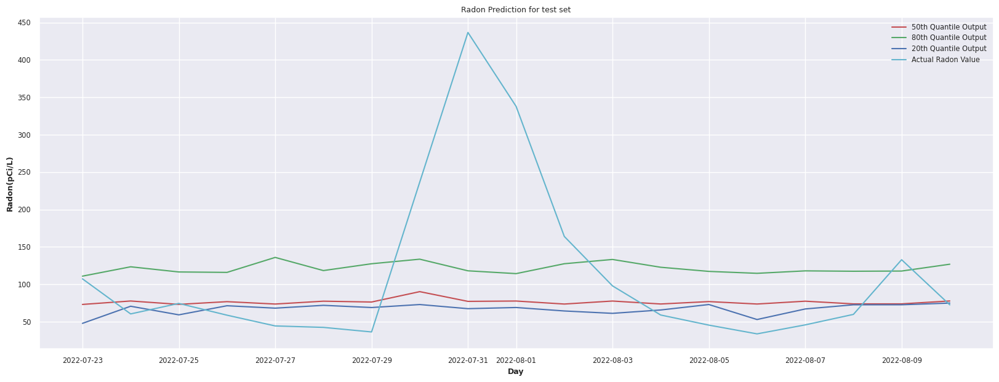

In [48]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 9

In [49]:
#using 21 as the example since it has the most data
df = df_radon['9']

In [50]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6507 entries, 0 to 6506
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     6507 non-null   object        
 1   DeviceName   6507 non-null   object        
 2   SyncDate     6507 non-null   datetime64[ns]
 3   Radon        6507 non-null   float64       
 4   eC02         6507 non-null   int64         
 5   VOC          6507 non-null   int64         
 6   Temperature  6507 non-null   int64         
 7   AirPressure  6507 non-null   float64       
 8   Humidity     6507 non-null   int64         
 9   LogIndex     6507 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 559.2+ KB


In [51]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [52]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:02:44,49,73,30.03,4.70
1,2023-02-11 17:02:44,50,69,30.07,5.50
2,2023-02-11 16:02:44,54,61,30.08,5.40
3,2023-02-11 15:02:44,55,59,30.08,6.00
4,2023-02-11 14:02:44,54,57,30.13,6.00
...,...,...,...,...,...
6502,2022-05-10 04:48:28,56,76,30.16,7.90
6503,2022-05-10 03:48:28,56,75,30.16,6.80
6504,2022-05-10 02:48:28,57,74,30.16,5.30
6505,2022-05-10 01:48:28,58,74,30.17,3.80


In [53]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [54]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,76.62,53.71,30.19,10.74
2022-05-11,80.50,52.46,30.15,22.81
2022-05-12,81.92,49.92,30.07,17.61
2022-05-13,74.58,60.96,30.03,8.23
2022-05-14,78.88,59.38,30.00,7.87
...,...,...,...,...
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94
2023-02-09,62.78,69.74,30.12,2.90


In [55]:
df = df[df.index<= '2022-08-10']

In [56]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-05-10,76.62,53.71,30.19,10.74
2022-05-11,80.50,52.46,30.15,22.81
2022-05-12,81.92,49.92,30.07,17.61
2022-05-13,74.58,60.96,30.03,8.23
2022-05-14,78.88,59.38,30.00,7.87
...,...,...,...,...
2022-08-06,81.08,90.62,30.21,48.61
2022-08-07,80.09,90.17,30.21,57.94
2022-08-08,81.58,89.75,30.14,61.90


In [57]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [58]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [59]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [60]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [61]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [62]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,76.62,53.71,30.19,10.74,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,80.50,52.46,30.15,22.81,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,81.92,49.92,30.07,17.61,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,74.58,60.96,30.03,8.23,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,78.88,59.38,30.00,7.87,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,81.08,90.62,30.21,48.61,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,80.09,90.17,30.21,57.94,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,81.58,89.75,30.14,61.90,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [63]:
df.dropna(inplace=True)

In [64]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-05-10,76.62,53.71,30.19,10.74,65.19,0.15,0.57,3.47,294.31,0.00,...,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,80.50,52.46,30.15,22.81,69.33,0.18,0.65,3.28,290.86,0.00,...,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,81.92,49.92,30.07,17.61,71.16,0.28,0.94,3.61,292.67,0.00,...,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,74.58,60.96,30.03,8.23,69.27,0.24,1.18,6.06,287.73,0.00,...,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,78.88,59.38,30.00,7.87,70.23,0.12,0.52,4.22,294.85,0.00,...,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-06,81.08,90.62,30.21,48.61,77.86,0.13,0.62,3.83,231.74,0.08,...,0.26,0.23,35.55,29.16,84.63,1.01,128.83,29.16,231.71,0.12
2022-08-07,80.09,90.17,30.21,57.94,76.39,0.08,0.40,2.74,306.71,0.00,...,0.02,2.18,37.49,29.16,86.29,1.33,161.91,29.16,309.38,0.05
2022-08-08,81.58,89.75,30.14,61.90,78.21,0.08,0.37,3.85,304.09,0.00,...,0.02,2.18,37.50,29.09,83.98,1.17,144.89,29.09,310.00,0.02


In [65]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [66]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [67]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,84.39,69.27,30.05,51.36,76.83,0.18,0.75,4.30,293.74,0.01,0.15,0.05,0.37,2.15,28.44,29.00,77.70,29.00,301.24,0.10
std,5.09,14.74,0.09,66.67,4.29,0.11,0.40,1.50,10.43,0.02,0.35,0.15,0.68,2.21,4.48,0.09,8.79,0.09,9.53,0.09
min,72.58,44.21,29.86,0.53,65.19,0.02,0.17,2.04,231.74,0.00,0.00,0.00,0.00,0.00,22.72,28.81,50.50,28.81,231.71,0.00
25%,80.96,58.54,29.98,16.92,74.01,0.11,0.51,3.33,288.05,0.00,0.00,0.00,0.00,0.64,25.40,28.93,72.20,28.93,298.84,0.04
50%,83.96,68.00,30.05,25.15,77.24,0.15,0.62,4.07,295.40,0.00,0.00,0.00,0.02,0.76,26.05,29.00,77.62,29.00,302.76,0.08
75%,87.42,83.42,30.11,58.91,79.63,0.24,0.94,5.02,300.25,0.00,0.09,0.01,0.40,3.43,31.96,29.07,83.47,29.07,306.52,0.13
max,96.62,90.92,30.21,383.82,86.16,0.65,2.44,9.81,310.53,0.08,2.11,0.74,2.67,8.01,37.50,29.16,93.24,29.16,314.83,0.45


In [68]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [69]:
df.fillna(0, inplace=True)

In [70]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Yearly Rain (in),0.59
Humidity,0.56
Humidity_lag_1,0.53
Yearly Rain (in)_lag_1,0.52
...,...
Avg Wind Speed (10 mins) (mph),-0.29
Wind Gust (mph),-0.30
Wind Speed (mph),-0.32
Avg Wind Speed (10 mins) (mph)_lag_1,-0.33


In [71]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Yearly Rain (in) 0.5893116748025733
Humidity 0.556200114029641
Humidity_lag_1 0.5296450923952701
Yearly Rain (in)_lag_1 0.5222581347836044
Yearly Rain (in)_lag_39 0.48875346516846063
Outdoor h Temperature (°F)_lag_39 0.48769721765652935
Temperature_lag_39 0.48310016831114
Outdoor h Temperature (°F)_lag_38 0.4798877740144988
Yearly Rain (in)_lag_38 0.47764399069216223
Temperature_lag_38 0.47609350345443807
Humidity_lag_2 0.475595723301739
Yearly Rain (in)_lag_37 0.4689757931770926
Outdoor h Temperature (°F)_lag_37 0.46680652484631796
Wind Direction (°)_lag_39 0.46228775863628735
Temperature_lag_37 0.4618627624146429
Yearly Rain (in)_lag_2 0.46066294287678217
Yearly Rain (in)_lag_36 0.45973151012222585
Avg Wind Direction (10 mins) (°)_lag_39 0.45784235173711024
AirPressure_lag_39 0.45522552054536497
Relative Pressure (inHg)_lag_39 0.45521570604016803
Absolute Pressure (inHg)_lag_39 0.45521570604016803
Wind Direction (°)_lag_38 0.45122505974337784
Yearly Rain (in)_lag_35 0.45108

In [72]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.58]
df_corrH

,Radon
Radon,1.00
Yearly Rain (in),0.59


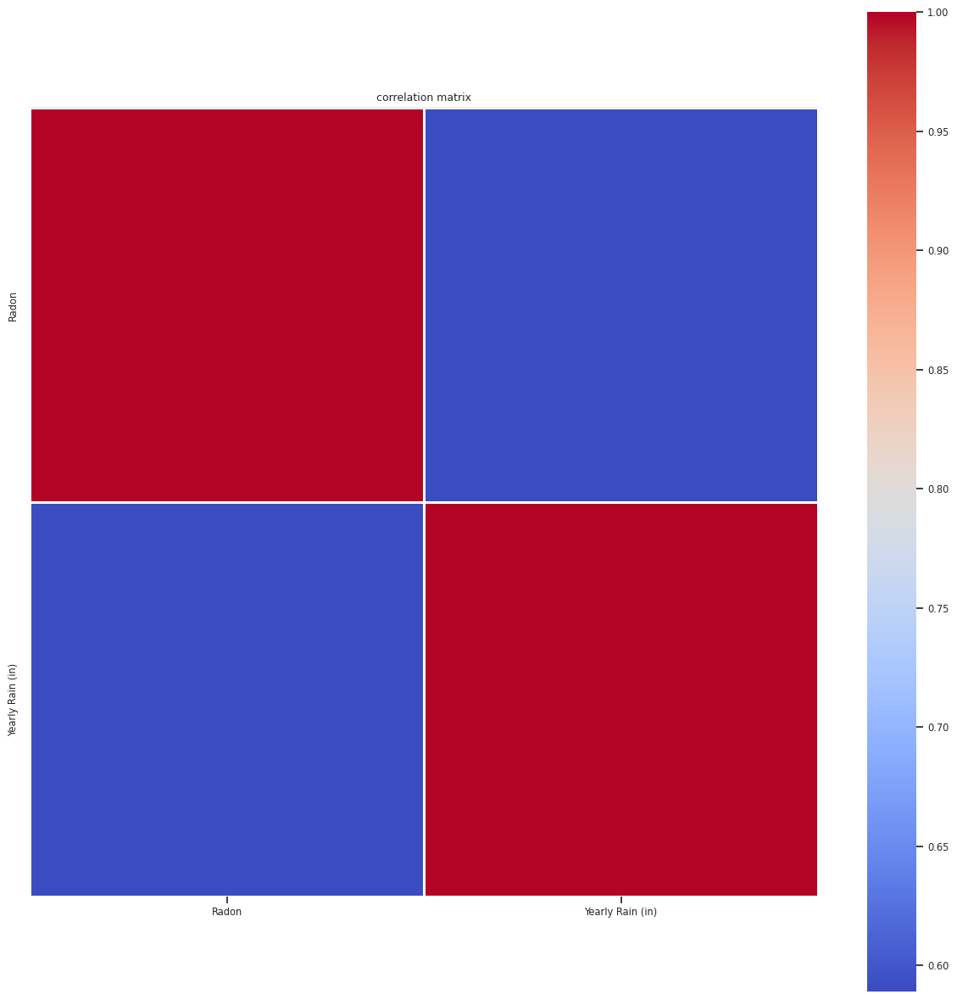

In [73]:
# correlation matrix, limited to highly correlated features
df3 = df[df_corrH.index]

idx = df3.corr().sort_values("Radon", ascending=False).index
df3_sorted = df3.loc[:, idx]  # sort dataframe columns by their correlation with Appliances

plt.figure(figsize = (15,15))
sns.set(font_scale=0.75)
ax = sns.heatmap(df3_sorted.corr().round(3), 
            annot=False, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
ax.xaxis.tick_bottom()
plt.title("correlation matrix")
plt.show()

In [74]:
df3 = df[df_corrH.index]
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-05-10 to 2022-08-10
Freq: D
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Radon             93 non-null     float32
 1   Yearly Rain (in)  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [75]:
df3.fillna(0, inplace=True)

In [76]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-05-10 to 2022-08-10
Freq: D
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Radon             93 non-null     float32
 1   Yearly Rain (in)  93 non-null     float32
dtypes: float32(2)
memory usage: 1.5 KB


In [77]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df3["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [78]:
# create time series object for the feature columns
df_covF = df3.loc[:, df3.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['Yearly Rain (in)'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [79]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 1, 1)

In [80]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [81]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-05-10 00:00:00
training end: 2022-07-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-07-23 00:00:00
test end: 2022-08-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-05-10,0.03
2022-08-10,0.35


In [82]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,Yearly Rain (in)
SyncDate,
2022-05-10,0.00
2022-08-10,1.33


In [83]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-05-10,0.03
2022-07-22,0.79


In [84]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [85]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [86]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [87]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-23 04:44:03 (running for 00:00:00.24)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |         lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------

(build_fit_tft_model pid=1422718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1422718)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1422718) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422718)   rank_zero_deprecation(
(build_fit_tft_model pid=1422718) Auto select gpus: [0]
(build_fit_tft_model pid=1422718) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422718) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422718) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422718) HPU available: False, using: 0 HPUs
(build_fit_tft

Trial name,date,done,episodes_total,experiment_id,experiment_tag,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_0020213f,2023-02-23_04-57-22,True,,23b61d3f66aa4e57966fd6f3f7da0f72,"44_dropout=0.3495,in_len=64,include_hour=False,lr=0.0028,lstm_layers=2,num_attention_heads=10,out_len=3",ip-172-31-10-87,72,0.178921,172.31.10.87,1436930,0.804156,15.1759,0.160553,15.1759,1677128242,0,,72,0020213f,0.00586343
build_fit_tft_model_015900bc,2023-02-23_07-13-01,True,,0ee7026e5a334f178ea365bc6a7dabef,,ip-172-31-10-87,20,0.234116,172.31.10.87,1593897,0.893208,7.14105,0.151699,7.14105,1677136381,0,,20,015900bc,0.00466514
build_fit_tft_model_016d143d,2023-02-23_04-51-36,True,,39af62d725e2499b9464096552db19f6,,ip-172-31-10-87,10,0.420832,172.31.10.87,1430544,1.23085,5.83843,0.16204,5.83843,1677127896,0,,10,016d143d,0.00531316
build_fit_tft_model_0176e8f0,2023-02-23_05-23-12,True,,81636aacd3834794b38a69527241b5dc,"129_dropout=0.3419,in_len=8,include_hour=False,lr=0.0159,lstm_layers=2,num_attention_heads=11,out_len=2",ip-172-31-10-87,43,0.247905,172.31.10.87,1466406,0.598639,15.5517,0.31147,15.5517,1677129792,0,,43,0176e8f0,0.00495172
build_fit_tft_model_01e2caa7,2023-02-23_05-39-33,True,,237cc61c61394e49b17f74f741352444,,ip-172-31-10-87,20,0.260036,172.31.10.87,1485462,0.900417,8.00323,0.167332,8.00323,1677130773,0,,20,01e2caa7,0.00557709
build_fit_tft_model_03154251,2023-02-23_06-12-23,True,,0a485b926f414f4281091a86d43223e3,,ip-172-31-10-87,10,0.2951,172.31.10.87,1523088,1.38803,5.94944,0.168597,5.94944,1677132743,0,,10,03154251,0.00511789
build_fit_tft_model_034cca34,2023-02-23_05-04-16,True,,1f009b7ca18347c2a79b784b43ee4011,"67_dropout=0.4615,in_len=8,include_hour=False,lr=0.0064,lstm_layers=1,num_attention_heads=8,out_len=3",ip-172-31-10-87,67,0.148532,172.31.10.87,1444712,0.57808,16.9069,0.185632,16.9069,1677128656,0,,67,034cca34,0.00564766
build_fit_tft_model_03577653,2023-02-23_06-57-46,True,,602c3b6243b046b881408f9912a22d3f,,ip-172-31-10-87,10,0.449967,172.31.10.87,1578758,1.57128,6.81652,0.218256,6.81652,1677135466,0,,10,03577653,0.00540066
build_fit_tft_model_0390a9c7,2023-02-23_06-05-21,True,,6e098e25154243b8a142468dde1763ed,,ip-172-31-10-87,10,0.357383,172.31.10.87,1514936,1.11759,7.12949,0.287218,7.12949,1677132321,0,,10,0390a9c7,0.00507069
build_fit_tft_model_03953315,2023-02-23_05-14-20,True,,ee279e434f0a4715aeff49869a7a2dd1,,ip-172-31-10-87,10,0.315971,172.31.10.87,1456373,1.12883,6.02935,0.197618,6.02935,1677129260,0,,10,03953315,0.00802183


== Status ==
Current time: 2023-02-23 04:44:16 (running for 00:00:13.11)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed3e8fa4 with sMAPE=1.2440729141235352 and parameters={'in_len': 8, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.11046977761989779, 'lr': 0.0010753477093475563, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----------------------+
| Trial name                   | status 

== Status ==
Current time: 2023-02-23 04:44:37 (running for 00:00:33.68)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0640181303024292 | Iter 20.000: -1.1702063083648682 | Iter 10.000: -1.542937159538269
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed3e8fa4 with sMAPE=1.2274478673934937 and parameters={'in_len': 8, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.11046977761989779, 'lr': 0.0010753477093475563, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+--------------------

(build_fit_tft_model pid=1423314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423314)   rank_zero_deprecation(
(build_fit_tft_model pid=1423314) Auto select gpus: [0]
(build_fit_tft_model pid=1423314) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423314) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423314) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423314) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423314) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423314) 
(build_fit_tft_model pid=1423314)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423314) ---------------

== Status ==
Current time: 2023-02-23 04:44:53 (running for 00:00:50.34)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0640181303024292 | Iter 20.000: -1.1702063083648682 | Iter 10.000: -1.542937159538269
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed3e8fa4 with sMAPE=1.0626447200775146 and parameters={'in_len': 8, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.11046977761989779, 'lr': 0.0010753477093475563, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----

(build_fit_tft_model pid=1423645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423645)   rank_zero_deprecation(
(build_fit_tft_model pid=1423645) Auto select gpus: [0]
(build_fit_tft_model pid=1423645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423645) 
(build_fit_tft_model pid=1423645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423645) ---------------

== Status ==
Current time: 2023-02-23 04:45:11 (running for 00:01:07.94)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0640181303024292 | Iter 20.000: -1.2571666836738586 | Iter 10.000: -1.226352483034134
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed3e8fa4 with sMAPE=1.0626447200775146 and parameters={'in_len': 8, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.11046977761989779, 'lr': 0.0010753477093475563, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----

(build_fit_tft_model pid=1423886) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423886)   rank_zero_deprecation(
(build_fit_tft_model pid=1423886) Auto select gpus: [0]
(build_fit_tft_model pid=1423886) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423886) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423886) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423886) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423886) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423886) 
(build_fit_tft_model pid=1423886)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423886) ---------------

== Status ==
Current time: 2023-02-23 04:45:26 (running for 00:01:23.38)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0640181303024292 | Iter 20.000: -1.2571666836738586 | Iter 10.000: -1.542937159538269
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed3e8fa4 with sMAPE=1.0626447200775146 and parameters={'in_len': 8, 'out_len': 2, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.11046977761989779, 'lr': 0.0010753477093475563, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+----

(build_fit_tft_model pid=1424238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424238)   rank_zero_deprecation(
(build_fit_tft_model pid=1424238) Auto select gpus: [0]
(build_fit_tft_model pid=1424238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424238) 
(build_fit_tft_model pid=1424238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424238) ---------------

== Status ==
Current time: 2023-02-23 04:45:46 (running for 00:01:42.78)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.0640181303024292 | Iter 20.000: -1.1702063083648682 | Iter 10.000: -1.3555170893669128
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 79a10252 with sMAPE=0.7962209582328796 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.2135699519866479, 'lr': 0.04037289273637231, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+---

(build_fit_tft_model pid=1424566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424566)   rank_zero_deprecation(
(build_fit_tft_model pid=1424566) Auto select gpus: [0]
(build_fit_tft_model pid=1424566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424566) 
(build_fit_tft_model pid=1424566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424566) ---------------

== Status ==
Current time: 2023-02-23 04:46:06 (running for 00:02:03.26)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9259412586688995 | Iter 20.000: -1.145575225353241 | Iter 10.000: -1.2012642621994019
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 79a10252 with sMAPE=0.7878643870353699 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.2135699519866479, 'lr': 0.04037289273637231, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----

(build_fit_tft_model pid=1424879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424879)   rank_zero_deprecation(
(build_fit_tft_model pid=1424879) Auto select gpus: [0]
(build_fit_tft_model pid=1424879) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424879) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424879) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424879) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424879) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424879) 
(build_fit_tft_model pid=1424879)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424879) ---------------

== Status ==
Current time: 2023-02-23 04:46:23 (running for 00:02:19.65)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.9259412586688995 | Iter 20.000: -1.147666096687317 | Iter 10.000: -1.1846806406974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 79a10252 with sMAPE=0.7878643870353699 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 6, 'dropout': 0.2135699519866479, 'lr': 0.04037289273637231, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----

(build_fit_tft_model pid=1425267) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1425267)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1425267) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425267)   rank_zero_deprecation(
(build_fit_tft_model pid=1425267) Auto select gpus: [0]
(build_fit_tft_model pid=1425267) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425267) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425267) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425267) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:46:45 (running for 00:02:41.80)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1343051195144653 | Iter 10.000: -1.1680970191955566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1425534) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1425534)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1425534) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425534)   rank_zero_deprecation(
(build_fit_tft_model pid=1425534) Auto select gpus: [0]
(build_fit_tft_model pid=1425534) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425534) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425534) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425534) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:01 (running for 00:02:57.90)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1343051195144653 | Iter 10.000: -1.1846806406974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1425882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425882)   rank_zero_deprecation(
(build_fit_tft_model pid=1425882) Auto select gpus: [0]
(build_fit_tft_model pid=1425882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1425882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1425882) 
(build_fit_tft_model pid=1425882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1425882) ---------------

== Status ==
Current time: 2023-02-23 04:47:16 (running for 00:03:13.42)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1343051195144653 | Iter 10.000: -1.2012642621994019
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1426099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1426099)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1426099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426099)   rank_zero_deprecation(
(build_fit_tft_model pid=1426099) Auto select gpus: [0]
(build_fit_tft_model pid=1426099) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426099) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426099) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426099) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:47:32 (running for 00:03:29.36)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.147666096687317 | Iter 10.000: -1.1846806406974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1426450) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426450)   rank_zero_deprecation(
(build_fit_tft_model pid=1426450) Auto select gpus: [0]
(build_fit_tft_model pid=1426450) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426450) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426450) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426450) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1426450) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1426450) 
(build_fit_tft_model pid=1426450)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1426450) ---------------

== Status ==
Current time: 2023-02-23 04:47:50 (running for 00:03:46.67)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1589362025260925 | Iter 10.000: -1.1680970191955566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 04:48:01 (running for 00:03:58.40)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.147666096687317 | Iter 10.000: -1.1334794163703918
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1426776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426776)   rank_zero_deprecation(
(build_fit_tft_model pid=1426776) Auto select gpus: [0]
(build_fit_tft_model pid=1426776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426776) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1426776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1426776) 
(build_fit_tft_model pid=1426776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1426776) ---------------

== Status ==
Current time: 2023-02-23 04:48:09 (running for 00:04:06.34)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.147666096687317 | Iter 10.000: -1.1334794163703918
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1427113) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427113)   rank_zero_deprecation(
(build_fit_tft_model pid=1427113) Auto select gpus: [0]
(build_fit_tft_model pid=1427113) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427113) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427113) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427113) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427113) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427113) 
(build_fit_tft_model pid=1427113)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427113) ---------------

== Status ==
Current time: 2023-02-23 04:48:23 (running for 00:04:20.59)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.147666096687317 | Iter 10.000: -1.1680970191955566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1427327) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427327)   rank_zero_deprecation(
(build_fit_tft_model pid=1427327) Auto select gpus: [0]
(build_fit_tft_model pid=1427327) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427327) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427327) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427327) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427327) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427327) 
(build_fit_tft_model pid=1427327)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427327) ---------------

== Status ==
Current time: 2023-02-23 04:48:38 (running for 00:04:34.66)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.147666096687317 | Iter 10.000: -1.1846806406974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 04:48:49 (running for 00:04:46.43)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.936528354883194 | Iter 20.000: -1.136076807975769 | Iter 10.000: -1.1680970191955566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1427700) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427700)   rank_zero_deprecation(
(build_fit_tft_model pid=1427700) Auto select gpus: [0]
(build_fit_tft_model pid=1427700) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427700) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427700) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427700) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427700) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427700) 
(build_fit_tft_model pid=1427700)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427700) ---------------

== Status ==
Current time: 2023-02-23 04:48:57 (running for 00:04:54.29)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.936528354883194 | Iter 20.000: -1.136076807975769 | Iter 10.000: -1.1680970191955566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 04:49:07 (running for 00:05:04.39)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1244875192642212 | Iter 10.000: -1.1508838534355164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1428160) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428160)   rank_zero_deprecation(
(build_fit_tft_model pid=1428160) Auto select gpus: [0]
(build_fit_tft_model pid=1428160) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428160) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428160) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428160) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428160) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428160) 
(build_fit_tft_model pid=1428160)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428160) ---------------

== Status ==
Current time: 2023-02-23 04:49:22 (running for 00:05:19.54)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1244875192642212 | Iter 10.000: -1.1508838534355164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1428479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428479)   rank_zero_deprecation(
(build_fit_tft_model pid=1428479) Auto select gpus: [0]
(build_fit_tft_model pid=1428479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428479) 
(build_fit_tft_model pid=1428479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428479) ---------------

== Status ==
Current time: 2023-02-23 04:49:38 (running for 00:05:34.72)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1244875192642212 | Iter 10.000: -1.1680970191955566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:49:51 (running for 00:05:48.43)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.1227158308029175 | Iter 10.000: -1.1508838534355164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1428837) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428837)   rank_zero_deprecation(
(build_fit_tft_model pid=1428837) Auto select gpus: [0]
(build_fit_tft_model pid=1428837) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428837) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428837) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428837) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428837) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428837) 
(build_fit_tft_model pid=1428837)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428837) ---------------

== Status ==
Current time: 2023-02-23 04:49:59 (running for 00:05:55.75)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.1227158308029175 | Iter 10.000: -1.1508838534355164
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:50:11 (running for 00:06:08.42)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1209441423416138 | Iter 10.000: -1.133670687675476
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1429188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429188)   rank_zero_deprecation(
(build_fit_tft_model pid=1429188) Auto select gpus: [0]
(build_fit_tft_model pid=1429188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429188) 
(build_fit_tft_model pid=1429188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429188) ---------------

== Status ==
Current time: 2023-02-23 04:50:19 (running for 00:06:16.00)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.1209441423416138 | Iter 10.000: -1.133670687675476
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1429424) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429424)   rank_zero_deprecation(
(build_fit_tft_model pid=1429424) Auto select gpus: [0]
(build_fit_tft_model pid=1429424) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429424) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429424) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429424) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429424) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429424) 
(build_fit_tft_model pid=1429424)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429424) ---------------

== Status ==
Current time: 2023-02-23 04:50:36 (running for 00:06:33.33)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.8090385794639587 | Iter 20.000: -1.0519907176494598 | Iter 10.000: -1.1162662506103516
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:50:46 (running for 00:06:43.47)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0435746908187866 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1429897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429897)   rank_zero_deprecation(
(build_fit_tft_model pid=1429897) Auto select gpus: [0]
(build_fit_tft_model pid=1429897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429897) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429897) 
(build_fit_tft_model pid=1429897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429897) ---------------

== Status ==
Current time: 2023-02-23 04:51:00 (running for 00:06:57.08)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0435746908187866 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1430237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430237)   rank_zero_deprecation(
(build_fit_tft_model pid=1430237) Auto select gpus: [0]
(build_fit_tft_model pid=1430237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430237) 
(build_fit_tft_model pid=1430237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430237) ---------------

== Status ==
Current time: 2023-02-23 04:51:17 (running for 00:07:13.79)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0133059918880463 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1430544) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430544)   rank_zero_deprecation(
(build_fit_tft_model pid=1430544) Auto select gpus: [0]
(build_fit_tft_model pid=1430544) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430544) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430544) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430544) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430544) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430544) 
(build_fit_tft_model pid=1430544)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430544) ---------------

== Status ==
Current time: 2023-02-23 04:51:35 (running for 00:07:32.30)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1430819) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430819)   rank_zero_deprecation(
(build_fit_tft_model pid=1430819) Auto select gpus: [0]
(build_fit_tft_model pid=1430819) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430819) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430819) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430819) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430819) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430819) 
(build_fit_tft_model pid=1430819)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430819) ---------------

== Status ==
Current time: 2023-02-23 04:51:51 (running for 00:07:47.71)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1431176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431176)   rank_zero_deprecation(
(build_fit_tft_model pid=1431176) Auto select gpus: [0]
(build_fit_tft_model pid=1431176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431176) 
(build_fit_tft_model pid=1431176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431176) ---------------

== Status ==
Current time: 2023-02-23 04:52:07 (running for 00:08:04.37)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1431508) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431508)   rank_zero_deprecation(
(build_fit_tft_model pid=1431508) Auto select gpus: [0]
(build_fit_tft_model pid=1431508) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431508) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431508) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431508) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431508) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431508) 
(build_fit_tft_model pid=1431508)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431508) ---------------

== Status ==
Current time: 2023-02-23 04:52:22 (running for 00:08:19.41)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1431842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431842)   rank_zero_deprecation(
(build_fit_tft_model pid=1431842) Auto select gpus: [0]
(build_fit_tft_model pid=1431842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431842) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431842) 
(build_fit_tft_model pid=1431842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431842) ---------------

== Status ==
Current time: 2023-02-23 04:52:38 (running for 00:08:34.65)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1432058) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1432058)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1432058) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432058)   rank_zero_deprecation(
(build_fit_tft_model pid=1432058) Auto select gpus: [0]
(build_fit_tft_model pid=1432058) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432058) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432058) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432058) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:52:53 (running for 00:08:50.34)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:53:06 (running for 00:09:03.46)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1432408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432408)   rank_zero_deprecation(
(build_fit_tft_model pid=1432408) Auto select gpus: [0]
(build_fit_tft_model pid=1432408) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432408) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432408) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432408) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432408) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432408) 
(build_fit_tft_model pid=1432408)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432408) ---------------

== Status ==
Current time: 2023-02-23 04:53:14 (running for 00:09:11.03)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1432745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1432745)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1432745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432745)   rank_zero_deprecation(
(build_fit_tft_model pid=1432745) Auto select gpus: [0]
(build_fit_tft_model pid=1432745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432745) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:53:29 (running for 00:09:25.97)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1432937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432937)   rank_zero_deprecation(
(build_fit_tft_model pid=1432937) Auto select gpus: [0]
(build_fit_tft_model pid=1432937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432937) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432937) 
(build_fit_tft_model pid=1432937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432937) ---------------

== Status ==
Current time: 2023-02-23 04:53:44 (running for 00:09:40.95)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1433208) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433208)   rank_zero_deprecation(
(build_fit_tft_model pid=1433208) Auto select gpus: [0]
(build_fit_tft_model pid=1433208) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433208) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433208) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433208) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433208) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433208) 
(build_fit_tft_model pid=1433208)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433208) ---------------

== Status ==
Current time: 2023-02-23 04:54:00 (running for 00:09:57.45)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:54:11 (running for 00:10:08.48)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1433604) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433604)   rank_zero_deprecation(
(build_fit_tft_model pid=1433604) Auto select gpus: [0]
(build_fit_tft_model pid=1433604) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433604) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433604) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433604) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433604) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433604) 
(build_fit_tft_model pid=1433604)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433604) ---------------

== Status ==
Current time: 2023-02-23 04:54:19 (running for 00:10:16.00)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1433841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433841)   rank_zero_deprecation(
(build_fit_tft_model pid=1433841) Auto select gpus: [0]
(build_fit_tft_model pid=1433841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433841) 
(build_fit_tft_model pid=1433841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433841) ---------------

== Status ==
Current time: 2023-02-23 04:54:34 (running for 00:10:30.83)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1434220) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434220)   rank_zero_deprecation(
(build_fit_tft_model pid=1434220) Auto select gpus: [0]
(build_fit_tft_model pid=1434220) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434220) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434220) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434220) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434220) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434220) 
(build_fit_tft_model pid=1434220)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434220) ---------------

== Status ==
Current time: 2023-02-23 04:54:52 (running for 00:10:48.66)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1434543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434543)   rank_zero_deprecation(
(build_fit_tft_model pid=1434543) Auto select gpus: [0]
(build_fit_tft_model pid=1434543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434543) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434543) 
(build_fit_tft_model pid=1434543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434543) ---------------

== Status ==
Current time: 2023-02-23 04:55:07 (running for 00:11:04.08)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7984514832496643 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:55:20 (running for 00:11:17.47)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1434898) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434898)   rank_zero_deprecation(
(build_fit_tft_model pid=1434898) Auto select gpus: [0]
(build_fit_tft_model pid=1434898) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434898) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434898) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434898) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434898) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434898) 
(build_fit_tft_model pid=1434898)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434898) ---------------

== Status ==
Current time: 2023-02-23 04:55:28 (running for 00:11:25.08)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1435214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435214)   rank_zero_deprecation(
(build_fit_tft_model pid=1435214) Auto select gpus: [0]
(build_fit_tft_model pid=1435214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435214) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435214) 
(build_fit_tft_model pid=1435214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435214) ---------------

== Status ==
Current time: 2023-02-23 04:55:44 (running for 00:11:41.14)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1435562) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435562)   rank_zero_deprecation(
(build_fit_tft_model pid=1435562) Auto select gpus: [0]
(build_fit_tft_model pid=1435562) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435562) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435562) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435562) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435562) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435562) 
(build_fit_tft_model pid=1435562)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435562) ---------------

== Status ==
Current time: 2023-02-23 04:56:00 (running for 00:11:56.82)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1435808) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435808)   rank_zero_deprecation(
(build_fit_tft_model pid=1435808) Auto select gpus: [0]
(build_fit_tft_model pid=1435808) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435808) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435808) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435808) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435808) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435808) 
(build_fit_tft_model pid=1435808)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435808) ---------------

== Status ==
Current time: 2023-02-23 04:56:15 (running for 00:12:12.23)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1436169) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436169)   rank_zero_deprecation(
(build_fit_tft_model pid=1436169) Auto select gpus: [0]
(build_fit_tft_model pid=1436169) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436169) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436169) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436169) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436169) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436169) 
(build_fit_tft_model pid=1436169)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436169) ---------------

== Status ==
Current time: 2023-02-23 04:56:30 (running for 00:12:27.37)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1436511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436511)   rank_zero_deprecation(
(build_fit_tft_model pid=1436511) Auto select gpus: [0]
(build_fit_tft_model pid=1436511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436511) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436511) 
(build_fit_tft_model pid=1436511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436511) ---------------

== Status ==
Current time: 2023-02-23 04:56:47 (running for 00:12:44.39)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7878643870353699 | Iter 20.000: -1.0321050882339478 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:56:57 (running for 00:12:54.49)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7863264679908752 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1436930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436930)   rank_zero_deprecation(
(build_fit_tft_model pid=1436930) Auto select gpus: [0]
(build_fit_tft_model pid=1436930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436930) 
(build_fit_tft_model pid=1436930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436930) ---------------

== Status ==
Current time: 2023-02-23 04:57:11 (running for 00:13:07.77)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7863264679908752 | Iter 20.000: -1.0075711905956268 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:57:21 (running for 00:13:17.95)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1437352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437352)   rank_zero_deprecation(
(build_fit_tft_model pid=1437352) Auto select gpus: [0]
(build_fit_tft_model pid=1437352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437352) 
(build_fit_tft_model pid=1437352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437352) ---------------

== Status ==
Current time: 2023-02-23 04:57:35 (running for 00:13:32.49)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1437664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437664)   rank_zero_deprecation(
(build_fit_tft_model pid=1437664) Auto select gpus: [0]
(build_fit_tft_model pid=1437664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437664) 
(build_fit_tft_model pid=1437664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437664) ---------------

== Status ==
Current time: 2023-02-23 04:57:50 (running for 00:13:46.93)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1437912) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437912)   rank_zero_deprecation(
(build_fit_tft_model pid=1437912) Auto select gpus: [0]
(build_fit_tft_model pid=1437912) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437912) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437912) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437912) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437912) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437912) 
(build_fit_tft_model pid=1437912)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437912) ---------------

== Status ==
Current time: 2023-02-23 04:58:06 (running for 00:14:03.38)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9938301146030426 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

== Status ==
Current time: 2023-02-23 04:58:18 (running for 00:14:15.47)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7863264679908752 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1438321) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438321)   rank_zero_deprecation(
(build_fit_tft_model pid=1438321) Auto select gpus: [0]
(build_fit_tft_model pid=1438321) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438321) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438321) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438321) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438321) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438321) 
(build_fit_tft_model pid=1438321)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438321) ---------------

== Status ==
Current time: 2023-02-23 04:58:26 (running for 00:14:22.96)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7863264679908752 | Iter 20.000: -0.9830372929573059 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 8fe41f15 with sMAPE=0.5411266684532166 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 1, 'num_attention_heads': 7, 'dropout': 0.29089402228835604, 'lr': 0.0035245822413021654, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

== Status ==
Current time: 2023-02-23 04:58:40 (running for 00:14:37.50)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9749549627304077 | Iter 10.000: -1.0947626233100891
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1438685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438685)   rank_zero_deprecation(
(build_fit_tft_model pid=1438685) Auto select gpus: [0]
(build_fit_tft_model pid=1438685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438685) 
(build_fit_tft_model pid=1438685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438685) ---------------

== Status ==
Current time: 2023-02-23 04:58:48 (running for 00:14:45.59)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9749549627304077 | Iter 10.000: -1.0947626233100891
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1439041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439041)   rank_zero_deprecation(
(build_fit_tft_model pid=1439041) Auto select gpus: [0]
(build_fit_tft_model pid=1439041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439041) 
(build_fit_tft_model pid=1439041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439041) ---------------

== Status ==
Current time: 2023-02-23 04:59:04 (running for 00:15:01.36)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9749549627304077 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1439346) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439346)   rank_zero_deprecation(
(build_fit_tft_model pid=1439346) Auto select gpus: [0]
(build_fit_tft_model pid=1439346) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439346) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439346) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439346) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439346) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439346) 
(build_fit_tft_model pid=1439346)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439346) ---------------

== Status ==
Current time: 2023-02-23 04:59:19 (running for 00:15:16.21)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7847885489463806 | Iter 20.000: -0.9749549627304077 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 04:59:29 (running for 00:15:26.31)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7833227217197418 | Iter 20.000: -0.9668726325035095 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1439762) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439762)   rank_zero_deprecation(
(build_fit_tft_model pid=1439762) Auto select gpus: [0]
(build_fit_tft_model pid=1439762) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439762) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439762) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439762) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439762) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439762) 
(build_fit_tft_model pid=1439762)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439762) ---------------

== Status ==
Current time: 2023-02-23 04:59:42 (running for 00:15:39.45)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7833227217197418 | Iter 20.000: -0.9668726325035095 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1440069) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440069)   rank_zero_deprecation(
(build_fit_tft_model pid=1440069) Auto select gpus: [0]
(build_fit_tft_model pid=1440069) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440069) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440069) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440069) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440069) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440069) 
(build_fit_tft_model pid=1440069)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440069) ---------------

== Status ==
Current time: 2023-02-23 04:59:57 (running for 00:15:54.56)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7833227217197418 | Iter 20.000: -0.9668726325035095 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1440362) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440362)   rank_zero_deprecation(
(build_fit_tft_model pid=1440362) Auto select gpus: [0]
(build_fit_tft_model pid=1440362) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440362) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440362) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440362) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440362) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440362) 
(build_fit_tft_model pid=1440362)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440362) ---------------

== Status ==
Current time: 2023-02-23 05:00:13 (running for 00:16:09.82)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7833227217197418 | Iter 20.000: -0.9668726325035095 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 05:00:27 (running for 00:16:24.53)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.781856894493103 | Iter 20.000: -0.9590396881103516 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1440853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440853)   rank_zero_deprecation(
(build_fit_tft_model pid=1440853) Auto select gpus: [0]
(build_fit_tft_model pid=1440853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440853) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440853) 
(build_fit_tft_model pid=1440853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440853) ---------------

== Status ==
Current time: 2023-02-23 05:00:35 (running for 00:16:32.01)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.781856894493103 | Iter 20.000: -0.9590396881103516 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1441154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441154)   rank_zero_deprecation(
(build_fit_tft_model pid=1441154) Auto select gpus: [0]
(build_fit_tft_model pid=1441154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441154) 
(build_fit_tft_model pid=1441154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441154) ---------------

== Status ==
Current time: 2023-02-23 05:00:50 (running for 00:16:47.13)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.781856894493103 | Iter 20.000: -0.9590396881103516 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1441422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441422)   rank_zero_deprecation(
(build_fit_tft_model pid=1441422) Auto select gpus: [0]
(build_fit_tft_model pid=1441422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441422) 
(build_fit_tft_model pid=1441422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441422) ---------------

== Status ==
Current time: 2023-02-23 05:01:05 (running for 00:17:02.42)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.781856894493103 | Iter 20.000: -0.9590396881103516 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-23 05:01:15 (running for 00:17:12.57)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7721893191337585 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1441828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441828)   rank_zero_deprecation(
(build_fit_tft_model pid=1441828) Auto select gpus: [0]
(build_fit_tft_model pid=1441828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441828) 
(build_fit_tft_model pid=1441828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441828) ---------------

== Status ==
Current time: 2023-02-23 05:01:30 (running for 00:17:27.28)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7721893191337585 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1442176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442176)   rank_zero_deprecation(
(build_fit_tft_model pid=1442176) Auto select gpus: [0]
(build_fit_tft_model pid=1442176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442176) 
(build_fit_tft_model pid=1442176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442176) ---------------

== Status ==
Current time: 2023-02-23 05:01:45 (running for 00:17:42.57)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7721893191337585 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1442414) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442414)   rank_zero_deprecation(
(build_fit_tft_model pid=1442414) Auto select gpus: [0]
(build_fit_tft_model pid=1442414) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442414) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442414) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442414) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442414) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442414) 
(build_fit_tft_model pid=1442414)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442414) ---------------

== Status ==
Current time: 2023-02-23 05:02:02 (running for 00:17:59.30)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7721893191337585 | Iter 20.000: -0.9565721750259399 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 05:02:12 (running for 00:18:09.48)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+----------

(build_fit_tft_model pid=1442770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442770)   rank_zero_deprecation(
(build_fit_tft_model pid=1442770) Auto select gpus: [0]
(build_fit_tft_model pid=1442770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442770) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442770) 
(build_fit_tft_model pid=1442770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442770) ---------------

== Status ==
Current time: 2023-02-23 05:02:25 (running for 00:18:22.52)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1443071) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1443071)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1443071) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443071)   rank_zero_deprecation(
(build_fit_tft_model pid=1443071) Auto select gpus: [0]
(build_fit_tft_model pid=1443071) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443071) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443071) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443071) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:02:41 (running for 00:18:38.34)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1443410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443410)   rank_zero_deprecation(
(build_fit_tft_model pid=1443410) Auto select gpus: [0]
(build_fit_tft_model pid=1443410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443410) 
(build_fit_tft_model pid=1443410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443410) ---------------

== Status ==
Current time: 2023-02-23 05:02:57 (running for 00:18:54.01)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9512067437171936 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 05:03:08 (running for 00:19:05.54)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9469018280506134 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1443766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443766)   rank_zero_deprecation(
(build_fit_tft_model pid=1443766) Auto select gpus: [0]
(build_fit_tft_model pid=1443766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443766) 
(build_fit_tft_model pid=1443766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443766) ---------------

== Status ==
Current time: 2023-02-23 05:03:16 (running for 00:19:13.37)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9469018280506134 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1444036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444036)   rank_zero_deprecation(
(build_fit_tft_model pid=1444036) Auto select gpus: [0]
(build_fit_tft_model pid=1444036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444036) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444036) 
(build_fit_tft_model pid=1444036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444036) ---------------

== Status ==
Current time: 2023-02-23 05:03:32 (running for 00:19:28.86)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9469018280506134 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1444386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444386)   rank_zero_deprecation(
(build_fit_tft_model pid=1444386) Auto select gpus: [0]
(build_fit_tft_model pid=1444386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444386) 
(build_fit_tft_model pid=1444386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444386) ---------------

== Status ==
Current time: 2023-02-23 05:03:48 (running for 00:19:44.89)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9469018280506134 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1444712) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444712)   rank_zero_deprecation(
(build_fit_tft_model pid=1444712) Auto select gpus: [0]
(build_fit_tft_model pid=1444712) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444712) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444712) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444712) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444712) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444712) 
(build_fit_tft_model pid=1444712)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444712) ---------------

== Status ==
Current time: 2023-02-23 05:04:03 (running for 00:20:00.41)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7625217437744141 | Iter 20.000: -0.9469018280506134 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 05:04:14 (running for 00:20:10.81)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7553017437458038 | Iter 20.000: -0.9425969123840332 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1445103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445103)   rank_zero_deprecation(
(build_fit_tft_model pid=1445103) Auto select gpus: [0]
(build_fit_tft_model pid=1445103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445103) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445103) 
(build_fit_tft_model pid=1445103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445103) ---------------

== Status ==
Current time: 2023-02-23 05:04:30 (running for 00:20:26.96)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7553017437458038 | Iter 20.000: -0.9425969123840332 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

== Status ==
Current time: 2023-02-23 05:04:40 (running for 00:20:37.50)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.940946489572525 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-----------

(build_fit_tft_model pid=1445546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1445546)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1445546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445546)   rank_zero_deprecation(
(build_fit_tft_model pid=1445546) Auto select gpus: [0]
(build_fit_tft_model pid=1445546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445546) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:04:53 (running for 00:20:50.33)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.940946489572525 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1445891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1445891)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1445891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445891)   rank_zero_deprecation(
(build_fit_tft_model pid=1445891) Auto select gpus: [0]
(build_fit_tft_model pid=1445891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445891) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:05:09 (running for 00:21:06.30)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.940946489572525 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1446109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446109)   rank_zero_deprecation(
(build_fit_tft_model pid=1446109) Auto select gpus: [0]
(build_fit_tft_model pid=1446109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446109) 
(build_fit_tft_model pid=1446109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446109) ---------------

== Status ==
Current time: 2023-02-23 05:05:24 (running for 00:21:21.56)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.940946489572525 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

(build_fit_tft_model pid=1446378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446378)   rank_zero_deprecation(
(build_fit_tft_model pid=1446378) Auto select gpus: [0]
(build_fit_tft_model pid=1446378) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446378) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446378) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446378) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446378) 
(build_fit_tft_model pid=1446378)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446378) ---------------

== Status ==
Current time: 2023-02-23 05:05:42 (running for 00:21:38.77)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.9392960667610168 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1446614) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446614)   rank_zero_deprecation(
(build_fit_tft_model pid=1446614) Auto select gpus: [0]
(build_fit_tft_model pid=1446614) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446614) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446614) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446614) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446614) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446614) 
(build_fit_tft_model pid=1446614)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446614) ---------------

== Status ==
Current time: 2023-02-23 05:05:56 (running for 00:21:52.85)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.9392960667610168 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------

(build_fit_tft_model pid=1446851) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446851)   rank_zero_deprecation(
(build_fit_tft_model pid=1446851) Auto select gpus: [0]
(build_fit_tft_model pid=1446851) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446851) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446851) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446851) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446851) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446851) 
(build_fit_tft_model pid=1446851)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446851) ---------------

== Status ==
Current time: 2023-02-23 05:06:11 (running for 00:22:08.22)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.9392960667610168 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+

== Status ==
Current time: 2023-02-23 05:06:21 (running for 00:22:18.42)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

== Status ==
Current time: 2023-02-23 05:06:32 (running for 00:22:29.58)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1447325) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447325)   rank_zero_deprecation(
(build_fit_tft_model pid=1447325) Auto select gpus: [0]
(build_fit_tft_model pid=1447325) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447325) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447325) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447325) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447325) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447325) 
(build_fit_tft_model pid=1447325)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447325) ---------------

== Status ==
Current time: 2023-02-23 05:06:40 (running for 00:22:37.56)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1447590) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447590)   rank_zero_deprecation(
(build_fit_tft_model pid=1447590) Auto select gpus: [0]
(build_fit_tft_model pid=1447590) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447590) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447590) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447590) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447590) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447590) 
(build_fit_tft_model pid=1447590)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447590) ---------------

== Status ==
Current time: 2023-02-23 05:06:56 (running for 00:22:53.12)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1447937) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447937)   rank_zero_deprecation(
(build_fit_tft_model pid=1447937) Auto select gpus: [0]
(build_fit_tft_model pid=1447937) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447937) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447937) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447937) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447937) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447937) 
(build_fit_tft_model pid=1447937)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447937) ---------------

== Status ==
Current time: 2023-02-23 05:07:11 (running for 00:23:08.34)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1448256) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448256)   rank_zero_deprecation(
(build_fit_tft_model pid=1448256) Auto select gpus: [0]
(build_fit_tft_model pid=1448256) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448256) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448256) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448256) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448256) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448256) 
(build_fit_tft_model pid=1448256)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448256) ---------------

== Status ==
Current time: 2023-02-23 05:07:26 (running for 00:23:23.55)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1448554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448554)   rank_zero_deprecation(
(build_fit_tft_model pid=1448554) Auto select gpus: [0]
(build_fit_tft_model pid=1448554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448554) 
(build_fit_tft_model pid=1448554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448554) ---------------

== Status ==
Current time: 2023-02-23 05:07:41 (running for 00:23:38.37)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1312265992164612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1448924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448924)   rank_zero_deprecation(
(build_fit_tft_model pid=1448924) Auto select gpus: [0]
(build_fit_tft_model pid=1448924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448924) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448924) 
(build_fit_tft_model pid=1448924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448924) ---------------

== Status ==
Current time: 2023-02-23 05:07:58 (running for 00:23:55.07)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.9392960667610168 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1449228) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449228)   rank_zero_deprecation(
(build_fit_tft_model pid=1449228) Auto select gpus: [0]
(build_fit_tft_model pid=1449228) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449228) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449228) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449228) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449228) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449228) 
(build_fit_tft_model pid=1449228)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449228) ---------------

== Status ==
Current time: 2023-02-23 05:08:13 (running for 00:24:10.31)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.9392960667610168 | Iter 10.000: -1.1312265992164612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:08:28 (running for 00:24:24.60)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1449678) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449678)   rank_zero_deprecation(
(build_fit_tft_model pid=1449678) Auto select gpus: [0]
(build_fit_tft_model pid=1449678) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449678) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449678) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449678) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449678) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449678) 
(build_fit_tft_model pid=1449678)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449678) ---------------

== Status ==
Current time: 2023-02-23 05:08:35 (running for 00:24:32.56)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1450018) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450018)   rank_zero_deprecation(
(build_fit_tft_model pid=1450018) Auto select gpus: [0]
(build_fit_tft_model pid=1450018) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450018) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450018) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450018) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450018) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450018) 
(build_fit_tft_model pid=1450018)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450018) ---------------

== Status ==
Current time: 2023-02-23 05:08:50 (running for 00:24:47.28)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.93350949883461 | Iter 10.000: -1.1312265992164612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-23 05:09:04 (running for 00:25:00.61)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.9277229309082031 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1450413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450413)   rank_zero_deprecation(
(build_fit_tft_model pid=1450413) Auto select gpus: [0]
(build_fit_tft_model pid=1450413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450413) 
(build_fit_tft_model pid=1450413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450413) ---------------

== Status ==
Current time: 2023-02-23 05:09:11 (running for 00:25:07.79)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.9277229309082031 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:09:21 (running for 00:25:18.58)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.9092762470245361 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1450766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450766)   rank_zero_deprecation(
(build_fit_tft_model pid=1450766) Auto select gpus: [0]
(build_fit_tft_model pid=1450766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450766) 
(build_fit_tft_model pid=1450766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450766) ---------------

== Status ==
Current time: 2023-02-23 05:09:29 (running for 00:25:26.27)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.9092762470245361 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1451030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451030)   rank_zero_deprecation(
(build_fit_tft_model pid=1451030) Auto select gpus: [0]
(build_fit_tft_model pid=1451030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451030) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1451030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1451030) 
(build_fit_tft_model pid=1451030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1451030) ---------------

== Status ==
Current time: 2023-02-23 05:09:44 (running for 00:25:40.94)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.9092762470245361 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:09:56 (running for 00:25:52.60)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1451395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1451395)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1451395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451395)   rank_zero_deprecation(
(build_fit_tft_model pid=1451395) Auto select gpus: [0]
(build_fit_tft_model pid=1451395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451395) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:10:03 (running for 00:26:00.07)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1451659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1451659)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1451659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451659)   rank_zero_deprecation(
(build_fit_tft_model pid=1451659) Auto select gpus: [0]
(build_fit_tft_model pid=1451659) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451659) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451659) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451659) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:10:18 (running for 00:26:15.16)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:10:30 (running for 00:26:26.60)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.9092762470245361 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1452005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452005)   rank_zero_deprecation(
(build_fit_tft_model pid=1452005) Auto select gpus: [0]
(build_fit_tft_model pid=1452005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452005) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452005) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452005) 
(build_fit_tft_model pid=1452005)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452005) ---------------

== Status ==
Current time: 2023-02-23 05:10:37 (running for 00:26:34.51)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.9092762470245361 | Iter 10.000: -1.1207017302513123
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:10:53 (running for 00:26:49.61)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1452540) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452540)   rank_zero_deprecation(
(build_fit_tft_model pid=1452540) Auto select gpus: [0]
(build_fit_tft_model pid=1452540) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452540) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452540) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452540) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452540) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452540) 
(build_fit_tft_model pid=1452540)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452540) ---------------

== Status ==
Current time: 2023-02-23 05:11:00 (running for 00:26:57.55)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1452849) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452849)   rank_zero_deprecation(
(build_fit_tft_model pid=1452849) Auto select gpus: [0]
(build_fit_tft_model pid=1452849) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452849) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452849) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452849) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452849) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452849) 
(build_fit_tft_model pid=1452849)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452849) ---------------

== Status ==
Current time: 2023-02-23 05:11:16 (running for 00:27:13.28)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.9074337780475616 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:11:30 (running for 00:27:26.62)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1453302) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453302)   rank_zero_deprecation(
(build_fit_tft_model pid=1453302) Auto select gpus: [0]
(build_fit_tft_model pid=1453302) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453302) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453302) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453302) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453302) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453302) 
(build_fit_tft_model pid=1453302)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453302) ---------------

== Status ==
Current time: 2023-02-23 05:11:37 (running for 00:27:34.54)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8908295631408691 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:11:52 (running for 00:27:48.64)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8781873881816864 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1453616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453616)   rank_zero_deprecation(
(build_fit_tft_model pid=1453616) Auto select gpus: [0]
(build_fit_tft_model pid=1453616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453616) 
(build_fit_tft_model pid=1453616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453616) ---------------

== Status ==
Current time: 2023-02-23 05:11:59 (running for 00:27:56.26)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8781873881816864 | Iter 10.000: -1.1060967445373535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1453933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453933)   rank_zero_deprecation(
(build_fit_tft_model pid=1453933) Auto select gpus: [0]
(build_fit_tft_model pid=1453933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453933) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453933) 
(build_fit_tft_model pid=1453933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453933) ---------------

== Status ==
Current time: 2023-02-23 05:12:14 (running for 00:28:11.57)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8781873881816864 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1454253) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454253)   rank_zero_deprecation(
(build_fit_tft_model pid=1454253) Auto select gpus: [0]
(build_fit_tft_model pid=1454253) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454253) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454253) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454253) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454253) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454253) 
(build_fit_tft_model pid=1454253)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454253) ---------------

== Status ==
Current time: 2023-02-23 05:12:29 (running for 00:28:26.48)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8781873881816864 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:12:40 (running for 00:28:36.79)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1454734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454734)   rank_zero_deprecation(
(build_fit_tft_model pid=1454734) Auto select gpus: [0]
(build_fit_tft_model pid=1454734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454734) 
(build_fit_tft_model pid=1454734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454734) ---------------

== Status ==
Current time: 2023-02-23 05:12:54 (running for 00:28:50.95)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1454928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454928)   rank_zero_deprecation(
(build_fit_tft_model pid=1454928) Auto select gpus: [0]
(build_fit_tft_model pid=1454928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454928) 
(build_fit_tft_model pid=1454928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454928) ---------------

== Status ==
Current time: 2023-02-23 05:13:10 (running for 00:29:06.70)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1455216) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455216)   rank_zero_deprecation(
(build_fit_tft_model pid=1455216) Auto select gpus: [0]
(build_fit_tft_model pid=1455216) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455216) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455216) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455216) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455216) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455216) 
(build_fit_tft_model pid=1455216)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455216) ---------------

== Status ==
Current time: 2023-02-23 05:13:25 (running for 00:29:21.91)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1455563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455563)   rank_zero_deprecation(
(build_fit_tft_model pid=1455563) Auto select gpus: [0]
(build_fit_tft_model pid=1455563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455563) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455563) 
(build_fit_tft_model pid=1455563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455563) ---------------

== Status ==
Current time: 2023-02-23 05:13:41 (running for 00:29:38.31)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.119560718536377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 05:13:56 (running for 00:29:52.64)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1456081) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456081)   rank_zero_deprecation(
(build_fit_tft_model pid=1456081) Auto select gpus: [0]
(build_fit_tft_model pid=1456081) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456081) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456081) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456081) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456081) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456081) 
(build_fit_tft_model pid=1456081)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456081) ---------------

== Status ==
Current time: 2023-02-23 05:14:04 (running for 00:30:00.61)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1456373) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456373)   rank_zero_deprecation(
(build_fit_tft_model pid=1456373) Auto select gpus: [0]
(build_fit_tft_model pid=1456373) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456373) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456373) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456373) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456373) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456373) 
(build_fit_tft_model pid=1456373)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456373) ---------------

== Status ==
Current time: 2023-02-23 05:14:18 (running for 00:30:15.55)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.119560718536377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1456620) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456620)   rank_zero_deprecation(
(build_fit_tft_model pid=1456620) Auto select gpus: [0]
(build_fit_tft_model pid=1456620) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456620) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456620) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456620) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456620) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456620) 
(build_fit_tft_model pid=1456620)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456620) ---------------

== Status ==
Current time: 2023-02-23 05:14:34 (running for 00:30:30.74)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.1265126466751099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1456960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456960)   rank_zero_deprecation(
(build_fit_tft_model pid=1456960) Auto select gpus: [0]
(build_fit_tft_model pid=1456960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456960) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456960) 
(build_fit_tft_model pid=1456960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456960) ---------------

== Status ==
Current time: 2023-02-23 05:14:49 (running for 00:30:46.01)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.1276536583900452
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1457277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457277)   rank_zero_deprecation(
(build_fit_tft_model pid=1457277) Auto select gpus: [0]
(build_fit_tft_model pid=1457277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457277) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457277) 
(build_fit_tft_model pid=1457277)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457277) ---------------

== Status ==
Current time: 2023-02-23 05:15:05 (running for 00:31:02.30)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.1265126466751099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:15:18 (running for 00:31:14.67)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.119560718536377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1457660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457660)   rank_zero_deprecation(
(build_fit_tft_model pid=1457660) Auto select gpus: [0]
(build_fit_tft_model pid=1457660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457660) 
(build_fit_tft_model pid=1457660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457660) ---------------

== Status ==
Current time: 2023-02-23 05:15:25 (running for 00:31:22.26)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7542573809623718 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.119560718536377
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:15:35 (running for 00:31:32.52)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8570880889892578 | Iter 10.000: -1.112608790397644
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------

(build_fit_tft_model pid=1458083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1458083)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1458083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458083)   rank_zero_deprecation(
(build_fit_tft_model pid=1458083) Auto select gpus: [0]
(build_fit_tft_model pid=1458083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458083) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:15:48 (running for 00:31:45.18)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8570880889892578 | Iter 10.000: -1.112608790397644
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1458432) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458432)   rank_zero_deprecation(
(build_fit_tft_model pid=1458432) Auto select gpus: [0]
(build_fit_tft_model pid=1458432) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458432) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458432) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458432) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458432) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458432) 
(build_fit_tft_model pid=1458432)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458432) ---------------

== Status ==
Current time: 2023-02-23 05:16:05 (running for 00:32:02.28)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.1103861331939697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1458841) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458841)   rank_zero_deprecation(
(build_fit_tft_model pid=1458841) Auto select gpus: [0]
(build_fit_tft_model pid=1458841) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458841) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458841) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458841) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458841) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458841) 
(build_fit_tft_model pid=1458841)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458841) ---------------

== Status ==
Current time: 2023-02-23 05:16:22 (running for 00:32:18.95)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8655452132225037 | Iter 10.000: -1.1081634759902954
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:16:35 (running for 00:32:31.68)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.1073155999183655
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1459197) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459197)   rank_zero_deprecation(
(build_fit_tft_model pid=1459197) Auto select gpus: [0]
(build_fit_tft_model pid=1459197) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459197) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459197) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459197) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459197) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459197) 
(build_fit_tft_model pid=1459197)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459197) ---------------

== Status ==
Current time: 2023-02-23 05:16:43 (running for 00:32:39.65)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8613166511058807 | Iter 10.000: -1.1073155999183655
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:16:53 (running for 00:32:49.85)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8570880889892578 | Iter 10.000: -1.1064677238464355
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1459627) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459627)   rank_zero_deprecation(
(build_fit_tft_model pid=1459627) Auto select gpus: [0]
(build_fit_tft_model pid=1459627) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459627) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459627) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459627) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459627) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459627) 
(build_fit_tft_model pid=1459627)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459627) ---------------

== Status ==
Current time: 2023-02-23 05:17:09 (running for 00:33:05.75)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8570880889892578 | Iter 10.000: -1.1064677238464355
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:17:19 (running for 00:33:16.01)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8492790758609772 | Iter 10.000: -1.1052488684654236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1460172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460172)   rank_zero_deprecation(
(build_fit_tft_model pid=1460172) Auto select gpus: [0]
(build_fit_tft_model pid=1460172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460172) 
(build_fit_tft_model pid=1460172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460172) ---------------

== Status ==
Current time: 2023-02-23 05:17:33 (running for 00:33:30.07)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8492790758609772 | Iter 10.000: -1.1052488684654236
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:17:43 (running for 00:33:40.13)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8414700627326965 | Iter 10.000: -1.1040300130844116
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--------

(build_fit_tft_model pid=1460578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460578)   rank_zero_deprecation(
(build_fit_tft_model pid=1460578) Auto select gpus: [0]
(build_fit_tft_model pid=1460578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460578) 
(build_fit_tft_model pid=1460578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460578) ---------------

== Status ==
Current time: 2023-02-23 05:17:56 (running for 00:33:53.22)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8414700627326965 | Iter 10.000: -1.1040300130844116
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1460848) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460848)   rank_zero_deprecation(
(build_fit_tft_model pid=1460848) Auto select gpus: [0]
(build_fit_tft_model pid=1460848) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460848) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460848) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460848) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460848) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460848) 
(build_fit_tft_model pid=1460848)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460848) ---------------

== Status ==
Current time: 2023-02-23 05:18:13 (running for 00:34:09.63)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8460409045219421 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:18:26 (running for 00:34:22.68)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8414700627326965 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1461244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461244)   rank_zero_deprecation(
(build_fit_tft_model pid=1461244) Auto select gpus: [0]
(build_fit_tft_model pid=1461244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461244) 
(build_fit_tft_model pid=1461244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461244) ---------------

== Status ==
Current time: 2023-02-23 05:18:33 (running for 00:34:30.04)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8414700627326965 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:18:46 (running for 00:34:42.67)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8394261002540588 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1461623) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461623)   rank_zero_deprecation(
(build_fit_tft_model pid=1461623) Auto select gpus: [0]
(build_fit_tft_model pid=1461623) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461623) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461623) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461623) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461623) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461623) 
(build_fit_tft_model pid=1461623)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461623) ---------------

== Status ==
Current time: 2023-02-23 05:18:53 (running for 00:34:50.56)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8394261002540588 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1461914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461914)   rank_zero_deprecation(
(build_fit_tft_model pid=1461914) Auto select gpus: [0]
(build_fit_tft_model pid=1461914) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461914) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461914) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461914) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461914) 
(build_fit_tft_model pid=1461914)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461914) ---------------

== Status ==
Current time: 2023-02-23 05:19:08 (running for 00:35:05.12)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8394261002540588 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1462244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462244)   rank_zero_deprecation(
(build_fit_tft_model pid=1462244) Auto select gpus: [0]
(build_fit_tft_model pid=1462244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462244) 
(build_fit_tft_model pid=1462244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462244) ---------------

== Status ==
Current time: 2023-02-23 05:19:23 (running for 00:35:20.14)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8394261002540588 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:19:36 (running for 00:35:32.67)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8373821377754211 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1462622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462622)   rank_zero_deprecation(
(build_fit_tft_model pid=1462622) Auto select gpus: [0]
(build_fit_tft_model pid=1462622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462622) 
(build_fit_tft_model pid=1462622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462622) ---------------

== Status ==
Current time: 2023-02-23 05:19:43 (running for 00:35:40.58)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8373821377754211 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1462894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462894)   rank_zero_deprecation(
(build_fit_tft_model pid=1462894) Auto select gpus: [0]
(build_fit_tft_model pid=1462894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462894) 
(build_fit_tft_model pid=1462894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462894) ---------------

== Status ==
Current time: 2023-02-23 05:19:58 (running for 00:35:55.23)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8373821377754211 | Iter 10.000: -1.1014459133148193
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:20:12 (running for 00:36:08.68)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1463284) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463284)   rank_zero_deprecation(
(build_fit_tft_model pid=1463284) Auto select gpus: [0]
(build_fit_tft_model pid=1463284) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463284) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463284) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463284) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463284) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463284) 
(build_fit_tft_model pid=1463284)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463284) ---------------

== Status ==
Current time: 2023-02-23 05:20:19 (running for 00:36:16.37)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1463633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463633)   rank_zero_deprecation(
(build_fit_tft_model pid=1463633) Auto select gpus: [0]
(build_fit_tft_model pid=1463633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463633) 
(build_fit_tft_model pid=1463633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463633) ---------------

== Status ==
Current time: 2023-02-23 05:20:37 (running for 00:36:33.88)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8373821377754211 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1464013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1464013)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1464013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464013)   rank_zero_deprecation(
(build_fit_tft_model pid=1464013) Auto select gpus: [0]
(build_fit_tft_model pid=1464013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464013) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:20:54 (running for 00:36:50.69)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8394261002540588 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1464203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464203)   rank_zero_deprecation(
(build_fit_tft_model pid=1464203) Auto select gpus: [0]
(build_fit_tft_model pid=1464203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464203) 
(build_fit_tft_model pid=1464203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464203) ---------------

== Status ==
Current time: 2023-02-23 05:21:09 (running for 00:37:05.78)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7511695623397827 | Iter 20.000: -0.8394261002540588 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:21:19 (running for 00:37:15.86)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8373821377754211 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1464706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464706)   rank_zero_deprecation(
(build_fit_tft_model pid=1464706) Auto select gpus: [0]
(build_fit_tft_model pid=1464706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464706) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464706) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464706) 
(build_fit_tft_model pid=1464706)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464706) ---------------

== Status ==
Current time: 2023-02-23 05:21:33 (running for 00:37:30.36)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7480817437171936 | Iter 20.000: -0.8373821377754211 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:21:45 (running for 00:37:42.24)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465057)   rank_zero_deprecation(
(build_fit_tft_model pid=1465057) Auto select gpus: [0]
(build_fit_tft_model pid=1465057) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465057) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465057) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465057) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465057) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465057) 
(build_fit_tft_model pid=1465057)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465057) ---------------

== Status ==
Current time: 2023-02-23 05:21:52 (running for 00:37:49.48)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465354)   rank_zero_deprecation(
(build_fit_tft_model pid=1465354) Auto select gpus: [0]
(build_fit_tft_model pid=1465354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465354) 
(build_fit_tft_model pid=1465354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465354) ---------------

== Status ==
Current time: 2023-02-23 05:22:07 (running for 00:38:04.45)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465648)   rank_zero_deprecation(
(build_fit_tft_model pid=1465648) Auto select gpus: [0]
(build_fit_tft_model pid=1465648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465648) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465648) 
(build_fit_tft_model pid=1465648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465648) ---------------

== Status ==
Current time: 2023-02-23 05:22:22 (running for 00:38:19.00)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1465993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1465993)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1465993) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465993)   rank_zero_deprecation(
(build_fit_tft_model pid=1465993) Auto select gpus: [0]
(build_fit_tft_model pid=1465993) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465993) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465993) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465993) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:22:38 (running for 00:38:34.82)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7419999837875366 | Iter 20.000: -0.8345237076282501 | Iter 10.000: -1.098861813545227
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 05:22:53 (running for 00:38:49.73)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1466406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1466406)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1466406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466406)   rank_zero_deprecation(
(build_fit_tft_model pid=1466406) Auto select gpus: [0]
(build_fit_tft_model pid=1466406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466406) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:23:00 (running for 00:38:57.43)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0955944061279297
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:23:11 (running for 00:39:07.84)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7301350235939026 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1466858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466858)   rank_zero_deprecation(
(build_fit_tft_model pid=1466858) Auto select gpus: [0]
(build_fit_tft_model pid=1466858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466858) 
(build_fit_tft_model pid=1466858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466858) ---------------

== Status ==
Current time: 2023-02-23 05:23:26 (running for 00:39:22.62)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7301350235939026 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:23:36 (running for 00:39:33.17)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7301350235939026 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1467221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1467221)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1467221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467221)   rank_zero_deprecation(
(build_fit_tft_model pid=1467221) Auto select gpus: [0]
(build_fit_tft_model pid=1467221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467221) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:23:50 (running for 00:39:46.60)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:24:01 (running for 00:39:57.70)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1467625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1467625)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1467625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467625)   rank_zero_deprecation(
(build_fit_tft_model pid=1467625) Auto select gpus: [0]
(build_fit_tft_model pid=1467625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467625) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:24:08 (running for 00:40:05.50)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1467870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1467870)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1467870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467870)   rank_zero_deprecation(
(build_fit_tft_model pid=1467870) Auto select gpus: [0]
(build_fit_tft_model pid=1467870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467870) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:24:24 (running for 00:40:21.38)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1468147) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1468147)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1468147) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468147)   rank_zero_deprecation(
(build_fit_tft_model pid=1468147) Auto select gpus: [0]
(build_fit_tft_model pid=1468147) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468147) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468147) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468147) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:24:41 (running for 00:40:38.28)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:24:52 (running for 00:40:48.77)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1468607) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1468607)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1468607) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468607)   rank_zero_deprecation(
(build_fit_tft_model pid=1468607) Auto select gpus: [0]
(build_fit_tft_model pid=1468607) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468607) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468607) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468607) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:24:59 (running for 00:40:56.30)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1468946) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1468946)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1468946) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468946)   rank_zero_deprecation(
(build_fit_tft_model pid=1468946) Auto select gpus: [0]
(build_fit_tft_model pid=1468946) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468946) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468946) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468946) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:25:16 (running for 00:41:12.65)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0923269987106323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:25:31 (running for 00:41:27.77)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1469351) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1469351)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1469351) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469351)   rank_zero_deprecation(
(build_fit_tft_model pid=1469351) Auto select gpus: [0]
(build_fit_tft_model pid=1469351) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469351) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469351) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469351) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:25:38 (running for 00:41:35.49)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1469683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469683)   rank_zero_deprecation(
(build_fit_tft_model pid=1469683) Auto select gpus: [0]
(build_fit_tft_model pid=1469683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469683) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469683) 
(build_fit_tft_model pid=1469683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469683) ---------------

== Status ==
Current time: 2023-02-23 05:25:55 (running for 00:41:52.24)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1469951) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469951)   rank_zero_deprecation(
(build_fit_tft_model pid=1469951) Auto select gpus: [0]
(build_fit_tft_model pid=1469951) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469951) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469951) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469951) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469951) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469951) 
(build_fit_tft_model pid=1469951)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469951) ---------------

== Status ==
Current time: 2023-02-23 05:26:10 (running for 00:42:07.07)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7359182238578796 | Iter 20.000: -0.8316652774810791 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:26:25 (running for 00:42:21.80)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7301350235939026 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1470359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1470359)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1470359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470359)   rank_zero_deprecation(
(build_fit_tft_model pid=1470359) Auto select gpus: [0]
(build_fit_tft_model pid=1470359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470359) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:26:32 (running for 00:42:29.45)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7301350235939026 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:26:43 (running for 00:42:39.83)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7301350235939026 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0842804908752441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1470846) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1470846)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1470846) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470846)   rank_zero_deprecation(
(build_fit_tft_model pid=1470846) Auto select gpus: [0]
(build_fit_tft_model pid=1470846) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470846) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470846) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470846) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:26:57 (running for 00:42:54.34)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7243518233299255 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0842804908752441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1471168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1471168)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1471168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471168)   rank_zero_deprecation(
(build_fit_tft_model pid=1471168) Auto select gpus: [0]
(build_fit_tft_model pid=1471168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471168) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:27:13 (running for 00:43:10.30)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7243518233299255 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1471512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1471512)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1471512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471512)   rank_zero_deprecation(
(build_fit_tft_model pid=1471512) Auto select gpus: [0]
(build_fit_tft_model pid=1471512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471512) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:27:28 (running for 00:43:25.08)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7243518233299255 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0914952158927917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1471836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471836)   rank_zero_deprecation(
(build_fit_tft_model pid=1471836) Auto select gpus: [0]
(build_fit_tft_model pid=1471836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471836) 
(build_fit_tft_model pid=1471836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471836) ---------------

== Status ==
Current time: 2023-02-23 05:27:44 (running for 00:43:40.88)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7243518233299255 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.0906634330749512
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:27:57 (running for 00:43:53.79)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7227444052696228 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0842804908752441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1472212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472212)   rank_zero_deprecation(
(build_fit_tft_model pid=1472212) Auto select gpus: [0]
(build_fit_tft_model pid=1472212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472212) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472212) 
(build_fit_tft_model pid=1472212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472212) ---------------

== Status ==
Current time: 2023-02-23 05:28:04 (running for 00:44:01.54)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7227444052696228 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0842804908752441
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1472438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472438)   rank_zero_deprecation(
(build_fit_tft_model pid=1472438) Auto select gpus: [0]
(build_fit_tft_model pid=1472438) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472438) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472438) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472438) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472438) 
(build_fit_tft_model pid=1472438)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472438) ---------------

== Status ==
Current time: 2023-02-23 05:28:21 (running for 00:44:18.37)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7227444052696228 | Iter 20.000: -0.8285522758960724 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:28:32 (running for 00:44:28.71)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7211369872093201 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1472935) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472935)   rank_zero_deprecation(
(build_fit_tft_model pid=1472935) Auto select gpus: [0]
(build_fit_tft_model pid=1472935) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472935) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472935) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472935) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472935) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472935) 
(build_fit_tft_model pid=1472935)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472935) ---------------

== Status ==
Current time: 2023-02-23 05:28:47 (running for 00:44:44.24)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7211369872093201 | Iter 20.000: -0.8254392743110657 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:28:57 (running for 00:44:54.59)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8239271640777588 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1473378) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473378)   rank_zero_deprecation(
(build_fit_tft_model pid=1473378) Auto select gpus: [0]
(build_fit_tft_model pid=1473378) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473378) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473378) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473378) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473378) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473378) 
(build_fit_tft_model pid=1473378)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473378) ---------------

== Status ==
Current time: 2023-02-23 05:29:13 (running for 00:45:10.50)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8239271640777588 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:29:28 (running for 00:45:24.79)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1473801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473801)   rank_zero_deprecation(
(build_fit_tft_model pid=1473801) Auto select gpus: [0]
(build_fit_tft_model pid=1473801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473801) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473801) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473801) 
(build_fit_tft_model pid=1473801)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473801) ---------------

== Status ==
Current time: 2023-02-23 05:29:36 (running for 00:45:32.91)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1474116) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474116)   rank_zero_deprecation(
(build_fit_tft_model pid=1474116) Auto select gpus: [0]
(build_fit_tft_model pid=1474116) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474116) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474116) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474116) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474116) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474116) 
(build_fit_tft_model pid=1474116)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474116) ---------------

== Status ==
Current time: 2023-02-23 05:29:51 (running for 00:45:47.77)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1474493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1474493)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1474493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474493)   rank_zero_deprecation(
(build_fit_tft_model pid=1474493) Auto select gpus: [0]
(build_fit_tft_model pid=1474493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474493) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:30:08 (running for 00:46:05.20)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8239271640777588 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:30:18 (running for 00:46:15.38)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.066110372543335
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1474966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1474966)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1474966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474966)   rank_zero_deprecation(
(build_fit_tft_model pid=1474966) Auto select gpus: [0]
(build_fit_tft_model pid=1474966) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474966) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474966) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474966) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:30:33 (running for 00:46:29.99)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.066110372543335
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1475273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475273)   rank_zero_deprecation(
(build_fit_tft_model pid=1475273) Auto select gpus: [0]
(build_fit_tft_model pid=1475273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475273) 
(build_fit_tft_model pid=1475273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475273) ---------------

== Status ==
Current time: 2023-02-23 05:30:50 (running for 00:46:46.60)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1475554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475554)   rank_zero_deprecation(
(build_fit_tft_model pid=1475554) Auto select gpus: [0]
(build_fit_tft_model pid=1475554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475554) 
(build_fit_tft_model pid=1475554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475554) ---------------

== Status ==
Current time: 2023-02-23 05:31:05 (running for 00:47:01.81)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1475882) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475882)   rank_zero_deprecation(
(build_fit_tft_model pid=1475882) Auto select gpus: [0]
(build_fit_tft_model pid=1475882) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475882) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475882) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475882) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475882) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475882) 
(build_fit_tft_model pid=1475882)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475882) ---------------

== Status ==
Current time: 2023-02-23 05:31:20 (running for 00:47:17.02)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:31:32 (running for 00:47:28.84)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7211369872093201 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1476244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476244)   rank_zero_deprecation(
(build_fit_tft_model pid=1476244) Auto select gpus: [0]
(build_fit_tft_model pid=1476244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476244) 
(build_fit_tft_model pid=1476244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476244) ---------------

== Status ==
Current time: 2023-02-23 05:31:41 (running for 00:47:37.65)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7211369872093201 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1476619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476619)   rank_zero_deprecation(
(build_fit_tft_model pid=1476619) Auto select gpus: [0]
(build_fit_tft_model pid=1476619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476619) 
(build_fit_tft_model pid=1476619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476619) ---------------

== Status ==
Current time: 2023-02-23 05:31:58 (running for 00:47:55.08)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7211369872093201 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1476936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476936)   rank_zero_deprecation(
(build_fit_tft_model pid=1476936) Auto select gpus: [0]
(build_fit_tft_model pid=1476936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476936) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476936) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476936) 
(build_fit_tft_model pid=1476936)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476936) ---------------

== Status ==
Current time: 2023-02-23 05:32:13 (running for 00:48:10.59)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7211369872093201 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:32:29 (running for 00:48:25.81)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1477335) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477335)   rank_zero_deprecation(
(build_fit_tft_model pid=1477335) Auto select gpus: [0]
(build_fit_tft_model pid=1477335) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477335) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477335) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477335) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477335) 
(build_fit_tft_model pid=1477335)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477335) ---------------

== Status ==
Current time: 2023-02-23 05:32:37 (running for 00:48:33.71)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1477707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477707)   rank_zero_deprecation(
(build_fit_tft_model pid=1477707) Auto select gpus: [0]
(build_fit_tft_model pid=1477707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477707) 
(build_fit_tft_model pid=1477707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477707) ---------------

== Status ==
Current time: 2023-02-23 05:32:54 (running for 00:48:50.64)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7166515290737152 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.066110372543335
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:33:04 (running for 00:49:01.12)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0660507082939148
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1478215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478215)   rank_zero_deprecation(
(build_fit_tft_model pid=1478215) Auto select gpus: [0]
(build_fit_tft_model pid=1478215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478215) 
(build_fit_tft_model pid=1478215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478215) ---------------

== Status ==
Current time: 2023-02-23 05:33:22 (running for 00:49:18.91)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7121660709381104 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0660507082939148
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:33:36 (running for 00:49:32.84)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7106472551822662 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0659910440444946
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1478634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478634)   rank_zero_deprecation(
(build_fit_tft_model pid=1478634) Auto select gpus: [0]
(build_fit_tft_model pid=1478634) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478634) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478634) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478634) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478634) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478634) 
(build_fit_tft_model pid=1478634)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478634) ---------------

== Status ==
Current time: 2023-02-23 05:33:44 (running for 00:49:40.90)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7106472551822662 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0659910440444946
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:33:59 (running for 00:49:55.88)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0597240328788757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1479089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479089)   rank_zero_deprecation(
(build_fit_tft_model pid=1479089) Auto select gpus: [0]
(build_fit_tft_model pid=1479089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479089) 
(build_fit_tft_model pid=1479089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479089) ---------------

== Status ==
Current time: 2023-02-23 05:34:06 (running for 00:50:03.29)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0597240328788757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1479364) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479364)   rank_zero_deprecation(
(build_fit_tft_model pid=1479364) Auto select gpus: [0]
(build_fit_tft_model pid=1479364) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479364) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479364) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479364) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479364) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479364) 
(build_fit_tft_model pid=1479364)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479364) ---------------

== Status ==
Current time: 2023-02-23 05:34:24 (running for 00:50:20.66)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1479709) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479709)   rank_zero_deprecation(
(build_fit_tft_model pid=1479709) Auto select gpus: [0]
(build_fit_tft_model pid=1479709) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479709) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479709) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479709) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479709) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479709) 
(build_fit_tft_model pid=1479709)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479709) ---------------

== Status ==
Current time: 2023-02-23 05:34:39 (running for 00:50:35.59)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0597240328788757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:34:51 (running for 00:50:47.84)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7106472551822662 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1480056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480056)   rank_zero_deprecation(
(build_fit_tft_model pid=1480056) Auto select gpus: [0]
(build_fit_tft_model pid=1480056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480056) 
(build_fit_tft_model pid=1480056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480056) ---------------

== Status ==
Current time: 2023-02-23 05:34:59 (running for 00:50:56.13)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7106472551822662 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:35:12 (running for 00:51:08.85)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1480488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480488)   rank_zero_deprecation(
(build_fit_tft_model pid=1480488) Auto select gpus: [0]
(build_fit_tft_model pid=1480488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480488) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480488) 
(build_fit_tft_model pid=1480488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480488) ---------------

== Status ==
Current time: 2023-02-23 05:35:20 (running for 00:51:16.71)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1480781) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480781)   rank_zero_deprecation(
(build_fit_tft_model pid=1480781) Auto select gpus: [0]
(build_fit_tft_model pid=1480781) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480781) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480781) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480781) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480781) 
(build_fit_tft_model pid=1480781)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480781) ---------------

== Status ==
Current time: 2023-02-23 05:35:35 (running for 00:51:31.61)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1481090) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481090)   rank_zero_deprecation(
(build_fit_tft_model pid=1481090) Auto select gpus: [0]
(build_fit_tft_model pid=1481090) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481090) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481090) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481090) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481090) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481090) 
(build_fit_tft_model pid=1481090)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481090) ---------------

== Status ==
Current time: 2023-02-23 05:35:49 (running for 00:51:46.25)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0597240328788757
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1481439) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481439)   rank_zero_deprecation(
(build_fit_tft_model pid=1481439) Auto select gpus: [0]
(build_fit_tft_model pid=1481439) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481439) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481439) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481439) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481439) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481439) 
(build_fit_tft_model pid=1481439)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481439) ---------------

== Status ==
Current time: 2023-02-23 05:36:06 (running for 00:52:02.96)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1481688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481688)   rank_zero_deprecation(
(build_fit_tft_model pid=1481688) Auto select gpus: [0]
(build_fit_tft_model pid=1481688) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481688) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481688) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481688) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481688) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481688) 
(build_fit_tft_model pid=1481688)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481688) ---------------

== Status ==
Current time: 2023-02-23 05:36:20 (running for 00:52:17.53)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.055749535560608
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1482039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482039)   rank_zero_deprecation(
(build_fit_tft_model pid=1482039) Auto select gpus: [0]
(build_fit_tft_model pid=1482039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482039) 
(build_fit_tft_model pid=1482039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482039) ---------------

== Status ==
Current time: 2023-02-23 05:36:35 (running for 00:52:32.54)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1482321) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482321)   rank_zero_deprecation(
(build_fit_tft_model pid=1482321) Auto select gpus: [0]
(build_fit_tft_model pid=1482321) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482321) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482321) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482321) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482321) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482321) 
(build_fit_tft_model pid=1482321)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482321) ---------------

== Status ==
Current time: 2023-02-23 05:36:50 (running for 00:52:47.34)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0620165467262268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1482614) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482614)   rank_zero_deprecation(
(build_fit_tft_model pid=1482614) Auto select gpus: [0]
(build_fit_tft_model pid=1482614) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482614) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482614) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482614) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482614) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482614) 
(build_fit_tft_model pid=1482614)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482614) ---------------

== Status ==
Current time: 2023-02-23 05:37:04 (running for 00:53:01.49)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0659910440444946
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1482892) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482892)   rank_zero_deprecation(
(build_fit_tft_model pid=1482892) Auto select gpus: [0]
(build_fit_tft_model pid=1482892) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482892) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482892) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482892) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482892) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482892) 
(build_fit_tft_model pid=1482892)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482892) ---------------

== Status ==
Current time: 2023-02-23 05:37:19 (running for 00:53:16.50)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0660507082939148
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1483173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1483173)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1483173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483173)   rank_zero_deprecation(
(build_fit_tft_model pid=1483173) Auto select gpus: [0]
(build_fit_tft_model pid=1483173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483173) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:37:34 (running for 00:53:31.34)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.066110372543335
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1483492) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483492)   rank_zero_deprecation(
(build_fit_tft_model pid=1483492) Auto select gpus: [0]
(build_fit_tft_model pid=1483492) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483492) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483492) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483492) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483492) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483492) 
(build_fit_tft_model pid=1483492)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483492) ---------------

== Status ==
Current time: 2023-02-23 05:37:50 (running for 00:53:46.74)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1483765) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483765)   rank_zero_deprecation(
(build_fit_tft_model pid=1483765) Auto select gpus: [0]
(build_fit_tft_model pid=1483765) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483765) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483765) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483765) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483765) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483765) 
(build_fit_tft_model pid=1483765)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483765) ---------------

== Status ==
Current time: 2023-02-23 05:38:04 (running for 00:54:01.40)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1484109) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484109)   rank_zero_deprecation(
(build_fit_tft_model pid=1484109) Auto select gpus: [0]
(build_fit_tft_model pid=1484109) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484109) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484109) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484109) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484109) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484109) 
(build_fit_tft_model pid=1484109)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484109) ---------------

== Status ==
Current time: 2023-02-23 05:38:20 (running for 00:54:16.78)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1484455) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484455)   rank_zero_deprecation(
(build_fit_tft_model pid=1484455) Auto select gpus: [0]
(build_fit_tft_model pid=1484455) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484455) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484455) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484455) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484455) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484455) 
(build_fit_tft_model pid=1484455)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484455) ---------------

== Status ==
Current time: 2023-02-23 05:38:38 (running for 00:54:35.05)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1484770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484770)   rank_zero_deprecation(
(build_fit_tft_model pid=1484770) Auto select gpus: [0]
(build_fit_tft_model pid=1484770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484770) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484770) 
(build_fit_tft_model pid=1484770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484770) ---------------

== Status ==
Current time: 2023-02-23 05:38:54 (running for 00:54:50.71)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1485121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485121)   rank_zero_deprecation(
(build_fit_tft_model pid=1485121) Auto select gpus: [0]
(build_fit_tft_model pid=1485121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485121) 
(build_fit_tft_model pid=1485121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485121) ---------------

== Status ==
Current time: 2023-02-23 05:39:08 (running for 00:55:05.28)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:39:22 (running for 00:55:18.91)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1485462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485462)   rank_zero_deprecation(
(build_fit_tft_model pid=1485462) Auto select gpus: [0]
(build_fit_tft_model pid=1485462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485462) 
(build_fit_tft_model pid=1485462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485462) ---------------

== Status ==
Current time: 2023-02-23 05:39:30 (running for 00:55:27.34)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1485815) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485815)   rank_zero_deprecation(
(build_fit_tft_model pid=1485815) Auto select gpus: [0]
(build_fit_tft_model pid=1485815) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485815) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485815) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485815) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485815) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485815) 
(build_fit_tft_model pid=1485815)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485815) ---------------

== Status ==
Current time: 2023-02-23 05:39:47 (running for 00:55:43.90)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1486119) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486119)   rank_zero_deprecation(
(build_fit_tft_model pid=1486119) Auto select gpus: [0]
(build_fit_tft_model pid=1486119) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486119) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486119) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486119) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486119) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486119) 
(build_fit_tft_model pid=1486119)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486119) ---------------

== Status ==
Current time: 2023-02-23 05:40:01 (running for 00:55:58.28)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1486389) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486389)   rank_zero_deprecation(
(build_fit_tft_model pid=1486389) Auto select gpus: [0]
(build_fit_tft_model pid=1486389) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486389) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486389) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486389) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486389) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486389) 
(build_fit_tft_model pid=1486389)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486389) ---------------

== Status ==
Current time: 2023-02-23 05:40:17 (running for 00:56:14.03)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1486735) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486735)   rank_zero_deprecation(
(build_fit_tft_model pid=1486735) Auto select gpus: [0]
(build_fit_tft_model pid=1486735) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486735) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486735) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486735) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486735) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486735) 
(build_fit_tft_model pid=1486735)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486735) ---------------

== Status ==
Current time: 2023-02-23 05:40:32 (running for 00:56:29.42)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0786571502685547
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1487073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1487073)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1487073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487073)   rank_zero_deprecation(
(build_fit_tft_model pid=1487073) Auto select gpus: [0]
(build_fit_tft_model pid=1487073) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487073) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487073) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487073) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:40:50 (running for 00:56:46.66)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1487448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1487448)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1487448) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487448)   rank_zero_deprecation(
(build_fit_tft_model pid=1487448) Auto select gpus: [0]
(build_fit_tft_model pid=1487448) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487448) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487448) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487448) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:41:07 (running for 00:57:04.40)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1487726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487726)   rank_zero_deprecation(
(build_fit_tft_model pid=1487726) Auto select gpus: [0]
(build_fit_tft_model pid=1487726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487726) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487726) 
(build_fit_tft_model pid=1487726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487726) ---------------

== Status ==
Current time: 2023-02-23 05:41:24 (running for 00:57:20.99)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1488054) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488054)   rank_zero_deprecation(
(build_fit_tft_model pid=1488054) Auto select gpus: [0]
(build_fit_tft_model pid=1488054) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488054) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488054) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488054) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488054) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488054) 
(build_fit_tft_model pid=1488054)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488054) ---------------

== Status ==
Current time: 2023-02-23 05:41:38 (running for 00:57:35.58)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7114507853984833 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0779288411140442
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:41:49 (running for 00:57:45.84)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----

(build_fit_tft_model pid=1488438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488438)   rank_zero_deprecation(
(build_fit_tft_model pid=1488438) Auto select gpus: [0]
(build_fit_tft_model pid=1488438) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488438) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488438) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488438) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488438) 
(build_fit_tft_model pid=1488438)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488438) ---------------

== Status ==
Current time: 2023-02-23 05:42:02 (running for 00:57:59.09)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:42:14 (running for 00:58:10.97)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1488844) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488844)   rank_zero_deprecation(
(build_fit_tft_model pid=1488844) Auto select gpus: [0]
(build_fit_tft_model pid=1488844) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488844) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488844) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488844) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488844) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488844) 
(build_fit_tft_model pid=1488844)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488844) ---------------

== Status ==
Current time: 2023-02-23 05:42:22 (running for 00:58:18.90)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1489173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489173)   rank_zero_deprecation(
(build_fit_tft_model pid=1489173) Auto select gpus: [0]
(build_fit_tft_model pid=1489173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489173) 
(build_fit_tft_model pid=1489173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489173) ---------------

== Status ==
Current time: 2023-02-23 05:42:38 (running for 00:58:34.73)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1489528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489528)   rank_zero_deprecation(
(build_fit_tft_model pid=1489528) Auto select gpus: [0]
(build_fit_tft_model pid=1489528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489528) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489528) 
(build_fit_tft_model pid=1489528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489528) ---------------

== Status ==
Current time: 2023-02-23 05:42:54 (running for 00:58:51.28)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1489822) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489822)   rank_zero_deprecation(
(build_fit_tft_model pid=1489822) Auto select gpus: [0]
(build_fit_tft_model pid=1489822) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489822) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489822) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489822) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489822) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489822) 
(build_fit_tft_model pid=1489822)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489822) ---------------

== Status ==
Current time: 2023-02-23 05:43:10 (running for 00:59:06.86)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.077897548675537
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1490165) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490165)   rank_zero_deprecation(
(build_fit_tft_model pid=1490165) Auto select gpus: [0]
(build_fit_tft_model pid=1490165) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490165) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490165) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490165) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490165) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490165) 
(build_fit_tft_model pid=1490165)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490165) ---------------

== Status ==
Current time: 2023-02-23 05:43:27 (running for 00:59:23.72)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0769563913345337
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:43:41 (running for 00:59:37.94)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1490580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1490580)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1490580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490580)   rank_zero_deprecation(
(build_fit_tft_model pid=1490580) Auto select gpus: [0]
(build_fit_tft_model pid=1490580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490580) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:43:50 (running for 00:59:46.63)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:44:00 (running for 00:59:57.07)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1491125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1491125)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1491125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491125)   rank_zero_deprecation(
(build_fit_tft_model pid=1491125) Auto select gpus: [0]
(build_fit_tft_model pid=1491125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491125) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:44:14 (running for 01:00:11.54)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1491414) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491414)   rank_zero_deprecation(
(build_fit_tft_model pid=1491414) Auto select gpus: [0]
(build_fit_tft_model pid=1491414) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491414) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491414) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491414) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491414) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491414) 
(build_fit_tft_model pid=1491414)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491414) ---------------

== Status ==
Current time: 2023-02-23 05:44:30 (running for 01:00:27.04)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1491803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491803)   rank_zero_deprecation(
(build_fit_tft_model pid=1491803) Auto select gpus: [0]
(build_fit_tft_model pid=1491803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491803) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491803) 
(build_fit_tft_model pid=1491803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491803) ---------------

== Status ==
Current time: 2023-02-23 05:44:47 (running for 01:00:43.84)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1492119) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492119)   rank_zero_deprecation(
(build_fit_tft_model pid=1492119) Auto select gpus: [0]
(build_fit_tft_model pid=1492119) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492119) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492119) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492119) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492119) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492119) 
(build_fit_tft_model pid=1492119)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492119) ---------------

== Status ==
Current time: 2023-02-23 05:45:02 (running for 01:00:58.70)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0760152339935303
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:45:12 (running for 01:01:09.04)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1492531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492531)   rank_zero_deprecation(
(build_fit_tft_model pid=1492531) Auto select gpus: [0]
(build_fit_tft_model pid=1492531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492531) 
(build_fit_tft_model pid=1492531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492531) ---------------

== Status ==
Current time: 2023-02-23 05:45:30 (running for 01:01:26.74)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0710628032684326
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1492921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492921)   rank_zero_deprecation(
(build_fit_tft_model pid=1492921) Auto select gpus: [0]
(build_fit_tft_model pid=1492921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492921) 
(build_fit_tft_model pid=1492921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492921) ---------------

== Status ==
Current time: 2023-02-23 05:45:47 (running for 01:01:43.72)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.066110372543335
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1493278) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493278)   rank_zero_deprecation(
(build_fit_tft_model pid=1493278) Auto select gpus: [0]
(build_fit_tft_model pid=1493278) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493278) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493278) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493278) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493278) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493278) 
(build_fit_tft_model pid=1493278)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493278) ---------------

== Status ==
Current time: 2023-02-23 05:46:05 (running for 01:02:02.13)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8224150538444519 | Iter 10.000: -1.0660507082939148
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:46:18 (running for 01:02:14.98)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0659910440444946
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1493715) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493715)   rank_zero_deprecation(
(build_fit_tft_model pid=1493715) Auto select gpus: [0]
(build_fit_tft_model pid=1493715) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493715) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493715) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493715) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493715) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493715) 
(build_fit_tft_model pid=1493715)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493715) ---------------

== Status ==
Current time: 2023-02-23 05:46:25 (running for 01:02:22.25)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8202537596225739 | Iter 10.000: -1.0659910440444946
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:46:39 (running for 01:02:35.96)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0620165467262268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1494095) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494095)   rank_zero_deprecation(
(build_fit_tft_model pid=1494095) Auto select gpus: [0]
(build_fit_tft_model pid=1494095) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494095) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494095) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494095) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494095) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494095) 
(build_fit_tft_model pid=1494095)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494095) ---------------

== Status ==
Current time: 2023-02-23 05:46:46 (running for 01:02:43.34)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8180924654006958 | Iter 10.000: -1.0620165467262268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:47:00 (running for 01:02:56.98)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1494441) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494441)   rank_zero_deprecation(
(build_fit_tft_model pid=1494441) Auto select gpus: [0]
(build_fit_tft_model pid=1494441) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494441) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494441) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494441) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494441) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494441) 
(build_fit_tft_model pid=1494441)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494441) ---------------

== Status ==
Current time: 2023-02-23 05:47:08 (running for 01:03:04.69)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1494734) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494734)   rank_zero_deprecation(
(build_fit_tft_model pid=1494734) Auto select gpus: [0]
(build_fit_tft_model pid=1494734) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494734) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494734) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494734) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494734) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494734) 
(build_fit_tft_model pid=1494734)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494734) ---------------

== Status ==
Current time: 2023-02-23 05:47:23 (running for 01:03:19.83)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0620165467262268
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1495038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495038)   rank_zero_deprecation(
(build_fit_tft_model pid=1495038) Auto select gpus: [0]
(build_fit_tft_model pid=1495038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495038) 
(build_fit_tft_model pid=1495038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495038) ---------------

== Status ==
Current time: 2023-02-23 05:47:38 (running for 01:03:35.53)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706208735704422 | Iter 20.000: -0.8175678849220276 | Iter 10.000: -1.0622481107711792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:47:49 (running for 01:03:45.89)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1495531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495531)   rank_zero_deprecation(
(build_fit_tft_model pid=1495531) Auto select gpus: [0]
(build_fit_tft_model pid=1495531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495531) 
(build_fit_tft_model pid=1495531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495531) ---------------

== Status ==
Current time: 2023-02-23 05:48:04 (running for 01:04:01.31)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1495865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495865)   rank_zero_deprecation(
(build_fit_tft_model pid=1495865) Auto select gpus: [0]
(build_fit_tft_model pid=1495865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495865) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495865) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495865) 
(build_fit_tft_model pid=1495865)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495865) ---------------

== Status ==
Current time: 2023-02-23 05:48:20 (running for 01:04:17.12)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0622481107711792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1496136) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496136)   rank_zero_deprecation(
(build_fit_tft_model pid=1496136) Auto select gpus: [0]
(build_fit_tft_model pid=1496136) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496136) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496136) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496136) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496136) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496136) 
(build_fit_tft_model pid=1496136)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496136) ---------------

== Status ==
Current time: 2023-02-23 05:48:36 (running for 01:04:33.37)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.064119577407837
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:48:48 (running for 01:04:44.97)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8148735463619232 | Iter 10.000: -1.0622481107711792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1496486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496486)   rank_zero_deprecation(
(build_fit_tft_model pid=1496486) Auto select gpus: [0]
(build_fit_tft_model pid=1496486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496486) 
(build_fit_tft_model pid=1496486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496486) ---------------

== Status ==
Current time: 2023-02-23 05:48:56 (running for 01:04:53.19)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8148735463619232 | Iter 10.000: -1.0622481107711792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:49:11 (running for 01:05:07.99)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1496921) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496921)   rank_zero_deprecation(
(build_fit_tft_model pid=1496921) Auto select gpus: [0]
(build_fit_tft_model pid=1496921) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496921) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496921) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496921) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496921) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496921) 
(build_fit_tft_model pid=1496921)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496921) ---------------

== Status ==
Current time: 2023-02-23 05:49:19 (running for 01:05:15.80)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1497293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497293)   rank_zero_deprecation(
(build_fit_tft_model pid=1497293) Auto select gpus: [0]
(build_fit_tft_model pid=1497293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497293) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497293) 
(build_fit_tft_model pid=1497293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497293) ---------------

== Status ==
Current time: 2023-02-23 05:49:36 (running for 01:05:33.22)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8148735463619232 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1497646) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497646)   rank_zero_deprecation(
(build_fit_tft_model pid=1497646) Auto select gpus: [0]
(build_fit_tft_model pid=1497646) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497646) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497646) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497646) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497646) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497646) 
(build_fit_tft_model pid=1497646)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497646) ---------------

== Status ==
Current time: 2023-02-23 05:49:54 (running for 01:05:51.31)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0559147000312805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1497967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497967)   rank_zero_deprecation(
(build_fit_tft_model pid=1497967) Auto select gpus: [0]
(build_fit_tft_model pid=1497967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497967) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497967) 
(build_fit_tft_model pid=1497967)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497967) ---------------

== Status ==
Current time: 2023-02-23 05:50:10 (running for 01:06:07.09)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1498314) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498314)   rank_zero_deprecation(
(build_fit_tft_model pid=1498314) Auto select gpus: [0]
(build_fit_tft_model pid=1498314) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498314) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498314) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498314) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498314) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498314) 
(build_fit_tft_model pid=1498314)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498314) ---------------

== Status ==
Current time: 2023-02-23 05:50:24 (running for 01:06:21.49)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1498510) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498510)   rank_zero_deprecation(
(build_fit_tft_model pid=1498510) Auto select gpus: [0]
(build_fit_tft_model pid=1498510) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498510) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498510) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498510) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498510) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498510) 
(build_fit_tft_model pid=1498510)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498510) ---------------

== Status ==
Current time: 2023-02-23 05:50:40 (running for 01:06:37.41)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8170433044433594 | Iter 10.000: -1.0622481107711792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:50:54 (running for 01:06:51.04)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8148735463619232 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1498952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1498952)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1498952) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498952)   rank_zero_deprecation(
(build_fit_tft_model pid=1498952) Auto select gpus: [0]
(build_fit_tft_model pid=1498952) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498952) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498952) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498952) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:51:02 (running for 01:06:59.11)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8148735463619232 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1499273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499273)   rank_zero_deprecation(
(build_fit_tft_model pid=1499273) Auto select gpus: [0]
(build_fit_tft_model pid=1499273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499273) 
(build_fit_tft_model pid=1499273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499273) ---------------

== Status ==
Current time: 2023-02-23 05:51:18 (running for 01:07:15.11)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8148735463619232 | Iter 10.000: -1.0622481107711792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 05:51:31 (running for 01:07:28.02)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1499664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499664)   rank_zero_deprecation(
(build_fit_tft_model pid=1499664) Auto select gpus: [0]
(build_fit_tft_model pid=1499664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499664) 
(build_fit_tft_model pid=1499664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499664) ---------------

== Status ==
Current time: 2023-02-23 05:51:38 (running for 01:07:35.53)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.060145080089569
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:51:52 (running for 01:07:49.01)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1500111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500111)   rank_zero_deprecation(
(build_fit_tft_model pid=1500111) Auto select gpus: [0]
(build_fit_tft_model pid=1500111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500111) 
(build_fit_tft_model pid=1500111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500111) ---------------

== Status ==
Current time: 2023-02-23 05:51:59 (running for 01:07:56.43)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.058042049407959
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1500413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500413)   rank_zero_deprecation(
(build_fit_tft_model pid=1500413) Auto select gpus: [0]
(build_fit_tft_model pid=1500413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500413) 
(build_fit_tft_model pid=1500413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500413) ---------------

== Status ==
Current time: 2023-02-23 05:52:17 (running for 01:08:13.94)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.056454837322235
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: cc7e8094 with sMAPE=0.484218031167984 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 1, 'num_attention_heads': 11, 'dropout': 0.3172976730377544, 'lr': 0.010409161975222538, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 05:52:31 (running for 01:08:28.09)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0548676252365112
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1500833) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500833)   rank_zero_deprecation(
(build_fit_tft_model pid=1500833) Auto select gpus: [0]
(build_fit_tft_model pid=1500833) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500833) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500833) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500833) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500833) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500833) 
(build_fit_tft_model pid=1500833)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500833) ---------------

== Status ==
Current time: 2023-02-23 05:52:39 (running for 01:08:35.63)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0548676252365112
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:52:52 (running for 01:08:49.07)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0543274879455566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1501236) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501236)   rank_zero_deprecation(
(build_fit_tft_model pid=1501236) Auto select gpus: [0]
(build_fit_tft_model pid=1501236) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501236) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501236) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501236) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501236) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501236) 
(build_fit_tft_model pid=1501236)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501236) ---------------

== Status ==
Current time: 2023-02-23 05:52:59 (running for 01:08:56.53)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0543274879455566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:53:10 (running for 01:09:07.00)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8088966608047485 | Iter 10.000: -1.053787350654602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1501678) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501678)   rank_zero_deprecation(
(build_fit_tft_model pid=1501678) Auto select gpus: [0]
(build_fit_tft_model pid=1501678) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501678) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501678) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501678) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501678) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501678) 
(build_fit_tft_model pid=1501678)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501678) ---------------

== Status ==
Current time: 2023-02-23 05:53:28 (running for 01:09:24.74)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8088966608047485 | Iter 10.000: -1.053787350654602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:53:41 (running for 01:09:38.04)
Memory usage on this node: 23.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1502067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502067)   rank_zero_deprecation(
(build_fit_tft_model pid=1502067) Auto select gpus: [0]
(build_fit_tft_model pid=1502067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502067) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502067) 
(build_fit_tft_model pid=1502067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502067) ---------------

== Status ==
Current time: 2023-02-23 05:53:49 (running for 01:09:45.83)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1502413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502413)   rank_zero_deprecation(
(build_fit_tft_model pid=1502413) Auto select gpus: [0]
(build_fit_tft_model pid=1502413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502413) 
(build_fit_tft_model pid=1502413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502413) ---------------

== Status ==
Current time: 2023-02-23 05:54:04 (running for 01:10:01.08)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.053787350654602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1502702) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502702)   rank_zero_deprecation(
(build_fit_tft_model pid=1502702) Auto select gpus: [0]
(build_fit_tft_model pid=1502702) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502702) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502702) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502702) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502702) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502702) 
(build_fit_tft_model pid=1502702)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502702) ---------------

== Status ==
Current time: 2023-02-23 05:54:21 (running for 01:10:17.61)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8088966608047485 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:54:33 (running for 01:10:30.05)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1502985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502985)   rank_zero_deprecation(
(build_fit_tft_model pid=1502985) Auto select gpus: [0]
(build_fit_tft_model pid=1502985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502985) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502985) 
(build_fit_tft_model pid=1502985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502985) ---------------

== Status ==
Current time: 2023-02-23 05:54:41 (running for 01:10:37.77)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1503297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503297)   rank_zero_deprecation(
(build_fit_tft_model pid=1503297) Auto select gpus: [0]
(build_fit_tft_model pid=1503297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503297) 
(build_fit_tft_model pid=1503297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503297) ---------------

== Status ==
Current time: 2023-02-23 05:54:55 (running for 01:10:52.40)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1503566) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503566)   rank_zero_deprecation(
(build_fit_tft_model pid=1503566) Auto select gpus: [0]
(build_fit_tft_model pid=1503566) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503566) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503566) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503566) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503566) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503566) 
(build_fit_tft_model pid=1503566)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503566) ---------------

== Status ==
Current time: 2023-02-23 05:55:10 (running for 01:11:07.39)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.053787350654602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1503843) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503843)   rank_zero_deprecation(
(build_fit_tft_model pid=1503843) Auto select gpus: [0]
(build_fit_tft_model pid=1503843) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503843) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503843) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503843) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503843) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503843) 
(build_fit_tft_model pid=1503843)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503843) ---------------

== Status ==
Current time: 2023-02-23 05:55:29 (running for 01:11:25.77)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8088966608047485 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1504122) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504122)   rank_zero_deprecation(
(build_fit_tft_model pid=1504122) Auto select gpus: [0]
(build_fit_tft_model pid=1504122) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504122) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504122) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504122) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504122) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504122) 
(build_fit_tft_model pid=1504122)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504122) ---------------

== Status ==
Current time: 2023-02-23 05:55:46 (running for 01:11:42.88)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:55:59 (running for 01:11:56.07)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1504592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504592)   rank_zero_deprecation(
(build_fit_tft_model pid=1504592) Auto select gpus: [0]
(build_fit_tft_model pid=1504592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504592) 
(build_fit_tft_model pid=1504592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504592) ---------------

== Status ==
Current time: 2023-02-23 05:56:07 (running for 01:12:03.94)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1504955) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504955)   rank_zero_deprecation(
(build_fit_tft_model pid=1504955) Auto select gpus: [0]
(build_fit_tft_model pid=1504955) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504955) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504955) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504955) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504955) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504955) 
(build_fit_tft_model pid=1504955)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504955) ---------------

== Status ==
Current time: 2023-02-23 05:56:24 (running for 01:12:20.73)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1505182) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1505182)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1505182) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505182)   rank_zero_deprecation(
(build_fit_tft_model pid=1505182) Auto select gpus: [0]
(build_fit_tft_model pid=1505182) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505182) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505182) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505182) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:56:39 (running for 01:12:35.71)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1505529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1505529)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1505529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505529)   rank_zero_deprecation(
(build_fit_tft_model pid=1505529) Auto select gpus: [0]
(build_fit_tft_model pid=1505529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505529) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:56:54 (running for 01:12:50.85)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1505891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505891)   rank_zero_deprecation(
(build_fit_tft_model pid=1505891) Auto select gpus: [0]
(build_fit_tft_model pid=1505891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505891) 
(build_fit_tft_model pid=1505891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505891) ---------------

== Status ==
Current time: 2023-02-23 05:57:11 (running for 01:13:07.66)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1506235) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506235)   rank_zero_deprecation(
(build_fit_tft_model pid=1506235) Auto select gpus: [0]
(build_fit_tft_model pid=1506235) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506235) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506235) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506235) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506235) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506235) 
(build_fit_tft_model pid=1506235)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506235) ---------------

== Status ==
Current time: 2023-02-23 05:57:28 (running for 01:13:25.42)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:57:41 (running for 01:13:38.06)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0503668785095215
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1506647) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506647)   rank_zero_deprecation(
(build_fit_tft_model pid=1506647) Auto select gpus: [0]
(build_fit_tft_model pid=1506647) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506647) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506647) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506647) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506647) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506647) 
(build_fit_tft_model pid=1506647)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506647) ---------------

== Status ==
Current time: 2023-02-23 05:57:49 (running for 01:13:45.78)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0503668785095215
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1507010) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507010)   rank_zero_deprecation(
(build_fit_tft_model pid=1507010) Auto select gpus: [0]
(build_fit_tft_model pid=1507010) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507010) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507010) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507010) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507010) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507010) 
(build_fit_tft_model pid=1507010)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507010) ---------------

== Status ==
Current time: 2023-02-23 05:58:06 (running for 01:14:03.13)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8127037882804871 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:58:19 (running for 01:14:16.10)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1507444) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507444)   rank_zero_deprecation(
(build_fit_tft_model pid=1507444) Auto select gpus: [0]
(build_fit_tft_model pid=1507444) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507444) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507444) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507444) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507444) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507444) 
(build_fit_tft_model pid=1507444)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507444) ---------------

== Status ==
Current time: 2023-02-23 05:58:27 (running for 01:14:23.96)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1507715) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507715)   rank_zero_deprecation(
(build_fit_tft_model pid=1507715) Auto select gpus: [0]
(build_fit_tft_model pid=1507715) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507715) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507715) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507715) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507715) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507715) 
(build_fit_tft_model pid=1507715)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507715) ---------------

== Status ==
Current time: 2023-02-23 05:58:42 (running for 01:14:39.18)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1508042) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1508042)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1508042) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508042)   rank_zero_deprecation(
(build_fit_tft_model pid=1508042) Auto select gpus: [0]
(build_fit_tft_model pid=1508042) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508042) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508042) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508042) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:58:58 (running for 01:14:55.26)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0503668785095215
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:59:11 (running for 01:15:08.09)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1508496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1508496)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1508496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508496)   rank_zero_deprecation(
(build_fit_tft_model pid=1508496) Auto select gpus: [0]
(build_fit_tft_model pid=1508496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508496) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:59:18 (running for 01:15:15.53)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1508828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508828)   rank_zero_deprecation(
(build_fit_tft_model pid=1508828) Auto select gpus: [0]
(build_fit_tft_model pid=1508828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508828) 
(build_fit_tft_model pid=1508828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508828) ---------------

== Status ==
Current time: 2023-02-23 05:59:36 (running for 01:15:33.26)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8113349378108978 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:59:49 (running for 01:15:46.10)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1509200) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509200)   rank_zero_deprecation(
(build_fit_tft_model pid=1509200) Auto select gpus: [0]
(build_fit_tft_model pid=1509200) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509200) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509200) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509200) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509200) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509200) 
(build_fit_tft_model pid=1509200)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509200) ---------------

== Status ==
Current time: 2023-02-23 05:59:57 (running for 01:15:53.81)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:00:10 (running for 01:16:07.16)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0461047887802124
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1509621) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509621)   rank_zero_deprecation(
(build_fit_tft_model pid=1509621) Auto select gpus: [0]
(build_fit_tft_model pid=1509621) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509621) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509621) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509621) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509621) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509621) 
(build_fit_tft_model pid=1509621)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509621) ---------------

== Status ==
Current time: 2023-02-23 06:00:17 (running for 01:16:14.51)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0461047887802124
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1509835) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509835)   rank_zero_deprecation(
(build_fit_tft_model pid=1509835) Auto select gpus: [0]
(build_fit_tft_model pid=1509835) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509835) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509835) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509835) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509835) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509835) 
(build_fit_tft_model pid=1509835)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509835) ---------------

== Status ==
Current time: 2023-02-23 06:00:33 (running for 01:16:29.71)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1510185) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510185)   rank_zero_deprecation(
(build_fit_tft_model pid=1510185) Auto select gpus: [0]
(build_fit_tft_model pid=1510185) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510185) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510185) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510185) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510185) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510185) 
(build_fit_tft_model pid=1510185)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510185) ---------------

== Status ==
Current time: 2023-02-23 06:00:47 (running for 01:16:44.46)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:01:00 (running for 01:16:57.11)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1510539) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510539)   rank_zero_deprecation(
(build_fit_tft_model pid=1510539) Auto select gpus: [0]
(build_fit_tft_model pid=1510539) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510539) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510539) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510539) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510539) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510539) 
(build_fit_tft_model pid=1510539)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510539) ---------------

== Status ==
Current time: 2023-02-23 06:01:08 (running for 01:17:05.13)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:01:22 (running for 01:17:19.15)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0461047887802124
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1510957) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510957)   rank_zero_deprecation(
(build_fit_tft_model pid=1510957) Auto select gpus: [0]
(build_fit_tft_model pid=1510957) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510957) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510957) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510957) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510957) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510957) 
(build_fit_tft_model pid=1510957)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510957) ---------------

== Status ==
Current time: 2023-02-23 06:01:30 (running for 01:17:27.17)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0461047887802124
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:01:43 (running for 01:17:40.16)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1511282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511282)   rank_zero_deprecation(
(build_fit_tft_model pid=1511282) Auto select gpus: [0]
(build_fit_tft_model pid=1511282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511282) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511282) 
(build_fit_tft_model pid=1511282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511282) ---------------

== Status ==
Current time: 2023-02-23 06:01:51 (running for 01:17:48.41)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:02:02 (running for 01:17:58.80)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7269968390464783 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:02:13 (running for 01:18:10.12)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1511775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511775)   rank_zero_deprecation(
(build_fit_tft_model pid=1511775) Auto select gpus: [0]
(build_fit_tft_model pid=1511775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511775) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511775) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511775) 
(build_fit_tft_model pid=1511775)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511775) ---------------

== Status ==
Current time: 2023-02-23 06:02:21 (running for 01:18:18.07)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1512094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1512094)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1512094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512094)   rank_zero_deprecation(
(build_fit_tft_model pid=1512094) Auto select gpus: [0]
(build_fit_tft_model pid=1512094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512094) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:02:37 (running for 01:18:34.44)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1512303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1512303)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1512303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512303)   rank_zero_deprecation(
(build_fit_tft_model pid=1512303) Auto select gpus: [0]
(build_fit_tft_model pid=1512303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512303) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:02:53 (running for 01:18:49.67)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1512609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512609)   rank_zero_deprecation(
(build_fit_tft_model pid=1512609) Auto select gpus: [0]
(build_fit_tft_model pid=1512609) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512609) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512609) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512609) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512609) 
(build_fit_tft_model pid=1512609)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512609) ---------------

== Status ==
Current time: 2023-02-23 06:03:08 (running for 01:19:05.25)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:03:19 (running for 01:19:16.20)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1512924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512924)   rank_zero_deprecation(
(build_fit_tft_model pid=1512924) Auto select gpus: [0]
(build_fit_tft_model pid=1512924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512924) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512924) 
(build_fit_tft_model pid=1512924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512924) ---------------

== Status ==
Current time: 2023-02-23 06:03:27 (running for 01:19:23.66)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:03:39 (running for 01:19:36.13)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1513287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1513287)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1513287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513287)   rank_zero_deprecation(
(build_fit_tft_model pid=1513287) Auto select gpus: [0]
(build_fit_tft_model pid=1513287) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513287) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513287) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513287) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:03:47 (running for 01:19:43.66)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:03:57 (running for 01:19:54.00)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.721041202545166 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8062094748020172 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:04:07 (running for 01:20:04.46)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8062094748020172 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1513860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1513860)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1513860) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513860)   rank_zero_deprecation(
(build_fit_tft_model pid=1513860) Auto select gpus: [0]
(build_fit_tft_model pid=1513860) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513860) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513860) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513860) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:04:22 (running for 01:20:19.39)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8062094748020172 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:04:34 (running for 01:20:31.17)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1514193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1514193)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1514193) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514193)   rank_zero_deprecation(
(build_fit_tft_model pid=1514193) Auto select gpus: [0]
(build_fit_tft_model pid=1514193) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514193) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514193) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514193) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:04:43 (running for 01:20:40.09)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1514558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1514558)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1514558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514558)   rank_zero_deprecation(
(build_fit_tft_model pid=1514558) Auto select gpus: [0]
(build_fit_tft_model pid=1514558) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514558) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514558) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514558) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:05:00 (running for 01:20:56.63)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1514558) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514558) 
(build_fit_tft_model pid=1514558)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514558) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1514558) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1514558) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1514558) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1514558) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1514558) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1514558) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:05:05 (running for 01:21:01.71)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1514936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1514936)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1514936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514936)   rank_zero_deprecation(
(build_fit_tft_model pid=1514936) Auto select gpus: [0]
(build_fit_tft_model pid=1514936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514936) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:05:19 (running for 01:21:15.87)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1515233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1515233)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1515233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515233)   rank_zero_deprecation(
(build_fit_tft_model pid=1515233) Auto select gpus: [0]
(build_fit_tft_model pid=1515233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515233) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:05:35 (running for 01:21:32.48)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1515537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1515537)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1515537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515537)   rank_zero_deprecation(
(build_fit_tft_model pid=1515537) Auto select gpus: [0]
(build_fit_tft_model pid=1515537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515537) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:05:51 (running for 01:21:48.54)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:06:02 (running for 01:21:59.20)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1515944) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515944)   rank_zero_deprecation(
(build_fit_tft_model pid=1515944) Auto select gpus: [0]
(build_fit_tft_model pid=1515944) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515944) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515944) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515944) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515944) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515944) 
(build_fit_tft_model pid=1515944)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515944) ---------------

== Status ==
Current time: 2023-02-23 06:06:09 (running for 01:22:06.49)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1516247) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516247)   rank_zero_deprecation(
(build_fit_tft_model pid=1516247) Auto select gpus: [0]
(build_fit_tft_model pid=1516247) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516247) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516247) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516247) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516247) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516247) 
(build_fit_tft_model pid=1516247)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516247) ---------------

== Status ==
Current time: 2023-02-23 06:06:25 (running for 01:22:22.05)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1516595) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516595)   rank_zero_deprecation(
(build_fit_tft_model pid=1516595) Auto select gpus: [0]
(build_fit_tft_model pid=1516595) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516595) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516595) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516595) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516595) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516595) 
(build_fit_tft_model pid=1516595)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516595) ---------------

== Status ==
Current time: 2023-02-23 06:06:40 (running for 01:22:37.29)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1516918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516918)   rank_zero_deprecation(
(build_fit_tft_model pid=1516918) Auto select gpus: [0]
(build_fit_tft_model pid=1516918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516918) 
(build_fit_tft_model pid=1516918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516918) ---------------

== Status ==
Current time: 2023-02-23 06:06:57 (running for 01:22:53.81)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1517188) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517188)   rank_zero_deprecation(
(build_fit_tft_model pid=1517188) Auto select gpus: [0]
(build_fit_tft_model pid=1517188) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517188) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517188) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517188) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517188) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517188) 
(build_fit_tft_model pid=1517188)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517188) ---------------

== Status ==
Current time: 2023-02-23 06:07:14 (running for 01:23:11.14)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1517536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517536)   rank_zero_deprecation(
(build_fit_tft_model pid=1517536) Auto select gpus: [0]
(build_fit_tft_model pid=1517536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517536) 
(build_fit_tft_model pid=1517536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517536) ---------------

== Status ==
Current time: 2023-02-23 06:07:31 (running for 01:23:28.05)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1517875) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517875)   rank_zero_deprecation(
(build_fit_tft_model pid=1517875) Auto select gpus: [0]
(build_fit_tft_model pid=1517875) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517875) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517875) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517875) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517875) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517875) 
(build_fit_tft_model pid=1517875)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517875) ---------------

== Status ==
Current time: 2023-02-23 06:07:46 (running for 01:23:42.96)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1518172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518172)   rank_zero_deprecation(
(build_fit_tft_model pid=1518172) Auto select gpus: [0]
(build_fit_tft_model pid=1518172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518172) 
(build_fit_tft_model pid=1518172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518172) ---------------

== Status ==
Current time: 2023-02-23 06:08:03 (running for 01:24:00.12)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1518445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518445)   rank_zero_deprecation(
(build_fit_tft_model pid=1518445) Auto select gpus: [0]
(build_fit_tft_model pid=1518445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518445) 
(build_fit_tft_model pid=1518445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518445) ---------------

== Status ==
Current time: 2023-02-23 06:08:19 (running for 01:24:16.04)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1518711) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518711)   rank_zero_deprecation(
(build_fit_tft_model pid=1518711) Auto select gpus: [0]
(build_fit_tft_model pid=1518711) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518711) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518711) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518711) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518711) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518711) 
(build_fit_tft_model pid=1518711)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518711) ---------------

== Status ==
Current time: 2023-02-23 06:08:34 (running for 01:24:31.02)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1518978) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518978)   rank_zero_deprecation(
(build_fit_tft_model pid=1518978) Auto select gpus: [0]
(build_fit_tft_model pid=1518978) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518978) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518978) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518978) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518978) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518978) 
(build_fit_tft_model pid=1518978)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518978) ---------------

== Status ==
Current time: 2023-02-23 06:08:49 (running for 01:24:45.80)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:09:02 (running for 01:24:59.27)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1519416) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519416)   rank_zero_deprecation(
(build_fit_tft_model pid=1519416) Auto select gpus: [0]
(build_fit_tft_model pid=1519416) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519416) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519416) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519416) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519416) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519416) 
(build_fit_tft_model pid=1519416)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519416) ---------------

== Status ==
Current time: 2023-02-23 06:09:10 (running for 01:25:06.99)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1519683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519683)   rank_zero_deprecation(
(build_fit_tft_model pid=1519683) Auto select gpus: [0]
(build_fit_tft_model pid=1519683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519683) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519683) 
(build_fit_tft_model pid=1519683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519683) ---------------

== Status ==
Current time: 2023-02-23 06:09:25 (running for 01:25:22.04)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:09:38 (running for 01:25:35.27)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1520080) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520080)   rank_zero_deprecation(
(build_fit_tft_model pid=1520080) Auto select gpus: [0]
(build_fit_tft_model pid=1520080) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520080) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520080) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520080) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520080) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520080) 
(build_fit_tft_model pid=1520080)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520080) ---------------

== Status ==
Current time: 2023-02-23 06:09:46 (running for 01:25:43.14)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1520366) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520366)   rank_zero_deprecation(
(build_fit_tft_model pid=1520366) Auto select gpus: [0]
(build_fit_tft_model pid=1520366) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520366) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520366) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520366) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520366) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520366) 
(build_fit_tft_model pid=1520366)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520366) ---------------

== Status ==
Current time: 2023-02-23 06:10:03 (running for 01:26:00.04)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1520674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1520674)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1520674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520674)   rank_zero_deprecation(
(build_fit_tft_model pid=1520674) Auto select gpus: [0]
(build_fit_tft_model pid=1520674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520674) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:10:20 (running for 01:26:17.01)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1521004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1521004)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1521004) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521004)   rank_zero_deprecation(
(build_fit_tft_model pid=1521004) Auto select gpus: [0]
(build_fit_tft_model pid=1521004) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521004) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521004) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521004) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:10:35 (running for 01:26:32.50)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1521338) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521338)   rank_zero_deprecation(
(build_fit_tft_model pid=1521338) Auto select gpus: [0]
(build_fit_tft_model pid=1521338) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521338) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521338) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521338) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521338) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521338) 
(build_fit_tft_model pid=1521338)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521338) ---------------

== Status ==
Current time: 2023-02-23 06:10:51 (running for 01:26:48.11)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:11:02 (running for 01:26:59.29)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1521738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521738)   rank_zero_deprecation(
(build_fit_tft_model pid=1521738) Auto select gpus: [0]
(build_fit_tft_model pid=1521738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521738) 
(build_fit_tft_model pid=1521738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521738) ---------------

== Status ==
Current time: 2023-02-23 06:11:10 (running for 01:27:07.30)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:11:23 (running for 01:27:20.31)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1522081) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522081)   rank_zero_deprecation(
(build_fit_tft_model pid=1522081) Auto select gpus: [0]
(build_fit_tft_model pid=1522081) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522081) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522081) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522081) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522081) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522081) 
(build_fit_tft_model pid=1522081)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522081) ---------------

== Status ==
Current time: 2023-02-23 06:11:31 (running for 01:27:28.46)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1522447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522447)   rank_zero_deprecation(
(build_fit_tft_model pid=1522447) Auto select gpus: [0]
(build_fit_tft_model pid=1522447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522447) 
(build_fit_tft_model pid=1522447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522447) ---------------

== Status ==
Current time: 2023-02-23 06:11:51 (running for 01:27:47.79)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1522793) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522793)   rank_zero_deprecation(
(build_fit_tft_model pid=1522793) Auto select gpus: [0]
(build_fit_tft_model pid=1522793) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522793) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522793) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522793) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522793) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522793) 
(build_fit_tft_model pid=1522793)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522793) ---------------

== Status ==
Current time: 2023-02-23 06:12:07 (running for 01:28:03.83)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1523088) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523088)   rank_zero_deprecation(
(build_fit_tft_model pid=1523088) Auto select gpus: [0]
(build_fit_tft_model pid=1523088) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523088) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523088) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523088) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523088) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523088) 
(build_fit_tft_model pid=1523088)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523088) ---------------

== Status ==
Current time: 2023-02-23 06:12:22 (running for 01:28:18.74)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1523399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523399)   rank_zero_deprecation(
(build_fit_tft_model pid=1523399) Auto select gpus: [0]
(build_fit_tft_model pid=1523399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523399) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523399) 
(build_fit_tft_model pid=1523399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523399) ---------------

== Status ==
Current time: 2023-02-23 06:12:37 (running for 01:28:33.69)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:12:50 (running for 01:28:47.32)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1523771) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523771)   rank_zero_deprecation(
(build_fit_tft_model pid=1523771) Auto select gpus: [0]
(build_fit_tft_model pid=1523771) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523771) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523771) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523771) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523771) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523771) 
(build_fit_tft_model pid=1523771)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523771) ---------------

== Status ==
Current time: 2023-02-23 06:12:58 (running for 01:28:55.16)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1524167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524167)   rank_zero_deprecation(
(build_fit_tft_model pid=1524167) Auto select gpus: [0]
(build_fit_tft_model pid=1524167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524167) 
(build_fit_tft_model pid=1524167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524167) ---------------

== Status ==
Current time: 2023-02-23 06:13:14 (running for 01:29:11.28)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1524513) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1524513)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1524513) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524513)   rank_zero_deprecation(
(build_fit_tft_model pid=1524513) Auto select gpus: [0]
(build_fit_tft_model pid=1524513) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524513) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524513) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524513) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:13:30 (running for 01:29:27.59)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:13:41 (running for 01:29:38.03)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1524954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1524954)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1524954) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524954)   rank_zero_deprecation(
(build_fit_tft_model pid=1524954) Auto select gpus: [0]
(build_fit_tft_model pid=1524954) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524954) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524954) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524954) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:13:57 (running for 01:29:54.23)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:14:08 (running for 01:30:05.33)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0321016907691956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1525359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1525359)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1525359) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525359)   rank_zero_deprecation(
(build_fit_tft_model pid=1525359) Auto select gpus: [0]
(build_fit_tft_model pid=1525359) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525359) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525359) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525359) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:14:16 (running for 01:30:13.42)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0321016907691956
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1525613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1525613)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1525613) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525613)   rank_zero_deprecation(
(build_fit_tft_model pid=1525613) Auto select gpus: [0]
(build_fit_tft_model pid=1525613) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525613) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525613) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525613) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:14:32 (running for 01:30:29.26)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1525879) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525879)   rank_zero_deprecation(
(build_fit_tft_model pid=1525879) Auto select gpus: [0]
(build_fit_tft_model pid=1525879) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525879) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525879) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525879) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525879) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525879) 
(build_fit_tft_model pid=1525879)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525879) ---------------

== Status ==
Current time: 2023-02-23 06:14:49 (running for 01:30:45.81)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1526288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526288)   rank_zero_deprecation(
(build_fit_tft_model pid=1526288) Auto select gpus: [0]
(build_fit_tft_model pid=1526288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526288) 
(build_fit_tft_model pid=1526288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526288) ---------------

== Status ==
Current time: 2023-02-23 06:15:09 (running for 01:31:05.68)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1526712) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526712)   rank_zero_deprecation(
(build_fit_tft_model pid=1526712) Auto select gpus: [0]
(build_fit_tft_model pid=1526712) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526712) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526712) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526712) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526712) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526712) 
(build_fit_tft_model pid=1526712)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526712) ---------------

== Status ==
Current time: 2023-02-23 06:15:26 (running for 01:31:22.98)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:15:38 (running for 01:31:35.38)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1527174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527174)   rank_zero_deprecation(
(build_fit_tft_model pid=1527174) Auto select gpus: [0]
(build_fit_tft_model pid=1527174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527174) 
(build_fit_tft_model pid=1527174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527174) ---------------

== Status ==
Current time: 2023-02-23 06:15:48 (running for 01:31:44.84)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1527531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527531)   rank_zero_deprecation(
(build_fit_tft_model pid=1527531) Auto select gpus: [0]
(build_fit_tft_model pid=1527531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527531) 
(build_fit_tft_model pid=1527531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527531) ---------------

== Status ==
Current time: 2023-02-23 06:16:05 (running for 01:32:01.60)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1527987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527987)   rank_zero_deprecation(
(build_fit_tft_model pid=1527987) Auto select gpus: [0]
(build_fit_tft_model pid=1527987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527987) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527987) 
(build_fit_tft_model pid=1527987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527987) ---------------

== Status ==
Current time: 2023-02-23 06:16:21 (running for 01:32:18.44)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1528382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528382)   rank_zero_deprecation(
(build_fit_tft_model pid=1528382) Auto select gpus: [0]
(build_fit_tft_model pid=1528382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528382) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528382) 
(build_fit_tft_model pid=1528382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528382) ---------------

== Status ==
Current time: 2023-02-23 06:16:40 (running for 01:32:37.15)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1528814) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528814)   rank_zero_deprecation(
(build_fit_tft_model pid=1528814) Auto select gpus: [0]
(build_fit_tft_model pid=1528814) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528814) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528814) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528814) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528814) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528814) 
(build_fit_tft_model pid=1528814)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528814) ---------------

== Status ==
Current time: 2023-02-23 06:16:59 (running for 01:32:56.13)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.038609504699707
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1529174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529174)   rank_zero_deprecation(
(build_fit_tft_model pid=1529174) Auto select gpus: [0]
(build_fit_tft_model pid=1529174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529174) 
(build_fit_tft_model pid=1529174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529174) ---------------

== Status ==
Current time: 2023-02-23 06:17:17 (running for 01:33:14.20)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0388345122337341
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1529551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529551)   rank_zero_deprecation(
(build_fit_tft_model pid=1529551) Auto select gpus: [0]
(build_fit_tft_model pid=1529551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529551) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529551) 
(build_fit_tft_model pid=1529551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529551) ---------------

== Status ==
Current time: 2023-02-23 06:17:34 (running for 01:33:30.71)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1529949) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529949)   rank_zero_deprecation(
(build_fit_tft_model pid=1529949) Auto select gpus: [0]
(build_fit_tft_model pid=1529949) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529949) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529949) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529949) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529949) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529949) 
(build_fit_tft_model pid=1529949)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529949) ---------------

== Status ==
Current time: 2023-02-23 06:17:50 (running for 01:33:47.42)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1530334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530334)   rank_zero_deprecation(
(build_fit_tft_model pid=1530334) Auto select gpus: [0]
(build_fit_tft_model pid=1530334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530334) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530334) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530334) 
(build_fit_tft_model pid=1530334)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530334) ---------------

== Status ==
Current time: 2023-02-23 06:18:10 (running for 01:34:06.60)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1530685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530685)   rank_zero_deprecation(
(build_fit_tft_model pid=1530685) Auto select gpus: [0]
(build_fit_tft_model pid=1530685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530685) 
(build_fit_tft_model pid=1530685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530685) ---------------

== Status ==
Current time: 2023-02-23 06:18:26 (running for 01:34:23.07)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1531116) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531116)   rank_zero_deprecation(
(build_fit_tft_model pid=1531116) Auto select gpus: [0]
(build_fit_tft_model pid=1531116) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531116) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531116) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531116) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531116) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531116) 
(build_fit_tft_model pid=1531116)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531116) ---------------

== Status ==
Current time: 2023-02-23 06:18:44 (running for 01:34:41.45)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1531477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531477)   rank_zero_deprecation(
(build_fit_tft_model pid=1531477) Auto select gpus: [0]
(build_fit_tft_model pid=1531477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531477) 
(build_fit_tft_model pid=1531477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531477) ---------------

== Status ==
Current time: 2023-02-23 06:19:01 (running for 01:34:58.29)
Memory usage on this node: 32.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1531736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531736)   rank_zero_deprecation(
(build_fit_tft_model pid=1531736) Auto select gpus: [0]
(build_fit_tft_model pid=1531736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531736) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531736) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531736) 
(build_fit_tft_model pid=1531736)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531736) ---------------

== Status ==
Current time: 2023-02-23 06:19:19 (running for 01:35:16.26)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8118247389793396 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1532028) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532028)   rank_zero_deprecation(
(build_fit_tft_model pid=1532028) Auto select gpus: [0]
(build_fit_tft_model pid=1532028) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532028) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532028) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532028) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532028) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532028) 
(build_fit_tft_model pid=1532028)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532028) ---------------

== Status ==
Current time: 2023-02-23 06:19:36 (running for 01:35:32.88)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8118247389793396 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1532425) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532425)   rank_zero_deprecation(
(build_fit_tft_model pid=1532425) Auto select gpus: [0]
(build_fit_tft_model pid=1532425) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532425) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532425) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532425) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532425) 
(build_fit_tft_model pid=1532425)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532425) ---------------

== Status ==
Current time: 2023-02-23 06:19:52 (running for 01:35:49.43)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8118247389793396 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:20:05 (running for 01:36:02.41)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1532966) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532966)   rank_zero_deprecation(
(build_fit_tft_model pid=1532966) Auto select gpus: [0]
(build_fit_tft_model pid=1532966) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532966) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532966) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532966) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532966) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532966) 
(build_fit_tft_model pid=1532966)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532966) ---------------

== Status ==
Current time: 2023-02-23 06:20:15 (running for 01:36:11.67)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1533321) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533321)   rank_zero_deprecation(
(build_fit_tft_model pid=1533321) Auto select gpus: [0]
(build_fit_tft_model pid=1533321) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533321) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533321) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533321) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533321) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533321) 
(build_fit_tft_model pid=1533321)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533321) ---------------

== Status ==
Current time: 2023-02-23 06:20:31 (running for 01:36:28.54)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1533738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533738)   rank_zero_deprecation(
(build_fit_tft_model pid=1533738) Auto select gpus: [0]
(build_fit_tft_model pid=1533738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533738) 
(build_fit_tft_model pid=1533738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533738) ---------------

== Status ==
Current time: 2023-02-23 06:20:50 (running for 01:36:47.23)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8118247389793396 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:21:01 (running for 01:36:57.92)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1534347) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1534347)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1534347) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534347)   rank_zero_deprecation(
(build_fit_tft_model pid=1534347) Auto select gpus: [0]
(build_fit_tft_model pid=1534347) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534347) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534347) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534347) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:21:17 (running for 01:37:14.32)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1534736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1534736)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1534736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534736)   rank_zero_deprecation(
(build_fit_tft_model pid=1534736) Auto select gpus: [0]
(build_fit_tft_model pid=1534736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534736) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:21:35 (running for 01:37:31.70)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1535056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1535056)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1535056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535056)   rank_zero_deprecation(
(build_fit_tft_model pid=1535056) Auto select gpus: [0]
(build_fit_tft_model pid=1535056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535056) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:21:52 (running for 01:37:49.30)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1535505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1535505)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1535505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535505)   rank_zero_deprecation(
(build_fit_tft_model pid=1535505) Auto select gpus: [0]
(build_fit_tft_model pid=1535505) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535505) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535505) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535505) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:22:11 (running for 01:38:07.88)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1535928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535928)   rank_zero_deprecation(
(build_fit_tft_model pid=1535928) Auto select gpus: [0]
(build_fit_tft_model pid=1535928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535928) 
(build_fit_tft_model pid=1535928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535928) ---------------

== Status ==
Current time: 2023-02-23 06:22:28 (running for 01:38:25.29)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1536266) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536266)   rank_zero_deprecation(
(build_fit_tft_model pid=1536266) Auto select gpus: [0]
(build_fit_tft_model pid=1536266) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536266) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536266) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536266) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536266) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536266) 
(build_fit_tft_model pid=1536266)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536266) ---------------

== Status ==
Current time: 2023-02-23 06:22:44 (running for 01:38:41.48)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1536639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536639)   rank_zero_deprecation(
(build_fit_tft_model pid=1536639) Auto select gpus: [0]
(build_fit_tft_model pid=1536639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536639) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536639) 
(build_fit_tft_model pid=1536639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536639) ---------------

== Status ==
Current time: 2023-02-23 06:23:02 (running for 01:38:59.24)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108954131603241 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:23:14 (running for 01:39:11.53)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1537092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537092)   rank_zero_deprecation(
(build_fit_tft_model pid=1537092) Auto select gpus: [0]
(build_fit_tft_model pid=1537092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537092) 
(build_fit_tft_model pid=1537092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537092) ---------------

== Status ==
Current time: 2023-02-23 06:23:23 (running for 01:39:20.24)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1537450) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537450)   rank_zero_deprecation(
(build_fit_tft_model pid=1537450) Auto select gpus: [0]
(build_fit_tft_model pid=1537450) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537450) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537450) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537450) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537450) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537450) 
(build_fit_tft_model pid=1537450)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537450) ---------------

== Status ==
Current time: 2023-02-23 06:23:39 (running for 01:39:35.93)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1537877) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537877)   rank_zero_deprecation(
(build_fit_tft_model pid=1537877) Auto select gpus: [0]
(build_fit_tft_model pid=1537877) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537877) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537877) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537877) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537877) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537877) 
(build_fit_tft_model pid=1537877)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537877) ---------------

== Status ==
Current time: 2023-02-23 06:23:56 (running for 01:39:53.03)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:24:08 (running for 01:40:05.46)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1538364) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538364)   rank_zero_deprecation(
(build_fit_tft_model pid=1538364) Auto select gpus: [0]
(build_fit_tft_model pid=1538364) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538364) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538364) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538364) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538364) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538364) 
(build_fit_tft_model pid=1538364)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538364) ---------------

== Status ==
Current time: 2023-02-23 06:24:18 (running for 01:40:15.05)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1538724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538724)   rank_zero_deprecation(
(build_fit_tft_model pid=1538724) Auto select gpus: [0]
(build_fit_tft_model pid=1538724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538724) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538724) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538724) 
(build_fit_tft_model pid=1538724)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538724) ---------------

== Status ==
Current time: 2023-02-23 06:24:34 (running for 01:40:31.37)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:24:45 (running for 01:40:41.72)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0451853275299072
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-----

(build_fit_tft_model pid=1539178) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1539178)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1539178) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539178)   rank_zero_deprecation(
(build_fit_tft_model pid=1539178) Auto select gpus: [0]
(build_fit_tft_model pid=1539178) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539178) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539178) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539178) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:25:00 (running for 01:40:57.36)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1539618) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539618)   rank_zero_deprecation(
(build_fit_tft_model pid=1539618) Auto select gpus: [0]
(build_fit_tft_model pid=1539618) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539618) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539618) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539618) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539618) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539618) 
(build_fit_tft_model pid=1539618)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539618) ---------------

== Status ==
Current time: 2023-02-23 06:25:19 (running for 01:41:16.17)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1539977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539977)   rank_zero_deprecation(
(build_fit_tft_model pid=1539977) Auto select gpus: [0]
(build_fit_tft_model pid=1539977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539977) 
(build_fit_tft_model pid=1539977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539977) ---------------

== Status ==
Current time: 2023-02-23 06:25:39 (running for 01:41:35.93)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1540422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540422)   rank_zero_deprecation(
(build_fit_tft_model pid=1540422) Auto select gpus: [0]
(build_fit_tft_model pid=1540422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540422) 
(build_fit_tft_model pid=1540422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540422) ---------------

== Status ==
Current time: 2023-02-23 06:25:57 (running for 01:41:53.67)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1540828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540828)   rank_zero_deprecation(
(build_fit_tft_model pid=1540828) Auto select gpus: [0]
(build_fit_tft_model pid=1540828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540828) 
(build_fit_tft_model pid=1540828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540828) ---------------

== Status ==
Current time: 2023-02-23 06:26:14 (running for 01:42:11.35)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1541158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541158)   rank_zero_deprecation(
(build_fit_tft_model pid=1541158) Auto select gpus: [0]
(build_fit_tft_model pid=1541158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541158) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541158) 
(build_fit_tft_model pid=1541158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541158) ---------------

== Status ==
Current time: 2023-02-23 06:26:35 (running for 01:42:31.62)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8108009397983551 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:26:48 (running for 01:42:45.58)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1541629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541629)   rank_zero_deprecation(
(build_fit_tft_model pid=1541629) Auto select gpus: [0]
(build_fit_tft_model pid=1541629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541629) 
(build_fit_tft_model pid=1541629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541629) ---------------

== Status ==
Current time: 2023-02-23 06:26:58 (running for 01:42:55.02)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:27:12 (running for 01:43:08.60)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1542081) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542081)   rank_zero_deprecation(
(build_fit_tft_model pid=1542081) Auto select gpus: [0]
(build_fit_tft_model pid=1542081) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542081) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542081) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542081) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542081) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542081) 
(build_fit_tft_model pid=1542081)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542081) ---------------

== Status ==
Current time: 2023-02-23 06:27:21 (running for 01:43:17.89)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8089046478271484 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:27:35 (running for 01:43:32.58)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1542584) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542584)   rank_zero_deprecation(
(build_fit_tft_model pid=1542584) Auto select gpus: [0]
(build_fit_tft_model pid=1542584) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542584) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542584) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542584) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542584) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542584) 
(build_fit_tft_model pid=1542584)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542584) ---------------

== Status ==
Current time: 2023-02-23 06:27:44 (running for 01:43:41.07)
Memory usage on this node: 31.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1542866) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1542866)   rank_zero_deprecation(
(build_fit_tft_model pid=1542866) Auto select gpus: [0]
(build_fit_tft_model pid=1542866) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1542866) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1542866) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1542866) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1542866) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1542866) 
(build_fit_tft_model pid=1542866)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1542866) ---------------

== Status ==
Current time: 2023-02-23 06:28:01 (running for 01:43:58.26)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1543319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1543319)   rank_zero_deprecation(
(build_fit_tft_model pid=1543319) Auto select gpus: [0]
(build_fit_tft_model pid=1543319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1543319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1543319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1543319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1543319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1543319) 
(build_fit_tft_model pid=1543319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1543319) ---------------

== Status ==
Current time: 2023-02-23 06:28:21 (running for 01:44:18.13)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1543748) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1543748)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1543748) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1543748)   rank_zero_deprecation(
(build_fit_tft_model pid=1543748) Auto select gpus: [0]
(build_fit_tft_model pid=1543748) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1543748) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1543748) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1543748) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:28:39 (running for 01:44:36.31)
Memory usage on this node: 33.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1544066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1544066)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1544066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544066)   rank_zero_deprecation(
(build_fit_tft_model pid=1544066) Auto select gpus: [0]
(build_fit_tft_model pid=1544066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544066) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:28:59 (running for 01:44:55.70)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1544450) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544450)   rank_zero_deprecation(
(build_fit_tft_model pid=1544450) Auto select gpus: [0]
(build_fit_tft_model pid=1544450) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544450) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544450) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544450) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544450) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544450) 
(build_fit_tft_model pid=1544450)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544450) ---------------

== Status ==
Current time: 2023-02-23 06:29:17 (running for 01:45:14.14)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8099660873413086 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:29:28 (running for 01:45:24.77)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1545074) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545074)   rank_zero_deprecation(
(build_fit_tft_model pid=1545074) Auto select gpus: [0]
(build_fit_tft_model pid=1545074) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545074) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545074) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545074) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:29:52 (running for 01:45:48.76)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1545074) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545074) 
(build_fit_tft_model pid=1545074)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545074) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1545074) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1545074) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1545074) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1545074) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1545074) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1545074) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:29:57 (running for 01:45:53.90)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:30:08 (running for 01:46:05.57)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1545589) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545589)   rank_zero_deprecation(
(build_fit_tft_model pid=1545589) Auto select gpus: [0]
(build_fit_tft_model pid=1545589) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545589) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545589) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545589) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545589) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545589) 
(build_fit_tft_model pid=1545589)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545589) ---------------

== Status ==
Current time: 2023-02-23 06:30:18 (running for 01:46:15.54)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1546039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546039)   rank_zero_deprecation(
(build_fit_tft_model pid=1546039) Auto select gpus: [0]
(build_fit_tft_model pid=1546039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546039) 
(build_fit_tft_model pid=1546039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546039) ---------------

== Status ==
Current time: 2023-02-23 06:30:36 (running for 01:46:32.76)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1546312) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546312)   rank_zero_deprecation(
(build_fit_tft_model pid=1546312) Auto select gpus: [0]
(build_fit_tft_model pid=1546312) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546312) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546312) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546312) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546312) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546312) 
(build_fit_tft_model pid=1546312)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546312) ---------------

== Status ==
Current time: 2023-02-23 06:30:53 (running for 01:46:50.14)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1546738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546738)   rank_zero_deprecation(
(build_fit_tft_model pid=1546738) Auto select gpus: [0]
(build_fit_tft_model pid=1546738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546738) 
(build_fit_tft_model pid=1546738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546738) ---------------

== Status ==
Current time: 2023-02-23 06:31:09 (running for 01:47:06.41)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1547172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547172)   rank_zero_deprecation(
(build_fit_tft_model pid=1547172) Auto select gpus: [0]
(build_fit_tft_model pid=1547172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547172) 
(build_fit_tft_model pid=1547172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547172) ---------------

== Status ==
Current time: 2023-02-23 06:31:29 (running for 01:47:26.55)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:31:44 (running for 01:47:40.67)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1547648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547648)   rank_zero_deprecation(
(build_fit_tft_model pid=1547648) Auto select gpus: [0]
(build_fit_tft_model pid=1547648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547648) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547648) 
(build_fit_tft_model pid=1547648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547648) ---------------

== Status ==
Current time: 2023-02-23 06:31:53 (running for 01:47:50.20)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7107354998588562 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:32:09 (running for 01:48:05.68)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1548213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1548213)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1548213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548213)   rank_zero_deprecation(
(build_fit_tft_model pid=1548213) Auto select gpus: [0]
(build_fit_tft_model pid=1548213) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548213) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548213) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548213) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:32:18 (running for 01:48:14.91)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1548587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548587)   rank_zero_deprecation(
(build_fit_tft_model pid=1548587) Auto select gpus: [0]
(build_fit_tft_model pid=1548587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548587) 
(build_fit_tft_model pid=1548587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548587) ---------------

== Status ==
Current time: 2023-02-23 06:32:35 (running for 01:48:31.98)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1548999) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548999)   rank_zero_deprecation(
(build_fit_tft_model pid=1548999) Auto select gpus: [0]
(build_fit_tft_model pid=1548999) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548999) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548999) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548999) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548999) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548999) 
(build_fit_tft_model pid=1548999)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548999) ---------------

== Status ==
Current time: 2023-02-23 06:32:53 (running for 01:48:50.59)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:33:09 (running for 01:49:05.74)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1549422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549422)   rank_zero_deprecation(
(build_fit_tft_model pid=1549422) Auto select gpus: [0]
(build_fit_tft_model pid=1549422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549422) 
(build_fit_tft_model pid=1549422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549422) ---------------

== Status ==
Current time: 2023-02-23 06:33:17 (running for 01:49:14.54)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1549836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549836)   rank_zero_deprecation(
(build_fit_tft_model pid=1549836) Auto select gpus: [0]
(build_fit_tft_model pid=1549836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549836) 
(build_fit_tft_model pid=1549836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549836) ---------------

== Status ==
Current time: 2023-02-23 06:33:37 (running for 01:49:34.41)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:33:52 (running for 01:49:48.69)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1550320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550320)   rank_zero_deprecation(
(build_fit_tft_model pid=1550320) Auto select gpus: [0]
(build_fit_tft_model pid=1550320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550320) 
(build_fit_tft_model pid=1550320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550320) ---------------

== Status ==
Current time: 2023-02-23 06:34:02 (running for 01:49:58.92)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1550656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550656)   rank_zero_deprecation(
(build_fit_tft_model pid=1550656) Auto select gpus: [0]
(build_fit_tft_model pid=1550656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550656) 
(build_fit_tft_model pid=1550656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550656) ---------------

== Status ==
Current time: 2023-02-23 06:34:19 (running for 01:50:16.02)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:34:29 (running for 01:50:26.48)
Memory usage on this node: 32.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1551169) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551169)   rank_zero_deprecation(
(build_fit_tft_model pid=1551169) Auto select gpus: [0]
(build_fit_tft_model pid=1551169) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551169) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551169) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551169) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551169) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551169) 
(build_fit_tft_model pid=1551169)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551169) ---------------

== Status ==
Current time: 2023-02-23 06:34:46 (running for 01:50:42.86)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1551582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551582)   rank_zero_deprecation(
(build_fit_tft_model pid=1551582) Auto select gpus: [0]
(build_fit_tft_model pid=1551582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551582) 
(build_fit_tft_model pid=1551582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551582) ---------------

== Status ==
Current time: 2023-02-23 06:35:04 (running for 01:51:01.53)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1552005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1552005)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1552005) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552005)   rank_zero_deprecation(
(build_fit_tft_model pid=1552005) Auto select gpus: [0]
(build_fit_tft_model pid=1552005) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552005) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552005) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552005) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:35:24 (running for 01:51:21.40)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0390595197677612
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1552374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1552374)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1552374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552374)   rank_zero_deprecation(
(build_fit_tft_model pid=1552374) Auto select gpus: [0]
(build_fit_tft_model pid=1552374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552374) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:35:42 (running for 01:51:39.57)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1552794) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552794)   rank_zero_deprecation(
(build_fit_tft_model pid=1552794) Auto select gpus: [0]
(build_fit_tft_model pid=1552794) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552794) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552794) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552794) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552794) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552794) 
(build_fit_tft_model pid=1552794)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552794) ---------------

== Status ==
Current time: 2023-02-23 06:36:00 (running for 01:51:57.26)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:36:13 (running for 01:52:09.71)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1553233) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553233)   rank_zero_deprecation(
(build_fit_tft_model pid=1553233) Auto select gpus: [0]
(build_fit_tft_model pid=1553233) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553233) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553233) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553233) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553233) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553233) 
(build_fit_tft_model pid=1553233)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553233) ---------------

== Status ==
Current time: 2023-02-23 06:36:22 (running for 01:52:18.96)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1553608) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553608)   rank_zero_deprecation(
(build_fit_tft_model pid=1553608) Auto select gpus: [0]
(build_fit_tft_model pid=1553608) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553608) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553608) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553608) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553608) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553608) 
(build_fit_tft_model pid=1553608)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553608) ---------------

== Status ==
Current time: 2023-02-23 06:36:40 (running for 01:52:36.64)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:36:51 (running for 01:52:47.80)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1554154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554154)   rank_zero_deprecation(
(build_fit_tft_model pid=1554154) Auto select gpus: [0]
(build_fit_tft_model pid=1554154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554154) 
(build_fit_tft_model pid=1554154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554154) ---------------

== Status ==
Current time: 2023-02-23 06:37:01 (running for 01:52:57.72)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1554533) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554533)   rank_zero_deprecation(
(build_fit_tft_model pid=1554533) Auto select gpus: [0]
(build_fit_tft_model pid=1554533) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554533) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554533) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554533) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554533) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554533) 
(build_fit_tft_model pid=1554533)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554533) ---------------

== Status ==
Current time: 2023-02-23 06:37:19 (running for 01:53:15.78)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:37:35 (running for 01:53:31.64)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1555026) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555026)   rank_zero_deprecation(
(build_fit_tft_model pid=1555026) Auto select gpus: [0]
(build_fit_tft_model pid=1555026) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555026) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555026) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555026) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555026) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555026) 
(build_fit_tft_model pid=1555026)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555026) ---------------

== Status ==
Current time: 2023-02-23 06:37:44 (running for 01:53:41.39)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1555421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555421)   rank_zero_deprecation(
(build_fit_tft_model pid=1555421) Auto select gpus: [0]
(build_fit_tft_model pid=1555421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555421) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:38:02 (running for 01:53:59.40)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1555421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555421) 
(build_fit_tft_model pid=1555421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555421) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1555421) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1555421) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1555421) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1555421) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1555421) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1555421) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:38:07 (running for 01:54:04.55)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1555845) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555845)   rank_zero_deprecation(
(build_fit_tft_model pid=1555845) Auto select gpus: [0]
(build_fit_tft_model pid=1555845) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555845) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555845) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555845) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555845) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555845) 
(build_fit_tft_model pid=1555845)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555845) ---------------

== Status ==
Current time: 2023-02-23 06:38:23 (running for 01:54:20.25)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1556238) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556238)   rank_zero_deprecation(
(build_fit_tft_model pid=1556238) Auto select gpus: [0]
(build_fit_tft_model pid=1556238) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556238) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556238) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556238) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556238) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556238) 
(build_fit_tft_model pid=1556238)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556238) ---------------

== Status ==
Current time: 2023-02-23 06:38:42 (running for 01:54:39.03)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1556583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556583)   rank_zero_deprecation(
(build_fit_tft_model pid=1556583) Auto select gpus: [0]
(build_fit_tft_model pid=1556583) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556583) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556583) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556583) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:39:01 (running for 01:54:57.96)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1556583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556583) 
(build_fit_tft_model pid=1556583)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556583) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1556583) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1556583) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1556583) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1556583) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1556583) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1556583) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:39:06 (running for 01:55:03.05)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1557061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557061)   rank_zero_deprecation(
(build_fit_tft_model pid=1557061) Auto select gpus: [0]
(build_fit_tft_model pid=1557061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557061) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557061) 
(build_fit_tft_model pid=1557061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557061) ---------------

== Status ==
Current time: 2023-02-23 06:39:21 (running for 01:55:18.50)
Memory usage on this node: 31.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1557357) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557357)   rank_zero_deprecation(
(build_fit_tft_model pid=1557357) Auto select gpus: [0]
(build_fit_tft_model pid=1557357) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557357) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557357) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557357) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557357) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557357) 
(build_fit_tft_model pid=1557357)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557357) ---------------

== Status ==
Current time: 2023-02-23 06:39:39 (running for 01:55:36.41)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1557684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557684)   rank_zero_deprecation(
(build_fit_tft_model pid=1557684) Auto select gpus: [0]
(build_fit_tft_model pid=1557684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557684) 
(build_fit_tft_model pid=1557684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557684) ---------------

== Status ==
Current time: 2023-02-23 06:39:57 (running for 01:55:54.03)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1558037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558037)   rank_zero_deprecation(
(build_fit_tft_model pid=1558037) Auto select gpus: [0]
(build_fit_tft_model pid=1558037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558037) 
(build_fit_tft_model pid=1558037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558037) ---------------

== Status ==
Current time: 2023-02-23 06:40:18 (running for 01:56:14.97)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1558413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558413)   rank_zero_deprecation(
(build_fit_tft_model pid=1558413) Auto select gpus: [0]
(build_fit_tft_model pid=1558413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558413) 
(build_fit_tft_model pid=1558413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558413) ---------------

== Status ==
Current time: 2023-02-23 06:40:36 (running for 01:56:32.87)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1558805) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558805)   rank_zero_deprecation(
(build_fit_tft_model pid=1558805) Auto select gpus: [0]
(build_fit_tft_model pid=1558805) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558805) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558805) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558805) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558805) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558805) 
(build_fit_tft_model pid=1558805)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558805) ---------------

== Status ==
Current time: 2023-02-23 06:40:56 (running for 01:56:53.17)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1559076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559076)   rank_zero_deprecation(
(build_fit_tft_model pid=1559076) Auto select gpus: [0]
(build_fit_tft_model pid=1559076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559076) 
(build_fit_tft_model pid=1559076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559076) ---------------

== Status ==
Current time: 2023-02-23 06:41:13 (running for 01:57:10.37)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8093457520008087 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:41:24 (running for 01:57:20.82)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1559592) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559592)   rank_zero_deprecation(
(build_fit_tft_model pid=1559592) Auto select gpus: [0]
(build_fit_tft_model pid=1559592) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559592) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559592) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559592) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559592) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559592) 
(build_fit_tft_model pid=1559592)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559592) ---------------

== Status ==
Current time: 2023-02-23 06:41:39 (running for 01:57:35.71)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8087254166603088 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:41:49 (running for 01:57:46.11)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1560036) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560036)   rank_zero_deprecation(
(build_fit_tft_model pid=1560036) Auto select gpus: [0]
(build_fit_tft_model pid=1560036) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560036) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560036) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560036) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560036) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560036) 
(build_fit_tft_model pid=1560036)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560036) ---------------

== Status ==
Current time: 2023-02-23 06:42:07 (running for 01:58:03.73)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:42:22 (running for 01:58:18.81)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1560479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560479)   rank_zero_deprecation(
(build_fit_tft_model pid=1560479) Auto select gpus: [0]
(build_fit_tft_model pid=1560479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560479) 
(build_fit_tft_model pid=1560479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560479) ---------------

== Status ==
Current time: 2023-02-23 06:42:32 (running for 01:58:28.68)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1560907) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560907)   rank_zero_deprecation(
(build_fit_tft_model pid=1560907) Auto select gpus: [0]
(build_fit_tft_model pid=1560907) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560907) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560907) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560907) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560907) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560907) 
(build_fit_tft_model pid=1560907)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560907) ---------------

== Status ==
Current time: 2023-02-23 06:42:49 (running for 01:58:45.84)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:43:04 (running for 01:59:00.83)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1561390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561390)   rank_zero_deprecation(
(build_fit_tft_model pid=1561390) Auto select gpus: [0]
(build_fit_tft_model pid=1561390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561390) 
(build_fit_tft_model pid=1561390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561390) ---------------

== Status ==
Current time: 2023-02-23 06:43:14 (running for 01:59:10.62)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0411812663078308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1561817) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561817)   rank_zero_deprecation(
(build_fit_tft_model pid=1561817) Auto select gpus: [0]
(build_fit_tft_model pid=1561817) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561817) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561817) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561817) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561817) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561817) 
(build_fit_tft_model pid=1561817)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561817) ---------------

== Status ==
Current time: 2023-02-23 06:43:31 (running for 01:59:28.19)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0433030128479004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1562189) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562189)   rank_zero_deprecation(
(build_fit_tft_model pid=1562189) Auto select gpus: [0]
(build_fit_tft_model pid=1562189) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562189) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562189) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562189) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562189) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562189) 
(build_fit_tft_model pid=1562189)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562189) ---------------

== Status ==
Current time: 2023-02-23 06:43:48 (running for 01:59:45.31)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0433058738708496
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1562621) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562621)   rank_zero_deprecation(
(build_fit_tft_model pid=1562621) Auto select gpus: [0]
(build_fit_tft_model pid=1562621) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562621) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562621) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562621) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562621) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562621) 
(build_fit_tft_model pid=1562621)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562621) ---------------

== Status ==
Current time: 2023-02-23 06:44:05 (running for 02:00:02.35)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0433087348937988
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1562983) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562983)   rank_zero_deprecation(
(build_fit_tft_model pid=1562983) Auto select gpus: [0]
(build_fit_tft_model pid=1562983) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562983) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562983) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562983) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562983) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562983) 
(build_fit_tft_model pid=1562983)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562983) ---------------

== Status ==
Current time: 2023-02-23 06:44:22 (running for 02:00:19.47)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1563418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1563418)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1563418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563418)   rank_zero_deprecation(
(build_fit_tft_model pid=1563418) Auto select gpus: [0]
(build_fit_tft_model pid=1563418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563418) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:44:41 (running for 02:00:38.35)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1563749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1563749)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1563749) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563749)   rank_zero_deprecation(
(build_fit_tft_model pid=1563749) Auto select gpus: [0]
(build_fit_tft_model pid=1563749) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563749) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563749) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563749) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:44:59 (running for 02:00:56.04)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1564105) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564105)   rank_zero_deprecation(
(build_fit_tft_model pid=1564105) Auto select gpus: [0]
(build_fit_tft_model pid=1564105) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564105) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564105) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564105) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564105) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564105) 
(build_fit_tft_model pid=1564105)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564105) ---------------

== Status ==
Current time: 2023-02-23 06:45:19 (running for 02:01:15.61)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1564509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564509)   rank_zero_deprecation(
(build_fit_tft_model pid=1564509) Auto select gpus: [0]
(build_fit_tft_model pid=1564509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564509) 
(build_fit_tft_model pid=1564509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564509) ---------------

== Status ==
Current time: 2023-02-23 06:45:36 (running for 02:01:32.62)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:45:46 (running for 02:01:42.80)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+-

(build_fit_tft_model pid=1565031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565031)   rank_zero_deprecation(
(build_fit_tft_model pid=1565031) Auto select gpus: [0]
(build_fit_tft_model pid=1565031) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565031) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565031) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565031) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565031) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565031) 
(build_fit_tft_model pid=1565031)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565031) ---------------

== Status ==
Current time: 2023-02-23 06:46:00 (running for 02:01:57.47)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:46:15 (running for 02:02:11.89)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1565458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565458)   rank_zero_deprecation(
(build_fit_tft_model pid=1565458) Auto select gpus: [0]
(build_fit_tft_model pid=1565458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565458) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565458) 
(build_fit_tft_model pid=1565458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565458) ---------------

== Status ==
Current time: 2023-02-23 06:46:24 (running for 02:02:21.09)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1565914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565914)   rank_zero_deprecation(
(build_fit_tft_model pid=1565914) Auto select gpus: [0]
(build_fit_tft_model pid=1565914) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565914) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565914) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565914) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565914) 
(build_fit_tft_model pid=1565914)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565914) ---------------

== Status ==
Current time: 2023-02-23 06:46:43 (running for 02:02:40.29)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7099319696426392 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 06:46:54 (running for 02:02:50.68)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7150855660438538 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:47:08 (running for 02:03:04.93)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1566521) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566521)   rank_zero_deprecation(
(build_fit_tft_model pid=1566521) Auto select gpus: [0]
(build_fit_tft_model pid=1566521) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566521) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566521) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566521) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566521) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566521) 
(build_fit_tft_model pid=1566521)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566521) ---------------

== Status ==
Current time: 2023-02-23 06:47:17 (running for 02:03:13.89)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.044247031211853
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1566896) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566896)   rank_zero_deprecation(
(build_fit_tft_model pid=1566896) Auto select gpus: [0]
(build_fit_tft_model pid=1566896) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566896) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566896) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566896) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566896) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566896) 
(build_fit_tft_model pid=1566896)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566896) ---------------

== Status ==
Current time: 2023-02-23 06:47:34 (running for 02:03:31.28)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1567223) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567223)   rank_zero_deprecation(
(build_fit_tft_model pid=1567223) Auto select gpus: [0]
(build_fit_tft_model pid=1567223) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567223) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567223) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567223) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567223) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567223) 
(build_fit_tft_model pid=1567223)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567223) ---------------

== Status ==
Current time: 2023-02-23 06:47:51 (running for 02:03:48.56)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7091284394264221 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:48:02 (running for 02:03:59.17)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1567779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567779)   rank_zero_deprecation(
(build_fit_tft_model pid=1567779) Auto select gpus: [0]
(build_fit_tft_model pid=1567779) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567779) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567779) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567779) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567779) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567779) 
(build_fit_tft_model pid=1567779)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567779) ---------------

== Status ==
Current time: 2023-02-23 06:48:20 (running for 02:04:17.02)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1568159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568159)   rank_zero_deprecation(
(build_fit_tft_model pid=1568159) Auto select gpus: [0]
(build_fit_tft_model pid=1568159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568159) 
(build_fit_tft_model pid=1568159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568159) ---------------

== Status ==
Current time: 2023-02-23 06:48:37 (running for 02:04:34.41)
Memory usage on this node: 31.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1568457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568457)   rank_zero_deprecation(
(build_fit_tft_model pid=1568457) Auto select gpus: [0]
(build_fit_tft_model pid=1568457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568457) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568457) 
(build_fit_tft_model pid=1568457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568457) ---------------

== Status ==
Current time: 2023-02-23 06:48:55 (running for 02:04:51.93)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1568812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568812)   rank_zero_deprecation(
(build_fit_tft_model pid=1568812) Auto select gpus: [0]
(build_fit_tft_model pid=1568812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568812) 
(build_fit_tft_model pid=1568812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568812) ---------------

== Status ==
Current time: 2023-02-23 06:49:12 (running for 02:05:09.38)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1569197) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569197)   rank_zero_deprecation(
(build_fit_tft_model pid=1569197) Auto select gpus: [0]
(build_fit_tft_model pid=1569197) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569197) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569197) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569197) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569197) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569197) 
(build_fit_tft_model pid=1569197)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569197) ---------------

== Status ==
Current time: 2023-02-23 06:49:31 (running for 02:05:27.78)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1569664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569664)   rank_zero_deprecation(
(build_fit_tft_model pid=1569664) Auto select gpus: [0]
(build_fit_tft_model pid=1569664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569664) 
(build_fit_tft_model pid=1569664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569664) ---------------

== Status ==
Current time: 2023-02-23 06:49:48 (running for 02:05:45.29)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7090387344360352 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:49:59 (running for 02:05:55.63)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1570152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570152)   rank_zero_deprecation(
(build_fit_tft_model pid=1570152) Auto select gpus: [0]
(build_fit_tft_model pid=1570152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570152) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570152) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570152) 
(build_fit_tft_model pid=1570152)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570152) ---------------

== Status ==
Current time: 2023-02-23 06:50:16 (running for 02:06:12.77)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1570405) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570405)   rank_zero_deprecation(
(build_fit_tft_model pid=1570405) Auto select gpus: [0]
(build_fit_tft_model pid=1570405) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570405) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570405) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570405) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570405) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570405) 
(build_fit_tft_model pid=1570405)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570405) ---------------

== Status ==
Current time: 2023-02-23 06:50:32 (running for 02:06:29.32)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1570843) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570843)   rank_zero_deprecation(
(build_fit_tft_model pid=1570843) Auto select gpus: [0]
(build_fit_tft_model pid=1570843) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570843) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570843) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570843) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570843) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570843) 
(build_fit_tft_model pid=1570843)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570843) ---------------

== Status ==
Current time: 2023-02-23 06:50:50 (running for 02:06:47.18)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1571273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571273)   rank_zero_deprecation(
(build_fit_tft_model pid=1571273) Auto select gpus: [0]
(build_fit_tft_model pid=1571273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571273) 
(build_fit_tft_model pid=1571273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571273) ---------------

== Status ==
Current time: 2023-02-23 06:51:08 (running for 02:07:04.97)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1571660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571660)   rank_zero_deprecation(
(build_fit_tft_model pid=1571660) Auto select gpus: [0]
(build_fit_tft_model pid=1571660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571660) 
(build_fit_tft_model pid=1571660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571660) ---------------

== Status ==
Current time: 2023-02-23 06:51:25 (running for 02:07:22.53)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1572082) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572082)   rank_zero_deprecation(
(build_fit_tft_model pid=1572082) Auto select gpus: [0]
(build_fit_tft_model pid=1572082) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572082) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572082) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572082) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572082) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572082) 
(build_fit_tft_model pid=1572082)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572082) ---------------

== Status ==
Current time: 2023-02-23 06:51:43 (running for 02:07:40.44)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1572418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572418)   rank_zero_deprecation(
(build_fit_tft_model pid=1572418) Auto select gpus: [0]
(build_fit_tft_model pid=1572418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572418) 
(build_fit_tft_model pid=1572418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572418) ---------------

== Status ==
Current time: 2023-02-23 06:52:01 (running for 02:07:57.93)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1572738) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572738)   rank_zero_deprecation(
(build_fit_tft_model pid=1572738) Auto select gpus: [0]
(build_fit_tft_model pid=1572738) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572738) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572738) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572738) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572738) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572738) 
(build_fit_tft_model pid=1572738)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572738) ---------------

== Status ==
Current time: 2023-02-23 06:52:15 (running for 02:08:12.26)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1573023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573023)   rank_zero_deprecation(
(build_fit_tft_model pid=1573023) Auto select gpus: [0]
(build_fit_tft_model pid=1573023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573023) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573023) 
(build_fit_tft_model pid=1573023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573023) ---------------

== Status ==
Current time: 2023-02-23 06:52:31 (running for 02:08:28.55)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1573311) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573311)   rank_zero_deprecation(
(build_fit_tft_model pid=1573311) Auto select gpus: [0]
(build_fit_tft_model pid=1573311) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573311) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573311) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573311) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573311) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573311) 
(build_fit_tft_model pid=1573311)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573311) ---------------

== Status ==
Current time: 2023-02-23 06:52:49 (running for 02:08:46.11)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1573631) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573631)   rank_zero_deprecation(
(build_fit_tft_model pid=1573631) Auto select gpus: [0]
(build_fit_tft_model pid=1573631) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573631) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573631) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573631) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573631) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573631) 
(build_fit_tft_model pid=1573631)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573631) ---------------

== Status ==
Current time: 2023-02-23 06:53:07 (running for 02:09:03.86)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:53:20 (running for 02:09:16.98)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1573918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573918)   rank_zero_deprecation(
(build_fit_tft_model pid=1573918) Auto select gpus: [0]
(build_fit_tft_model pid=1573918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573918) 
(build_fit_tft_model pid=1573918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573918) ---------------

== Status ==
Current time: 2023-02-23 06:53:28 (running for 02:09:24.70)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1574234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1574234)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1574234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574234)   rank_zero_deprecation(
(build_fit_tft_model pid=1574234) Auto select gpus: [0]
(build_fit_tft_model pid=1574234) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574234) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574234) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574234) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:53:43 (running for 02:09:40.29)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:53:54 (running for 02:09:50.94)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7089490294456482 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1574701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1574701)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1574701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574701)   rank_zero_deprecation(
(build_fit_tft_model pid=1574701) Auto select gpus: [0]
(build_fit_tft_model pid=1574701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574701) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:54:09 (running for 02:10:05.82)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 06:54:19 (running for 02:10:16.43)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1575164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1575164)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1575164) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575164)   rank_zero_deprecation(
(build_fit_tft_model pid=1575164) Auto select gpus: [0]
(build_fit_tft_model pid=1575164) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575164) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575164) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575164) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:54:36 (running for 02:10:32.82)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1575519) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1575519)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1575519) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575519)   rank_zero_deprecation(
(build_fit_tft_model pid=1575519) Auto select gpus: [0]
(build_fit_tft_model pid=1575519) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575519) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575519) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575519) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:54:52 (running for 02:10:49.31)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:55:03 (running for 02:11:00.04)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1575865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1575865)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1575865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575865)   rank_zero_deprecation(
(build_fit_tft_model pid=1575865) Auto select gpus: [0]
(build_fit_tft_model pid=1575865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575865) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:55:11 (running for 02:11:08.10)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1576206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1576206)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1576206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576206)   rank_zero_deprecation(
(build_fit_tft_model pid=1576206) Auto select gpus: [0]
(build_fit_tft_model pid=1576206) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576206) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576206) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576206) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:55:27 (running for 02:11:24.04)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1576475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1576475)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1576475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576475)   rank_zero_deprecation(
(build_fit_tft_model pid=1576475) Auto select gpus: [0]
(build_fit_tft_model pid=1576475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576475) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:55:44 (running for 02:11:41.09)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:55:54 (running for 02:11:51.33)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1576972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1576972)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1576972) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576972)   rank_zero_deprecation(
(build_fit_tft_model pid=1576972) Auto select gpus: [0]
(build_fit_tft_model pid=1576972) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576972) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576972) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576972) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:56:11 (running for 02:12:08.37)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:56:24 (running for 02:12:21.12)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1577380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1577380)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1577380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577380)   rank_zero_deprecation(
(build_fit_tft_model pid=1577380) Auto select gpus: [0]
(build_fit_tft_model pid=1577380) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577380) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577380) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577380) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:56:32 (running for 02:12:28.70)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1577750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1577750)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1577750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577750)   rank_zero_deprecation(
(build_fit_tft_model pid=1577750) Auto select gpus: [0]
(build_fit_tft_model pid=1577750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577750) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:56:49 (running for 02:12:46.07)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1578072) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1578072)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1578072) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578072)   rank_zero_deprecation(
(build_fit_tft_model pid=1578072) Auto select gpus: [0]
(build_fit_tft_model pid=1578072) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578072) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578072) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578072) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:57:05 (running for 02:13:01.84)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1578369) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1578369)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1578369) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578369)   rank_zero_deprecation(
(build_fit_tft_model pid=1578369) Auto select gpus: [0]
(build_fit_tft_model pid=1578369) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578369) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578369) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578369) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:57:21 (running for 02:13:18.09)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:57:36 (running for 02:13:33.06)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1578758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1578758)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1578758) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578758)   rank_zero_deprecation(
(build_fit_tft_model pid=1578758) Auto select gpus: [0]
(build_fit_tft_model pid=1578758) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578758) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578758) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578758) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:57:44 (running for 02:13:41.08)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1579124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1579124)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1579124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579124)   rank_zero_deprecation(
(build_fit_tft_model pid=1579124) Auto select gpus: [0]
(build_fit_tft_model pid=1579124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579124) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:58:00 (running for 02:13:56.85)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:58:10 (running for 02:14:07.24)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8072075247764587 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1579524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1579524)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1579524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579524)   rank_zero_deprecation(
(build_fit_tft_model pid=1579524) Auto select gpus: [0]
(build_fit_tft_model pid=1579524) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579524) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579524) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579524) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:58:24 (running for 02:14:21.06)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072075247764587 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1579870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1579870)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1579870) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579870)   rank_zero_deprecation(
(build_fit_tft_model pid=1579870) Auto select gpus: [0]
(build_fit_tft_model pid=1579870) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579870) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579870) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579870) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:58:40 (running for 02:14:37.09)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072075247764587 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1580153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1580153)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1580153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580153)   rank_zero_deprecation(
(build_fit_tft_model pid=1580153) Auto select gpus: [0]
(build_fit_tft_model pid=1580153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580153) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:58:56 (running for 02:14:52.92)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072075247764587 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 06:59:07 (running for 02:15:04.06)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1580543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580543)   rank_zero_deprecation(
(build_fit_tft_model pid=1580543) Auto select gpus: [0]
(build_fit_tft_model pid=1580543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580543) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580543) 
(build_fit_tft_model pid=1580543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580543) ---------------

== Status ==
Current time: 2023-02-23 06:59:14 (running for 02:15:11.33)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072441816329956 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1580867) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1580867)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1580867) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580867)   rank_zero_deprecation(
(build_fit_tft_model pid=1580867) Auto select gpus: [0]
(build_fit_tft_model pid=1580867) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580867) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580867) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580867) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:59:32 (running for 02:15:29.01)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1581166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1581166)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1581166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581166)   rank_zero_deprecation(
(build_fit_tft_model pid=1581166) Auto select gpus: [0]
(build_fit_tft_model pid=1581166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581166) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:59:48 (running for 02:15:44.69)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1581440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581440)   rank_zero_deprecation(
(build_fit_tft_model pid=1581440) Auto select gpus: [0]
(build_fit_tft_model pid=1581440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581440) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581440) 
(build_fit_tft_model pid=1581440)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581440) ---------------

== Status ==
Current time: 2023-02-23 07:00:04 (running for 02:16:00.86)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1581781) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581781)   rank_zero_deprecation(
(build_fit_tft_model pid=1581781) Auto select gpus: [0]
(build_fit_tft_model pid=1581781) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581781) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581781) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581781) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581781) 
(build_fit_tft_model pid=1581781)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581781) ---------------

== Status ==
Current time: 2023-02-23 07:00:19 (running for 02:16:16.00)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1582072) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582072)   rank_zero_deprecation(
(build_fit_tft_model pid=1582072) Auto select gpus: [0]
(build_fit_tft_model pid=1582072) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582072) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582072) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582072) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582072) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582072) 
(build_fit_tft_model pid=1582072)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582072) ---------------

== Status ==
Current time: 2023-02-23 07:00:33 (running for 02:16:30.57)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.053787350654602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1582374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582374)   rank_zero_deprecation(
(build_fit_tft_model pid=1582374) Auto select gpus: [0]
(build_fit_tft_model pid=1582374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582374) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582374) 
(build_fit_tft_model pid=1582374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582374) ---------------

== Status ==
Current time: 2023-02-23 07:00:51 (running for 02:16:48.01)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1582671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582671)   rank_zero_deprecation(
(build_fit_tft_model pid=1582671) Auto select gpus: [0]
(build_fit_tft_model pid=1582671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582671) 
(build_fit_tft_model pid=1582671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582671) ---------------

== Status ==
Current time: 2023-02-23 07:01:06 (running for 02:17:03.26)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.053787350654602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1582947) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582947)   rank_zero_deprecation(
(build_fit_tft_model pid=1582947) Auto select gpus: [0]
(build_fit_tft_model pid=1582947) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582947) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582947) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582947) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582947) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582947) 
(build_fit_tft_model pid=1582947)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582947) ---------------

== Status ==
Current time: 2023-02-23 07:01:26 (running for 02:17:22.59)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0536221861839294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:01:39 (running for 02:17:36.12)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1583388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583388)   rank_zero_deprecation(
(build_fit_tft_model pid=1583388) Auto select gpus: [0]
(build_fit_tft_model pid=1583388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583388) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583388) 
(build_fit_tft_model pid=1583388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583388) ---------------

== Status ==
Current time: 2023-02-23 07:01:47 (running for 02:17:44.00)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1583741) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583741)   rank_zero_deprecation(
(build_fit_tft_model pid=1583741) Auto select gpus: [0]
(build_fit_tft_model pid=1583741) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583741) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583741) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583741) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583741) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583741) 
(build_fit_tft_model pid=1583741)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583741) ---------------

== Status ==
Current time: 2023-02-23 07:02:04 (running for 02:18:01.06)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1583994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583994)   rank_zero_deprecation(
(build_fit_tft_model pid=1583994) Auto select gpus: [0]
(build_fit_tft_model pid=1583994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583994) 
(build_fit_tft_model pid=1583994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583994) ---------------

== Status ==
Current time: 2023-02-23 07:02:18 (running for 02:18:15.17)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0534570217132568
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1584173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1584173)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1584173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584173)   rank_zero_deprecation(
(build_fit_tft_model pid=1584173) Auto select gpus: [0]
(build_fit_tft_model pid=1584173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584173) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:02:34 (running for 02:18:30.97)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1584403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1584403)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1584403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584403)   rank_zero_deprecation(
(build_fit_tft_model pid=1584403) Auto select gpus: [0]
(build_fit_tft_model pid=1584403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584403) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:02:51 (running for 02:18:47.63)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1584614) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584614)   rank_zero_deprecation(
(build_fit_tft_model pid=1584614) Auto select gpus: [0]
(build_fit_tft_model pid=1584614) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584614) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584614) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584614) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584614) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584614) 
(build_fit_tft_model pid=1584614)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584614) ---------------

== Status ==
Current time: 2023-02-23 07:03:04 (running for 02:19:01.44)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0525006651878357
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1584802) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1584802)   rank_zero_deprecation(
(build_fit_tft_model pid=1584802) Auto select gpus: [0]
(build_fit_tft_model pid=1584802) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1584802) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1584802) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1584802) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1584802) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1584802) 
(build_fit_tft_model pid=1584802)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1584802) ---------------

== Status ==
Current time: 2023-02-23 07:03:20 (running for 02:19:17.03)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8082843124866486 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:03:31 (running for 02:19:28.04)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1585076) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585076)   rank_zero_deprecation(
(build_fit_tft_model pid=1585076) Auto select gpus: [0]
(build_fit_tft_model pid=1585076) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585076) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585076) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585076) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585076) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585076) 
(build_fit_tft_model pid=1585076)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585076) ---------------

== Status ==
Current time: 2023-02-23 07:03:38 (running for 02:19:35.18)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078432083129883 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:03:48 (running for 02:19:45.37)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1585465) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585465)   rank_zero_deprecation(
(build_fit_tft_model pid=1585465) Auto select gpus: [0]
(build_fit_tft_model pid=1585465) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585465) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585465) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585465) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585465) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585465) 
(build_fit_tft_model pid=1585465)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585465) ---------------

== Status ==
Current time: 2023-02-23 07:04:02 (running for 02:19:59.01)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:04:15 (running for 02:20:12.13)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1585713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585713)   rank_zero_deprecation(
(build_fit_tft_model pid=1585713) Auto select gpus: [0]
(build_fit_tft_model pid=1585713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585713) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585713) 
(build_fit_tft_model pid=1585713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585713) ---------------

== Status ==
Current time: 2023-02-23 07:04:22 (running for 02:20:18.81)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1585980) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1585980)   rank_zero_deprecation(
(build_fit_tft_model pid=1585980) Auto select gpus: [0]
(build_fit_tft_model pid=1585980) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1585980) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1585980) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1585980) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1585980) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1585980) 
(build_fit_tft_model pid=1585980)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1585980) ---------------

== Status ==
Current time: 2023-02-23 07:04:36 (running for 02:20:32.60)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:04:48 (running for 02:20:45.06)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1586354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586354)   rank_zero_deprecation(
(build_fit_tft_model pid=1586354) Auto select gpus: [0]
(build_fit_tft_model pid=1586354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586354) 
(build_fit_tft_model pid=1586354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586354) ---------------

== Status ==
Current time: 2023-02-23 07:04:54 (running for 02:20:51.50)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1586573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586573)   rank_zero_deprecation(
(build_fit_tft_model pid=1586573) Auto select gpus: [0]
(build_fit_tft_model pid=1586573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586573) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586573) 
(build_fit_tft_model pid=1586573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586573) ---------------

== Status ==
Current time: 2023-02-23 07:05:09 (running for 02:21:06.53)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:05:22 (running for 02:21:19.19)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1586791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1586791)   rank_zero_deprecation(
(build_fit_tft_model pid=1586791) Auto select gpus: [0]
(build_fit_tft_model pid=1586791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1586791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1586791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1586791) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1586791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1586791) 
(build_fit_tft_model pid=1586791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1586791) ---------------

== Status ==
Current time: 2023-02-23 07:05:29 (running for 02:21:25.77)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1587020) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587020)   rank_zero_deprecation(
(build_fit_tft_model pid=1587020) Auto select gpus: [0]
(build_fit_tft_model pid=1587020) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587020) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587020) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587020) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587020) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587020) 
(build_fit_tft_model pid=1587020)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587020) ---------------

== Status ==
Current time: 2023-02-23 07:05:43 (running for 02:21:39.92)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1587287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1587287)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1587287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587287)   rank_zero_deprecation(
(build_fit_tft_model pid=1587287) Auto select gpus: [0]
(build_fit_tft_model pid=1587287) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587287) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587287) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587287) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:05:59 (running for 02:21:55.79)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1587549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1587549)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1587549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587549)   rank_zero_deprecation(
(build_fit_tft_model pid=1587549) Auto select gpus: [0]
(build_fit_tft_model pid=1587549) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587549) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587549) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587549) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:06:14 (running for 02:22:10.95)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1587768) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1587768)   rank_zero_deprecation(
(build_fit_tft_model pid=1587768) Auto select gpus: [0]
(build_fit_tft_model pid=1587768) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1587768) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1587768) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1587768) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1587768) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1587768) 
(build_fit_tft_model pid=1587768)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1587768) ---------------

== Status ==
Current time: 2023-02-23 07:06:27 (running for 02:22:24.42)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588024)   rank_zero_deprecation(
(build_fit_tft_model pid=1588024) Auto select gpus: [0]
(build_fit_tft_model pid=1588024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588024) 
(build_fit_tft_model pid=1588024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588024) ---------------

== Status ==
Current time: 2023-02-23 07:06:42 (running for 02:22:38.60)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588206)   rank_zero_deprecation(
(build_fit_tft_model pid=1588206) Auto select gpus: [0]
(build_fit_tft_model pid=1588206) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588206) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588206) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588206) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588206) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588206) 
(build_fit_tft_model pid=1588206)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588206) ---------------

== Status ==
Current time: 2023-02-23 07:06:56 (running for 02:22:52.86)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:07:07 (running for 02:23:04.18)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588477)   rank_zero_deprecation(
(build_fit_tft_model pid=1588477) Auto select gpus: [0]
(build_fit_tft_model pid=1588477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588477) 
(build_fit_tft_model pid=1588477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588477) ---------------

== Status ==
Current time: 2023-02-23 07:07:14 (running for 02:23:10.70)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1588740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1588740)   rank_zero_deprecation(
(build_fit_tft_model pid=1588740) Auto select gpus: [0]
(build_fit_tft_model pid=1588740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1588740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1588740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1588740) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1588740) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1588740) 
(build_fit_tft_model pid=1588740)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1588740) ---------------

== Status ==
Current time: 2023-02-23 07:07:28 (running for 02:23:24.73)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.706119030714035 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:07:43 (running for 02:23:40.16)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1589033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589033)   rank_zero_deprecation(
(build_fit_tft_model pid=1589033) Auto select gpus: [0]
(build_fit_tft_model pid=1589033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589033) 
(build_fit_tft_model pid=1589033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589033) ---------------

== Status ==
Current time: 2023-02-23 07:07:49 (running for 02:23:46.52)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1589251) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1589251)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1589251) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589251)   rank_zero_deprecation(
(build_fit_tft_model pid=1589251) Auto select gpus: [0]
(build_fit_tft_model pid=1589251) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589251) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589251) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589251) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:08:04 (running for 02:24:01.43)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1589495) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1589495)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1589495) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589495)   rank_zero_deprecation(
(build_fit_tft_model pid=1589495) Auto select gpus: [0]
(build_fit_tft_model pid=1589495) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589495) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589495) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589495) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:08:19 (running for 02:24:16.02)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7032890319824219 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:08:29 (running for 02:24:26.58)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1589878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1589878)   rank_zero_deprecation(
(build_fit_tft_model pid=1589878) Auto select gpus: [0]
(build_fit_tft_model pid=1589878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1589878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1589878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1589878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1589878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1589878) 
(build_fit_tft_model pid=1589878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1589878) ---------------

== Status ==
Current time: 2023-02-23 07:08:42 (running for 02:24:38.60)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7031738758087158 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:08:55 (running for 02:24:52.13)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1590129) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590129)   rank_zero_deprecation(
(build_fit_tft_model pid=1590129) Auto select gpus: [0]
(build_fit_tft_model pid=1590129) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590129) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590129) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590129) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590129) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590129) 
(build_fit_tft_model pid=1590129)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590129) ---------------

== Status ==
Current time: 2023-02-23 07:09:02 (running for 02:24:59.11)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8072808384895325 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1590388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590388)   rank_zero_deprecation(
(build_fit_tft_model pid=1590388) Auto select gpus: [0]
(build_fit_tft_model pid=1590388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590388) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590388) 
(build_fit_tft_model pid=1590388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590388) ---------------

== Status ==
Current time: 2023-02-23 07:09:17 (running for 02:25:13.68)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1590606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590606)   rank_zero_deprecation(
(build_fit_tft_model pid=1590606) Auto select gpus: [0]
(build_fit_tft_model pid=1590606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590606) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590606) 
(build_fit_tft_model pid=1590606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590606) ---------------

== Status ==
Current time: 2023-02-23 07:09:32 (running for 02:25:29.05)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0451853275299072
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1590869) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1590869)   rank_zero_deprecation(
(build_fit_tft_model pid=1590869) Auto select gpus: [0]
(build_fit_tft_model pid=1590869) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1590869) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1590869) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1590869) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1590869) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1590869) 
(build_fit_tft_model pid=1590869)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1590869) ---------------

== Status ==
Current time: 2023-02-23 07:09:46 (running for 02:25:42.86)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0470459461212158
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1591081) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591081)   rank_zero_deprecation(
(build_fit_tft_model pid=1591081) Auto select gpus: [0]
(build_fit_tft_model pid=1591081) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591081) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591081) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591081) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591081) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591081) 
(build_fit_tft_model pid=1591081)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591081) ---------------

== Status ==
Current time: 2023-02-23 07:10:00 (running for 02:25:57.06)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0489065647125244
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1591295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591295)   rank_zero_deprecation(
(build_fit_tft_model pid=1591295) Auto select gpus: [0]
(build_fit_tft_model pid=1591295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591295) 
(build_fit_tft_model pid=1591295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591295) ---------------

== Status ==
Current time: 2023-02-23 07:10:14 (running for 02:26:10.89)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1591501) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591501)   rank_zero_deprecation(
(build_fit_tft_model pid=1591501) Auto select gpus: [0]
(build_fit_tft_model pid=1591501) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591501) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591501) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591501) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591501) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591501) 
(build_fit_tft_model pid=1591501)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591501) ---------------

== Status ==
Current time: 2023-02-23 07:10:28 (running for 02:26:25.18)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7030587196350098 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:10:38 (running for 02:26:35.40)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1591845) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1591845)   rank_zero_deprecation(
(build_fit_tft_model pid=1591845) Auto select gpus: [0]
(build_fit_tft_model pid=1591845) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1591845) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1591845) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1591845) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1591845) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1591845) 
(build_fit_tft_model pid=1591845)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1591845) ---------------

== Status ==
Current time: 2023-02-23 07:10:51 (running for 02:26:48.19)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0490480065345764
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1592080) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592080)   rank_zero_deprecation(
(build_fit_tft_model pid=1592080) Auto select gpus: [0]
(build_fit_tft_model pid=1592080) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592080) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592080) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592080) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592080) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592080) 
(build_fit_tft_model pid=1592080)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592080) ---------------

== Status ==
Current time: 2023-02-23 07:11:05 (running for 02:27:01.96)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1592341) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592341)   rank_zero_deprecation(
(build_fit_tft_model pid=1592341) Auto select gpus: [0]
(build_fit_tft_model pid=1592341) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592341) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592341) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592341) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592341) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592341) 
(build_fit_tft_model pid=1592341)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592341) ---------------

== Status ==
Current time: 2023-02-23 07:11:19 (running for 02:27:15.79)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1592537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592537)   rank_zero_deprecation(
(build_fit_tft_model pid=1592537) Auto select gpus: [0]
(build_fit_tft_model pid=1592537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1592537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1592537) 
(build_fit_tft_model pid=1592537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1592537) ---------------

== Status ==
Current time: 2023-02-23 07:11:33 (running for 02:27:29.71)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1592759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1592759)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1592759) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1592759)   rank_zero_deprecation(
(build_fit_tft_model pid=1592759) Auto select gpus: [0]
(build_fit_tft_model pid=1592759) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1592759) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1592759) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1592759) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:11:47 (running for 02:27:44.11)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8075540363788605 | Iter 10.000: -1.0508755445480347
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1593079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1593079)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1593079) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593079)   rank_zero_deprecation(
(build_fit_tft_model pid=1593079) Auto select gpus: [0]
(build_fit_tft_model pid=1593079) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593079) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593079) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593079) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 07:12:04 (running for 02:28:00.61)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1593398) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593398)   rank_zero_deprecation(
(build_fit_tft_model pid=1593398) Auto select gpus: [0]
(build_fit_tft_model pid=1593398) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593398) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593398) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593398) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593398) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593398) 
(build_fit_tft_model pid=1593398)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593398) ---------------

== Status ==
Current time: 2023-02-23 07:12:21 (running for 02:28:17.88)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7023393511772156 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:12:31 (running for 02:28:28.55)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7016199827194214 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1593710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593710)   rank_zero_deprecation(
(build_fit_tft_model pid=1593710) Auto select gpus: [0]
(build_fit_tft_model pid=1593710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593710) 
(build_fit_tft_model pid=1593710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593710) ---------------

== Status ==
Current time: 2023-02-23 07:12:44 (running for 02:28:41.06)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7016199827194214 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1593897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1593897)   rank_zero_deprecation(
(build_fit_tft_model pid=1593897) Auto select gpus: [0]
(build_fit_tft_model pid=1593897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1593897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1593897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1593897) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1593897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1593897) 
(build_fit_tft_model pid=1593897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1593897) ---------------

== Status ==
Current time: 2023-02-23 07:12:58 (running for 02:28:54.77)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7016199827194214 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1594159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594159)   rank_zero_deprecation(
(build_fit_tft_model pid=1594159) Auto select gpus: [0]
(build_fit_tft_model pid=1594159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594159) 
(build_fit_tft_model pid=1594159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594159) ---------------

== Status ==
Current time: 2023-02-23 07:13:13 (running for 02:29:09.69)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.7016199827194214 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 07:13:26 (running for 02:29:23.21)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.049068033695221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1594475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594475)   rank_zero_deprecation(
(build_fit_tft_model pid=1594475) Auto select gpus: [0]
(build_fit_tft_model pid=1594475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594475) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594475) 
(build_fit_tft_model pid=1594475)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594475) ---------------

== Status ==
Current time: 2023-02-23 07:13:32 (running for 02:29:29.58)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.049068033695221
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1594695) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594695)   rank_zero_deprecation(
(build_fit_tft_model pid=1594695) Auto select gpus: [0]
(build_fit_tft_model pid=1594695) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594695) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594695) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594695) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594695) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594695) 
(build_fit_tft_model pid=1594695)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594695) ---------------

== Status ==
Current time: 2023-02-23 07:13:46 (running for 02:29:43.33)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0491894483566284
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1594925) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1594925)   rank_zero_deprecation(
(build_fit_tft_model pid=1594925) Auto select gpus: [0]
(build_fit_tft_model pid=1594925) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1594925) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1594925) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1594925) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1594925) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1594925) 
(build_fit_tft_model pid=1594925)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1594925) ---------------

== Status ==
Current time: 2023-02-23 07:14:00 (running for 02:29:56.72)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1595176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595176)   rank_zero_deprecation(
(build_fit_tft_model pid=1595176) Auto select gpus: [0]
(build_fit_tft_model pid=1595176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595176) 
(build_fit_tft_model pid=1595176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595176) ---------------

== Status ==
Current time: 2023-02-23 07:14:14 (running for 02:30:10.85)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1595373) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595373)   rank_zero_deprecation(
(build_fit_tft_model pid=1595373) Auto select gpus: [0]
(build_fit_tft_model pid=1595373) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595373) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595373) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595373) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595373) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595373) 
(build_fit_tft_model pid=1595373)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595373) ---------------

== Status ==
Current time: 2023-02-23 07:14:28 (running for 02:30:24.74)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0506780743598938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1595684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595684)   rank_zero_deprecation(
(build_fit_tft_model pid=1595684) Auto select gpus: [0]
(build_fit_tft_model pid=1595684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595684) 
(build_fit_tft_model pid=1595684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595684) ---------------

== Status ==
Current time: 2023-02-23 07:14:44 (running for 02:30:40.62)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.700510561466217 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 07:14:57 (running for 02:30:54.28)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1595956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1595956)   rank_zero_deprecation(
(build_fit_tft_model pid=1595956) Auto select gpus: [0]
(build_fit_tft_model pid=1595956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1595956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1595956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1595956) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1595956) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1595956) 
(build_fit_tft_model pid=1595956)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1595956) ---------------

== Status ==
Current time: 2023-02-23 07:15:04 (running for 02:31:00.78)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0496981143951416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1596221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596221)   rank_zero_deprecation(
(build_fit_tft_model pid=1596221) Auto select gpus: [0]
(build_fit_tft_model pid=1596221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596221) 
(build_fit_tft_model pid=1596221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596221) ---------------

== Status ==
Current time: 2023-02-23 07:15:18 (running for 02:31:15.08)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1596430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596430)   rank_zero_deprecation(
(build_fit_tft_model pid=1596430) Auto select gpus: [0]
(build_fit_tft_model pid=1596430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596430) 
(build_fit_tft_model pid=1596430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596430) ---------------

== Status ==
Current time: 2023-02-23 07:15:32 (running for 02:31:28.90)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0506780743598938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1596694) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596694)   rank_zero_deprecation(
(build_fit_tft_model pid=1596694) Auto select gpus: [0]
(build_fit_tft_model pid=1596694) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596694) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596694) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596694) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596694) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596694) 
(build_fit_tft_model pid=1596694)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596694) ---------------

== Status ==
Current time: 2023-02-23 07:15:48 (running for 02:31:44.86)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0502067804336548
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1596947) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1596947)   rank_zero_deprecation(
(build_fit_tft_model pid=1596947) Auto select gpus: [0]
(build_fit_tft_model pid=1596947) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1596947) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1596947) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1596947) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1596947) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1596947) 
(build_fit_tft_model pid=1596947)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1596947) ---------------

== Status ==
Current time: 2023-02-23 07:16:01 (running for 02:31:58.57)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0506780743598938
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597209) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597209)   rank_zero_deprecation(
(build_fit_tft_model pid=1597209) Auto select gpus: [0]
(build_fit_tft_model pid=1597209) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597209) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597209) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597209) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597209) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597209) 
(build_fit_tft_model pid=1597209)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597209) ---------------

== Status ==
Current time: 2023-02-23 07:16:16 (running for 02:32:12.80)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0511493682861328
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597472)   rank_zero_deprecation(
(build_fit_tft_model pid=1597472) Auto select gpus: [0]
(build_fit_tft_model pid=1597472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597472) 
(build_fit_tft_model pid=1597472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597472) ---------------

== Status ==
Current time: 2023-02-23 07:16:30 (running for 02:32:26.93)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0513468384742737
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1597697) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1597697)   rank_zero_deprecation(
(build_fit_tft_model pid=1597697) Auto select gpus: [0]
(build_fit_tft_model pid=1597697) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1597697) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1597697) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1597697) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1597697) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1597697) 
(build_fit_tft_model pid=1597697)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1597697) ---------------

== Status ==
Current time: 2023-02-23 07:16:44 (running for 02:32:40.96)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6994011402130127 | Iter 20.000: -0.8078352212905884 | Iter 10.000: -1.0515443086624146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+--

== Status ==
Current time: 2023-02-23 07:16:52 (running for 02:32:49.17)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.668037474155426 | Iter 40.000: -0.6983852684497833 | Iter 20.000: -0.8078272342681885 | Iter 10.000: -1.0513468384742737
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/31.4 GiB heap, 0.0/15.7 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 59a91159 with sMAPE=0.47498321533203125 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (500 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------

Best hyperparameters found were:  {'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 11, 'dropout': 0.41941660647215984, 'lr': 0.01176255910465778, 'include_hour': False}


In [88]:
analysis.best_config

{'in_len': 32,
 'out_len': 3,
 'lstm_layers': 2,
 'num_attention_heads': 11,
 'dropout': 0.41941660647215984,
 'lr': 0.01176255910465778,
 'include_hour': False}

In [89]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [90]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=300,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [91]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 43.76
50th MAPE: 36.52
50th SMAPE: 41.88
80th RMSE: 146.26
80th MAPE: 60.83
80th SMAPE: 91.67
90th RMSE: 340.81
90th MAPE: 79.36
90th SMAPE: 133.42


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-07-23,170.25,93.08,-446.99,13.38,54.96,174.06,359.14,446.03
2022-07-24,75.56,90.32,-460.70,-195.50,59.24,187.03,397.79,439.42
2022-08-09,116.22,124.16,-463.44,58.78,90.64,246.17,463.54,514.50
2022-08-10,135.90,146.22,-462.20,56.40,94.60,289.82,463.99,524.64


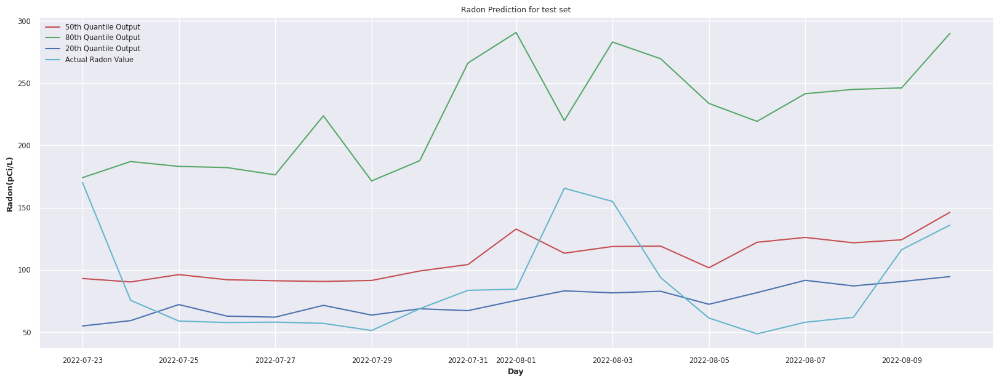

In [92]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()